### Hypo 2 on GSM not AMR with lesser amount of models

AMR-0 performs acutally worse in reconstruction by the models we set up

-> Need to prepare Dense-Dense-Dense model for comparison with every model in paper (https://stackoverflow.com/questions/50980113/evaluate-a-function-in-a-sliding-window-with-keras)

-> Maybe AMR-0 reconstruction needs far deeper layers? Or another method of reconstruction? How will it look with noise?

-> What are current observations?



##### Imports and initialization

In [1]:
%matplotlib inline

import os,sys
#path = os.path.realpath(os.path.join(os.getcwd(), ".."))
path = "/home/zantyr/Denoising"
sys.path.append(path)
os.chdir(path)

import matplotlib.pyplot as plt
import numpy as np
import pickle
import scipy.io.wavfile as sio
import tempfile

from IPython.display import Image, Audio, display

import keras
from keras.utils.vis_utils import plot_model
from keras.layers         import Dropout, Input, Conv1D, Conv2D, AveragePooling2D, Flatten, Dense, Deconv2D, UpSampling2D, concatenate, BatchNormalization, Lambda, LeakyReLU, TimeDistributed, Reshape, LSTM, GaussianNoise
from keras.models         import Model
from keras.datasets.mnist import load_data
from keras.utils          import to_categorical
from keras.initializers   import Orthogonal
from keras.regularizers   import L1L2, l2
from keras.callbacks      import Callback
import keras.backend as K
import tensorflow as tf

import loaders
from loaders.transform import AddGaussianNoise, Windowing, GSMize, MixReverb, MixNoise, ConstantQTransform, Transcript, LengthOfWindow, Length, Lengthen, Null, DivisiblePad
from loaders.dataset import Dataset, enable_multiprocessing, disable_multiprocessing
from loaders.feature import NormalizedLogPowerRFFT, Trim
from loaders.experiment import SingleExperiment
from loaders.measures import MSE
from loaders.schedule import Schedule
from loaders.estimator import DefaultVisualizeTransform, Estimator
from loaders.extras import LossHistory, set_device, delog_griffin_lim, get_stft
from loaders.custom import identity_loss
set_device()               # switches to CPU if GPU busy
enable_multiprocessing()   # for faster preprocessing of data (multicore)

Using TensorFlow backend.


Instructions for updating:
The TensorFlow Distributions library has moved to TensorFlow Probability (https://github.com/tensorflow/probability). You should update all references to use `tfp.distributions` instead of `tf.distributions`.
Instructions for updating:
The TensorFlow Distributions library has moved to TensorFlow Probability (https://github.com/tensorflow/probability). You should update all references to use `tfp.distributions` instead of `tf.distributions`.
Switching to CPU only as GPU is busy or unavailable


##### Model definition

In [2]:
model_callbacks = []

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_1 (Lambda)               (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, None, 129, 16 160         lambda_1[0][0]                   
__________________________________________________________________________________________________
leaky_re_lu_1 (LeakyReLU)       (None, None, 129, 16 0           conv2d_1[0][0]                   
__________________________________________________________________________________________________
conv2d_2 (

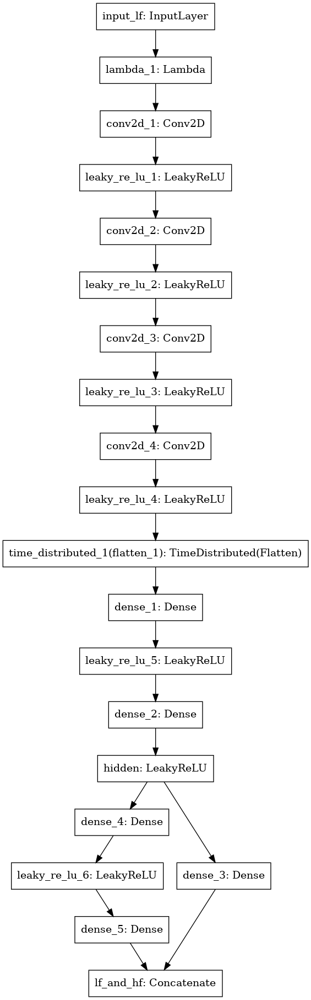

In [3]:
def mk_model():
    input_lower = Input((None, 129), name="input_lf")
    layer = Lambda(lambda x: K.expand_dims(x))(input_lower)
    layer = LeakyReLU(0.01)(Conv2D(16, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = TimeDistributed(Flatten())(layer)
    layer = LeakyReLU(0.01)(Dense(1024)(layer))
    hidden = layer = LeakyReLU(0.01, name='hidden')(Dense(512)(layer))
    layer = Dense(128)(layer)
    lower = LeakyReLU(0.01)(Dense(256)(hidden))
    lower = Dense(129)(lower)
    lf_and_hf = concatenate([lower, layer], name="lf_and_hf")
    mdl = Model(input_lower, lf_and_hf)
    mdl.summary()
    mdl.compile('adam', 'mse')
    return mdl

temp = tempfile.mktemp() + ".png"
mdl = mk_model()
model_callbacks.append(mk_model)
plot_model(mdl, to_file=temp)
Image(filename=temp)

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_2 (Lambda)               (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_5 (Conv2D)               (None, None, 129, 16 160         lambda_2[0][0]                   
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, None, 129, 20 1620        conv2d_5[0][0]                   
__________________________________________________________________________________________________
leaky_re_l

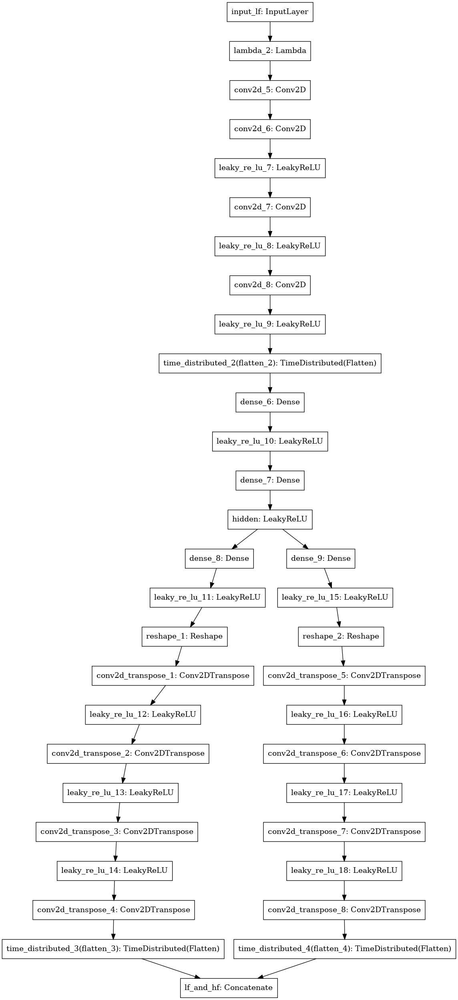

In [4]:
# baseline autoencoder

def mk_model():
    input_lower = Input((None, 129), name="input_lf")
    layer = Lambda(lambda x: K.expand_dims(x))(input_lower)
    layer = Conv2D(16, kernel_size=(9,1), padding='same', activation='tanh')(layer)
    layer = LeakyReLU(0.01)(Conv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = TimeDistributed(Flatten())(layer)
    layer = LeakyReLU(0.01)(Dense(1024)(layer))
    hidden = layer = LeakyReLU(0.01, name='hidden')(Dense(96)(layer))
    layer = LeakyReLU(0.01)(Dense(1024)(layer))
    layer = Reshape((-1, 128,8))(layer)
    layer = LeakyReLU(0.01)(Deconv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = Deconv2D(1, kernel_size=(9,1), padding='same', activation='linear')(layer)
    lower = TimeDistributed(Flatten())(layer)
    layer = LeakyReLU(0.01)(Dense(1032)(hidden))
    layer = Reshape((-1, 129,8))(layer)
    layer = LeakyReLU(0.01)(Deconv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = Deconv2D(1, kernel_size=(9,1), padding='same', activation='linear')(layer)
    layer = TimeDistributed(Flatten())(layer)
    lf_and_hf = concatenate([lower, layer], name="lf_and_hf")
    mdl = Model(input_lower, lf_and_hf)
    mdl.summary()
    mdl.compile('adam', 'mse')
    return mdl

temp = tempfile.mktemp() + ".png"
mdl = mk_model()
model_callbacks.append(mk_model)
plot_model(mdl, to_file=temp)
Image(filename=temp)

In [30]:
# baseline autoencoder - 4 encoding

def mk_model():
    input_lower = Input((None, 129), name="input_lf")
    layer = Lambda(lambda x: K.expand_dims(x))(input_lower)
    layer = Conv2D(16, kernel_size=(9,1), padding='same', activation='tanh')(layer)
    layer = LeakyReLU(0.01)(Conv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(32, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(36, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(42, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(48, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = TimeDistributed(Flatten())(layer)
    layer = LeakyReLU(0.01)(Dense(1024)(layer))
    hidden = layer = LeakyReLU(0.01, name='hidden')(Dense(96)(layer))
    layer = LeakyReLU(0.01)(Dense(1024)(layer))
    layer = Reshape((-1, 128,8))(layer)
    layer = LeakyReLU(0.01)(Deconv2D(48, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(42, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(36, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(32, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = Deconv2D(1, kernel_size=(9,1), padding='same', activation='linear')(layer)
    lower = TimeDistributed(Flatten())(layer)
    layer = LeakyReLU(0.01)(Dense(1032)(hidden))
    layer = Reshape((-1, 129,8))(layer)
    layer = LeakyReLU(0.01)(Deconv2D(48, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(42, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(36, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(32, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = Deconv2D(1, kernel_size=(9,1), padding='same', activation='linear')(layer)
    layer = TimeDistributed(Flatten())(layer)
    lf_and_hf = concatenate([lower, layer], name="lf_and_hf")
    mdl = Model(input_lower, lf_and_hf)
    mdl.summary()
    mdl.compile('adam', 'mse')
    return mdl

temp = tempfile.mktemp() + ".png"
mdl = mk_model()
model_callbacks.append(mk_model)
plot_model(mdl, to_file=temp)
Image(filename=temp)

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_14 (Lambda)              (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_53 (Conv2D)              (None, None, 129, 16 160         lambda_14[0][0]                  
__________________________________________________________________________________________________
conv2d_54 (Conv2D)              (None, None, 129, 20 1620        conv2d_53[0][0]                  
__________________________________________________________________________________________________
leaky_re_l

OSError: `pydot` failed to call GraphViz.Please install GraphViz (https://www.graphviz.org/) and ensure that its executables are in the $PATH.

In [31]:
# baseline autoencoder - deeped mid representation - 4 layers

def mk_model():
    input_lower = Input((None, 129), name="input_lf")
    layer = Lambda(lambda x: K.expand_dims(x))(input_lower)
    layer = Conv2D(16, kernel_size=(9,1), padding='same', activation='tanh')(layer)
    layer = LeakyReLU(0.01)(Conv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Conv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = TimeDistributed(Flatten())(layer)
    layer = LeakyReLU(0.01)(Dense(1024)(layer))
    layer = LeakyReLU(0.01)(Dense(512)(layer))
    layer = LeakyReLU(0.01)(Dense(256)(layer))
    layer = LeakyReLU(0.01)(Dense(192)(layer))
    hidden = layer = LeakyReLU(0.01, name='hidden')(Dense(96)(layer))
    layer = LeakyReLU(0.01)(Dense(192)(layer))
    layer = LeakyReLU(0.01)(Dense(256)(layer))
    layer = LeakyReLU(0.01)(Dense(512)(layer))
    layer = LeakyReLU(0.01)(Dense(1024)(layer))
    layer = Reshape((-1, 128,8))(layer)
    layer = LeakyReLU(0.01)(Deconv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = Deconv2D(1, kernel_size=(9,1), padding='same', activation='linear')(layer)
    lower = TimeDistributed(Flatten())(layer)
    layer = LeakyReLU(0.01)(Dense(192)(hidden))
    layer = LeakyReLU(0.01)(Dense(256)(layer))
    layer = LeakyReLU(0.01)(Dense(512)(layer))
    layer = LeakyReLU(0.01)(Dense(1032)(layer))
    layer = Reshape((-1, 129,8))(layer)
    layer = LeakyReLU(0.01)(Deconv2D(28, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(24, kernel_size=(9,1), padding='same', activation='linear')(layer))
    layer = LeakyReLU(0.01)(Deconv2D(20, kernel_size=(1,5), padding='same', activation='linear')(layer))
    layer = Deconv2D(1, kernel_size=(9,1), padding='same', activation='linear')(layer)
    layer = TimeDistributed(Flatten())(layer)
    lf_and_hf = concatenate([lower, layer], name="lf_and_hf")
    mdl = Model(input_lower, lf_and_hf)
    mdl.summary()
    mdl.compile('adam', 'mse')
    return mdl

temp = tempfile.mktemp() + ".png"
mdl = mk_model()
model_callbacks.append(mk_model)
plot_model(mdl, to_file=temp)
Image(filename=temp)

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_15 (Lambda)              (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_61 (Conv2D)              (None, None, 129, 16 160         lambda_15[0][0]                  
__________________________________________________________________________________________________
conv2d_62 (Conv2D)              (None, None, 129, 20 1620        conv2d_61[0][0]                  
__________________________________________________________________________________________________
leaky_re_l

OSError: `pydot` failed to call GraphViz.Please install GraphViz (https://www.graphviz.org/) and ensure that its executables are in the $PATH.

##### Data loading

In [5]:
import hickle
train, valid, test = hickle.load("data.h5")

MemoryError: 

In [39]:
os.listdir("./NoiseBackup")
display(Audio(sio.read("./NoiseBackup/352967__jamafel__john-paul-2nd-city-park.wav2.wav")[1], rate=16000))

In [14]:
TRAIN = 9000
VALID = 80
TEST = 80

import numpy as np
import scipy.io.wavfile as sio
import scipy.signal as ss
import gc

import tempfile
import subprocess

tempnam = tempfile.mktemp

log_fft_source = log_fft_target = phase = train = test = valid = experiment = None
gc.collect()

dataset = Dataset.from_folder("DAE-libri",
                              verbose = False,
                              dataset_pad = 8,
                              trim_lengths = 160000,
                              cache = "cache",
                              ram_cache_size = None,
                              filter=lambda x:x.endswith(".wav") and not x.endswith(".gsm.wav"))

import random
noises = [os.path.join("./NoiseCut", x) for x in os.listdir("./NoiseCut")]

log_fft_source = np.zeros([TRAIN + VALID + TEST, 1248, 129], np.float32)
log_fft_target = np.zeros([TRAIN + VALID + TEST, 1248, 257], np.float32)
phase = np.zeros([TEST, 1248, 129], np.float32)

SNR = 5 # dB
SNR /= 10. # B
SNR = np.log(10) * SNR

# envelope_filter_base = ss.butter(6, (20. / 8000.))
# envelope_filter = lambda signal: ss.lfilter(envelope_filter_base[0], envelope_filter_base[1], signal)

for ix, file in enumerate(dataset.files[:TRAIN + VALID + TEST]):
    print(ix)
    noise = sio.read(random.choice(noises))[1]
    data = sio.read(dataset.root + "/" + file)[1] # .astype(np.float32) to generate noise in the experiment...
    data = data[:176000]
    noise = noise[:len(data)]
    if len(noise) < len(data):
        print("NOISE TOO SHORT:", len(noise))
        noise = np.pad(noise, ((0, len(data) - len(noise)),),'constant')
    log_power_of_signal = np.log((data.astype(np.float32) ** 2).max())
    log_power_of_noise = np.log((noise.astype(np.float32) ** 2).max())
    print("Clean // noise power mean before gain:", np.sqrt(np.exp(log_power_of_signal)), np.sqrt(np.exp(log_power_of_noise)))
    print("Clean // noise power mean before gain (log):", log_power_of_signal, log_power_of_noise)
    gain_of_noise = np.sqrt(np.exp(log_power_of_signal - SNR - log_power_of_noise))   # SNR was miscalculated...
    print("Noise difference - logpower:", log_power_of_signal - log_power_of_noise)
    print("Noise gain - multiplicatively:", gain_of_noise)
    if np.isnan(gain_of_noise):
        print("NAN gain - generating some random white noise")
        noise = np.random.normal(0, 1500, size=data.shape)
    else:
        noise = noise * gain_of_noise
    noised = data + noise
    print("Clean // noise peaks:", np.abs(data).max(), np.abs(noise).max())
    if np.abs(noised).max() >= 2**15 - 1:
        noised = noised / (np.abs(noised).max() / (2 ** 15 - 1))
    noised = noised.astype(np.int16)
    print("Amplitude of clean recording: ", np.abs(data).max())
    print("Amplitude of noised recording: ", np.abs(noised).max())
    oldname = tempnam() + '.oldwav'
    sio.write(oldname, 16000, noised)
    tmpname = tempnam() + '.amr-nb'
    print(oldname)
    newname = dataset.root + "/" + file + ".gsm.wav"
    subprocess.Popen(['sox', oldname, '-C', '0', '-r',  '8000', tmpname]).communicate()
    subprocess.Popen(['sox', tmpname, '-r', '16000', "-e", "signed", '-b', '16',  newname]).communicate()
    list(map(os.remove, [oldname, tmpname]))
    # display(Audio(noised, rate=16000))
    # input = sio.read(newname)[1]
    # print("New name: ", newname)
    # display(Audio(input, rate=16000))
    
window = np.hamming(512)
for ix, file in enumerate(dataset.files[:TRAIN + VALID + TEST]):
    print(ix)
    r = sio.read(dataset.root + "/" + file)[1].astype(np.float32)
    r /= 2**15
    for time in range(1248):
        win = r[128 * time : 128 * time + 512]
        if len(win) != 512:
            break
        fft = np.fft.rfft(window * win) / 512
        log_fft_target[ix, time, :] = -np.log(np.abs(fft) ** 2 + 2e-12)
    r = sio.read(dataset.root + "/" + file + ".gsm.wav")[1].astype(np.float32)
    r /= 2**15
    for time in range(1248):
        win = r[128 * time : 128 * time + 512]
        if len(win) != 512:
            break
        fft = np.fft.rfft(window * win) / 512
        log_fft_source[ix, time, :] = -np.log(np.abs(fft) ** 2 + 2e-12)[:129]
        if ix >= TRAIN+VALID:
            phase[ix - TRAIN - VALID, time, :] = np.angle(fft)[:129]


0
Clean // noise power mean before gain: 18152.998 27012.006
Clean // noise power mean before gain (log): 19.613182 20.408073
Noise difference - logpower: -0.79489136
Noise gain - multiplicatively: 0.37791274174335543
Clean // noise peaks: 18153 10208.178979971517
Amplitude of clean recording:  18153
Amplitude of noised recording:  22100
/tmp/tmpx90r9sdk.oldwav
1
Clean // noise power mean before gain: 16891.0 26323.99
Clean // noise power mean before gain (log): 19.469072 20.356472
Noise difference - logpower: -0.8873997
Noise gain - multiplicatively: 0.360830806712896
Clean // noise peaks: 16891 9498.510155910275
Amplitude of clean recording:  16891
Amplitude of noised recording:  17149
/tmp/tmpolnmf8ur.oldwav
2
Clean // noise power mean before gain: 17380.008 12828.004
Clean // noise power mean before gain (log): 19.526152 18.918772
Noise difference - logpower: 0.6073799
Noise gain - multiplicatively: 0.7618875422137699
Clean // noise peaks: 17380 9773.49339151824
Amplitude of clean 

23
Clean // noise power mean before gain: 14432.998 9573.003
Clean // noise power mean before gain (log): 19.154545 18.333405
Noise difference - logpower: 0.8211403
Noise gain - multiplicatively: 0.8478291575883011
Clean // noise peaks: 14433 8116.268525592806
Amplitude of clean recording:  14433
Amplitude of noised recording:  14999
/tmp/tmp09o8k65p.oldwav
24
Clean // noise power mean before gain: 13714.002 1677.9999
Clean // noise power mean before gain (log): 19.052345 14.850716
Noise difference - logpower: 4.2016296
Noise gain - multiplicatively: 4.595918128049048
Clean // noise peaks: 13714 7711.950618866303
Amplitude of clean recording:  13714
Amplitude of noised recording:  15636
/tmp/tmprdu1hbvz.oldwav
25
Clean // noise power mean before gain: 18046.996 16822.998
Clean // noise power mean before gain (log): 19.601469 19.461004
Noise difference - logpower: 0.14046478
Noise gain - multiplicatively: 0.6032558470807851
Clean // noise peaks: 18047 10148.573115440047
Amplitude of cle

Amplitude of noised recording:  13894
/tmp/tmpdewai1no.oldwav
46
Clean // noise power mean before gain: 14847.999 9573.003
Clean // noise power mean before gain (log): 19.21124 18.333405
Noise difference - logpower: 0.8778362
Noise gain - multiplicatively: 0.8722072951404889
Clean // noise peaks: 14848 8349.6404363799
Amplitude of clean recording:  14848
Amplitude of noised recording:  15316
/tmp/tmpuzjsv3rw.oldwav
47
Clean // noise power mean before gain: 19212.008 11734.001
Clean // noise power mean before gain (log): 19.726582 18.740492
Noise difference - logpower: 0.9860897
Noise gain - multiplicatively: 0.9207180538613138
Clean // noise peaks: 19212 10803.705644008656
Amplitude of clean recording:  19212
Amplitude of noised recording:  17529
/tmp/tmpen65zp19.oldwav
48
Clean // noise power mean before gain: 10980.004 11325.004
Clean // noise power mean before gain (log): 18.607662 18.669537
Noise difference - logpower: -0.06187439
Noise gain - multiplicatively: 0.545210419464212
Cl

69
Clean // noise power mean before gain: 15251.002 15315.994
Clean // noise power mean before gain (log): 19.264801 19.273306
Noise difference - logpower: -0.008504868
Noise gain - multiplicatively: 0.5599550832088942
Clean // noise peaks: 15251 8576.272054427423
Amplitude of clean recording:  15251
Amplitude of noised recording:  16933
/tmp/tmprvv_0iev.oldwav
70
Clean // noise power mean before gain: 18775.0 26323.99
Clean // noise power mean before gain (log): 19.680563 20.356472
Noise difference - logpower: -0.67590904
Noise gain - multiplicatively: 0.4010774234297277
Clean // noise peaks: 18775 10557.962094364151
Amplitude of clean recording:  18775
Amplitude of noised recording:  20024
/tmp/tmpvjo5t0hw.oldwav
71
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 11199.0 10709.003
Clean // noise power mean before gain (log): 18.64716 18.55768
Noise difference - logpower: 0.08947945
Noise gain - multiplicatively: 0.5880716116122325
Clean // noise peaks: 11199 6297.65888

93
Clean // noise power mean before gain: 25787.01 31147.996
Clean // noise power mean before gain (log): 20.315252 20.69301
Noise difference - logpower: -0.37775803
Noise gain - multiplicatively: 0.4655548838022692
Clean // noise peaks: 25787 14501.103520673081
Amplitude of clean recording:  25787
Amplitude of noised recording:  25743
/tmp/tmpczhnb1sc.oldwav
94
Clean // noise power mean before gain: 20293.996 12828.004
Clean // noise power mean before gain (log): 19.83616 18.918772
Noise difference - logpower: 0.9173889
Noise gain - multiplicatively: 0.8896280586445454
Clean // noise peaks: 20294 11412.148736292229
Amplitude of clean recording:  20294
Amplitude of noised recording:  19855
/tmp/tmpcdni1ur7.oldwav
95
Clean // noise power mean before gain: 8939.996 14077.001
Clean // noise power mean before gain (log): 18.19658 19.104595
Noise difference - logpower: -0.9080143
Noise gain - multiplicatively: 0.35713071277433167
Clean // noise peaks: 8940 5027.329043724267
Amplitude of cle

116
Clean // noise power mean before gain: 19756.998 13979.006
Clean // noise power mean before gain (log): 19.782526 19.090624
Noise difference - logpower: 0.69190216
Noise gain - multiplicatively: 0.7947758188784699
Clean // noise peaks: 19757 11110.171172102131
Amplitude of clean recording:  19757
Amplitude of noised recording:  20952
/tmp/tmpifb2012z.oldwav
117
Clean // noise power mean before gain: 11626.996 8559.999
Clean // noise power mean before gain (log): 18.72217 18.10971
Noise difference - logpower: 0.6124592
Noise gain - multiplicatively: 0.7638249173282111
Clean // noise peaks: 11627 6538.341292329487
Amplitude of clean recording:  11627
Amplitude of noised recording:  11962
/tmp/tmpoxrnp_cb.oldwav
118
Clean // noise power mean before gain: 15985.992 16444.0
Clean // noise power mean before gain (log): 19.358936 19.415432
Noise difference - logpower: -0.056495667
Noise gain - multiplicatively: 0.5466786608461521
Clean // noise peaks: 15986 8989.583898954126
Amplitude of 

140
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 19003.0 10709.003
Clean // noise power mean before gain (log): 19.704704 18.55768
Noise difference - logpower: 1.1470242
Noise gain - multiplicatively: 0.9978680798598657
Clean // noise peaks: 19003 10686.169267219302
Amplitude of clean recording:  19003
Amplitude of noised recording:  18981
/tmp/tmp4nc7vfa3.oldwav
141
Clean // noise power mean before gain: 15438.004 16822.998
Clean // noise power mean before gain (log): 19.289175 19.461004
Noise difference - logpower: -0.17182922
Noise gain - multiplicatively: 0.5160452182539726
Clean // noise peaks: 15438 8681.428706686582
Amplitude of clean recording:  15438
Amplitude of noised recording:  16375
/tmp/tmppcnp0kqg.oldwav
142
Clean // noise power mean before gain: 22188.998 12828.004
Clean // noise power mean before gain (log): 20.014704 18.918772
Noise difference - logpower: 1.095932
Noise gain - multiplicatively: 0.9726993184061988
Clean // noise peaks: 22189 12477.78

164
Clean // noise power mean before gain: 30721.994 12828.004
Clean // noise power mean before gain (log): 20.665468 18.918772
Noise difference - logpower: 1.7466965
Noise gain - multiplicatively: 1.3467603434257909
Clean // noise peaks: 30722 17276.241685466044
Amplitude of clean recording:  30722
Amplitude of noised recording:  31295
/tmp/tmpqgqqoiin.oldwav
165
Clean // noise power mean before gain: 16607.004 6583.0
Clean // noise power mean before gain (log): 19.43516 17.584492
Noise difference - logpower: 1.850668
Noise gain - multiplicatively: 1.4186244479534365
Clean // noise peaks: 16607 9338.804740877473
Amplitude of clean recording:  16607
Amplitude of noised recording:  16591
/tmp/tmpdyca5y8i.oldwav
166
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 24499.994 10709.003
Clean // noise power mean before gain (log): 20.212856 18.55768
Noise difference - logpower: 1.6551762
Noise gain - multiplicatively: 1.2865211700098598
Clean // noise peaks: 24500 13777.355209

187
Clean // noise power mean before gain: 18520.994 10613.997
Clean // noise power mean before gain (log): 19.65332 18.539858
Noise difference - logpower: 1.1134624
Noise gain - multiplicatively: 0.981262717766412
Clean // noise peaks: 18521 10415.122486372698
Amplitude of clean recording:  18521
Amplitude of noised recording:  20160
/tmp/tmpseiq3hpq.oldwav
188
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 12905.001 10709.003
Clean // noise power mean before gain (log): 18.93074 18.55768
Noise difference - logpower: 0.37306023
Noise gain - multiplicatively: 0.677655548954198
Clean // noise peaks: 12905 7257.013273750506
Amplitude of clean recording:  12905
Amplitude of noised recording:  12879
/tmp/tmp2e54qhbk.oldwav
189
Clean // noise power mean before gain: 16647.996 10613.997
Clean // noise power mean before gain (log): 19.44009 18.539858
Noise difference - logpower: 0.9002323
Noise gain - multiplicatively: 0.8820292010854429
Clean // noise peaks: 16648 9361.857940

210
Clean // noise power mean before gain: 18533.998 28947.998
Clean // noise power mean before gain (log): 19.654724 20.546513
Noise difference - logpower: -0.8917885
Noise gain - multiplicatively: 0.3600398660693696
Clean // noise peaks: 18534 10422.43404297611
Amplitude of clean recording:  18534
Amplitude of noised recording:  18970
/tmp/tmpwx4o1iq0.oldwav
211
Clean // noise power mean before gain: 11974.999 16444.0
Clean // noise power mean before gain (log): 18.781153 19.415432
Noise difference - logpower: -0.63427925
Noise gain - multiplicatively: 0.40951329950290266
Clean // noise peaks: 11975 6734.036697025731
Amplitude of clean recording:  11975
Amplitude of noised recording:  11913
/tmp/tmph3n4urln.oldwav
212
Clean // noise power mean before gain: 17645.0 32734.002
Clean // noise power mean before gain (log): 19.556416 20.79234
Noise difference - logpower: -1.2359238
Noise gain - multiplicatively: 0.30312556396366463
Clean // noise peaks: 17645 9922.512210786597
Amplitude of

Amplitude of clean recording:  31479
Amplitude of noised recording:  31519
/tmp/tmpyhp69rh5.oldwav
233
Clean // noise power mean before gain: 23672.0 8231.003
Clean // noise power mean before gain (log): 20.144096 18.031326
Noise difference - logpower: 2.11277
Noise gain - multiplicatively: 1.6172687458033668
Clean // noise peaks: 23672 13311.739046707511
Amplitude of clean recording:  23672
Amplitude of noised recording:  30774
/tmp/tmp0kopb6lf.oldwav
234
Clean // noise power mean before gain: 20166.008 9573.003
Clean // noise power mean before gain (log): 19.823507 18.333405
Noise difference - logpower: 1.4901028
Noise gain - multiplicatively: 1.184599935869228
Clean // noise peaks: 20166 11340.17518607612
Amplitude of clean recording:  20166
Amplitude of noised recording:  20152
/tmp/tmp8wpsci5u.oldwav
235
Clean // noise power mean before gain: 15114.996 12951.001
Clean // noise power mean before gain (log): 19.246885 18.937857
Noise difference - logpower: 0.30902863
Noise gain - mu

256
Clean // noise power mean before gain: 24253.988 11734.001
Clean // noise power mean before gain (log): 20.192673 18.740492
Noise difference - logpower: 1.4521809
Noise gain - multiplicatively: 1.1623503952791951
Clean // noise peaks: 24254 13639.019538206076
Amplitude of clean recording:  24254
Amplitude of noised recording:  26615
/tmp/tmpghe7pmkr.oldwav
257
Clean // noise power mean before gain: 17395.992 28947.998
Clean // noise power mean before gain (log): 19.52799 20.546513
Noise difference - logpower: -1.0185223
Noise gain - multiplicatively: 0.3379330755162739
Clean // noise peaks: 17396 9782.486670045097
Amplitude of clean recording:  17396
Amplitude of noised recording:  17938
/tmp/tmp3u4xdzc6.oldwav
258
Clean // noise power mean before gain: 19072.992 26323.99
Clean // noise power mean before gain (log): 19.712057 20.356472
Noise difference - logpower: -0.6444149
Noise gain - multiplicatively: 0.4074432074986982
Clean // noise peaks: 19073 10725.534994195732
Amplitude o

279
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 23467.006 10709.003
Clean // noise power mean before gain (log): 20.126701 18.55768
Noise difference - logpower: 1.5690212
Noise gain - multiplicatively: 1.23227781544456
Clean // noise peaks: 23467 13196.463125595792
Amplitude of clean recording:  23467
Amplitude of noised recording:  23467
/tmp/tmpq2f20rn4.oldwav
280
Clean // noise power mean before gain: 27823.994 8559.999
Clean // noise power mean before gain (log): 20.467308 18.10971
Noise difference - logpower: 2.3575974
Noise gain - multiplicatively: 1.8278719151686906
Clean // noise peaks: 27824 15646.583593843992
Amplitude of clean recording:  27824
Amplitude of noised recording:  28039
/tmp/tmp8zqb49w2.oldwav
281
Clean // noise power mean before gain: 24299.992 6743.001
Clean // noise power mean before gain (log): 20.196463 17.63252
Noise difference - logpower: 2.563942
Noise gain - multiplicatively: 2.0265294603534554
Clean // noise peaks: 24300 13664.8881511

302
Clean // noise power mean before gain: 20186.0 8559.999
Clean // noise power mean before gain (log): 19.825489 18.10971
Noise difference - logpower: 1.7157784
Noise gain - multiplicatively: 1.3261007936248226
Clean // noise peaks: 20186 11351.42279342848
Amplitude of clean recording:  20186
Amplitude of noised recording:  20203
/tmp/tmpy1jysd8b.oldwav
303
Clean // noise power mean before gain: 22455.01 18763.008
Clean // noise power mean before gain (log): 20.038538 19.679285
Noise difference - logpower: 0.35925293
Noise gain - multiplicatively: 0.6729933648803805
Clean // noise peaks: 22455 12627.37450525058
Amplitude of clean recording:  22455
Amplitude of noised recording:  22699
/tmp/tmp1aw2nqxr.oldwav
304
Clean // noise power mean before gain: 13694.999 26303.99
Clean // noise power mean before gain (log): 19.049572 20.354952
Noise difference - logpower: -1.3053799
Noise gain - multiplicatively: 0.29277929680579445
Clean // noise peaks: 13695 7701.266623179617
Amplitude of cle

325
Clean // noise power mean before gain: 18180.996 6583.0
Clean // noise power mean before gain (log): 19.616264 17.584492
Noise difference - logpower: 2.0317726
Noise gain - multiplicatively: 1.553079965015532
Clean // noise peaks: 18181 10223.925409697247
Amplitude of clean recording:  18181
Amplitude of noised recording:  18086
/tmp/tmpm2e8v7cm.oldwav
326
Clean // noise power mean before gain: 7763.9966 32567.01
Clean // noise power mean before gain (log): 17.914505 20.78211
Noise difference - logpower: -2.8676052
Noise gain - multiplicatively: 0.13406253913767535
Clean // noise peaks: 7764 4366.014712096673
Amplitude of clean recording:  7764
Amplitude of noised recording:  9725
/tmp/tmpwuxny71e.oldwav
327
Clean // noise power mean before gain: 18787.0 32567.01
Clean // noise power mean before gain (log): 19.68184 20.78211
Noise difference - logpower: -1.1002693
Noise gain - multiplicatively: 0.3243990348072684
Clean // noise peaks: 18787 10564.70336656831
Amplitude of clean reco

Clean // noise power mean before gain: 26005.996 11734.001
Clean // noise power mean before gain (log): 20.332165 18.740492
Noise difference - logpower: 1.5916729
Noise gain - multiplicatively: 1.2463137262887867
Clean // noise peaks: 26006 14624.245264272622
Amplitude of clean recording:  26006
Amplitude of noised recording:  26745
/tmp/tmprw_4evz8.oldwav
349
Clean // noise power mean before gain: 14682.0 12951.001
Clean // noise power mean before gain (log): 19.188755 18.937857
Noise difference - logpower: 0.25089836
Noise gain - multiplicatively: 0.6375024921862175
Clean // noise peaks: 14682 8256.294776303703
Amplitude of clean recording:  14682
Amplitude of noised recording:  14542
/tmp/tmp7z4nvzu1.oldwav
350
Clean // noise power mean before gain: 20538.992 32734.002
Clean // noise power mean before gain (log): 19.86016 20.79234
Noise difference - logpower: -0.9321785
Noise gain - multiplicatively: 0.3528417856169077
Clean // noise peaks: 20539 11549.923010383856
Amplitude of clea

Clean // noise power mean before gain: 11528.002 32567.01
Clean // noise power mean before gain (log): 18.705069 20.78211
Noise difference - logpower: -2.0770416
Noise gain - multiplicatively: 0.19905639822649918
Clean // noise peaks: 11528 6482.669721042399
Amplitude of clean recording:  11528
Amplitude of noised recording:  11523
/tmp/tmpm7wqg1qm.oldwav
372
Clean // noise power mean before gain: 21138.994 26323.99
Clean // noise power mean before gain (log): 19.91775 20.356472
Noise difference - logpower: -0.4387226
Noise gain - multiplicatively: 0.4515778126337972
Clean // noise peaks: 21139 11887.334339772078
Amplitude of clean recording:  21139
Amplitude of noised recording:  21179
/tmp/tmpapm1yg52.oldwav
373
Clean // noise power mean before gain: 23728.008 13979.006
Clean // noise power mean before gain (log): 20.148823 19.090624
Noise difference - logpower: 1.0581989
Noise gain - multiplicatively: 0.9545198795635559
Clean // noise peaks: 23728 13343.233396418947
Amplitude of cle

Clean // noise power mean before gain: 15503.999 32567.01
Clean // noise power mean before gain (log): 19.297707 20.78211
Noise difference - logpower: -1.4844036
Noise gain - multiplicatively: 0.26771077516663117
Clean // noise peaks: 15504 8718.536814851677
Amplitude of clean recording:  15504
Amplitude of noised recording:  15698
/tmp/tmpxxda0470.oldwav
395
Clean // noise power mean before gain: 15508.007 16822.998
Clean // noise power mean before gain (log): 19.298223 19.461004
Noise difference - logpower: -0.16278076
Noise gain - multiplicatively: 0.5183852153579102
Clean // noise peaks: 15508 8720.794477966123
Amplitude of clean recording:  15508
Amplitude of noised recording:  19031
/tmp/tmp1ziggsap.oldwav
396
Clean // noise power mean before gain: 9601.997 32567.01
Clean // noise power mean before gain (log): 18.339453 20.78211
Noise difference - logpower: -2.4426575
Noise gain - multiplicatively: 0.1657996729898106
Clean // noise peaks: 9602 5399.597950259162
Amplitude of clean

417
Clean // noise power mean before gain: 11746.003 1677.9999
Clean // noise power mean before gain (log): 18.742537 14.850716
Noise difference - logpower: 3.891821
Noise gain - multiplicatively: 3.936390475912122
Clean // noise peaks: 11746 6605.2632185805405
Amplitude of clean recording:  11746
Amplitude of noised recording:  13322
/tmp/tmp197zotfx.oldwav
418
Clean // noise power mean before gain: 18170.994 27012.006
Clean // noise power mean before gain (log): 19.615164 20.408073
Noise difference - logpower: -0.7929096
Noise gain - multiplicatively: 0.3782873888225247
Clean // noise peaks: 18171 10218.298946874038
Amplitude of clean recording:  18171
Amplitude of noised recording:  19364
/tmp/tmp9yvt0xce.oldwav
419
Clean // noise power mean before gain: 17569.992 26303.99
Clean // noise power mean before gain (log): 19.547895 20.354952
Noise difference - logpower: -0.8070564
Noise gain - multiplicatively: 0.3756210510537889
Clean // noise peaks: 17570 9880.336126918863
Amplitude of

Clean // noise power mean before gain: 15510.004 16822.998
Clean // noise power mean before gain (log): 19.298481 19.461004
Noise difference - logpower: -0.16252327
Noise gain - multiplicatively: 0.5184519596942476
Clean // noise peaks: 15510 8721.917317936328
Amplitude of clean recording:  15510
Amplitude of noised recording:  17622
/tmp/tmpfa0c592b.oldwav
441
Clean // noise power mean before gain: 15083.993 11734.001
Clean // noise power mean before gain (log): 19.242779 18.740492
Noise difference - logpower: 0.5022869
Noise gain - multiplicatively: 0.7228866707380399
Clean // noise peaks: 15084 8482.35219444016
Amplitude of clean recording:  15084
Amplitude of noised recording:  15606
/tmp/tmpalk0pp0p.oldwav
442
Clean // noise power mean before gain: 17967.006 10613.997
Clean // noise power mean before gain (log): 19.592585 18.539858
Noise difference - logpower: 1.0527267
Noise gain - multiplicatively: 0.9519117953316557
Clean // noise peaks: 17967 10103.591795650194
Amplitude of cl

463
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 11585.998 10709.003
Clean // noise power mean before gain (log): 18.715105 18.55768
Noise difference - logpower: 0.15742493
Noise gain - multiplicatively: 0.6083932521071683
Clean // noise peaks: 11586 6515.283336815665
Amplitude of clean recording:  11586
Amplitude of noised recording:  11591
/tmp/tmpesowk9fx.oldwav
464
Clean // noise power mean before gain: 12180.003 32734.002
Clean // noise power mean before gain (log): 18.815102 20.79234
Noise difference - logpower: -1.9772377
Noise gain - multiplicatively: 0.20924172341721353
Clean // noise peaks: 12180 6849.318574339068
Amplitude of clean recording:  12180
Amplitude of noised recording:  12147
/tmp/tmp8v2y55oe.oldwav
465
Clean // noise power mean before gain: 20444.992 32567.01
Clean // noise power mean before gain (log): 19.850986 20.78211
Noise difference - logpower: -0.93112373
Noise gain - multiplicatively: 0.35302791706400133
Clean // noise peaks: 20445 11497

Clean // noise power mean before gain: 17855.004 25632.006
Clean // noise power mean before gain (log): 19.580078 20.303194
Noise difference - logpower: -0.7231159
Noise gain - multiplicatively: 0.39172146753111037
Clean // noise peaks: 17855 10040.604655757421
Amplitude of clean recording:  17855
Amplitude of noised recording:  22008
/tmp/tmpslhgubjl.oldwav
487
Clean // noise power mean before gain: 16965.002 27012.006
Clean // noise power mean before gain (log): 19.477816 20.408073
Noise difference - logpower: -0.9302578
Noise gain - multiplicatively: 0.3531807999988281
Clean // noise peaks: 16965 9540.119769568346
Amplitude of clean recording:  16965
Amplitude of noised recording:  21774
/tmp/tmpu3q2r5yo.oldwav
488
Clean // noise power mean before gain: 19091.99 4063.001
Clean // noise power mean before gain (log): 19.714048 16.619354
Noise difference - logpower: 3.0946941
Noise gain - multiplicatively: 2.6424348810825693
Clean // noise peaks: 19092 10736.21292183848
Amplitude of cl

Clean // noise power mean before gain: 17581.994 32567.01
Clean // noise power mean before gain (log): 19.549261 20.78211
Noise difference - logpower: -1.2328491
Noise gain - multiplicatively: 0.3035919242457873
Clean // noise peaks: 17582 9887.078196912555
Amplitude of clean recording:  17582
Amplitude of noised recording:  17736
/tmp/tmpdusiy_vp.oldwav
510
Clean // noise power mean before gain: 9712.996 32567.01
Clean // noise power mean before gain (log): 18.36244 20.78211
Noise difference - logpower: -2.41967
Noise gain - multiplicatively: 0.16771631538986986
Clean // noise peaks: 9713 5462.0172433018915
Amplitude of clean recording:  9713
Amplitude of noised recording:  11055
/tmp/tmp6wm_01e5.oldwav
511
Clean // noise power mean before gain: 16360.003 15315.994
Clean // noise power mean before gain (log): 19.40519 19.273306
Noise difference - logpower: 0.13188362
Noise gain - multiplicatively: 0.6006730739168845
Clean // noise peaks: 16360 9199.908800111003
Amplitude of clean reco

Clean // noise power mean before gain: 16195.993 15315.994
Clean // noise power mean before gain (log): 19.385038 19.273306
Noise difference - logpower: 0.11173248
Noise gain - multiplicatively: 0.5946513379731926
Clean // noise peaks: 16196 9107.679892397418
Amplitude of clean recording:  16196
Amplitude of noised recording:  17785
/tmp/tmpe7ta5u6j.oldwav
533
Clean // noise power mean before gain: 18090.006 16822.998
Clean // noise power mean before gain (log): 19.60623 19.461004
Noise difference - logpower: 0.14522552
Noise gain - multiplicatively: 0.604693530292245
Clean // noise peaks: 18090 10172.759260106439
Amplitude of clean recording:  18090
Amplitude of noised recording:  20737
/tmp/tmpsczf98k7.oldwav
534
Clean // noise power mean before gain: 32672.002 12951.001
Clean // noise power mean before gain (log): 20.788548 18.937857
Noise difference - logpower: 1.8506908
Noise gain - multiplicatively: 1.418640682914741
Clean // noise peaks: 32672 18372.81548442881
Amplitude of clea

Clean // noise power mean before gain: 32767.984 28947.998
Clean // noise power mean before gain (log): 20.794415 20.546513
Noise difference - logpower: 0.24790192
Noise gain - multiplicatively: 0.6365480868377982
Clean // noise peaks: 32767 18426.794017780583
Amplitude of clean recording:  32767
Amplitude of noised recording:  32766
/tmp/tmpk446ldrk.oldwav
556
Clean // noise power mean before gain: 24268.01 11325.004
Clean // noise power mean before gain (log): 20.193829 18.669537
Noise difference - logpower: 1.524292
Noise gain - multiplicatively: 1.2050242881074318
Clean // noise peaks: 24268 13646.900062816665
Amplitude of clean recording:  24268
Amplitude of noised recording:  24223
/tmp/tmpognxrg94.oldwav
557
Clean // noise power mean before gain: 26157.0 8559.999
Clean // noise power mean before gain (log): 20.343744 18.10971
Noise difference - logpower: 2.2340336
Noise gain - multiplicatively: 1.718360294621061
Clean // noise peaks: 26157 14709.164121956283
Amplitude of clean r

Clean // noise power mean before gain: 7055.998 11325.004
Clean // noise power mean before gain (log): 17.723267 18.669537
Noise difference - logpower: -0.94627
Noise gain - multiplicatively: 0.35036448951794535
Clean // noise peaks: 7056 3967.8778437907313
Amplitude of clean recording:  7056
Amplitude of noised recording:  7063
/tmp/tmp0d1murve.oldwav
579
Clean // noise power mean before gain: 19885.008 32734.002
Clean // noise power mean before gain (log): 19.795443 20.79234
Noise difference - logpower: -0.99689674
Noise gain - multiplicatively: 0.34160689080147283
Clean // noise peaks: 19885 11182.159963495411
Amplitude of clean recording:  19885
Amplitude of noised recording:  19902
/tmp/tmpei9a3y8v.oldwav
580
Clean // noise power mean before gain: 21562.01 6583.0
Clean // noise power mean before gain (log): 19.957376 17.584492
Noise difference - logpower: 2.3728848
Noise gain - multiplicatively: 1.8418971531462254
Clean // noise peaks: 21562 12125.208959161602
Amplitude of clean r

601
Clean // noise power mean before gain: 18694.992 11734.001
Clean // noise power mean before gain (log): 19.672022 18.740492
Noise difference - logpower: 0.93153
Noise gain - multiplicatively: 0.895940500540554
Clean // noise peaks: 18695 10512.96583334286
Amplitude of clean recording:  18695
Amplitude of noised recording:  18355
/tmp/tmpahs3pbh6.oldwav
602
Clean // noise power mean before gain: 19131.998 8231.003
Clean // noise power mean before gain (log): 19.718235 18.031326
Noise difference - logpower: 1.6869087
Noise gain - multiplicatively: 1.3070962681093905
Clean // noise peaks: 19132 10758.709382808393
Amplitude of clean recording:  19132
Amplitude of noised recording:  19876
/tmp/tmp9uoi7cy0.oldwav
603
Clean // noise power mean before gain: 26976.994 10679.997
Clean // noise power mean before gain (log): 20.40548 18.552256
Noise difference - logpower: 1.8532238
Noise gain - multiplicatively: 1.4204385004556548
Clean // noise peaks: 26977 15170.283184866394
Amplitude of cle

624
Clean // noise power mean before gain: 16574.996 12828.004
Clean // noise power mean before gain (log): 19.431301 18.918772
Noise difference - logpower: 0.5125294
Noise gain - multiplicatively: 0.7265982362031634
Clean // noise peaks: 16575 9320.802174014181
Amplitude of clean recording:  16575
Amplitude of noised recording:  19238
/tmp/tmpwbnk8wpe.oldwav
625
Clean // noise power mean before gain: 18150.004 18763.008
Clean // noise power mean before gain (log): 19.612852 19.679285
Noise difference - logpower: -0.06643295
Noise gain - multiplicatively: 0.5439691465208415
Clean // noise peaks: 18150 10206.493096170549
Amplitude of clean recording:  18150
Amplitude of noised recording:  18581
/tmp/tmpzm3bzuaq.oldwav
626
Clean // noise power mean before gain: 10763.001 14077.001
Clean // noise power mean before gain (log): 18.56774 19.104595
Noise difference - logpower: -0.5368557
Noise gain - multiplicatively: 0.42995526006661805
Clean // noise peaks: 10763 6052.480195957783
Amplitude

647
Clean // noise power mean before gain: 26893.998 1677.9999
Clean // noise power mean before gain (log): 20.399317 14.850716
Noise difference - logpower: 5.548601
Noise gain - multiplicatively: 9.012876724936767
Clean // noise peaks: 26894 15123.607144443895
Amplitude of clean recording:  26894
Amplitude of noised recording:  26755
/tmp/tmpxthj5ati.oldwav
648
Clean // noise power mean before gain: 11375.001 10613.997
Clean // noise power mean before gain (log): 18.678347 18.539858
Noise difference - logpower: 0.13848877
Noise gain - multiplicatively: 0.6026601206666015
Clean // noise peaks: 11375 6396.634520755308
Amplitude of clean recording:  11375
Amplitude of noised recording:  11233
/tmp/tmpfbm7bxdl.oldwav
649
Clean // noise power mean before gain: 23880.994 32734.002
Clean // noise power mean before gain (log): 20.161676 20.79234
Noise difference - logpower: -0.6306629
Noise gain - multiplicatively: 0.41025443758256597
Clean // noise peaks: 23881 13429.268759827715
Amplitude o

Clean // noise power mean before gain: 6327.001 12828.004
Clean // noise power mean before gain (log): 17.505163 18.918772
Noise difference - logpower: -1.4136086
Noise gain - multiplicatively: 0.27735679064278507
Clean // noise peaks: 6327 3557.932910365647
Amplitude of clean recording:  6327
Amplitude of noised recording:  6174
/tmp/tmp5j1l_e4f.oldwav
671
Clean // noise power mean before gain: 15156.004 10613.997
Clean // noise power mean before gain (log): 19.252304 18.539858
Noise difference - logpower: 0.7124462
Noise gain - multiplicatively: 0.8029818509365287
Clean // noise peaks: 15156 8522.849365840317
Amplitude of clean recording:  15156
Amplitude of noised recording:  15092
/tmp/tmpf71qfntt.oldwav
672
Clean // noise power mean before gain: 14474.006 8559.999
Clean // noise power mean before gain (log): 19.16022 18.10971
Noise difference - logpower: 1.0505085
Noise gain - multiplicatively: 0.9508565931293702
Clean // noise peaks: 14474 8139.332437187409
Amplitude of clean rec

Clean // noise power mean before gain: 22024.996 4063.001
Clean // noise power mean before gain (log): 19.999866 16.619354
Noise difference - logpower: 3.3805122
Noise gain - multiplicatively: 3.048378608586747
Clean // noise peaks: 22025 12385.562286687953
Amplitude of clean recording:  22025
Amplitude of noised recording:  22842
/tmp/tmpitr5v3ik.oldwav
694
Clean // noise power mean before gain: 10964.998 11734.001
Clean // noise power mean before gain (log): 18.604927 18.740492
Noise difference - logpower: -0.1355648
Noise gain - multiplicatively: 0.5254876053763375
Clean // noise peaks: 10965 6166.071561485945
Amplitude of clean recording:  10965
Amplitude of noised recording:  11449
/tmp/tmphsa7fgzq.oldwav
695
Clean // noise power mean before gain: 18993.994 26303.99
Clean // noise power mean before gain (log): 19.703756 20.354952
Noise difference - logpower: -0.6511955
Noise gain - multiplicatively: 0.40606418679985984
Clean // noise peaks: 18994 10681.112369583514
Amplitude of cl

Clean // noise power mean before gain: 16505.008 26303.99
Clean // noise power mean before gain (log): 19.422838 20.354952
Noise difference - logpower: -0.93211365
Noise gain - multiplicatively: 0.35285322667145014
Clean // noise peaks: 16505 9281.451274365825
Amplitude of clean recording:  16505
Amplitude of noised recording:  16920
/tmp/tmpd9amno4z.oldwav
717
Clean // noise power mean before gain: 20834.002 26323.99
Clean // noise power mean before gain (log): 19.888683 20.356472
Noise difference - logpower: -0.4677887
Noise gain - multiplicatively: 0.44506247144779576
Clean // noise peaks: 20834 11715.824498391776
Amplitude of clean recording:  20834
Amplitude of noised recording:  20500
/tmp/tmpotedq1lz.oldwav
718
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 7928.0 10709.003
Clean // noise power mean before gain (log): 17.956312 18.55768
Noise difference - logpower: -0.60136795
Noise gain - multiplicatively: 0.4163078582832569
Clean // noise peaks: 7928 4458.24085

739
Clean // noise power mean before gain: 8161.0005 9573.003
Clean // noise power mean before gain (log): 18.014244 18.333405
Noise difference - logpower: -0.31916046
Noise gain - multiplicatively: 0.47939686138827875
Clean // noise peaks: 8161 4589.266154069993
Amplitude of clean recording:  8161
Amplitude of noised recording:  8391
/tmp/tmpfrztc016.oldwav
740
Clean // noise power mean before gain: 8676.998 12951.001
Clean // noise power mean before gain (log): 18.136862 18.937857
Noise difference - logpower: -0.8009949
Noise gain - multiplicatively: 0.37676120158584553
Clean // noise peaks: 8677 4879.434321738286
Amplitude of clean recording:  8677
Amplitude of noised recording:  10229
/tmp/tmpqubfw0c3.oldwav
741
Clean // noise power mean before gain: 16269.992 8559.999
Clean // noise power mean before gain (log): 19.394156 18.10971
Noise difference - logpower: 1.2844448
Noise gain - multiplicatively: 1.068842333260844
Clean // noise peaks: 16270 9149.290372712825
Amplitude of clean

NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 29980.998 10709.003
Clean // noise power mean before gain (log): 20.616638 18.55768
Noise difference - logpower: 2.058958
Noise gain - multiplicatively: 1.574334673563953
Clean // noise peaks: 29981 16859.550019196373
Amplitude of clean recording:  29981
Amplitude of noised recording:  29925
/tmp/tmpmuze88lc.oldwav
763
Clean // noise power mean before gain: 20304.992 32734.002
Clean // noise power mean before gain (log): 19.837244 20.79234
Noise difference - logpower: -0.9550953
Noise gain - multiplicatively: 0.34882185932866244
Clean // noise peaks: 20305 11418.334743264437
Amplitude of clean recording:  20305
Amplitude of noised recording:  20316
/tmp/tmpjqb6vfq0.oldwav
764
Clean // noise power mean before gain: 15365.004 15315.994
Clean // noise power mean before gain (log): 19.279696 19.273306
Noise difference - logpower: 0.006389618
Noise gain - multiplicatively: 0.5641407712072035
Clean // noise peaks: 15365 8640.3800

785
Clean // noise power mean before gain: 16373.004 32567.01
Clean // noise power mean before gain (log): 19.406778 20.78211
Noise difference - logpower: -1.3753319
Noise gain - multiplicatively: 0.28271605829751073
Clean // noise peaks: 16373 9207.213870575031
Amplitude of clean recording:  16373
Amplitude of noised recording:  16333
/tmp/tmpjzq66v99.oldwav
786
Clean // noise power mean before gain: 23322.008 26323.99
Clean // noise power mean before gain (log): 20.114305 20.356472
Noise difference - logpower: -0.24216652
Noise gain - multiplicatively: 0.49821202834873346
Clean // noise peaks: 23322 13114.93343425206
Amplitude of clean recording:  23322
Amplitude of noised recording:  24936
/tmp/tmp52zjcnji.oldwav
787
Clean // noise power mean before gain: 12643.995 1677.9999
Clean // noise power mean before gain (log): 18.889875 14.850716
Noise difference - logpower: 4.03916
Noise gain - multiplicatively: 4.2373311026970795
Clean // noise peaks: 12644 7110.2415903257
Amplitude of cl

Clean // noise power mean before gain: 12806.002 11734.001
Clean // noise power mean before gain (log): 18.915339 18.740492
Noise difference - logpower: 0.17484665
Noise gain - multiplicatively: 0.6137160306201404
Clean // noise peaks: 12806 7201.343903296727
Amplitude of clean recording:  12806
Amplitude of noised recording:  12599
/tmp/tmp3a8m0loh.oldwav
809
Clean // noise power mean before gain: 25138.994 6562.9976
Clean // noise power mean before gain (log): 20.26435 17.578405
Noise difference - logpower: 2.6859455
Noise gain - multiplicatively: 2.1539997920300635
Clean // noise peaks: 25139 14136.700635093306
Amplitude of clean recording:  25139
Amplitude of noised recording:  27199
/tmp/tmpkmez0wf_.oldwav
810
Clean // noise power mean before gain: 19350.008 26303.99
Clean // noise power mean before gain (log): 19.740896 20.354952
Noise difference - logpower: -0.61405563
Noise gain - multiplicatively: 0.413675226521566
Clean // noise peaks: 19350 10881.313158423272
Amplitude of cl

831
Clean // noise power mean before gain: 19242.006 32567.01
Clean // noise power mean before gain (log): 19.729702 20.78211
Noise difference - logpower: -1.0524082
Noise gain - multiplicatively: 0.33225571439973894
Clean // noise peaks: 19242 10820.571850856299
Amplitude of clean recording:  19242
Amplitude of noised recording:  19050
/tmp/tmpz5y0dh74.oldwav
832
Clean // noise power mean before gain: 12560.001 32734.002
Clean // noise power mean before gain (log): 18.876545 20.79234
Noise difference - logpower: -1.9157944
Noise gain - multiplicatively: 0.21576973976061495
Clean // noise peaks: 12560 7063.00666132397
Amplitude of clean recording:  12560
Amplitude of noised recording:  12687
/tmp/tmpj_at5v1_.oldwav
833
Clean // noise power mean before gain: 15604.006 8559.999
Clean // noise power mean before gain (log): 19.310566 18.10971
Noise difference - logpower: 1.2008553
Noise gain - multiplicatively: 1.025090964303814
Clean // noise peaks: 15604 8774.778654440648
Amplitude of cl

854
Clean // noise power mean before gain: 24298.996 11325.004
Clean // noise power mean before gain (log): 20.19638 18.669537
Noise difference - logpower: 1.526844
Noise gain - multiplicatively: 1.2065629001012255
Clean // noise peaks: 24299 13664.324843646378
Amplitude of clean recording:  24299
Amplitude of noised recording:  24273
/tmp/tmp8_fcoxla.oldwav
855
Clean // noise power mean before gain: 11366.001 32567.01
Clean // noise power mean before gain (log): 18.676764 20.78211
Noise difference - logpower: -2.1053467
Noise gain - multiplicatively: 0.1962590883963058
Clean // noise peaks: 11366 6391.56973180249
Amplitude of clean recording:  11366
Amplitude of noised recording:  11447
/tmp/tmpf_phz46y.oldwav
856
Clean // noise power mean before gain: 13173.994 32567.01
Clean // noise power mean before gain (log): 18.972 20.78211
Noise difference - logpower: -1.8101101
Noise gain - multiplicatively: 0.22747809764127794
Clean // noise peaks: 13174 7408.279205883498
Amplitude of clean 

Clean // noise power mean before gain: 9107.997 27012.006
Clean // noise power mean before gain (log): 18.233816 20.408073
Noise difference - logpower: -2.1742573
Noise gain - multiplicatively: 0.18961209244631497
Clean // noise peaks: 9108 5121.80184115986
Amplitude of clean recording:  9108
Amplitude of noised recording:  10913
/tmp/tmppy3p_9q6.oldwav
878
Clean // noise power mean before gain: 20778.998 6583.0
Clean // noise power mean before gain (log): 19.883396 17.584492
Noise difference - logpower: 2.2989044
Noise gain - multiplicatively: 1.775009786128737
Clean // noise peaks: 20779 11684.889422085476
Amplitude of clean recording:  20779
Amplitude of noised recording:  20096
/tmp/tmpjm4rsnoa.oldwav
879
Clean // noise power mean before gain: 18701.0 26323.99
Clean // noise power mean before gain (log): 19.672665 20.356472
Noise difference - logpower: -0.6838074
Noise gain - multiplicatively: 0.3994966258387909
Clean // noise peaks: 18701 10516.349178580333
Amplitude of clean reco

900
Clean // noise power mean before gain: 14112.003 6583.0
Clean // noise power mean before gain (log): 19.109562 17.584492
Noise difference - logpower: 1.5250702
Noise gain - multiplicatively: 1.2054932532298728
Clean // noise peaks: 14112 7935.762086012252
Amplitude of clean recording:  14112
Amplitude of noised recording:  14195
/tmp/tmpfbx4zqo0.oldwav
901
Clean // noise power mean before gain: 12360.996 12951.001
Clean // noise power mean before gain (log): 18.844603 18.937857
Noise difference - logpower: -0.09325409
Noise gain - multiplicatively: 0.536722907850169
Clean // noise peaks: 12361 6951.098379567538
Amplitude of clean recording:  12361
Amplitude of noised recording:  12720
/tmp/tmppj_suer4.oldwav
902
Clean // noise power mean before gain: 6494.998 32567.01
Clean // noise power mean before gain (log): 17.557575 20.78211
Noise difference - logpower: -3.224535
Noise gain - multiplicatively: 0.11215047670196185
Clean // noise peaks: 6495 3652.4045747527916
Amplitude of clea

Clean // noise power mean before gain: 17387.004 6583.0
Clean // noise power mean before gain (log): 19.526957 17.584492
Noise difference - logpower: 1.9424648
Noise gain - multiplicatively: 1.485254504388937
Clean // noise peaks: 17387 9777.430402392372
Amplitude of clean recording:  17387
Amplitude of noised recording:  17712
/tmp/tmpecroq4il.oldwav
924
Clean // noise power mean before gain: 20344.01 26323.99
Clean // noise power mean before gain (log): 19.841084 20.356472
Noise difference - logpower: -0.5153885
Noise gain - multiplicatively: 0.4345950862344093
Clean // noise peaks: 20344 11440.28105003459
Amplitude of clean recording:  20344
Amplitude of noised recording:  20912
/tmp/tmp5pa_xc08.oldwav
925
Clean // noise power mean before gain: 16419.006 26323.99
Clean // noise power mean before gain (log): 19.41239 20.356472
Noise difference - logpower: -0.94408226
Noise gain - multiplicatively: 0.3507479504633002
Clean // noise peaks: 16419 9233.089047995914
Amplitude of clean rec

Clean // noise power mean before gain: 20161.008 10613.997
Clean // noise power mean before gain (log): 19.823011 18.539858
Noise difference - logpower: 1.2831535
Noise gain - multiplicatively: 1.0681524712802064
Clean // noise peaks: 20161 11337.37033016811
Amplitude of clean recording:  20161
Amplitude of noised recording:  21142
/tmp/tmpwuj77kqi.oldwav
947
Clean // noise power mean before gain: 28883.992 4063.001
Clean // noise power mean before gain (log): 20.542086 16.619354
Noise difference - logpower: 3.9227314
Noise gain - multiplicatively: 3.997700922571571
Clean // noise peaks: 28884 16242.658848408293
Amplitude of clean recording:  28884
Amplitude of noised recording:  28652
/tmp/tmplsvqmcow.oldwav
948
Clean // noise power mean before gain: 16500.994 14077.001
Clean // noise power mean before gain (log): 19.422352 19.104595
Noise difference - logpower: 0.31775665
Noise gain - multiplicatively: 0.6591738655811191
Clean // noise peaks: 16501 9279.190505785415
Amplitude of clea

969
Clean // noise power mean before gain: 13166.999 12828.004
Clean // noise power mean before gain (log): 18.970938 18.918772
Noise difference - logpower: 0.052165985
Noise gain - multiplicatively: 0.5772018305278377
Clean // noise peaks: 13167 7404.345082011102
Amplitude of clean recording:  13167
Amplitude of noised recording:  16066
/tmp/tmpsujryfvk.oldwav
970
Clean // noise power mean before gain: 32752.988 25632.006
Clean // noise power mean before gain (log): 20.793499 20.303194
Noise difference - logpower: 0.49030495
Noise gain - multiplicatively: 0.7185688166731261
Clean // noise peaks: 32753 18418.35590896557
Amplitude of clean recording:  32753
Amplitude of noised recording:  32766
/tmp/tmpxtr95sm0.oldwav
971
Clean // noise power mean before gain: 25251.998 8559.999
Clean // noise power mean before gain (log): 20.273321 18.10971
Noise difference - logpower: 2.1636105
Noise gain - multiplicatively: 1.6589070069137917
Clean // noise peaks: 25252 14200.243979182056
Amplitude o

992
Clean // noise power mean before gain: 12397.996 16444.0
Clean // noise power mean before gain (log): 18.85058 19.415432
Noise difference - logpower: -0.56485176
Noise gain - multiplicatively: 0.42397866064649337
Clean // noise peaks: 12398 6971.905095670937
Amplitude of clean recording:  12398
Amplitude of noised recording:  12948
/tmp/tmp4zelosdd.oldwav
993
Clean // noise power mean before gain: 23117.002 11734.001
Clean // noise power mean before gain (log): 20.096647 18.740492
Noise difference - logpower: 1.3561554
Noise gain - multiplicatively: 1.107861327166368
Clean // noise peaks: 23117 12999.644812970162
Amplitude of clean recording:  23117
Amplitude of noised recording:  22752
/tmp/tmp9p7v0ijs.oldwav
994
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 29000.0 10709.003
Clean // noise power mean before gain (log): 20.550102 18.55768
Noise difference - logpower: 1.9924221
Noise gain - multiplicatively: 1.5228213698554354
Clean // noise peaks: 29000 16307.8940

Clean // noise power mean before gain: 13419.001 9573.003
Clean // noise power mean before gain (log): 19.008854 18.333405
Noise difference - logpower: 0.6754494
Noise gain - multiplicatively: 0.7882644983977706
Clean // noise peaks: 13419 7546.056043161858
Amplitude of clean recording:  13419
Amplitude of noised recording:  16896
/tmp/tmp7p6j33zy.oldwav
1016
Clean // noise power mean before gain: 15548.999 18763.008
Clean // noise power mean before gain (log): 19.303503 19.679285
Noise difference - logpower: -0.375782
Noise gain - multiplicatively: 0.4660150823984969
Clean // noise peaks: 15549 8743.840991042998
Amplitude of clean recording:  15549
Amplitude of noised recording:  16071
/tmp/tmp3avvcnzj.oldwav
1017
Clean // noise power mean before gain: 8530.002 10709.003
Clean // noise power mean before gain (log): 18.10269 18.55768
Noise difference - logpower: -0.4549904
Noise gain - multiplicatively: 0.4479196269775497
Clean // noise peaks: 8530 4796.77128530258
Amplitude of clean r

1038
Clean // noise power mean before gain: 19739.99 11734.001
Clean // noise power mean before gain (log): 19.780804 18.740492
Noise difference - logpower: 1.0403118
Noise gain - multiplicatively: 0.9460211370537439
Clean // noise peaks: 19740 11100.61202218863
Amplitude of clean recording:  19740
Amplitude of noised recording:  19930
/tmp/tmpc0zbywz3.oldwav
1039
Clean // noise power mean before gain: 16598.992 32567.01
Clean // noise power mean before gain (log): 19.434195 20.78211
Noise difference - logpower: -1.3479156
Noise gain - multiplicatively: 0.28661824715113327
Clean // noise peaks: 16599 9334.296454970958
Amplitude of clean recording:  16599
Amplitude of noised recording:  17512
/tmp/tmp3q4oamy4.oldwav
1040
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 17728.004 10709.003
Clean // noise power mean before gain (log): 19.565802 18.55768
Noise difference - logpower: 1.0081215
Noise gain - multiplicatively: 0.9309166547416577
Clean // noise peaks: 17728 9969.1

Clean // noise power mean before gain: 14014.994 32734.002
Clean // noise power mean before gain (log): 19.095766 20.79234
Noise difference - logpower: -1.6965733
Noise gain - multiplicatively: 0.24076524629722937
Clean // noise peaks: 14015 7881.209572293506
Amplitude of clean recording:  14015
Amplitude of noised recording:  14020
/tmp/tmpqeb_syw_.oldwav
1062
Clean // noise power mean before gain: 31831.988 31857.014
Clean // noise power mean before gain (log): 20.736454 20.738026
Noise difference - logpower: -0.0015716553
Noise gain - multiplicatively: 0.5618995954202081
Clean // noise peaks: 31832 17900.43541130157
Amplitude of clean recording:  31832
Amplitude of noised recording:  31964
/tmp/tmpcwkx3630.oldwav
1063
Clean // noise power mean before gain: 18309.006 26303.99
Clean // noise power mean before gain (log): 19.630297 20.354952
Noise difference - logpower: -0.72465515
Noise gain - multiplicatively: 0.39142010872600475
Clean // noise peaks: 18309 10295.914539928828
Amplitu

Clean // noise power mean before gain: 21633.008 26323.99
Clean // noise power mean before gain (log): 19.963951 20.356472
Noise difference - logpower: -0.3925209
Noise gain - multiplicatively: 0.46213107060921904
Clean // noise peaks: 21633 12165.138302717081
Amplitude of clean recording:  21633
Amplitude of noised recording:  23684
/tmp/tmpd248xxs1.oldwav
1085
Clean // noise power mean before gain: 10760.005 32734.002
Clean // noise power mean before gain (log): 18.567183 20.79234
Noise difference - logpower: -2.2251568
Noise gain - multiplicatively: 0.18484739886865556
Clean // noise peaks: 10760 6050.794754566571
Amplitude of clean recording:  10760
Amplitude of noised recording:  10723
/tmp/tmp7z6my01b.oldwav
1086
Clean // noise power mean before gain: 17034.0 10613.997
Clean // noise power mean before gain (log): 19.485933 18.539858
Noise difference - logpower: 0.94607544
Noise gain - multiplicatively: 0.9024801770336744
Clean // noise peaks: 17034 9578.924599035421
Amplitude of 

Clean // noise power mean before gain: 17552.006 11734.001
Clean // noise power mean before gain (log): 19.545847 18.740492
Noise difference - logpower: 0.8053551
Noise gain - multiplicatively: 0.8411639115409315
Clean // noise peaks: 17552 9870.21733802129
Amplitude of clean recording:  17552
Amplitude of noised recording:  17587
/tmp/tmpzhfgllh7.oldwav
1108
Clean // noise power mean before gain: 18832.008 26303.99
Clean // noise power mean before gain (log): 19.686626 20.354952
Noise difference - logpower: -0.6683254
Noise gain - multiplicatively: 0.4026011194029831
Clean // noise peaks: 18832 10590.019844776067
Amplitude of clean recording:  18832
Amplitude of noised recording:  18214
/tmp/tmpfx5tzuef.oldwav
1109
Clean // noise power mean before gain: 11747.997 11325.004
Clean // noise power mean before gain (log): 18.742876 18.669537
Noise difference - logpower: 0.07333946
Noise gain - multiplicatively: 0.5833449759803677
Clean // noise peaks: 11748 6606.3818529776645
Amplitude of 

Clean // noise power mean before gain: 16017.994 12951.001
Clean // noise power mean before gain (log): 19.362936 18.937857
Noise difference - logpower: 0.42507935
Noise gain - multiplicatively: 0.6955122876612303
Clean // noise peaks: 16018 9007.579637500594
Amplitude of clean recording:  16018
Amplitude of noised recording:  17602
/tmp/tmpdwg_o1h1.oldwav
1131
Clean // noise power mean before gain: 13742.006 15315.994
Clean // noise power mean before gain (log): 19.056425 19.273306
Noise difference - logpower: -0.2168808
Noise gain - multiplicatively: 0.5045508393969034
Clean // noise peaks: 13742 7727.700656202972
Amplitude of clean recording:  13742
Amplitude of noised recording:  17201
/tmp/tmph6g0y158.oldwav
1132
Clean // noise power mean before gain: 15522.996 1677.9999
Clean // noise power mean before gain (log): 19.300156 14.850716
Noise difference - logpower: 4.44944
Noise gain - multiplicatively: 5.202158980468985
Clean // noise peaks: 15523 8729.222769226957
Amplitude of cle

Clean // noise power mean before gain: 16153.004 4063.001
Clean // noise power mean before gain (log): 19.379723 16.619354
Noise difference - logpower: 2.7603683
Noise gain - multiplicatively: 2.235663160889178
Clean // noise peaks: 16153 9083.49942269273
Amplitude of clean recording:  16153
Amplitude of noised recording:  18283
/tmp/tmpu7m0a2lj.oldwav
1154
Clean // noise power mean before gain: 23399.002 32567.01
Clean // noise power mean before gain (log): 20.120897 20.78211
Noise difference - logpower: -0.6612129
Noise gain - multiplicatively: 0.4040354191018037
Clean // noise peaks: 23399 13158.22149388844
Amplitude of clean recording:  23399
Amplitude of noised recording:  23696
/tmp/tmp7rbc_px6.oldwav
1155
Clean // noise power mean before gain: 16850.004 1677.9999
Clean // noise power mean before gain (log): 19.464212 14.850716
Noise difference - logpower: 4.613497
Noise gain - multiplicatively: 5.646873995707813
Clean // noise peaks: 16850 9475.45456479771
Amplitude of clean rec

Clean // noise peaks: 9729 5471.015417901993
Amplitude of clean recording:  9729
Amplitude of noised recording:  10540
/tmp/tmpcrmp_ebi.oldwav
1176
Clean // noise power mean before gain: 14834.001 4063.001
Clean // noise power mean before gain (log): 19.209354 16.619354
Noise difference - logpower: 2.5900002
Noise gain - multiplicatively: 2.05310607100279
Clean // noise peaks: 14834 8341.769966484335
Amplitude of clean recording:  14834
Amplitude of noised recording:  17319
/tmp/tmpk25_zsde.oldwav
1177
Clean // noise power mean before gain: 10057.002 6619.9995
Clean // noise power mean before gain (log): 18.432049 17.595701
Noise difference - logpower: 0.8363476
Noise gain - multiplicatively: 0.8543003208359113
Clean // noise peaks: 10057 5655.468123933733
Amplitude of clean recording:  10057
Amplitude of noised recording:  10208
/tmp/tmpc_d5g1rh.oldwav
1178
Clean // noise power mean before gain: 23262.012 26303.99
Clean // noise power mean before gain (log): 20.109154 20.354952
Noise 

Clean // noise power mean before gain: 15900.997 31147.996
Clean // noise power mean before gain (log): 19.348274 20.69301
Noise difference - logpower: -1.3447361
Noise gain - multiplicatively: 0.2870742680888068
Clean // noise peaks: 15901 8941.789302430154
Amplitude of clean recording:  15901
Amplitude of noised recording:  20421
/tmp/tmp8u6niw_z.oldwav
1200
Clean // noise power mean before gain: 20272.002 26303.99
Clean // noise power mean before gain (log): 19.833992 20.354952
Noise difference - logpower: -0.52095985
Noise gain - multiplicatively: 0.4333861269009787
Clean // noise peaks: 20272 11399.788682003344
Amplitude of clean recording:  20272
Amplitude of noised recording:  21337
/tmp/tmpsizgwbwl.oldwav
1201
Clean // noise power mean before gain: 22112.0 16444.0
Clean // noise power mean before gain (log): 20.007751 19.415432
Noise difference - logpower: 0.5923195
Noise gain - multiplicatively: 0.7561719141491396
Clean // noise peaks: 22112 12434.490956268452
Amplitude of cle

Clean // noise power mean before gain: 15042.004 8559.999
Clean // noise power mean before gain (log): 19.237204 18.10971
Noise difference - logpower: 1.1274929
Noise gain - multiplicatively: 0.9881707019383298
Clean // noise peaks: 15042 8458.741208592102
Amplitude of clean recording:  15042
Amplitude of noised recording:  15372
/tmp/tmpb2lyzmhq.oldwav
1223
Clean // noise power mean before gain: 16028.003 13979.006
Clean // noise power mean before gain (log): 19.364185 19.090624
Noise difference - logpower: 0.27356148
Noise gain - multiplicatively: 0.6447674728345697
Clean // noise peaks: 16028 9013.20450275445
Amplitude of clean recording:  16028
Amplitude of noised recording:  15781
/tmp/tmpu3vluwwd.oldwav
1224
Clean // noise power mean before gain: 21098.01 32734.002
Clean // noise power mean before gain (log): 19.913868 20.79234
Noise difference - logpower: -0.8784714
Noise gain - multiplicatively: 0.3624452101573571
Clean // noise peaks: 21098 11864.281509290928
Amplitude of clea

1245
Clean // noise power mean before gain: 14075.001 26303.99
Clean // noise power mean before gain (log): 19.104311 20.354952
Noise difference - logpower: -1.2506409
Noise gain - multiplicatively: 0.30090318580383374
Clean // noise peaks: 14075 7914.957399384043
Amplitude of clean recording:  14075
Amplitude of noised recording:  16544
/tmp/tmpjgzre84s.oldwav
1246
Clean // noise power mean before gain: 12987.995 28947.998
Clean // noise power mean before gain (log): 18.943562 20.546513
Noise difference - logpower: -1.602951
Noise gain - multiplicatively: 0.2523036899609746
Clean // noise peaks: 12988 7303.687216990292
Amplitude of clean recording:  12988
Amplitude of noised recording:  12924
/tmp/tmp1yac80aw.oldwav
1247
Clean // noise power mean before gain: 24146.992 11734.001
Clean // noise power mean before gain (log): 20.18383 18.740492
Noise difference - logpower: 1.4433384
Noise gain - multiplicatively: 1.1572227157281836
Clean // noise peaks: 24147 13578.851346354506
Amplitude

1268
Clean // noise power mean before gain: 16038.997 11734.001
Clean // noise power mean before gain (log): 19.365557 18.740492
Noise difference - logpower: 0.62506485
Noise gain - multiplicatively: 0.7686543823181022
Clean // noise peaks: 16039 9019.390522120611
Amplitude of clean recording:  16039
Amplitude of noised recording:  16854
/tmp/tmp97b2pz1r.oldwav
1269
Clean // noise power mean before gain: 14732.001 8559.999
Clean // noise power mean before gain (log): 19.195555 18.10971
Noise difference - logpower: 1.085844
Noise gain - multiplicatively: 0.9678053919510048
Clean // noise peaks: 14732 8284.414155100601
Amplitude of clean recording:  14732
Amplitude of noised recording:  14337
/tmp/tmp7s9ek2iv.oldwav
1270
Clean // noise power mean before gain: 31459.994 16444.0
Clean // noise power mean before gain (log): 20.712944 19.415432
Noise difference - logpower: 1.297512
Noise gain - multiplicatively: 1.0758486090945159
Clean // noise peaks: 31460 17691.25452795022
Amplitude of cl

1291
Clean // noise power mean before gain: 23237.998 9573.003
Clean // noise power mean before gain (log): 20.107088 18.333405
Noise difference - logpower: 1.7736835
Noise gain - multiplicatively: 1.365056064569724
Clean // noise peaks: 23238 13067.681706125968
Amplitude of clean recording:  23238
Amplitude of noised recording:  23337
/tmp/tmps1_slwbn.oldwav
1292
Clean // noise power mean before gain: 20586.998 25632.006
Clean // noise power mean before gain (log): 19.86483 20.303194
Noise difference - logpower: -0.43836403
Noise gain - multiplicatively: 0.45165878362666856
Clean // noise peaks: 20587 11576.917941918768
Amplitude of clean recording:  20587
Amplitude of noised recording:  24944
/tmp/tmpiwfhi335.oldwav
1293
Clean // noise power mean before gain: 20257.99 26323.99
Clean // noise power mean before gain (log): 19.83261 20.356472
Noise difference - logpower: -0.52386284
Noise gain - multiplicatively: 0.4327575265853323
Clean // noise peaks: 20258 11391.909129832287
Amplitud

Clean // noise power mean before gain: 30922.994 1677.9999
Clean // noise power mean before gain (log): 20.67851 14.850716
Noise difference - logpower: 5.827795
Noise gain - multiplicatively: 10.363098147325516
Clean // noise peaks: 30923 17389.278691212217
Amplitude of clean recording:  30923
Amplitude of noised recording:  30021
/tmp/tmpj5x54los.oldwav
1315
Clean // noise power mean before gain: 14911.999 3828.9985
Clean // noise power mean before gain (log): 19.219843 16.500717
Noise difference - logpower: 2.7191257
Noise gain - multiplicatively: 2.190032974560116
Clean // noise peaks: 14912 8385.636259590685
Amplitude of clean recording:  14912
Amplitude of noised recording:  16098
/tmp/tmp1o4awwbv.oldwav
1316
Clean // noise power mean before gain: 15889.007 4063.001
Clean // noise power mean before gain (log): 19.346766 16.619354
Noise difference - logpower: 2.7274113
Noise gain - multiplicatively: 2.199124577427653
Clean // noise peaks: 15889 8935.043158088554
Amplitude of clean 

1337
Clean // noise power mean before gain: 9296.001 3667.001
Clean // noise power mean before gain (log): 18.27468 16.414259
Noise difference - logpower: 1.8604202
Noise gain - multiplicatively: 1.4255587473574243
Clean // noise peaks: 9296 5227.523926559675
Amplitude of clean recording:  9296
Amplitude of noised recording:  10374
/tmp/tmpm6vc1oyf.oldwav
1338
Clean // noise power mean before gain: 12605.997 13979.006
Clean // noise power mean before gain (log): 18.883856 19.090624
Noise difference - logpower: -0.20676804
Noise gain - multiplicatively: 0.5071085015968398
Clean // noise peaks: 12606 7088.869743822224
Amplitude of clean recording:  12606
Amplitude of noised recording:  12929
/tmp/tmpv_q54yvr.oldwav
1339
Clean // noise power mean before gain: 13221.004 4063.001
Clean // noise power mean before gain (log): 18.979124 16.619354
Noise difference - logpower: 2.3597698
Noise gain - multiplicatively: 1.8298584924528556
Clean // noise peaks: 13221 7434.715054835952
Amplitude of c

1360
Clean // noise power mean before gain: 12316.998 12951.001
Clean // noise power mean before gain (log): 18.837471 18.937857
Noise difference - logpower: -0.100385666
Noise gain - multiplicatively: 0.5348124757240993
Clean // noise peaks: 12317 6926.35637310281
Amplitude of clean recording:  12317
Amplitude of noised recording:  15473
/tmp/tmp4s7jajry.oldwav
1361
Clean // noise power mean before gain: 17182.996 6583.0
Clean // noise power mean before gain (log): 19.503351 17.584492
Noise difference - logpower: 1.9188595
Noise gain - multiplicatively: 1.4678275751254426
Clean // noise peaks: 17183 9662.70892705079
Amplitude of clean recording:  17183
Amplitude of noised recording:  17080
/tmp/tmp_zxzn4z5.oldwav
1362
Clean // noise power mean before gain: 19603.004 31147.996
Clean // noise power mean before gain (log): 19.766876 20.69301
Noise difference - logpower: -0.9261341
Noise gain - multiplicatively: 0.3539097549043967
Clean // noise peaks: 19603 11023.581045762148
Amplitude o

1383
Clean // noise power mean before gain: 17881.996 26303.99
Clean // noise power mean before gain (log): 19.5831 20.354952
Noise difference - logpower: -0.7718525
Noise gain - multiplicatively: 0.3822912524598854
Clean // noise peaks: 17882 10055.789104704825
Amplitude of clean recording:  17882
Amplitude of noised recording:  20020
/tmp/tmptbrxqino.oldwav
1384
Clean // noise power mean before gain: 23690.0 13979.006
Clean // noise power mean before gain (log): 20.145617 19.090624
Noise difference - logpower: 1.0549927
Noise gain - multiplicatively: 0.952990889335006
Clean // noise peaks: 23690 13321.85964201405
Amplitude of clean recording:  23690
Amplitude of noised recording:  27507
/tmp/tmpx7qhdhwa.oldwav
1385
Clean // noise power mean before gain: 17083.0 4063.001
Clean // noise power mean before gain (log): 19.491678 16.619354
Noise difference - logpower: 2.872324
Noise gain - multiplicatively: 2.3643797412396337
Clean // noise peaks: 17083 9606.474888656632
Amplitude of clean

1406
Clean // noise power mean before gain: 18209.992 28947.998
Clean // noise power mean before gain (log): 19.619452 20.546513
Noise difference - logpower: -0.9270611
Noise gain - multiplicatively: 0.3537457607950173
Clean // noise peaks: 18210 10240.23228349416
Amplitude of clean recording:  18210
Amplitude of noised recording:  18269
/tmp/tmpanxl5arg.oldwav
1407
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 16604.992 10709.003
Clean // noise power mean before gain (log): 19.434917 18.55768
Noise difference - logpower: 0.8772373
Noise gain - multiplicatively: 0.8719461485105766
Clean // noise peaks: 16605 9337.671304399764
Amplitude of clean recording:  16605
Amplitude of noised recording:  16584
/tmp/tmphfux3e7n.oldwav
1408
Clean // noise power mean before gain: 19104.994 11325.004
Clean // noise power mean before gain (log): 19.71541 18.669537
Noise difference - logpower: 1.0458736
Noise gain - multiplicatively: 0.9486556021812435
Clean // noise peaks: 19105 10743

1429
Clean // noise power mean before gain: 9746.001 26303.99
Clean // noise power mean before gain (log): 18.369225 20.354952
Noise difference - logpower: -1.9857273
Noise gain - multiplicatively: 0.20835541566501997
Clean // noise peaks: 9746 5480.580853652686
Amplitude of clean recording:  9746
Amplitude of noised recording:  10110
/tmp/tmp2qdh47k9.oldwav
1430
Clean // noise power mean before gain: 22692.006 28947.998
Clean // noise power mean before gain (log): 20.059536 20.546513
Noise difference - logpower: -0.48697662
Noise gain - multiplicatively: 0.44081297563590827
Clean // noise peaks: 22692 12760.654018708272
Amplitude of clean recording:  22692
Amplitude of noised recording:  23500
/tmp/tmp6ltzp2xy.oldwav
1431
Clean // noise power mean before gain: 28766.994 10613.997
Clean // noise power mean before gain (log): 20.533968 18.539858
Noise difference - logpower: 1.9941101
Noise gain - multiplicatively: 1.5241071763221563
Clean // noise peaks: 28767 16176.873569483367
Amplitu

1452
Clean // noise power mean before gain: 18622.994 6583.0
Clean // noise power mean before gain (log): 19.664305 17.584492
Noise difference - logpower: 2.079813
Noise gain - multiplicatively: 1.5908368977137157
Clean // noise peaks: 18623 10472.47929764939
Amplitude of clean recording:  18623
Amplitude of noised recording:  18860
/tmp/tmpkh0_elu8.oldwav
1453
Clean // noise power mean before gain: 22281.006 16822.998
Clean // noise power mean before gain (log): 20.02298 19.461004
Noise difference - logpower: 0.5619755
Noise gain - multiplicatively: 0.7447858633339445
Clean // noise peaks: 22281 12529.532578866947
Amplitude of clean recording:  22281
Amplitude of noised recording:  28467
/tmp/tmpbnx7dwxk.oldwav
1454
Clean // noise power mean before gain: 29242.004 12828.004
Clean // noise power mean before gain (log): 20.566723 18.918772
Noise difference - logpower: 1.6479511
Noise gain - multiplicatively: 1.2818819733629463
Clean // noise peaks: 29242 16443.981954299874
Amplitude of 

1475
Clean // noise power mean before gain: 11934.003 10613.997
Clean // noise power mean before gain (log): 18.774294 18.539858
Noise difference - logpower: 0.23443604
Noise gain - multiplicatively: 0.6322766421611367
Clean // noise peaks: 11934 6710.9842798983045
Amplitude of clean recording:  11934
Amplitude of noised recording:  11849
/tmp/tmp1f38vysu.oldwav
1476
Clean // noise power mean before gain: 32764.984 26323.99
Clean // noise power mean before gain (log): 20.794231 20.356472
Noise difference - logpower: 0.4377594
Noise gain - multiplicatively: 0.6999358622165817
Clean // noise peaks: 32765 18425.111636989295
Amplitude of clean recording:  32765
Amplitude of noised recording:  32766
/tmp/tmp63vzvuod.oldwav
1477
Clean // noise power mean before gain: 9431.997 9573.003
Clean // noise power mean before gain (log): 18.303726 18.333405
Noise difference - logpower: -0.029678345
Noise gain - multiplicatively: 0.5540582542917433
Clean // noise peaks: 9432 5303.999668334858
Amplitud

Clean // noise power mean before gain: 10329.998 11734.001
Clean // noise power mean before gain (log): 18.485615 18.740492
Noise difference - logpower: -0.2548771
Noise gain - multiplicatively: 0.49505578862282545
Clean // noise peaks: 10330 5808.984623700234
Amplitude of clean recording:  10330
Amplitude of noised recording:  9865
/tmp/tmpprgeikv1.oldwav
1499
Clean // noise power mean before gain: 26150.99 28947.998
Clean // noise power mean before gain (log): 20.343285 20.546513
Noise difference - logpower: -0.203228
Noise gain - multiplicatively: 0.508006888395668
Clean // noise peaks: 26151 14705.783405277796
Amplitude of clean recording:  26151
Amplitude of noised recording:  26697
/tmp/tmpxfn4qxmj.oldwav
1500
Clean // noise power mean before gain: 8368.998 10613.997
Clean // noise power mean before gain (log): 18.064579 18.539858
Noise difference - logpower: -0.47527885
Noise gain - multiplicatively: 0.44339879455948106
Clean // noise peaks: 8369 4706.234805454332
Amplitude of c

Clean // noise power mean before gain: 17518.994 31147.996
Clean // noise power mean before gain (log): 19.542082 20.69301
Noise difference - logpower: -1.1509285
Noise gain - multiplicatively: 0.3162853324857978
Clean // noise peaks: 17519 9851.65553626763
Amplitude of clean recording:  17519
Amplitude of noised recording:  19615
/tmp/tmp2c5rlh03.oldwav
1522
Clean // noise power mean before gain: 17520.998 11734.001
Clean // noise power mean before gain (log): 19.54231 18.740492
Noise difference - logpower: 0.80181885
Noise gain - multiplicatively: 0.8396779534387891
Clean // noise peaks: 17521 9852.781105650753
Amplitude of clean recording:  17521
Amplitude of noised recording:  17653
/tmp/tmpeohas88_.oldwav
1523
Clean // noise power mean before gain: 12852.997 13979.006
Clean // noise power mean before gain (log): 18.922665 19.090624
Noise difference - logpower: -0.16795921
Noise gain - multiplicatively: 0.5170447351518525
Clean // noise peaks: 12853 7227.768352687745
Amplitude of c

Clean // noise power mean before gain: 29428.998 8559.999
Clean // noise power mean before gain (log): 20.579472 18.10971
Noise difference - logpower: 2.469761
Noise gain - multiplicatively: 1.9333111876196833
Clean // noise peaks: 29429 16549.14376602449
Amplitude of clean recording:  29429
Amplitude of noised recording:  28768
/tmp/tmpbp197bjd.oldwav
1545
Clean // noise power mean before gain: 16271.994 28947.998
Clean // noise power mean before gain (log): 19.394402 20.546513
Noise difference - logpower: -1.152111
Noise gain - multiplicatively: 0.31609837518020906
Clean // noise peaks: 16272 9150.415764716692
Amplitude of clean recording:  16272
Amplitude of noised recording:  16692
/tmp/tmpdc__q007.oldwav
1546
Clean // noise power mean before gain: 12585.996 16444.0
Clean // noise power mean before gain (log): 18.88068 19.415432
Noise difference - logpower: -0.5347519
Noise gain - multiplicatively: 0.43040776915214185
Clean // noise peaks: 12586 7077.62535593782
Amplitude of clean 

1567
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 27853.996 10709.003
Clean // noise power mean before gain (log): 20.469463 18.55768
Noise difference - logpower: 1.9117832
Noise gain - multiplicatively: 1.4626433844143216
Clean // noise peaks: 27854 15663.44800369297
Amplitude of clean recording:  27854
Amplitude of noised recording:  27941
/tmp/tmpnp6dkpco.oldwav
1568
Clean // noise power mean before gain: 14306.006 16444.0
Clean // noise power mean before gain (log): 19.13687 19.415432
Noise difference - logpower: -0.27856255
Noise gain - multiplicatively: 0.48922755693878306
Clean // noise peaks: 14306 8044.857946301348
Amplitude of clean recording:  14306
Amplitude of noised recording:  15651
/tmp/tmpslnbfujb.oldwav
1569
Clean // noise power mean before gain: 19086.002 12828.004
Clean // noise power mean before gain (log): 19.71342 18.918772
Noise difference - logpower: 0.7946491
Noise gain - multiplicatively: 0.8366732130639897
Clean // noise peaks: 19086 10732.

1590
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 19429.002 10709.003
Clean // noise power mean before gain (log): 19.749044 18.55768
Noise difference - logpower: 1.1913643
Noise gain - multiplicatively: 1.0202379362402318
Clean // noise peaks: 19429 10925.728059196643
Amplitude of clean recording:  19429
Amplitude of noised recording:  19517
/tmp/tmpk14hhjt0.oldwav
1591
Clean // noise power mean before gain: 26774.998 16822.998
Clean // noise power mean before gain (log): 20.390448 19.461004
Noise difference - logpower: 0.92944336
Noise gain - multiplicatively: 0.8950062356176346
Clean // noise peaks: 26775 15056.689901795467
Amplitude of clean recording:  26775
Amplitude of noised recording:  30988
/tmp/tmpg1advi_9.oldwav
1592
Clean // noise power mean before gain: 12154.001 27012.006
Clean // noise power mean before gain (log): 18.810827 20.408073
Noise difference - logpower: -1.5972462
Noise gain - multiplicatively: 0.25302439846836317
Clean // noise peaks: 12154 

1613
Clean // noise power mean before gain: 17319.004 32567.01
Clean // noise power mean before gain (log): 19.51912 20.78211
Noise difference - logpower: -1.262991
Noise gain - multiplicatively: 0.29905082133418276
Clean // noise peaks: 17319 9739.18809839033
Amplitude of clean recording:  17319
Amplitude of noised recording:  17345
/tmp/tmp74f72kog.oldwav
1614
Clean // noise power mean before gain: 13836.004 1677.9999
Clean // noise power mean before gain (log): 19.070059 14.850716
Noise difference - logpower: 4.219343
Noise gain - multiplicatively: 4.636803924216685
Clean // noise peaks: 13836 7780.556984835597
Amplitude of clean recording:  13836
Amplitude of noised recording:  16115
/tmp/tmpr3l8unb2.oldwav
1615
Clean // noise power mean before gain: 16379.001 11325.004
Clean // noise power mean before gain (log): 19.40751 18.669537
Noise difference - logpower: 0.73797417
Noise gain - multiplicatively: 0.8132967825882745
Clean // noise peaks: 16379 9210.58606281221
Amplitude of cle

1636
Clean // noise power mean before gain: 23862.008 4063.001
Clean // noise power mean before gain (log): 20.160086 16.619354
Noise difference - logpower: 3.5407314
Noise gain - multiplicatively: 3.302631060212618
Clean // noise peaks: 23862 13418.589997643867
Amplitude of clean recording:  23862
Amplitude of noised recording:  25056
/tmp/tmpzhzc7121.oldwav
1637
Clean // noise power mean before gain: 11724.995 11325.004
Clean // noise power mean before gain (log): 18.738956 18.669537
Noise difference - logpower: 0.06941986
Noise gain - multiplicatively: 0.5822028556060302
Clean // noise peaks: 11725 6593.447339738293
Amplitude of clean recording:  11725
Amplitude of noised recording:  12532
/tmp/tmpx5zza_i0.oldwav
1638
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 16513.006 10709.003
Clean // noise power mean before gain (log): 19.423807 18.55768
Noise difference - logpower: 0.866127
Noise gain - multiplicatively: 0.8671157834712127
Clean // noise peaks: 16513 9285.9

1659
Clean // noise power mean before gain: 27686.01 26323.99
Clean // noise power mean before gain (log): 20.457365 20.356472
Noise difference - logpower: 0.10089302
Noise gain - multiplicatively: 0.5914372053341509
Clean // noise peaks: 27686 15568.992993216189
Amplitude of clean recording:  27686
Amplitude of noised recording:  27594
/tmp/tmpqxl9w0pg.oldwav
1660
Clean // noise power mean before gain: 20760.004 15315.994
Clean // noise power mean before gain (log): 19.881567 19.273306
Noise difference - logpower: 0.6082611
Noise gain - multiplicatively: 0.7622233019482154
Clean // noise peaks: 20760 11674.212092638867
Amplitude of clean recording:  20760
Amplitude of noised recording:  24434
/tmp/tmpx7swf1vo.oldwav
1661
Clean // noise power mean before gain: 14718.0 27012.006
Clean // noise power mean before gain (log): 19.193653 20.408073
Noise difference - logpower: -1.2144203
Noise gain - multiplicatively: 0.3064022699928571
Clean // noise peaks: 14718 8276.538117047055
Amplitude 

1682
Clean // noise power mean before gain: 19818.008 12828.004
Clean // noise power mean before gain (log): 19.788692 18.918772
Noise difference - logpower: 0.86992073
Noise gain - multiplicatively: 0.8687621401276663
Clean // noise peaks: 19818 11144.480733557702
Amplitude of clean recording:  19818
Amplitude of noised recording:  23321
/tmp/tmp_fehexjk.oldwav
1683
Clean // noise power mean before gain: 13256.001 11734.001
Clean // noise power mean before gain (log): 18.984411 18.740492
Noise difference - logpower: 0.24391937
Noise gain - multiplicatively: 0.6352818076447805
Clean // noise peaks: 13256 7454.396730903854
Amplitude of clean recording:  13256
Amplitude of noised recording:  13626
/tmp/tmpkogegbwo.oldwav
1684
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 26507.994 10709.003
Clean // noise power mean before gain (log): 20.370403 18.55768
Noise difference - logpower: 1.8127232
Noise gain - multiplicatively: 1.3919634531498946
Clean // noise peaks: 26508 14

1705
Clean // noise power mean before gain: 12536.999 27012.006
Clean // noise power mean before gain (log): 18.872879 20.408073
Noise difference - logpower: -1.5351944
Noise gain - multiplicatively: 0.2609977553899737
Clean // noise peaks: 12537 7050.07136859397
Amplitude of clean recording:  12537
Amplitude of noised recording:  13638
/tmp/tmpxz95rmk2.oldwav
1706
Clean // noise power mean before gain: 12556.994 16444.0
Clean // noise power mean before gain (log): 18.876066 19.415432
Noise difference - logpower: -0.53936577
Noise gain - multiplicatively: 0.429415989467281
Clean // noise peaks: 12557 7061.316530799969
Amplitude of clean recording:  12557
Amplitude of noised recording:  13794
/tmp/tmpwrckvvy6.oldwav
1707
Clean // noise power mean before gain: 12987.005 1677.9999
Clean // noise power mean before gain (log): 18.943409 14.850716
Noise difference - logpower: 4.0926933
Noise gain - multiplicatively: 4.3522823739991265
Clean // noise peaks: 12987 7303.129823570534
Amplitude o

1729
Clean // noise power mean before gain: 20950.0 6583.0
Clean // noise power mean before gain (log): 19.899788 17.584492
Noise difference - logpower: 2.3152962
Noise gain - multiplicatively: 1.7896173271799882
Clean // noise peaks: 20950 11781.050864825862
Amplitude of clean recording:  20950
Amplitude of noised recording:  21057
/tmp/tmp4_29pozm.oldwav
1730
Clean // noise power mean before gain: 15907.004 16444.0
Clean // noise power mean before gain (log): 19.34903 19.415432
Noise difference - logpower: -0.066402435
Noise gain - multiplicatively: 0.5439774468946313
Clean // noise peaks: 15907 8945.165136735317
Amplitude of clean recording:  15907
Amplitude of noised recording:  15352
/tmp/tmp1cog58ej.oldwav
1731
Clean // noise power mean before gain: 14315.0 16822.998
Clean // noise power mean before gain (log): 19.138126 19.461004
Noise difference - logpower: -0.32287788
Noise gain - multiplicatively: 0.4785066286514097
Clean // noise peaks: 14315 8049.917013802666
Amplitude of c

NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 18069.004 10709.003
Clean // noise power mean before gain (log): 19.603907 18.55768
Noise difference - logpower: 1.0462265
Noise gain - multiplicatively: 0.9488229880160689
Clean // noise peaks: 18069 10160.945378664082
Amplitude of clean recording:  18069
Amplitude of noised recording:  18071
/tmp/tmp6w_mj22g.oldwav
1753
Clean // noise power mean before gain: 20955.994 4812.998
Clean // noise power mean before gain (log): 19.90036 16.95815
Noise difference - logpower: 2.9422092
Noise gain - multiplicatively: 2.4484577796015277
Clean // noise peaks: 20956 11784.427293222152
Amplitude of clean recording:  20956
Amplitude of noised recording:  23122
/tmp/tmpx9_2q9lc.oldwav
1754
Clean // noise power mean before gain: 21993.994 11734.001
Clean // noise power mean before gain (log): 19.99705 18.740492
Noise difference - logpower: 1.2565575
Noise gain - multiplicatively: 1.0540421702580458
Clean // noise peaks: 21994 12368.130825

1775
Clean // noise power mean before gain: 22812.996 26303.99
Clean // noise power mean before gain (log): 20.070171 20.354952
Noise difference - logpower: -0.2847805
Noise gain - multiplicatively: 0.48770892102071367
Clean // noise peaks: 22813 12828.695458528853
Amplitude of clean recording:  22813
Amplitude of noised recording:  22058
/tmp/tmpw26w8v1c.oldwav
1776
Clean // noise power mean before gain: 11545.0 16822.998
Clean // noise power mean before gain (log): 18.708015 19.461004
Noise difference - logpower: -0.7529888
Noise gain - multiplicatively: 0.38591401982270207
Clean // noise peaks: 11545 6492.231555477317
Amplitude of clean recording:  11545
Amplitude of noised recording:  11719
/tmp/tmpyjn7w_pf.oldwav
1777
Clean // noise power mean before gain: 20212.004 10613.997
Clean // noise power mean before gain (log): 19.828064 18.539858
Noise difference - logpower: 1.2882061
Noise gain - multiplicatively: 1.070854338395844
Clean // noise peaks: 20212 11366.047947733488
Amplitud

Clean // noise power mean before gain: 18258.004 13979.006
Clean // noise power mean before gain (log): 19.624718 19.090624
Noise difference - logpower: 0.53409386
Noise gain - multiplicatively: 0.7344749822730201
Clean // noise peaks: 18258 10267.225777194548
Amplitude of clean recording:  18258
Amplitude of noised recording:  18617
/tmp/tmpz8kad1zl.oldwav
1799
Clean // noise power mean before gain: 19886.998 10613.997
Clean // noise power mean before gain (log): 19.795643 18.539858
Noise difference - logpower: 1.255785
Noise gain - multiplicatively: 1.0536351376256563
Clean // noise peaks: 19887 11183.283350758717
Amplitude of clean recording:  19887
Amplitude of noised recording:  18950
/tmp/tmpqr_gm8ys.oldwav
1800
Clean // noise power mean before gain: 27639.0 31147.996
Clean // noise power mean before gain (log): 20.453966 20.69301
Noise difference - logpower: -0.23904419
Noise gain - multiplicatively: 0.498990426904346
Clean // noise peaks: 27639 15542.553817216569
Amplitude of c

1821
Clean // noise power mean before gain: 29108.006 12951.001
Clean // noise power mean before gain (log): 20.557537 18.937857
Noise difference - logpower: 1.6196804
Noise gain - multiplicatively: 1.2638895733888464
Clean // noise peaks: 29108 16368.63386495895
Amplitude of clean recording:  29108
Amplitude of noised recording:  29765
/tmp/tmpz4hlgwjg.oldwav
1822
Clean // noise power mean before gain: 24768.99 13979.006
Clean // noise power mean before gain (log): 20.234695 19.090624
Noise difference - logpower: 1.1440716
Noise gain - multiplicatively: 0.9963960262006638
Clean // noise peaks: 24769 13928.62005025908
Amplitude of clean recording:  24769
Amplitude of noised recording:  25268
/tmp/tmp18i9w7h9.oldwav
1823
Clean // noise power mean before gain: 31459.994 9658.0
Clean // noise power mean before gain (log): 20.712944 18.351084
Noise difference - logpower: 2.3618603
Noise gain - multiplicatively: 1.8317721099564401
Clean // noise peaks: 31460 17691.255037959298
Amplitude of 

1844
Clean // noise power mean before gain: 12126.006 8559.999
Clean // noise power mean before gain (log): 18.806215 18.10971
Noise difference - logpower: 0.6965046
Noise gain - multiplicatively: 0.7966068758298681
Clean // noise peaks: 12126 6818.954857103671
Amplitude of clean recording:  12126
Amplitude of noised recording:  12992
/tmp/tmptv8qsva9.oldwav
1845
Clean // noise power mean before gain: 11723.006 8559.999
Clean // noise power mean before gain (log): 18.738617 18.10971
Noise difference - logpower: 0.62890625
Noise gain - multiplicatively: 0.7701321555718139
Clean // noise peaks: 11723 6592.331251694727
Amplitude of clean recording:  11723
Amplitude of noised recording:  12044
/tmp/tmpx_f9yfxy.oldwav
1846
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 18079.002 10709.003
Clean // noise power mean before gain (log): 19.605013 18.55768
Noise difference - logpower: 1.0473328
Noise gain - multiplicatively: 0.9493479566973395
Clean // noise peaks: 18079 10166.56

Clean // noise power mean before gain: 14273.0 32734.002
Clean // noise power mean before gain (log): 19.13225 20.79234
Noise difference - logpower: -1.6600895
Noise gain - multiplicatively: 0.24519756156497713
Clean // noise peaks: 14273 8026.296980267962
Amplitude of clean recording:  14273
Amplitude of noised recording:  14443
/tmp/tmpv3403fah.oldwav
1868
Clean // noise power mean before gain: 16681.004 26303.99
Clean // noise power mean before gain (log): 19.444052 20.354952
Noise difference - logpower: -0.9109001
Noise gain - multiplicatively: 0.3566157771607421
Clean // noise peaks: 16681 9380.42140243616
Amplitude of clean recording:  16681
Amplitude of noised recording:  18932
/tmp/tmpcu0rf9q_.oldwav
1869
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 17020.992 10709.003
Clean // noise power mean before gain (log): 19.484406 18.55768
Noise difference - logpower: 0.9267254
Noise gain - multiplicatively: 0.8937907608558295
Clean // noise peaks: 17021 9571.60525800

Clean // noise power mean before gain: 21809.998 15315.994
Clean // noise power mean before gain (log): 19.980247 19.273306
Noise difference - logpower: 0.7069416
Noise gain - multiplicatively: 0.8007748392911036
Clean // noise peaks: 21810 12264.667438582543
Amplitude of clean recording:  21810
Amplitude of noised recording:  26587
/tmp/tmp_zhe6twh.oldwav
1891
Clean // noise power mean before gain: 16636.996 1085.9998
Clean // noise power mean before gain (log): 19.438768 13.980513
Noise difference - logpower: 5.458256
Noise gain - multiplicatively: 8.614799623312033
Clean // noise peaks: 16637 9355.672390916867
Amplitude of clean recording:  16637
Amplitude of noised recording:  19686
/tmp/tmpfhstqg7s.oldwav
1892
Clean // noise power mean before gain: 14324.996 6583.0
Clean // noise power mean before gain (log): 19.139523 17.584492
Noise difference - logpower: 1.5550308
Noise gain - multiplicatively: 1.2236878635491517
Clean // noise peaks: 14325 8055.537205744065
Amplitude of clean 

Clean // noise power mean before gain: 20874.992 16444.0
Clean // noise power mean before gain (log): 19.892614 19.415432
Noise difference - logpower: 0.4771824
Noise gain - multiplicatively: 0.7138695195322963
Clean // noise peaks: 20875 11738.87037918908
Amplitude of clean recording:  20875
Amplitude of noised recording:  21300
/tmp/tmpg097uwf7.oldwav
1914
Clean // noise power mean before gain: 8513.001 8559.999
Clean // noise power mean before gain (log): 18.0987 18.10971
Noise difference - logpower: -0.011011124
Noise gain - multiplicatively: 0.5592538272599183
Clean // noise peaks: 8513 4787.212761344901
Amplitude of clean recording:  8513
Amplitude of noised recording:  8952
/tmp/tmpq7lzsryz.oldwav
1915
Clean // noise power mean before gain: 14717.004 11325.004
Clean // noise power mean before gain (log): 19.193518 18.669537
Noise difference - logpower: 0.5239811
Noise gain - multiplicatively: 0.7307705701145898
Clean // noise peaks: 14717 8275.97670654773
Amplitude of clean reco

Clean // noise power mean before gain: 32131.988 27012.006
Clean // noise power mean before gain (log): 20.755215 20.408073
Noise difference - logpower: 0.34714127
Noise gain - multiplicatively: 0.6689301456904466
Clean // noise peaks: 32132 18069.141095390343
Amplitude of clean recording:  32132
Amplitude of noised recording:  32766
/tmp/tmpfqfucwrx.oldwav
1937
Clean // noise power mean before gain: 22693.998 16444.0
Clean // noise power mean before gain (log): 20.059711 19.415432
Noise difference - logpower: 0.6442795
Noise gain - multiplicatively: 0.776074674612283
Clean // noise peaks: 22694 12761.77194932438
Amplitude of clean recording:  22694
Amplitude of noised recording:  22876
/tmp/tmp2ru84yjm.oldwav
1938
Clean // noise power mean before gain: 20213.006 16444.0
Clean // noise power mean before gain (log): 19.828163 19.415432
Noise difference - logpower: 0.41273117
Noise gain - multiplicatively: 0.6912313629237445
Clean // noise peaks: 20213 11366.608531918055
Amplitude of cle

1959
Clean // noise power mean before gain: 16767.994 28947.998
Clean // noise power mean before gain (log): 19.454454 20.546513
Noise difference - logpower: -1.0920582
Noise gain - multiplicatively: 0.3257336148116162
Clean // noise peaks: 16768 9429.336681566667
Amplitude of clean recording:  16768
Amplitude of noised recording:  16249
/tmp/tmpyi6em0wf.oldwav
1960
Clean // noise power mean before gain: 10017.001 13979.006
Clean // noise power mean before gain (log): 18.424078 19.090624
Noise difference - logpower: -0.66654587
Noise gain - multiplicatively: 0.4029595044950081
Clean // noise peaks: 10017 5632.970913335718
Amplitude of clean recording:  10017
Amplitude of noised recording:  10011
/tmp/tmpy5lpwtza.oldwav
1961
Clean // noise power mean before gain: 29899.992 27012.006
Clean // noise power mean before gain (log): 20.611227 20.408073
Noise difference - logpower: 0.20315361
Noise gain - multiplicatively: 0.6224640096526156
Clean // noise peaks: 29900 16813.997828736454
Ampli

1983
Clean // noise power mean before gain: 24281.992 15315.994
Clean // noise power mean before gain (log): 20.19498 19.273306
Noise difference - logpower: 0.9216747
Noise gain - multiplicatively: 0.8915364921840118
Clean // noise peaks: 24282 13654.772914290324
Amplitude of clean recording:  24282
Amplitude of noised recording:  28618
/tmp/tmp994c3xia.oldwav
1984
Clean // noise power mean before gain: 26574.994 1677.9999
Clean // noise power mean before gain (log): 20.375452 14.850716
Noise difference - logpower: 5.5247364
Noise gain - multiplicatively: 8.905970806727131
Clean // noise peaks: 26575 14944.219013688125
Amplitude of clean recording:  26575
Amplitude of noised recording:  32577
/tmp/tmp_achiqr0.oldwav
1985
Clean // noise power mean before gain: 22952.99 10613.997
Clean // noise power mean before gain (log): 20.082407 18.539858
Noise difference - logpower: 1.5425491
Noise gain - multiplicatively: 1.2160747982876043
Clean // noise peaks: 22953 12907.417909024633
Amplitude 

2006
Clean // noise power mean before gain: 25714.0 9573.003
Clean // noise power mean before gain (log): 20.309582 18.333405
Noise difference - logpower: 1.9761772
Noise gain - multiplicatively: 1.51050243597774
Clean // noise peaks: 25714 14460.039819614904
Amplitude of clean recording:  25714
Amplitude of noised recording:  25759
/tmp/tmpijfx3x8d.oldwav
2007
Clean // noise power mean before gain: 16454.998 11734.001
Clean // noise power mean before gain (log): 19.416769 18.740492
Noise difference - logpower: 0.67627716
Noise gain - multiplicatively: 0.7885908243866921
Clean // noise peaks: 16455 9253.324733353445
Amplitude of clean recording:  16455
Amplitude of noised recording:  16419
/tmp/tmpwwvjmzc5.oldwav
2008
Clean // noise power mean before gain: 24570.002 1677.9999
Clean // noise power mean before gain (log): 20.218563 14.850716
Noise difference - logpower: 5.3678474
Noise gain - multiplicatively: 8.234045490647521
Clean // noise peaks: 24570 13816.72833330654
Amplitude of c

Clean // noise power mean before gain: 16997.002 1677.9999
Clean // noise power mean before gain (log): 19.481585 14.850716
Noise difference - logpower: 4.630869
Noise gain - multiplicatively: 5.696136754133932
Clean // noise peaks: 16997 9558.117473436738
Amplitude of clean recording:  16997
Amplitude of noised recording:  20105
/tmp/tmp1sq8a_19.oldwav
2030
Clean // noise power mean before gain: 27118.014 4063.001
Clean // noise power mean before gain (log): 20.415907 16.619354
Noise difference - logpower: 3.7965527
Noise gain - multiplicatively: 3.7532797426789353
Clean // noise peaks: 27118 15249.575594504515
Amplitude of clean recording:  27118
Amplitude of noised recording:  29321
/tmp/tmph563_by6.oldwav
2031
Clean // noise power mean before gain: 13406.005 13979.006
Clean // noise power mean before gain (log): 19.006916 19.090624
Noise difference - logpower: -0.08370781
Noise gain - multiplicatively: 0.5392908851877749
Clean // noise peaks: 13406 7538.747284039905
Amplitude of cl

Clean // noise power mean before gain: 13545.997 26303.99
Clean // noise power mean before gain (log): 19.027693 20.354952
Noise difference - logpower: -1.3272591
Noise gain - multiplicatively: 0.28959386441454865
Clean // noise peaks: 13546 7617.477009560288
Amplitude of clean recording:  13546
Amplitude of noised recording:  14113
/tmp/tmp0mzxii1q.oldwav
2053
Clean // noise power mean before gain: 15866.007 8559.999
Clean // noise power mean before gain (log): 19.343868 18.10971
Noise difference - logpower: 1.2341576
Noise gain - multiplicatively: 1.0423028122503917
Clean // noise peaks: 15866 8922.112072863352
Amplitude of clean recording:  15866
Amplitude of noised recording:  16021
/tmp/tmp3ql9r319.oldwav
2054
Clean // noise power mean before gain: 15457.995 27012.006
Clean // noise power mean before gain (log): 19.291763 20.408073
Noise difference - logpower: -1.1163101
Noise gain - multiplicatively: 0.3218076304063978
Clean // noise peaks: 15458 8692.667712537617
Amplitude of cl

2075
Clean // noise power mean before gain: 13585.003 10613.997
Clean // noise power mean before gain (log): 19.033443 18.539858
Noise difference - logpower: 0.4935856
Noise gain - multiplicatively: 0.7197484665852467
Clean // noise peaks: 13585 7639.410224335808
Amplitude of clean recording:  13585
Amplitude of noised recording:  13709
/tmp/tmpq9hh8dny.oldwav
2076
Clean // noise power mean before gain: 26529.012 9573.003
Clean // noise power mean before gain (log): 20.371988 18.333405
Noise difference - logpower: 2.0385838
Noise gain - multiplicatively: 1.558378105556278
Clean // noise peaks: 26529 14918.353604490248
Amplitude of clean recording:  26529
Amplitude of noised recording:  30627
/tmp/tmpkksr8skl.oldwav
2077
Clean // noise power mean before gain: 18696.008 16822.998
Clean // noise power mean before gain (log): 19.67213 19.461004
Noise difference - logpower: 0.21112633
Noise gain - multiplicatively: 0.6249503268206374
Clean // noise peaks: 18696 10513.539348103584
Amplitude 

2098
Clean // noise power mean before gain: 6100.0024 11734.001
Clean // noise power mean before gain (log): 17.432089 18.740492
Noise difference - logpower: -1.308403
Noise gain - multiplicatively: 0.2923370736047496
Clean // noise peaks: 6100 3430.2832216781317
Amplitude of clean recording:  6100
Amplitude of noised recording:  6112
/tmp/tmp8vsov2pg.oldwav
2099
Clean // noise power mean before gain: 20215.994 20604.99
Clean // noise power mean before gain (log): 19.828459 19.866577
Noise difference - logpower: -0.038118362
Noise gain - multiplicatively: 0.5517250500889213
Clean // noise peaks: 20216 11368.294657082222
Amplitude of clean recording:  20216
Amplitude of noised recording:  23160
/tmp/tmpqh22ftam.oldwav
2100
Clean // noise power mean before gain: 10504.997 4501.0005
Clean // noise power mean before gain (log): 18.519213 16.82411
Noise difference - logpower: 1.6951027
Noise gain - multiplicatively: 1.3124624067230115
Clean // noise peaks: 10505 5907.393292660275
Amplitude 

2121
Clean // noise power mean before gain: 10571.005 32567.01
Clean // noise power mean before gain (log): 18.53174 20.78211
Noise difference - logpower: -2.25037
Noise gain - multiplicatively: 0.18253172488772818
Clean // noise peaks: 10571 5944.510684418644
Amplitude of clean recording:  10571
Amplitude of noised recording:  10898
/tmp/tmpltw8jnvf.oldwav
2122
Clean // noise power mean before gain: 19334.992 16444.0
Clean // noise power mean before gain (log): 19.739344 19.415432
Noise difference - logpower: 0.32391167
Noise gain - multiplicatively: 0.6612056025180002
Clean // noise peaks: 19335 10872.864927805995
Amplitude of clean recording:  19335
Amplitude of noised recording:  19245
/tmp/tmpxa2nsiti.oldwav
2123
Clean // noise power mean before gain: 13288.999 11325.004
Clean // noise power mean before gain (log): 18.989384 18.669537
Noise difference - logpower: 0.3198471
Noise gain - multiplicatively: 0.6598632121356663
Clean // noise peaks: 13289 7472.950877436421
Amplitude of 

2144
Clean // noise power mean before gain: 11480.004 5141.0005
Clean // noise power mean before gain (log): 18.696724 17.090006
Noise difference - logpower: 1.6067181
Noise gain - multiplicatively: 1.2557245773232317
Clean // noise peaks: 11480 6455.680052018734
Amplitude of clean recording:  11480
Amplitude of noised recording:  11452
/tmp/tmpwxvj1_yu.oldwav
2145
Clean // noise power mean before gain: 16207.999 26303.99
Clean // noise power mean before gain (log): 19.38652 20.354952
Noise difference - logpower: -0.9684315
Noise gain - multiplicatively: 0.3465036211914991
Clean // noise peaks: 16208 9114.431251821192
Amplitude of clean recording:  16208
Amplitude of noised recording:  17175
/tmp/tmpppjw9xoh.oldwav
2146
Clean // noise power mean before gain: 18403.994 11734.001
Clean // noise power mean before gain (log): 19.640646 18.740492
Noise difference - logpower: 0.9001541
Noise gain - multiplicatively: 0.8819947138472727
Clean // noise peaks: 18404 10349.325972283897
Amplitude 

Clean // noise power mean before gain: 18479.004 11325.004
Clean // noise power mean before gain (log): 19.64878 18.669537
Noise difference - logpower: 0.97924423
Noise gain - multiplicatively: 0.9175720650175566
Clean // noise peaks: 18479 10391.503636323829
Amplitude of clean recording:  18479
Amplitude of noised recording:  18483
/tmp/tmpwso4o5pv.oldwav
2168
Clean // noise power mean before gain: 14812.005 15315.994
Clean // noise power mean before gain (log): 19.206387 19.273306
Noise difference - logpower: -0.06691933
Noise gain - multiplicatively: 0.5438368764066679
Clean // noise peaks: 14812 8329.405599044525
Amplitude of clean recording:  14812
Amplitude of noised recording:  19570
/tmp/tmpjewcextf.oldwav
2169
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 8946.999 10709.003
Clean // noise power mean before gain (log): 18.198147 18.55768
Noise difference - logpower: -0.3595333
Noise gain - multiplicatively: 0.4698165741507056
Clean // noise peaks: 8947 5031.265

2190
Clean // noise power mean before gain: 23230.996 1677.9999
Clean // noise power mean before gain (log): 20.106485 14.850716
Noise difference - logpower: 5.2557697
Noise gain - multiplicatively: 7.785309742294335
Clean // noise peaks: 23231 13063.749747569895
Amplitude of clean recording:  23231
Amplitude of noised recording:  23836
/tmp/tmpg8cf3q7n.oldwav
2191
Clean // noise power mean before gain: 14951.999 26323.99
Clean // noise power mean before gain (log): 19.2252 20.356472
Noise difference - logpower: -1.1312714
Noise gain - multiplicatively: 0.3194092910979711
Clean // noise peaks: 14952 8408.130178862992
Amplitude of clean recording:  14952
Amplitude of noised recording:  15734
/tmp/tmp69jkzi7o.oldwav
2192
Clean // noise power mean before gain: 11081.001 4063.001
Clean // noise power mean before gain (log): 18.625975 16.619354
Noise difference - logpower: 2.0066204
Noise gain - multiplicatively: 1.5336705741452978
Clean // noise peaks: 11081 6231.3035427523455
Amplitude of

2213
Clean // noise power mean before gain: 21781.002 1677.9999
Clean // noise power mean before gain (log): 19.977587 14.850716
Noise difference - logpower: 5.126871
Noise gain - multiplicatively: 7.2993790380532575
Clean // noise peaks: 21781 12248.358025853366
Amplitude of clean recording:  21781
Amplitude of noised recording:  22160
/tmp/tmp2xvdfnp0.oldwav
2214
Clean // noise power mean before gain: 15983.995 16822.998
Clean // noise power mean before gain (log): 19.358686 19.461004
Noise difference - logpower: -0.10231781
Noise gain - multiplicatively: 0.5342960578105479
Clean // noise peaks: 15984 8988.462580546848
Amplitude of clean recording:  15984
Amplitude of noised recording:  16285
/tmp/tmp920vatw2.oldwav
2215
Clean // noise power mean before gain: 17520.998 6583.0
Clean // noise power mean before gain (log): 19.54231 17.584492
Noise difference - logpower: 1.957819
Noise gain - multiplicatively: 1.496700800272534
Clean // noise peaks: 17521 9852.781368194092
Amplitude of c

Clean // noise power mean before gain: 11583.998 27012.006
Clean // noise power mean before gain (log): 18.71476 20.408073
Noise difference - logpower: -1.6933136
Noise gain - multiplicatively: 0.24115797252720972
Clean // noise peaks: 11584 6514.159153904989
Amplitude of clean recording:  11584
Amplitude of noised recording:  14948
/tmp/tmpklvbzayj.oldwav
2237
Clean // noise power mean before gain: 13993.999 11734.001
Clean // noise power mean before gain (log): 19.092768 18.740492
Noise difference - logpower: 0.35227585
Noise gain - multiplicatively: 0.6706496905486564
Clean // noise peaks: 13994 7869.4034688979345
Amplitude of clean recording:  13994
Amplitude of noised recording:  15103
/tmp/tmp54ahbz_3.oldwav
2238
Clean // noise power mean before gain: 28140.004 14188.003
Clean // noise power mean before gain (log): 20.489895 19.120304
Noise difference - logpower: 1.3695908
Noise gain - multiplicatively: 1.1153286405711107
Clean // noise peaks: 28140 15824.282752422918
Amplitude o

Clean // noise power mean before gain: 26626.01 9573.003
Clean // noise power mean before gain (log): 20.379288 18.333405
Noise difference - logpower: 2.0458832
Noise gain - multiplicatively: 1.5640761279634343
Clean // noise peaks: 26626 14972.900772993957
Amplitude of clean recording:  26626
Amplitude of noised recording:  30282
/tmp/tmp754_1i51.oldwav
2260
Clean // noise power mean before gain: 13990.996 6287.9976
Clean // noise power mean before gain (log): 19.092339 17.492796
Noise difference - logpower: 1.5995426
Noise gain - multiplicatively: 1.2512274576869677
Clean // noise peaks: 13991 7867.718253935654
Amplitude of clean recording:  13991
Amplitude of noised recording:  14332
/tmp/tmpwxebsj_f.oldwav
2261
Clean // noise power mean before gain: 17380.008 27012.006
Clean // noise power mean before gain (log): 19.526152 20.408073
Noise difference - logpower: -0.88192177
Noise gain - multiplicatively: 0.36182045989025474
Clean // noise peaks: 17380 9773.494262555561
Amplitude of 

Clean // noise power mean before gain: 11152.999 11325.004
Clean // noise power mean before gain (log): 18.638927 18.669537
Noise difference - logpower: -0.03060913
Noise gain - multiplicatively: 0.5538004594144379
Clean // noise peaks: 11153 6271.790202868509
Amplitude of clean recording:  11153
Amplitude of noised recording:  11155
/tmp/tmpna_mqw7o.oldwav
2283
Clean // noise power mean before gain: 17623.996 1677.9999
Clean // noise power mean before gain (log): 19.554033 14.850716
Noise difference - logpower: 4.7033176
Noise gain - multiplicatively: 5.906258479004
Clean // noise peaks: 17624 9910.701727768712
Amplitude of clean recording:  17624
Amplitude of noised recording:  17854
/tmp/tmplt3nrr0s.oldwav
2284
Clean // noise power mean before gain: 23401.01 16822.998
Clean // noise power mean before gain (log): 20.121069 19.461004
Noise difference - logpower: 0.6600647
Noise gain - multiplicatively: 0.7822241641308564
Clean // noise peaks: 23401 13159.357113173397
Amplitude of clea

Clean // noise power mean before gain: 18720.004 11734.001
Clean // noise power mean before gain (log): 19.674696 18.740492
Noise difference - logpower: 0.9342041
Noise gain - multiplicatively: 0.8971392202299283
Clean // noise peaks: 18720 10527.031610177979
Amplitude of clean recording:  18720
Amplitude of noised recording:  20936
/tmp/tmpj_bzuz2x.oldwav
2306
Clean // noise power mean before gain: 15899.996 26303.99
Clean // noise power mean before gain (log): 19.348148 20.354952
Noise difference - logpower: -1.0068035
Noise gain - multiplicatively: 0.3399189644830387
Clean // noise peaks: 15900 8941.22844176185
Amplitude of clean recording:  15900
Amplitude of noised recording:  18644
/tmp/tmpcewwql_b.oldwav
2307
Clean // noise power mean before gain: 12322.002 10613.997
Clean // noise power mean before gain (log): 18.838284 18.539858
Noise difference - logpower: 0.29842567
Noise gain - multiplicatively: 0.6528333193072668
Clean // noise peaks: 12322 6929.17285112733
Amplitude of cl

2328
Clean // noise power mean before gain: 23214.01 11734.001
Clean // noise power mean before gain (log): 20.105022 18.740492
Noise difference - logpower: 1.3645306
Noise gain - multiplicatively: 1.1125103166724908
Clean // noise peaks: 23214 13054.196055835007
Amplitude of clean recording:  23214
Amplitude of noised recording:  24056
/tmp/tmpono72mqw.oldwav
2329
Clean // noise power mean before gain: 10874.005 12951.001
Clean // noise power mean before gain (log): 18.58826 18.937857
Noise difference - logpower: -0.34959602
Noise gain - multiplicatively: 0.47215673396688546
Clean // noise peaks: 10874 6114.9018616051335
Amplitude of clean recording:  10874
Amplitude of noised recording:  13911
/tmp/tmpcztaivbb.oldwav
2330
Clean // noise power mean before gain: 18207.006 26323.99
Clean // noise power mean before gain (log): 19.619123 20.356472
Noise difference - logpower: -0.73734856
Noise gain - multiplicatively: 0.3889437483874898
Clean // noise peaks: 18207 10238.555232552282
Ampli

Clean // noise power mean before gain: 10387.998 12828.004
Clean // noise power mean before gain (log): 18.496813 18.918772
Noise difference - logpower: -0.42195892
Noise gain - multiplicatively: 0.4553787744983328
Clean // noise peaks: 10388 5841.598919264613
Amplitude of clean recording:  10388
Amplitude of noised recording:  11191
/tmp/tmptzy8vi32.oldwav
2352
Clean // noise power mean before gain: 12917.006 10613.997
Clean // noise power mean before gain (log): 18.9326 18.539858
Noise difference - logpower: 0.39274216
Noise gain - multiplicatively: 0.6843572552212193
Clean // noise peaks: 12917 7263.767906918021
Amplitude of clean recording:  12917
Amplitude of noised recording:  13589
/tmp/tmpajv23393.oldwav
2353
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 7520.0015 10709.003
Clean // noise power mean before gain (log): 17.850643 18.55768
Noise difference - logpower: -0.707037
Noise gain - multiplicatively: 0.3948833953641003
Clean // noise peaks: 7520 4228.80628

Clean // noise power mean before gain: 23404.002 16822.998
Clean // noise power mean before gain (log): 20.121325 19.461004
Noise difference - logpower: 0.6603203
Noise gain - multiplicatively: 0.7823241327890661
Clean // noise peaks: 23404 13161.038885910459
Amplitude of clean recording:  23404
Amplitude of noised recording:  23443
/tmp/tmp7cbe4gy0.oldwav
2375
Clean // noise power mean before gain: 19576.998 26303.99
Clean // noise power mean before gain (log): 19.764221 20.354952
Noise difference - logpower: -0.59073067
Noise gain - multiplicatively: 0.4185279493036041
Clean // noise peaks: 19577 11008.959178482002
Amplitude of clean recording:  19577
Amplitude of noised recording:  20726
/tmp/tmpu3478yn3.oldwav
2376
Clean // noise power mean before gain: 15462.006 15315.994
Clean // noise power mean before gain (log): 19.292282 19.273306
Noise difference - logpower: 0.018976212
Noise gain - multiplicatively: 0.5677022715600804
Clean // noise peaks: 15462 8694.92799121419
Amplitude o

2397
Clean // noise power mean before gain: 18061.992 15315.994
Clean // noise power mean before gain (log): 19.60313 19.273306
Noise difference - logpower: 0.32982445
Noise gain - multiplicatively: 0.6631632767998836
Clean // noise peaks: 18062 10157.008747467018
Amplitude of clean recording:  18062
Amplitude of noised recording:  22297
/tmp/tmppecel8k3.oldwav
2398
Clean // noise power mean before gain: 13555.005 15315.994
Clean // noise power mean before gain (log): 19.029022 19.273306
Noise difference - logpower: -0.24428368
Noise gain - multiplicatively: 0.49768491085830324
Clean // noise peaks: 13555 7622.542094705773
Amplitude of clean recording:  13555
Amplitude of noised recording:  18372
/tmp/tmpc0vpnnzp.oldwav
2399
Clean // noise power mean before gain: 17216.0 10613.997
Clean // noise power mean before gain (log): 19.507189 18.539858
Noise difference - logpower: 0.96733093
Noise gain - multiplicatively: 0.9121226558020263
Clean // noise peaks: 17216 9681.269868682708
Amplitu

2420
Clean // noise power mean before gain: 18177.998 4063.001
Clean // noise power mean before gain (log): 19.615934 16.619354
Noise difference - logpower: 2.9965801
Noise gain - multiplicatively: 2.515933200744539
Clean // noise peaks: 18178 10222.236594625063
Amplitude of clean recording:  18178
Amplitude of noised recording:  19767
/tmp/tmpxboq0d6u.oldwav
2421
Clean // noise power mean before gain: 21043.994 16444.0
Clean // noise power mean before gain (log): 19.908741 19.415432
Noise difference - logpower: 0.49330902
Noise gain - multiplicatively: 0.719648944650596
Clean // noise peaks: 21044 11833.907245834402
Amplitude of clean recording:  21044
Amplitude of noised recording:  22595
/tmp/tmptsgy9kz4.oldwav
2422
Clean // noise power mean before gain: 17391.0 13979.006
Clean // noise power mean before gain (log): 19.527416 19.090624
Noise difference - logpower: 0.43679237
Noise gain - multiplicatively: 0.6995975160170974
Clean // noise peaks: 17391 9779.673676403005
Amplitude of 

2443
Clean // noise power mean before gain: 10992.0 4063.001
Clean // noise power mean before gain (log): 18.609846 16.619354
Noise difference - logpower: 1.9904919
Noise gain - multiplicatively: 1.521352375909557
Clean // noise peaks: 10992 6181.25470332053
Amplitude of clean recording:  10992
Amplitude of noised recording:  11122
/tmp/tmpijd0z1eu.oldwav
2444
Clean // noise power mean before gain: 6953.001 18763.008
Clean // noise power mean before gain (log): 17.693857 19.679285
Noise difference - logpower: -1.9854279
Noise gain - multiplicatively: 0.20838661440435727
Clean // noise peaks: 6953 3909.9580460689554
Amplitude of clean recording:  6953
Amplitude of noised recording:  7387
/tmp/tmplp8s6ur3.oldwav
2445
Clean // noise power mean before gain: 11196.0 16444.0
Clean // noise power mean before gain (log): 18.646624 19.415432
Noise difference - logpower: -0.76880836
Noise gain - multiplicatively: 0.38287356734056177
Clean // noise peaks: 11196 6295.972941348198
Amplitude of clea

NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 21202.006 10709.003
Clean // noise power mean before gain (log): 19.923702 18.55768
Noise difference - logpower: 1.3660221
Noise gain - multiplicatively: 1.1133403066335195
Clean // noise peaks: 21202 11922.76134373836
Amplitude of clean recording:  21202
Amplitude of noised recording:  21237
/tmp/tmpdd7d8w5f.oldwav
2467
Clean // noise power mean before gain: 22126.006 12828.004
Clean // noise power mean before gain (log): 20.009018 18.918772
Noise difference - logpower: 1.0902462
Noise gain - multiplicatively: 0.9699379554658262
Clean // noise peaks: 22126 12442.364092715618
Amplitude of clean recording:  22126
Amplitude of noised recording:  23795
/tmp/tmpkvkqf8vh.oldwav
2468
Clean // noise power mean before gain: 12127.995 4812.998
Clean // noise power mean before gain (log): 18.806543 16.95815
Noise difference - logpower: 1.8483925
Noise gain - multiplicatively: 1.4170113492647545
Clean // noise peaks: 12128 6820.075624

Clean // noise power mean before gain: 19037.99 32567.01
Clean // noise power mean before gain (log): 19.708384 20.78211
Noise difference - logpower: -1.0737267
Noise gain - multiplicatively: 0.328732936744861
Clean // noise peaks: 19038 10705.845550969887
Amplitude of clean recording:  19038
Amplitude of noised recording:  19008
/tmp/tmp_1f0pg1a.oldwav
2490
Clean // noise power mean before gain: 14462.002 12828.004
Clean // noise power mean before gain (log): 19.15856 18.918772
Noise difference - logpower: 0.23978806
Noise gain - multiplicatively: 0.6339708867584927
Clean // noise peaks: 14462 8132.578535337944
Amplitude of clean recording:  14462
Amplitude of noised recording:  15763
/tmp/tmp1krb6ml7.oldwav
2491
Clean // noise power mean before gain: 24799.006 11734.001
Clean // noise power mean before gain (log): 20.237118 18.740492
Noise difference - logpower: 1.4966259
Noise gain - multiplicatively: 1.1884698945682088
Clean // noise peaks: 24799 13945.505742863363
Amplitude of cle

2512
Clean // noise power mean before gain: 13712.995 16444.0
Clean // noise power mean before gain (log): 19.052198 19.415432
Noise difference - logpower: -0.36323357
Noise gain - multiplicatively: 0.4689481568597005
Clean // noise peaks: 13713 7711.383491400915
Amplitude of clean recording:  13713
Amplitude of noised recording:  14000
/tmp/tmpq8g21o9u.oldwav
2513
Clean // noise power mean before gain: 18789.992 11734.001
Clean // noise power mean before gain (log): 19.68216 18.740492
Noise difference - logpower: 0.94166756
Noise gain - multiplicatively: 0.9004933538833422
Clean // noise peaks: 18790 10566.389014467137
Amplitude of clean recording:  18790
Amplitude of noised recording:  18484
/tmp/tmpifbc2qu6.oldwav
2514
Clean // noise power mean before gain: 23875.006 11734.001
Clean // noise power mean before gain (log): 20.161175 18.740492
Noise difference - logpower: 1.4206829
Noise gain - multiplicatively: 1.1441879601632872
Clean // noise peaks: 23875 13425.901524556011
Amplitud

2535
Clean // noise power mean before gain: 19671.002 10837.004
Clean // noise power mean before gain (log): 19.773802 18.581444
Noise difference - logpower: 1.192358
Noise gain - multiplicatively: 1.020744982023532
Clean // noise peaks: 19671 11061.813370189015
Amplitude of clean recording:  19671
Amplitude of noised recording:  19754
/tmp/tmpuht15bjc.oldwav
2536
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 14415.006 10709.003
Clean // noise power mean before gain (log): 19.15205 18.55768
Noise difference - logpower: 0.5943699
Noise gain - multiplicatively: 0.756947539029787
Clean // noise peaks: 14415 8106.151195469988
Amplitude of clean recording:  14415
Amplitude of noised recording:  14318
/tmp/tmpdmhci8dv.oldwav
2537
Clean // noise power mean before gain: 30996.01 16444.0
Clean // noise power mean before gain (log): 20.683228 19.415432
Noise difference - logpower: 1.2677956
Noise gain - multiplicatively: 1.0599815561600208
Clean // noise peaks: 30996 17430.33670

2558
Clean // noise power mean before gain: 28771.988 4063.001
Clean // noise power mean before gain (log): 20.534315 16.619354
Noise difference - logpower: 3.9149609
Noise gain - multiplicatively: 3.982198912687196
Clean // noise peaks: 28772 16179.674182248076
Amplitude of clean recording:  28772
Amplitude of noised recording:  26207
/tmp/tmp81gn59f7.oldwav
2559
Clean // noise power mean before gain: 5874.9985 12951.001
Clean // noise power mean before gain (log): 17.356922 18.937857
Noise difference - logpower: -1.5809345
Noise gain - multiplicatively: 0.2550964588074482
Clean // noise peaks: 5875 3303.7542380152613
Amplitude of clean recording:  5875
Amplitude of noised recording:  6780
/tmp/tmpn267owvt.oldwav
2560
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 22986.002 10709.003
Clean // noise power mean before gain (log): 20.085281 18.55768
Noise difference - logpower: 1.5276012
Noise gain - multiplicatively: 1.2070198018046836
Clean // noise peaks: 22986 12925.9

NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 25847.012 10709.003
Clean // noise power mean before gain (log): 20.3199 18.55768
Noise difference - logpower: 1.7622204
Noise gain - multiplicatively: 1.3572545119045545
Clean // noise peaks: 25847 14534.838567985875
Amplitude of clean recording:  25847
Amplitude of noised recording:  25849
/tmp/tmp5g1yt539.oldwav
2582
Clean // noise power mean before gain: 14300.004 12828.004
Clean // noise power mean before gain (log): 19.13603 18.918772
Noise difference - logpower: 0.21725845
Noise gain - multiplicatively: 0.6268694043519134
Clean // noise peaks: 14300 8041.4807190263455
Amplitude of clean recording:  14300
Amplitude of noised recording:  15198
/tmp/tmp8mygfpf4.oldwav
2583
Clean // noise power mean before gain: 14881.001 15315.994
Clean // noise power mean before gain (log): 19.215681 19.273306
Noise difference - logpower: -0.057624817
Noise gain - multiplicatively: 0.546370106743624
Clean // noise peaks: 14881 8368.204

Clean // noise power mean before gain: 10157.004 15315.994
Clean // noise power mean before gain (log): 18.451838 19.273306
Noise difference - logpower: -0.82146835
Noise gain - multiplicatively: 0.37292406845610204
Clean // noise peaks: 10157 5711.705032473659
Amplitude of clean recording:  10157
Amplitude of noised recording:  13173
/tmp/tmpytovgjos.oldwav
2605
Clean // noise power mean before gain: 12753.996 10613.997
Clean // noise power mean before gain (log): 18.9072 18.539858
Noise difference - logpower: 0.367342
Noise gain - multiplicatively: 0.6757208205264345
Clean // noise peaks: 12754 7172.1007890675755
Amplitude of clean recording:  12754
Amplitude of noised recording:  14987
/tmp/tmp711xqy59.oldwav
2606
Clean // noise power mean before gain: 16520.0 12828.004
Clean // noise power mean before gain (log): 19.424654 18.918772
Noise difference - logpower: 0.50588226
Noise gain - multiplicatively: 0.7241873555739557
Clean // noise peaks: 16520 9289.875397302705
Amplitude of cl

Clean // noise power mean before gain: 16371.006 26323.99
Clean // noise power mean before gain (log): 19.406534 20.356472
Noise difference - logpower: -0.9499378
Noise gain - multiplicatively: 0.3497225393973603
Clean // noise peaks: 16371 9206.096127096112
Amplitude of clean recording:  16371
Amplitude of noised recording:  16830
/tmp/tmp6txkpnsq.oldwav
2628
Clean // noise power mean before gain: 11338.999 6583.0
Clean // noise power mean before gain (log): 18.672007 17.584492
Noise difference - logpower: 1.0875149
Noise gain - multiplicatively: 0.968614252496105
Clean // noise peaks: 11339 6376.387624181859
Amplitude of clean recording:  11339
Amplitude of noised recording:  12243
/tmp/tmp97od126n.oldwav
2629
Clean // noise power mean before gain: 5611.001 32567.01
Clean // noise power mean before gain (log): 17.264969 20.78211
Noise difference - logpower: -3.5171413
Noise gain - multiplicatively: 0.09688632021240261
Clean // noise peaks: 5611 3155.296790357316
Amplitude of clean re

2650
Clean // noise power mean before gain: 17159.006 13979.006
Clean // noise power mean before gain (log): 19.500557 19.090624
Noise difference - logpower: 0.4099331
Noise gain - multiplicatively: 0.6902649786070812
Clean // noise peaks: 17159 9649.214135948389
Amplitude of clean recording:  17159
Amplitude of noised recording:  17294
/tmp/tmp4s31tyf0.oldwav
2651
Clean // noise power mean before gain: 15483.003 11325.004
Clean // noise power mean before gain (log): 19.294996 18.669537
Noise difference - logpower: 0.6254597
Noise gain - multiplicatively: 0.7688061378067995
Clean // noise peaks: 15483 8706.729510662004
Amplitude of clean recording:  15483
Amplitude of noised recording:  16741
/tmp/tmp2c78d24b.oldwav
2652
Clean // noise power mean before gain: 15079.002 12828.004
Clean // noise power mean before gain (log): 19.242117 18.918772
Noise difference - logpower: 0.32334518
Noise gain - multiplicatively: 0.6610183483224177
Clean // noise peaks: 15079 8479.543372279973
Amplitude

2673
Clean // noise power mean before gain: 16882.994 27012.006
Clean // noise power mean before gain (log): 19.468124 20.408073
Noise difference - logpower: -0.93994904
Noise gain - multiplicatively: 0.3514735599906807
Clean // noise peaks: 16883 9494.003802468267
Amplitude of clean recording:  16883
Amplitude of noised recording:  18676
/tmp/tmp51dh_8hc.oldwav
2674
Clean // noise power mean before gain: 30525.998 12951.001
Clean // noise power mean before gain (log): 20.652668 18.937857
Noise difference - logpower: 1.7148113
Noise gain - multiplicatively: 1.3254597617990849
Clean // noise peaks: 30526 17166.02937505995
Amplitude of clean recording:  30526
Amplitude of noised recording:  31086
/tmp/tmp1huvpl2x.oldwav
2675
Clean // noise power mean before gain: 11461.997 16444.0
Clean // noise power mean before gain (log): 18.693584 19.415432
Noise difference - logpower: -0.72184753
Noise gain - multiplicatively: 0.39196997350054824
Clean // noise peaks: 11462 6445.554244243015
Amplitu

Clean // noise power mean before gain: 19076.994 1085.9998
Clean // noise power mean before gain (log): 19.712477 13.980513
Noise difference - logpower: 5.731964
Noise gain - multiplicatively: 9.87825406836228
Clean // noise peaks: 19077 10727.783918241435
Amplitude of clean recording:  19077
Amplitude of noised recording:  21329
/tmp/tmpgssdrb0k.oldwav
2697
Clean // noise power mean before gain: 16810.008 12828.004
Clean // noise power mean before gain (log): 19.45946 18.918772
Noise difference - logpower: 0.54068756
Noise gain - multiplicatively: 0.7369004336497506
Clean // noise peaks: 16810 9452.958762859
Amplitude of clean recording:  16810
Amplitude of noised recording:  16622
/tmp/tmp87as0uuj.oldwav
2698
Clean // noise power mean before gain: 13351.995 31147.996
Clean // noise power mean before gain (log): 18.998842 20.69301
Noise difference - logpower: -1.6941681
Noise gain - multiplicatively: 0.24105496073273117
Clean // noise peaks: 13352 7508.37991690311
Amplitude of clean r

2719
Clean // noise power mean before gain: 18141.99 32734.002
Clean // noise power mean before gain (log): 19.611969 20.79234
Noise difference - logpower: -1.1803703
Noise gain - multiplicatively: 0.3116634252591125
Clean // noise peaks: 18142 10201.990562431789
Amplitude of clean recording:  18142
Amplitude of noised recording:  18439
/tmp/tmp1aoxiujk.oldwav
2720
Clean // noise power mean before gain: 20752.006 13979.006
Clean // noise power mean before gain (log): 19.880796 19.090624
Noise difference - logpower: 0.7901726
Noise gain - multiplicatively: 0.8348026037308427
Clean // noise peaks: 20752 11669.70559755345
Amplitude of clean recording:  20752
Amplitude of noised recording:  21573
/tmp/tmplj2gx6ob.oldwav
2721
Clean // noise power mean before gain: 8747.997 5393.0015
Clean // noise power mean before gain (log): 18.15316 17.185715
Noise difference - logpower: 0.9674454
Noise gain - multiplicatively: 0.9121748493722972
Clean // noise peaks: 8748 4919.358962664799
Amplitude of 

Clean // noise power mean before gain: 10132.005 4501.0005
Clean // noise power mean before gain (log): 18.446909 16.82411
Noise difference - logpower: 1.6227989
Noise gain - multiplicatively: 1.265861839930693
Clean // noise peaks: 10132 5697.644141528049
Amplitude of clean recording:  10132
Amplitude of noised recording:  11106
/tmp/tmpo6fjvuuh.oldwav
2743
Clean // noise power mean before gain: 19186.996 16444.0
Clean // noise power mean before gain (log): 19.723976 19.415432
Noise difference - logpower: 0.30854416
Noise gain - multiplicatively: 0.6561445302639494
Clean // noise peaks: 19187 10789.640655660383
Amplitude of clean recording:  19187
Amplitude of noised recording:  23452
/tmp/tmpyxf3rmxm.oldwav
2744
Clean // noise power mean before gain: 17459.0 15315.994
Clean // noise power mean before gain (log): 19.535221 19.273306
Noise difference - logpower: 0.2619152
Noise gain - multiplicatively: 0.6410238150458858
Clean // noise peaks: 17459 9817.920751242787
Amplitude of clean 

2765
Clean // noise power mean before gain: 13374.004 9573.003
Clean // noise power mean before gain (log): 19.002136 18.333405
Noise difference - logpower: 0.6687317
Noise gain - multiplicatively: 0.7856212848790378
Clean // noise peaks: 13374 7520.752560147029
Amplitude of clean recording:  13374
Amplitude of noised recording:  14098
/tmp/tmpmtyaxium.oldwav
2766
Clean // noise power mean before gain: 31806.014 9573.003
Clean // noise power mean before gain (log): 20.734821 18.333405
Noise difference - logpower: 2.4014168
Noise gain - multiplicatively: 1.8683620090653998
Clean // noise peaks: 31806 17885.82951278307
Amplitude of clean recording:  31806
Amplitude of noised recording:  32766
/tmp/tmpzakyhmqr.oldwav
2767
Clean // noise power mean before gain: 19693.002 4063.001
Clean // noise power mean before gain (log): 19.776037 16.619354
Noise difference - logpower: 3.156683
Noise gain - multiplicatively: 2.725618052953351
Clean // noise peaks: 19693 11074.186149149466
Amplitude of c

2788
Clean // noise power mean before gain: 23897.01 26323.99
Clean // noise power mean before gain (log): 20.163017 20.356472
Noise difference - logpower: -0.19345474
Noise gain - multiplicatively: 0.5104954039448196
Clean // noise peaks: 23897 13438.281013443431
Amplitude of clean recording:  23897
Amplitude of noised recording:  24550
/tmp/tmpvz0s0v22.oldwav
2789
Clean // noise power mean before gain: 25202.99 11734.001
Clean // noise power mean before gain (log): 20.269436 18.740492
Noise difference - logpower: 1.528944
Noise gain - multiplicatively: 1.2078304509679738
Clean // noise peaks: 25203 14172.682511658204
Amplitude of clean recording:  25203
Amplitude of noised recording:  25089
/tmp/tmp3b9gid1k.oldwav
2790
Clean // noise power mean before gain: 13445.005 26303.99
Clean // noise power mean before gain (log): 19.012726 20.354952
Noise difference - logpower: -1.342226
Noise gain - multiplicatively: 0.2874347826397404
Clean // noise peaks: 13445 7560.684522555732
Amplitude o

2811
Clean // noise power mean before gain: 14202.001 8559.999
Clean // noise power mean before gain (log): 19.122276 18.10971
Noise difference - logpower: 1.0125656
Noise gain - multiplicatively: 0.9329875084104448
Clean // noise peaks: 14202 7986.373071993407
Amplitude of clean recording:  14202
Amplitude of noised recording:  15431
/tmp/tmpie8q5a_u.oldwav
2812
Clean // noise power mean before gain: 10105.005 11325.004
Clean // noise power mean before gain (log): 18.441572 18.669537
Noise difference - logpower: -0.2279644
Noise gain - multiplicatively: 0.5017624523023371
Clean // noise peaks: 10105 5682.459772323968
Amplitude of clean recording:  10105
Amplitude of noised recording:  10103
/tmp/tmphvrkyaqs.oldwav
2813
Clean // noise power mean before gain: 18350.994 11325.004
Clean // noise power mean before gain (log): 19.634878 18.669537
Noise difference - logpower: 0.96534157
Noise gain - multiplicatively: 0.9112158346041846
Clean // noise peaks: 18351 10319.51932689239
Amplitude 

Clean // noise power mean before gain: 18999.992 8559.999
Clean // noise power mean before gain (log): 19.704388 18.10971
Noise difference - logpower: 1.594677
Noise gain - multiplicatively: 1.2481871422974327
Clean // noise peaks: 19000 10684.481938066023
Amplitude of clean recording:  19000
Amplitude of noised recording:  20145
/tmp/tmp8oz5heqw.oldwav
2835
Clean // noise power mean before gain: 15299.994 9573.003
Clean // noise power mean before gain (log): 19.271215 18.333405
Noise difference - logpower: 0.9378109
Noise gain - multiplicatively: 0.8987585791596813
Clean // noise peaks: 15300 8603.815878295629
Amplitude of clean recording:  15300
Amplitude of noised recording:  15751
/tmp/tmp89t4x0kr.oldwav
2836
Clean // noise power mean before gain: 31306.994 32734.002
Clean // noise power mean before gain (log): 20.703194 20.79234
Noise difference - logpower: -0.08914566
Noise gain - multiplicatively: 0.537826585024609
Clean // noise peaks: 31307 17605.21543419555
Amplitude of clean

2857
Clean // noise power mean before gain: 19054.992 15315.994
Clean // noise power mean before gain (log): 19.710169 19.273306
Noise difference - logpower: 0.43686295
Noise gain - multiplicatively: 0.6996222024154017
Clean // noise peaks: 19055 10715.413652194293
Amplitude of clean recording:  19055
Amplitude of noised recording:  21966
/tmp/tmppz4t3qc1.oldwav
2858
Clean // noise power mean before gain: 21439.004 16444.0
Clean // noise power mean before gain (log): 19.945934 19.415432
Noise difference - logpower: 0.5305023
Noise gain - multiplicatively: 0.7331572186146793
Clean // noise peaks: 21439 12056.037302899787
Amplitude of clean recording:  21439
Amplitude of noised recording:  23392
/tmp/tmpay2jsqdr.oldwav
2859
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 15781.002 10709.003
Clean // noise power mean before gain (log): 19.333124 18.55768
Noise difference - logpower: 0.77544403
Noise gain - multiplicatively: 0.8286774706543895
Clean // noise peaks: 15781 887

2880
Clean // noise power mean before gain: 20754.006 31147.996
Clean // noise power mean before gain (log): 19.88099 20.69301
Noise difference - logpower: -0.81202126
Noise gain - multiplicatively: 0.3746897604085332
Clean // noise peaks: 20754 11670.836657204993
Amplitude of clean recording:  20754
Amplitude of noised recording:  22966
/tmp/tmp23fnzqi6.oldwav
2881
Clean // noise power mean before gain: 21094.992 28947.998
Clean // noise power mean before gain (log): 19.913582 20.546513
Noise difference - logpower: -0.63293076
Noise gain - multiplicatively: 0.4097895060256365
Clean // noise peaks: 21095 11862.586620430126
Amplitude of clean recording:  21095
Amplitude of noised recording:  21027
/tmp/tmpxcux9slb.oldwav
2882
Clean // noise power mean before gain: 18514.0 12828.004
Clean // noise power mean before gain (log): 19.652565 18.918772
Noise difference - logpower: 0.73379326
Noise gain - multiplicatively: 0.8115983988084889
Clean // noise peaks: 18514 10411.184259915297
Amplit

Clean // noise power mean before gain: 27140.004 16822.998
Clean // noise power mean before gain (log): 20.417528 19.461004
Noise difference - logpower: 0.9565239
Noise gain - multiplicatively: 0.9072072761287779
Clean // noise peaks: 27140 15261.948006314431
Amplitude of clean recording:  27140
Amplitude of noised recording:  28288
/tmp/tmp2gk3rb1f.oldwav
2904
Clean // noise power mean before gain: 15116.005 27012.006
Clean // noise power mean before gain (log): 19.247019 20.408073
Noise difference - logpower: -1.1610546
Noise gain - multiplicatively: 0.314688008918612
Clean // noise peaks: 15116 8500.352496909547
Amplitude of clean recording:  15116
Amplitude of noised recording:  19709
/tmp/tmp1_3chep_.oldwav
2905
Clean // noise power mean before gain: 14599.997 11325.004
Clean // noise power mean before gain (log): 19.177553 18.669537
Noise difference - logpower: 0.5080166
Noise gain - multiplicatively: 0.7249605929933477
Clean // noise peaks: 14600 8210.178715649663
Amplitude of c

Clean // noise power mean before gain: 26035.004 15315.994
Clean // noise power mean before gain (log): 20.334394 19.273306
Noise difference - logpower: 1.0610886
Noise gain - multiplicatively: 0.955899982478132
Clean // noise peaks: 26035 14640.56413163507
Amplitude of clean recording:  26035
Amplitude of noised recording:  29905
/tmp/tmpzpus4ge7.oldwav
2927
Clean // noise power mean before gain: 27492.99 11734.001
Clean // noise power mean before gain (log): 20.443373 18.740492
Noise difference - logpower: 1.7028809
Noise gain - multiplicatively: 1.3175766214478284
Clean // noise peaks: 27493 15460.444076068818
Amplitude of clean recording:  27493
Amplitude of noised recording:  28535
/tmp/tmpxm85fs47.oldwav
2928
Clean // noise power mean before gain: 19548.006 10613.997
Clean // noise power mean before gain (log): 19.761257 18.539858
Noise difference - logpower: 1.2213993
Noise gain - multiplicatively: 1.0356749920455914
Clean // noise peaks: 19548 10992.654365571907
Amplitude of cl

2949
Clean // noise power mean before gain: 9207.997 16822.998
Clean // noise power mean before gain (log): 18.255655 19.461004
Noise difference - logpower: -1.205349
Noise gain - multiplicatively: 0.3077951676013017
Clean // noise peaks: 9208 5178.038104556698
Amplitude of clean recording:  9208
Amplitude of noised recording:  11564
/tmp/tmp3sq7z88w.oldwav
2950
Clean // noise power mean before gain: 15400.007 1281.9999
Clean // noise power mean before gain (log): 19.284246 14.312353
Noise difference - logpower: 4.9718933
Noise gain - multiplicatively: 6.75511760971305
Clean // noise peaks: 15400 8660.06077565213
Amplitude of clean recording:  15400
Amplitude of noised recording:  17952
/tmp/tmp2jmjf7xr.oldwav
2951
Clean // noise power mean before gain: 17931.998 4812.998
Clean // noise power mean before gain (log): 19.588684 16.95815
Noise difference - logpower: 2.6305332
Noise gain - multiplicatively: 2.0951399141545086
Clean // noise peaks: 17932 10083.90840682565
Amplitude of clean

Clean // noise power mean before gain: 14106.002 12951.001
Clean // noise power mean before gain (log): 19.108711 18.937857
Noise difference - logpower: 0.17085457
Noise gain - multiplicatively: 0.612492250426749
Clean // noise peaks: 14106 7932.3871352768265
Amplitude of clean recording:  14106
Amplitude of noised recording:  14355
/tmp/tmpmnlaoqnm.oldwav
2973
Clean // noise power mean before gain: 19324.006 11325.004
Clean // noise power mean before gain (log): 19.738207 18.669537
Noise difference - logpower: 1.0686703
Noise gain - multiplicatively: 0.9595305382040809
Clean // noise peaks: 19324 10866.683345161216
Amplitude of clean recording:  19324
Amplitude of noised recording:  19324
/tmp/tmpw12ketoc.oldwav
2974
Clean // noise power mean before gain: 15132.001 8559.999
Clean // noise power mean before gain (log): 19.249134 18.10971
Noise difference - logpower: 1.1394234
Noise gain - multiplicatively: 0.9940829868161681
Clean // noise peaks: 15132 8509.350367146399
Amplitude of cl

2995
Clean // noise power mean before gain: 26579.0 16444.0
Clean // noise power mean before gain (log): 20.375753 19.415432
Noise difference - logpower: 0.9603214
Noise gain - multiplicatively: 0.908931486481665
Clean // noise peaks: 26579 14946.469363704498
Amplitude of clean recording:  26579
Amplitude of noised recording:  29955
/tmp/tmp7af_yqfd.oldwav
2996
Clean // noise power mean before gain: 15793.001 11325.004
Clean // noise power mean before gain (log): 19.334644 18.669537
Noise difference - logpower: 0.6651077
Noise gain - multiplicatively: 0.7841990428066803
Clean // noise peaks: 15793 8881.054159785654
Amplitude of clean recording:  15793
Amplitude of noised recording:  15807
/tmp/tmp77y295ts.oldwav
2997
Clean // noise power mean before gain: 15177.006 12828.004
Clean // noise power mean before gain (log): 19.255074 18.918772
Noise difference - logpower: 0.3363018
Noise gain - multiplicatively: 0.6653145308297608
Clean // noise peaks: 15177 8534.654801484172
Amplitude of c

3018
Clean // noise power mean before gain: 32663.994 9573.003
Clean // noise power mean before gain (log): 20.788057 18.333405
Noise difference - logpower: 2.4546528
Noise gain - multiplicatively: 1.918761872351399
Clean // noise peaks: 32664 18368.307404019943
Amplitude of clean recording:  32664
Amplitude of noised recording:  32767
/tmp/tmpfhyj67iu.oldwav
3019
Clean // noise power mean before gain: 20916.004 12828.004
Clean // noise power mean before gain (log): 19.89654 18.918772
Noise difference - logpower: 0.97776794
Noise gain - multiplicatively: 0.9168950146868119
Clean // noise peaks: 20916 11761.929248402423
Amplitude of clean recording:  20916
Amplitude of noised recording:  21203
/tmp/tmpi7o9yp9k.oldwav
3020
Clean // noise power mean before gain: 20644.998 15315.994
Clean // noise power mean before gain (log): 19.870457 19.273306
Noise difference - logpower: 0.5971508
Noise gain - multiplicatively: 0.7580007742196299
Clean // noise peaks: 20645 11609.539857947851
Amplitude

3041
Clean // noise power mean before gain: 22888.004 16822.998
Clean // noise power mean before gain (log): 20.076736 19.461004
Noise difference - logpower: 0.6157322
Noise gain - multiplicatively: 0.7650759440981718
Clean // noise peaks: 22888 12870.872607563544
Amplitude of clean recording:  22888
Amplitude of noised recording:  26424
/tmp/tmpmjv60wkf.oldwav
3042
Clean // noise power mean before gain: 17652.002 26323.99
Clean // noise power mean before gain (log): 19.557209 20.356472
Noise difference - logpower: -0.799263
Noise gain - multiplicatively: 0.37708759407608416
Clean // noise peaks: 17652 9926.45382645884
Amplitude of clean recording:  17652
Amplitude of noised recording:  18743
/tmp/tmp22o_k9xi.oldwav
3043
Clean // noise power mean before gain: 16538.0 31147.996
Clean // noise power mean before gain (log): 19.426832 20.69301
Noise difference - logpower: -1.2661781
Noise gain - multiplicatively: 0.29857463652319055
Clean // noise peaks: 16538 9300.00277842434
Amplitude of

3064
Clean // noise power mean before gain: 29505.014 10613.997
Clean // noise power mean before gain (log): 20.584631 18.539858
Noise difference - logpower: 2.044773
Noise gain - multiplicatively: 1.5632082464464145
Clean // noise peaks: 29505 16591.892327782243
Amplitude of clean recording:  29505
Amplitude of noised recording:  29584
/tmp/tmpptl5jxdk.oldwav
3065
Clean // noise power mean before gain: 14119.999 1677.9999
Clean // noise power mean before gain (log): 19.110695 14.850716
Noise difference - logpower: 4.2599792
Noise gain - multiplicatively: 4.73197825489534
Clean // noise peaks: 14120 7940.259511714381
Amplitude of clean recording:  14120
Amplitude of noised recording:  16866
/tmp/tmp27m1xh3j.oldwav
3066
Clean // noise power mean before gain: 24949.998 4063.001
Clean // noise power mean before gain (log): 20.249258 16.619354
Noise difference - logpower: 3.6299038
Noise gain - multiplicatively: 3.453214800584145
Clean // noise peaks: 24950 14030.411734773383
Amplitude of 

Clean // noise power mean before gain: 11142.995 6583.0
Clean // noise power mean before gain (log): 18.637133 17.584492
Noise difference - logpower: 1.0526409
Noise gain - multiplicatively: 0.9518709445858428
Clean // noise peaks: 11143 6266.166428208603
Amplitude of clean recording:  11143
Amplitude of noised recording:  12792
/tmp/tmpb2i9ap_q.oldwav
3088
Clean // noise power mean before gain: 15574.005 26303.99
Clean // noise power mean before gain (log): 19.306717 20.354952
Noise difference - logpower: -1.0482349
Noise gain - multiplicatively: 0.3329497361004044
Clean // noise peaks: 15574 8757.909858385037
Amplitude of clean recording:  15574
Amplitude of noised recording:  16892
/tmp/tmp3m0lap3w.oldwav
3089
Clean // noise power mean before gain: 17103.998 10709.003
Clean // noise power mean before gain (log): 19.494135 18.55768
Noise difference - logpower: 0.9364548
Noise gain - multiplicatively: 0.8981493712892841
Clean // noise peaks: 17104 9618.281617136943
Amplitude of clean 

3110
Clean // noise power mean before gain: 7729.9966 26303.99
Clean // noise power mean before gain (log): 17.905727 20.354952
Noise difference - logpower: -2.4492245
Noise gain - multiplicatively: 0.1652561624491613
Clean // noise peaks: 7730 4346.898097062739
Amplitude of clean recording:  7730
Amplitude of noised recording:  8746
/tmp/tmpl00ueha7.oldwav
3111
Clean // noise power mean before gain: 26641.988 32734.002
Clean // noise power mean before gain (log): 20.380487 20.79234
Noise difference - logpower: -0.41185188
Noise gain - multiplicatively: 0.45768586488917823
Clean // noise peaks: 26642 14981.88910128236
Amplitude of clean recording:  26642
Amplitude of noised recording:  26912
/tmp/tmpzjxmz9_j.oldwav
3112
Clean // noise power mean before gain: 10666.998 32567.01
Clean // noise power mean before gain (log): 18.54982 20.78211
Noise difference - logpower: -2.2322903
Noise gain - multiplicatively: 0.18418927028311147
Clean // noise peaks: 10667 5998.4919653100915
Amplitude o

3133
Clean // noise power mean before gain: 21935.006 4063.001
Clean // noise power mean before gain (log): 19.991678 16.619354
Noise difference - logpower: 3.372324
Noise gain - multiplicatively: 3.035923682453275
Clean // noise peaks: 21935 12334.957921807658
Amplitude of clean recording:  21935
Amplitude of noised recording:  25124
/tmp/tmp97q72db4.oldwav
3134
Clean // noise power mean before gain: 18173.006 32734.002
Clean // noise power mean before gain (log): 19.615385 20.79234
Noise difference - logpower: -1.1769543
Noise gain - multiplicatively: 0.3121962108352681
Clean // noise peaks: 18173 10219.430765481666
Amplitude of clean recording:  18173
Amplitude of noised recording:  18037
/tmp/tmp4terovk_.oldwav
3135
Clean // noise power mean before gain: 12954.002 14077.001
Clean // noise power mean before gain (log): 18.93832 19.104595
Noise difference - logpower: -0.16627502
Noise gain - multiplicatively: 0.5174803190145614
Clean // noise peaks: 12954 7284.57045076798
Amplitude o

Clean // noise power mean before gain: 18200.998 4501.0005
Clean // noise power mean before gain (log): 19.618464 16.82411
Noise difference - logpower: 2.7943535
Noise gain - multiplicatively: 2.2739774283353937
Clean // noise peaks: 18201 10235.172404937608
Amplitude of clean recording:  18201
Amplitude of noised recording:  21439
/tmp/tmpzdvzbfd7.oldwav
3157
Clean // noise power mean before gain: 12856.994 10709.003
Clean // noise power mean before gain (log): 18.923286 18.55768
Noise difference - logpower: 0.3656063
Noise gain - multiplicatively: 0.6751346549049203
Clean // noise peaks: 12857 7230.017019376792
Amplitude of clean recording:  12857
Amplitude of noised recording:  13144
/tmp/tmpdoel2kgt.oldwav
3158
Clean // noise power mean before gain: 10838.999 26303.99
Clean // noise power mean before gain (log): 18.581812 20.354952
Noise difference - logpower: -1.77314
Noise gain - multiplicatively: 0.23172215099689436
Clean // noise peaks: 10839 6095.21945982231
Amplitude of clean

Clean // noise power mean before gain: 27394.008 26323.99
Clean // noise power mean before gain (log): 20.43616 20.356472
Noise difference - logpower: 0.07968712
Noise gain - multiplicatively: 0.5851993538534116
Clean // noise peaks: 27394 15404.787790837207
Amplitude of clean recording:  27394
Amplitude of noised recording:  29295
/tmp/tmpl2enib76.oldwav
3180
Clean // noise power mean before gain: 24583.01 26303.99
Clean // noise power mean before gain (log): 20.219622 20.354952
Noise difference - logpower: -0.1353302
Noise gain - multiplicatively: 0.5255492497078057
Clean // noise peaks: 24583 13824.04746431412
Amplitude of clean recording:  24583
Amplitude of noised recording:  29418
/tmp/tmpyeque00u.oldwav
3181
Clean // noise power mean before gain: 23751.01 6583.0
Clean // noise power mean before gain (log): 20.15076 17.584492
Noise difference - logpower: 2.566269
Noise gain - multiplicatively: 2.0288886644331363
Clean // noise peaks: 23751 13356.174077963336
Amplitude of clean re

Clean // noise power mean before gain: 18822.006 28947.998
Clean // noise power mean before gain (log): 19.685564 20.546513
Noise difference - logpower: -0.86094856
Noise gain - multiplicatively: 0.36563469154427797
Clean // noise peaks: 18822 10584.393050823759
Amplitude of clean recording:  18822
Amplitude of noised recording:  18656
/tmp/tmpikmfheag.oldwav
3203
Clean // noise power mean before gain: 15307.0 10613.997
Clean // noise power mean before gain (log): 19.272131 18.539858
Noise difference - logpower: 0.7322731
Noise gain - multiplicatively: 0.8109817547502006
Clean // noise peaks: 15307 8607.76034491863
Amplitude of clean recording:  15307
Amplitude of noised recording:  15345
/tmp/tmphdhcaoav.oldwav
3204
Clean // noise power mean before gain: 12641.005 16444.0
Clean // noise power mean before gain (log): 18.889402 19.415432
Noise difference - logpower: -0.5260296
Noise gain - multiplicatively: 0.43228894219449254
Clean // noise peaks: 12641 7108.5593654462355
Amplitude of 

Clean // noise power mean before gain: 12486.002 1677.9999
Clean // noise power mean before gain (log): 18.864727 14.850716
Noise difference - logpower: 4.0140114
Noise gain - multiplicatively: 4.184383654896594
Clean // noise peaks: 12486 7021.395772916485
Amplitude of clean recording:  12486
Amplitude of noised recording:  14144
/tmp/tmp_pyuyv4t.oldwav
3226
Clean // noise power mean before gain: 32106.992 16822.998
Clean // noise power mean before gain (log): 20.753658 19.461004
Noise difference - logpower: 1.292654
Noise gain - multiplicatively: 1.0732385349251023
Clean // noise peaks: 32107 18055.091873044996
Amplitude of clean recording:  32107
Amplitude of noised recording:  32767
/tmp/tmpj8tlrs3a.oldwav
3227
Clean // noise power mean before gain: 15999.994 27012.006
Clean // noise power mean before gain (log): 19.360687 20.408073
Noise difference - logpower: -1.0473862
Noise gain - multiplicatively: 0.33309106498454555
Clean // noise peaks: 16000 8997.455847362544
Amplitude of c

Clean // noise power mean before gain: 32633.014 32567.01
Clean // noise power mean before gain (log): 20.78616 20.78211
Noise difference - logpower: 0.004049301
Noise gain - multiplicatively: 0.5634810232328544
Clean // noise peaks: 32633 18350.88648362437
Amplitude of clean recording:  32633
Amplitude of noised recording:  32767
/tmp/tmpz7dj_9u8.oldwav
3249
Clean // noise power mean before gain: 14481.006 12828.004
Clean // noise power mean before gain (log): 19.161186 18.918772
Noise difference - logpower: 0.24241447
Noise gain - multiplicatively: 0.6348039702579412
Clean // noise peaks: 14481 8143.26533046887
Amplitude of clean recording:  14481
Amplitude of noised recording:  14410
/tmp/tmpkroyy0ox.oldwav
3250
Clean // noise power mean before gain: 21355.992 26323.99
Clean // noise power mean before gain (log): 19.938175 20.356472
Noise difference - logpower: -0.4182968
Noise gain - multiplicatively: 0.45621336179227334
Clean // noise peaks: 21356 12009.360535819804
Amplitude of c

Clean // noise power mean before gain: 18636.994 4063.001
Clean // noise power mean before gain (log): 19.665808 16.619354
Noise difference - logpower: 3.0464535
Noise gain - multiplicatively: 2.579461006057713
Clean // noise peaks: 18637 10480.350067612488
Amplitude of clean recording:  18637
Amplitude of noised recording:  21713
/tmp/tmpunc8atj_.oldwav
3272
Clean // noise power mean before gain: 26384.008 26323.99
Clean // noise power mean before gain (log): 20.361027 20.356472
Noise difference - logpower: 0.0045547485
Noise gain - multiplicatively: 0.5636234462345344
Clean // noise peaks: 26384 14836.823598677884
Amplitude of clean recording:  26384
Amplitude of noised recording:  25396
/tmp/tmp818wfdaz.oldwav
3273
Clean // noise power mean before gain: 15778.007 1281.9999
Clean // noise power mean before gain (log): 19.332745 14.312353
Noise difference - logpower: 5.0203915
Noise gain - multiplicatively: 6.92092519137387
Clean // noise peaks: 15778 8872.626095341302
Amplitude of cl

3294
Clean // noise power mean before gain: 23600.004 27012.006
Clean // noise power mean before gain (log): 20.138004 20.408073
Noise difference - logpower: -0.27006912
Noise gain - multiplicatively: 0.4913095830973637
Clean // noise peaks: 23600 13271.254458625988
Amplitude of clean recording:  23600
Amplitude of noised recording:  22302
/tmp/tmpmygx6bul.oldwav
3295
Clean // noise power mean before gain: 10061.002 26303.99
Clean // noise power mean before gain (log): 18.432844 20.354952
Noise difference - logpower: -1.9221077
Noise gain - multiplicatively: 0.21508970151522905
Clean // noise peaks: 10061 5657.719508656585
Amplitude of clean recording:  10061
Amplitude of noised recording:  11221
/tmp/tmpfn3b3r49.oldwav
3296
Clean // noise power mean before gain: 23531.01 26323.99
Clean // noise power mean before gain (log): 20.132149 20.356472
Noise difference - logpower: -0.22432327
Noise gain - multiplicatively: 0.5026767751342356
Clean // noise peaks: 23531 13232.463428633617
Ampli

3317
Clean // noise power mean before gain: 14481.006 32567.01
Clean // noise power mean before gain (log): 19.161186 20.78211
Noise difference - logpower: -1.620924
Noise gain - multiplicatively: 0.2500465268003342
Clean // noise peaks: 14481 8143.265238306483
Amplitude of clean recording:  14481
Amplitude of noised recording:  14647
/tmp/tmp6eoi_imd.oldwav
3318
Clean // noise power mean before gain: 10844.996 9573.003
Clean // noise power mean before gain (log): 18.582918 18.333405
Noise difference - logpower: 0.24951363
Noise gain - multiplicatively: 0.637061258910646
Clean // noise peaks: 10845 6098.587431551614
Amplitude of clean recording:  10845
Amplitude of noised recording:  10852
/tmp/tmptwpwsum8.oldwav
3319
Clean // noise power mean before gain: 16031.993 13979.006
Clean // noise power mean before gain (log): 19.364683 19.090624
Noise difference - logpower: 0.2740593
Noise gain - multiplicatively: 0.6449279812344254
Clean // noise peaks: 16032 9015.448249676032
Amplitude of 

3340
Clean // noise power mean before gain: 12863.004 9573.003
Clean // noise power mean before gain (log): 18.924221 18.333405
Noise difference - logpower: 0.5908165
Noise gain - multiplicatively: 0.7556038679320719
Clean // noise peaks: 12863 7233.395827713724
Amplitude of clean recording:  12863
Amplitude of noised recording:  13444
/tmp/tmpti4dyq2q.oldwav
3341
Clean // noise power mean before gain: 24752.012 11734.001
Clean // noise power mean before gain (log): 20.233324 18.740492
Noise difference - logpower: 1.4928322
Noise gain - multiplicatively: 1.1862176724333566
Clean // noise peaks: 24752 13919.078168333006
Amplitude of clean recording:  24752
Amplitude of noised recording:  25848
/tmp/tmp5seoid_9.oldwav
3342
Clean // noise power mean before gain: 18822.994 12828.004
Clean // noise power mean before gain (log): 19.685669 18.918772
Noise difference - logpower: 0.7668972
Noise gain - multiplicatively: 0.8251437441597925
Clean // noise peaks: 18823 10584.943950081819
Amplitude

Clean // noise power mean before gain: 7097.003 16822.998
Clean // noise power mean before gain (log): 17.734856 19.461004
Noise difference - logpower: -1.7261486
Noise gain - multiplicatively: 0.2372310837606894
Clean // noise peaks: 7097 3990.938522106078
Amplitude of clean recording:  7097
Amplitude of noised recording:  8058
/tmp/tmp1lo98lax.oldwav
3364
Clean // noise power mean before gain: 29357.994 27012.006
Clean // noise power mean before gain (log): 20.57464 20.408073
Noise difference - logpower: 0.16656685
Noise gain - multiplicatively: 0.6111805594177344
Clean // noise peaks: 29358 16509.209270991843
Amplitude of clean recording:  29358
Amplitude of noised recording:  30143
/tmp/tmpmk0viw25.oldwav
3365
Clean // noise power mean before gain: 11287.997 13979.006
Clean // noise power mean before gain (log): 18.66299 19.090624
Noise difference - logpower: -0.4276333
Noise gain - multiplicatively: 0.45408861352554075
Clean // noise peaks: 11288 6347.7047284735345
Amplitude of cl

3386
Clean // noise power mean before gain: 14991.007 11325.004
Clean // noise power mean before gain (log): 19.230412 18.669537
Noise difference - logpower: 0.56087494
Noise gain - multiplicatively: 0.7443761426957658
Clean // noise peaks: 14991 8430.059816029549
Amplitude of clean recording:  14991
Amplitude of noised recording:  14989
/tmp/tmpiouid4sv.oldwav
3387
Clean // noise power mean before gain: 17683.004 6583.0
Clean // noise power mean before gain (log): 19.560719 17.584492
Noise difference - logpower: 1.9762268
Noise gain - multiplicatively: 1.5105398901539155
Clean // noise peaks: 17683 9943.884096883226
Amplitude of clean recording:  17683
Amplitude of noised recording:  17666
/tmp/tmp46bqzxxw.oldwav
3388
Clean // noise power mean before gain: 21958.008 4063.001
Clean // noise power mean before gain (log): 19.993774 16.619354
Noise difference - logpower: 3.3744202
Noise gain - multiplicatively: 3.0391072659041063
Clean // noise peaks: 21958 12347.892821368383
Amplitude of

3409
Clean // noise power mean before gain: 9392.0 12951.001
Clean // noise power mean before gain (log): 18.295227 18.937857
Noise difference - logpower: -0.6426296
Noise gain - multiplicatively: 0.4078070696358869
Clean // noise peaks: 9392 5281.509358854371
Amplitude of clean recording:  9392
Amplitude of noised recording:  9549
/tmp/tmpuk4issjc.oldwav
3410
Clean // noise power mean before gain: 11887.997 27012.006
Clean // noise power mean before gain (log): 18.76657 20.408073
Noise difference - logpower: -1.6415043
Noise gain - multiplicatively: 0.24748670462370986
Clean // noise peaks: 11888 6685.110865295651
Amplitude of clean recording:  11888
Amplitude of noised recording:  12461
/tmp/tmpx1tfcaq5.oldwav
3411
Clean // noise power mean before gain: 10618.999 28947.998
Clean // noise power mean before gain (log): 18.5408 20.546513
Noise difference - logpower: -2.0057125
Noise gain - multiplicatively: 0.2062837712399109
Clean // noise peaks: 10619 5971.502609852941
Amplitude of cl

3432
Clean // noise power mean before gain: 13985.993 26323.99
Clean // noise power mean before gain (log): 19.091623 20.356472
Noise difference - logpower: -1.2648487
Noise gain - multiplicatively: 0.2987731683438036
Clean // noise peaks: 13986 7864.904883482285
Amplitude of clean recording:  13986
Amplitude of noised recording:  17825
/tmp/tmpdj7rsdm5.oldwav
3433
Clean // noise power mean before gain: 26829.006 11325.004
Clean // noise power mean before gain (log): 20.394478 18.669537
Noise difference - logpower: 1.7249413
Noise gain - multiplicatively: 1.3321901984885958
Clean // noise peaks: 26829 15087.053997883348
Amplitude of clean recording:  26829
Amplitude of noised recording:  26839
/tmp/tmpyz6j3y9c.oldwav
3434
Clean // noise power mean before gain: 19212.008 6583.0
Clean // noise power mean before gain (log): 19.726582 17.584492
Noise difference - logpower: 2.1420898
Noise gain - multiplicatively: 1.6411523517987123
Clean // noise peaks: 19212 10803.705931890923
Amplitude o

3455
Clean // noise power mean before gain: 5619.998 12951.001
Clean // noise power mean before gain (log): 17.268173 18.937857
Noise difference - logpower: -1.6696835
Noise gain - multiplicatively: 0.24402416994113746
Clean // noise peaks: 5620 3160.357024907671
Amplitude of clean recording:  5620
Amplitude of noised recording:  5804
/tmp/tmpyivfnm67.oldwav
3456
Clean // noise power mean before gain: 18306.998 10709.003
Clean // noise power mean before gain (log): 19.630077 18.55768
Noise difference - logpower: 1.0723972
Noise gain - multiplicatively: 0.9613202708485187
Clean // noise peaks: 18307 10294.778780516786
Amplitude of clean recording:  18307
Amplitude of noised recording:  18305
/tmp/tmposazrxje.oldwav
3457
Clean // noise power mean before gain: 18394.992 11325.004
Clean // noise power mean before gain (log): 19.639668 18.669537
Noise difference - logpower: 0.9701309
Noise gain - multiplicatively: 0.9134005162426877
Clean // noise peaks: 18395 10344.260846448438
Amplitude o

3478
Clean // noise power mean before gain: 17047.002 10613.997
Clean // noise power mean before gain (log): 19.48746 18.539858
Noise difference - logpower: 0.9476013
Noise gain - multiplicatively: 0.9031689774895069
Clean // noise peaks: 17047 9586.235527073626
Amplitude of clean recording:  17047
Amplitude of noised recording:  17176
/tmp/tmpbfmcrl_z.oldwav
3479
Clean // noise power mean before gain: 15093.001 19495.004
Clean // noise power mean before gain (log): 19.243973 19.755827
Noise difference - logpower: -0.5118542
Noise gain - multiplicatively: 0.43536376362607193
Clean // noise peaks: 15093 8487.416571890273
Amplitude of clean recording:  15093
Amplitude of noised recording:  16455
/tmp/tmpugxvmaes.oldwav
3480
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 12336.994 10709.003
Clean // noise power mean before gain (log): 18.840715 18.55768
Noise difference - logpower: 0.28303528
Noise gain - multiplicatively: 0.6478289172432168
Clean // noise peaks: 12337 693

Clean // noise power mean before gain: 23429.996 16444.0
Clean // noise power mean before gain (log): 20.123545 19.415432
Noise difference - logpower: 0.7081127
Noise gain - multiplicatively: 0.8012438751371239
Clean // noise peaks: 23430 13175.654282754866
Amplitude of clean recording:  23430
Amplitude of noised recording:  25523
/tmp/tmpygckot9d.oldwav
3502
Clean // noise power mean before gain: 21600.004 10613.997
Clean // noise power mean before gain (log): 19.960897 18.539858
Noise difference - logpower: 1.4210396
Noise gain - multiplicatively: 1.1443920295187446
Clean // noise peaks: 21600 12146.577001311956
Amplitude of clean recording:  21600
Amplitude of noised recording:  21385
/tmp/tmpbltjtlum.oldwav
3503
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 18016.008 10709.003
Clean // noise power mean before gain (log): 19.598032 18.55768
Noise difference - logpower: 1.0403519
Noise gain - multiplicatively: 0.9460400833607485
Clean // noise peaks: 18016 10131.1432

3524
Clean // noise power mean before gain: 25472.002 1677.9999
Clean // noise power mean before gain (log): 20.29067 14.850716
Noise difference - logpower: 5.4399548
Noise gain - multiplicatively: 8.536329424230605
Clean // noise peaks: 25472 14323.960773858955
Amplitude of clean recording:  25472
Amplitude of noised recording:  26778
/tmp/tmpme1zt3ro.oldwav
3525
Clean // noise power mean before gain: 17012.992 10613.997
Clean // noise power mean before gain (log): 19.483465 18.539858
Noise difference - logpower: 0.94360733
Noise gain - multiplicatively: 0.901367154157728
Clean // noise peaks: 17013 9567.110974230125
Amplitude of clean recording:  17013
Amplitude of noised recording:  17862
/tmp/tmp0y2h5bsp.oldwav
3526
Clean // noise power mean before gain: 17687.002 14357.0
Clean // noise power mean before gain (log): 19.56117 19.143986
Noise difference - logpower: 0.41718483
Noise gain - multiplicatively: 0.6927723324353714
Clean // noise peaks: 17687 9946.132376774627
Amplitude of 

Clean // noise power mean before gain: 15193.993 11734.001
Clean // noise power mean before gain (log): 19.25731 18.740492
Noise difference - logpower: 0.516819
Noise gain - multiplicatively: 0.7281583263897788
Clean // noise peaks: 15194 8544.209801857665
Amplitude of clean recording:  15194
Amplitude of noised recording:  15236
/tmp/tmpoyxvcinr.oldwav
3548
Clean // noise power mean before gain: 17035.008 6583.0
Clean // noise power mean before gain (log): 19.486052 17.584492
Noise difference - logpower: 1.9015598
Noise gain - multiplicatively: 1.4551858750033813
Clean // noise peaks: 17035 9579.488615147258
Amplitude of clean recording:  17035
Amplitude of noised recording:  17058
/tmp/tmpukgjyjkb.oldwav
3549
Clean // noise power mean before gain: 25401.0 11325.004
Clean // noise power mean before gain (log): 20.285088 18.669537
Noise difference - logpower: 1.615551
Noise gain - multiplicatively: 1.2612827065313779
Clean // noise peaks: 25401 14284.026651467855
Amplitude of clean rec

Clean // noise power mean before gain: 22107.004 4063.001
Clean // noise power mean before gain (log): 20.0073 16.619354
Noise difference - logpower: 3.3879452
Noise gain - multiplicatively: 3.059728891030831
Clean // noise peaks: 22107 12431.678484258267
Amplitude of clean recording:  22107
Amplitude of noised recording:  24187
/tmp/tmpuz8i63b_.oldwav
3571
Clean // noise power mean before gain: 18363.004 13979.006
Clean // noise power mean before gain (log): 19.636187 19.090624
Noise difference - logpower: 0.54556274
Noise gain - multiplicatively: 0.738698886978831
Clean // noise peaks: 18363 10326.271741077078
Amplitude of clean recording:  18363
Amplitude of noised recording:  20946
/tmp/tmpf6d01ztp.oldwav
3572
Clean // noise power mean before gain: 19656.994 12951.001
Clean // noise power mean before gain (log): 19.772377 18.937857
Noise difference - logpower: 0.83452034
Noise gain - multiplicatively: 0.8535201714152816
Clean // noise peaks: 19657 11053.939739999312
Amplitude of cl

Clean // noise power mean before gain: 7465.003 8559.999
Clean // noise power mean before gain (log): 17.835962 18.10971
Noise difference - logpower: -0.2737484
Noise gain - multiplicatively: 0.4904065822900982
Clean // noise peaks: 7465 4197.880344403241
Amplitude of clean recording:  7465
Amplitude of noised recording:  9933
/tmp/tmpjsu5x7yr.oldwav
3594
Clean // noise power mean before gain: 29590.988 4063.001
Clean // noise power mean before gain (log): 20.59045 16.619354
Noise difference - logpower: 3.971096
Noise gain - multiplicatively: 4.0955529804971516
Clean // noise peaks: 29591 16640.23175975993
Amplitude of clean recording:  29591
Amplitude of noised recording:  32766
/tmp/tmpkx4t_v8w.oldwav
3595
Clean // noise power mean before gain: 16987.004 10613.997
Clean // noise power mean before gain (log): 19.480408 18.539858
Noise difference - logpower: 0.94054985
Noise gain - multiplicatively: 0.899990250929927
Clean // noise peaks: 16987 9552.496523370246
Amplitude of clean reco

Clean // noise power mean before gain: 24143.008 4063.001
Clean // noise power mean before gain (log): 20.1835 16.619354
Noise difference - logpower: 3.564146
Noise gain - multiplicatively: 3.34152318914669
Clean // noise peaks: 24143 13576.608717503
Amplitude of clean recording:  24143
Amplitude of noised recording:  22506
/tmp/tmpvrfryaxf.oldwav
3617
Clean // noise power mean before gain: 11497.994 28947.998
Clean // noise power mean before gain (log): 18.699856 20.546513
Noise difference - logpower: -1.8466568
Noise gain - multiplicatively: 0.22335905887493887
Clean // noise peaks: 11498 6465.79803631173
Amplitude of clean recording:  11498
Amplitude of noised recording:  11674
/tmp/tmpvd9prpz1.oldwav
3618
Clean // noise power mean before gain: 17405.004 26303.99
Clean // noise power mean before gain (log): 19.529026 20.354952
Noise difference - logpower: -0.8259258
Noise gain - multiplicatively: 0.3720938443514499
Clean // noise peaks: 17405 9787.556481820537
Amplitude of clean rec

Clean // noise power mean before gain: 21072.994 32734.002
Clean // noise power mean before gain (log): 19.911495 20.79234
Noise difference - logpower: -0.8808441
Noise gain - multiplicatively: 0.36201547069103773
Clean // noise peaks: 21073 11850.21441760043
Amplitude of clean recording:  21073
Amplitude of noised recording:  21054
/tmp/tmpz0_20g7v.oldwav
3640
Clean // noise power mean before gain: 23582.994 26303.99
Clean // noise power mean before gain (log): 20.136562 20.354952
Noise difference - logpower: -0.21838951
Noise gain - multiplicatively: 0.504170371772145
Clean // noise peaks: 23583 13261.697459094501
Amplitude of clean recording:  23583
Amplitude of noised recording:  24384
/tmp/tmpzt45z9o0.oldwav
3641
Clean // noise power mean before gain: 7365.997 4063.001
Clean // noise power mean before gain (log): 17.80926 16.619354
Noise difference - logpower: 1.1899052
Noise gain - multiplicatively: 1.0194938820315875
Clean // noise peaks: 7366 4142.2036426943405
Amplitude of cle

3662
Clean // noise power mean before gain: 19909.998 9573.003
Clean // noise power mean before gain (log): 19.797955 18.333405
Noise difference - logpower: 1.46455
Noise gain - multiplicatively: 1.1695613171646075
Clean // noise peaks: 19910 11196.210489216788
Amplitude of clean recording:  19910
Amplitude of noised recording:  21129
/tmp/tmpp2xpb43d.oldwav
3663
Clean // noise power mean before gain: 8299.999 16822.998
Clean // noise power mean before gain (log): 18.048021 19.461004
Noise difference - logpower: -1.412983
Noise gain - multiplicatively: 0.27744356285312693
Clean // noise peaks: 8300 4667.433057878155
Amplitude of clean recording:  8300
Amplitude of noised recording:  8189
/tmp/tmpkftuwxqk.oldwav
3664
Clean // noise power mean before gain: 12480.003 32567.01
Clean // noise power mean before gain (log): 18.863766 20.78211
Noise difference - logpower: -1.9183445
Noise gain - multiplicatively: 0.21549479516667097
Clean // noise peaks: 12480 7018.018994192974
Amplitude of cl

Clean // noise power mean before gain: 15213.001 13979.006
Clean // noise power mean before gain (log): 19.259811 19.090624
Noise difference - logpower: 0.16918755
Noise gain - multiplicatively: 0.6119819438853682
Clean // noise peaks: 15213 8554.895593573561
Amplitude of clean recording:  15213
Amplitude of noised recording:  15831
/tmp/tmp9frjhtm7.oldwav
3686
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 25795.004 10709.003
Clean // noise power mean before gain (log): 20.315872 18.55768
Noise difference - logpower: 1.7581921
Noise gain - multiplicatively: 1.3545235351803002
Clean // noise peaks: 25795 14505.592538245835
Amplitude of clean recording:  25795
Amplitude of noised recording:  25115
/tmp/tmprt92xl4n.oldwav
3687
Clean // noise power mean before gain: 23659.0 13979.006
Clean // noise power mean before gain (log): 20.142998 19.090624
Noise difference - logpower: 1.0523739
Noise gain - multiplicatively: 0.9517438645874028
Clean // noise peaks: 23659 13304.4274

Clean // noise power mean before gain: 10189.0 12828.004
Clean // noise power mean before gain (log): 18.458128 18.918772
Noise difference - logpower: -0.46064377
Noise gain - multiplicatively: 0.4466552845396967
Clean // noise peaks: 10189 5729.6939900752295
Amplitude of clean recording:  10189
Amplitude of noised recording:  12112
/tmp/tmptpdk0103.oldwav
3709
Clean // noise power mean before gain: 13476.995 4063.001
Clean // noise power mean before gain (log): 19.017479 16.619354
Noise difference - logpower: 2.3981247
Noise gain - multiplicatively: 1.865289136702045
Clean // noise peaks: 13477 7578.669762420409
Amplitude of clean recording:  13477
Amplitude of noised recording:  15196
/tmp/tmptlnkj0uo.oldwav
3710
Clean // noise power mean before gain: 16145.996 28947.998
Clean // noise power mean before gain (log): 19.378855 20.546513
Noise difference - logpower: -1.1676579
Noise gain - multiplicatively: 0.3136507418158874
Clean // noise peaks: 16146 9079.56167408631
Amplitude of cle

3731
Clean // noise power mean before gain: 15620.995 25632.006
Clean // noise power mean before gain (log): 19.312742 20.303194
Noise difference - logpower: -0.9904518
Noise gain - multiplicatively: 0.3427094828050325
Clean // noise peaks: 15621 8784.329463258593
Amplitude of clean recording:  15621
Amplitude of noised recording:  16521
/tmp/tmpn6ql7ct5.oldwav
3732
Clean // noise power mean before gain: 24280.002 27012.006
Clean // noise power mean before gain (log): 20.194817 20.408073
Noise difference - logpower: -0.21325684
Noise gain - multiplicatively: 0.5054659048232336
Clean // noise peaks: 24280 13653.645021085187
Amplitude of clean recording:  24280
Amplitude of noised recording:  28345
/tmp/tmplorig7s6.oldwav
3733
Clean // noise power mean before gain: 11237.001 16444.0
Clean // noise power mean before gain (log): 18.653934 19.415432
Noise difference - logpower: -0.7614975
Noise gain - multiplicatively: 0.3842756973995548
Clean // noise peaks: 11237 6319.02956803828
Amplitud

3754
Clean // noise power mean before gain: 31364.014 15315.994
Clean // noise power mean before gain (log): 20.706833 19.273306
Noise difference - logpower: 1.433527
Noise gain - multiplicatively: 1.1515596295207722
Clean // noise peaks: 31364 17637.287285740145
Amplitude of clean recording:  31364
Amplitude of noised recording:  32767
/tmp/tmp9688a1a8.oldwav
3755
Clean // noise power mean before gain: 17221.008 32734.002
Clean // noise power mean before gain (log): 19.50777 20.79234
Noise difference - logpower: -1.2845688
Noise gain - multiplicatively: 0.29584172912603
Clean // noise peaks: 17221 9684.083161211467
Amplitude of clean recording:  17221
Amplitude of noised recording:  17205
/tmp/tmpuuid68gp.oldwav
3756
Clean // noise power mean before gain: 16867.996 12951.001
Clean // noise power mean before gain (log): 19.466347 18.937857
Noise difference - logpower: 0.52849007
Noise gain - multiplicatively: 0.7324199407384523
Clean // noise peaks: 16868 9485.570652503695
Amplitude of

3777
Clean // noise power mean before gain: 22545.992 28947.998
Clean // noise power mean before gain (log): 20.046625 20.546513
Noise difference - logpower: -0.49988747
Noise gain - multiplicatively: 0.43797650724818554
Clean // noise peaks: 22546 12678.543931820475
Amplitude of clean recording:  22546
Amplitude of noised recording:  23195
/tmp/tmpo2k5i2h8.oldwav
3778
Clean // noise power mean before gain: 19209.004 8559.999
Clean // noise power mean before gain (log): 19.726269 18.10971
Noise difference - logpower: 1.6165581
Noise gain - multiplicatively: 1.2619179728022722
Clean // noise peaks: 19209 10802.01784718745
Amplitude of clean recording:  19209
Amplitude of noised recording:  19263
/tmp/tmp4s9vz6sn.oldwav
3779
Clean // noise power mean before gain: 13314.002 12951.001
Clean // noise power mean before gain (log): 18.993143 18.937857
Noise difference - logpower: 0.055286407
Noise gain - multiplicatively: 0.5781030901727535
Clean // noise peaks: 13314 7487.013120827331
Amplit

3800
Clean // noise power mean before gain: 18146.992 31147.996
Clean // noise power mean before gain (log): 19.61252 20.69301
Noise difference - logpower: -1.0804901
Noise gain - multiplicatively: 0.32762312859093773
Clean // noise peaks: 18147 10204.805209350528
Amplitude of clean recording:  18147
Amplitude of noised recording:  19216
/tmp/tmphypumgud.oldwav
3801
Clean // noise power mean before gain: 13918.997 9573.003
Clean // noise power mean before gain (log): 19.08202 18.333405
Noise difference - logpower: 0.74861526
Noise gain - multiplicatively: 0.8176354999247119
Clean // noise peaks: 13919 7827.224640779266
Amplitude of clean recording:  13919
Amplitude of noised recording:  15461
/tmp/tmp29eg18ns.oldwav
3802
Clean // noise power mean before gain: 16632.0 12828.004
Clean // noise power mean before gain (log): 19.438168 18.918772
Noise difference - logpower: 0.5193958
Noise gain - multiplicatively: 0.7290971004077126
Clean // noise peaks: 16632 9352.857604030138
Amplitude of

3823
Clean // noise power mean before gain: 9259.0 28947.998
Clean // noise power mean before gain (log): 18.266703 20.546513
Noise difference - logpower: -2.27981
Noise gain - multiplicatively: 0.17986454320517495
Clean // noise peaks: 9259 5206.718796703404
Amplitude of clean recording:  9259
Amplitude of noised recording:  9378
/tmp/tmpgoyftv0r.oldwav
3824
Clean // noise power mean before gain: 12869.997 32567.01
Clean // noise power mean before gain (log): 18.925308 20.78211
Noise difference - logpower: -1.856802
Noise gain - multiplicatively: 0.22222891791878083
Clean // noise peaks: 12870 7237.3291698609355
Amplitude of clean recording:  12870
Amplitude of noised recording:  12811
/tmp/tmpy_cwcr82.oldwav
3825
Clean // noise power mean before gain: 15236.0 26323.99
Clean // noise power mean before gain (log): 19.262833 20.356472
Noise difference - logpower: -1.0936394
Noise gain - multiplicatively: 0.32547619288775775
Clean // noise peaks: 15236 8567.835301577335
Amplitude of clea

Clean // noise power mean before gain: 19945.004 31147.996
Clean // noise power mean before gain (log): 19.801468 20.69301
Noise difference - logpower: -0.89154243
Noise gain - multiplicatively: 0.3600841623338019
Clean // noise peaks: 19945 11215.901488373262
Amplitude of clean recording:  19945
Amplitude of noised recording:  20922
/tmp/tmpmcp0besc.oldwav
3847
Clean // noise power mean before gain: 18310.996 10613.997
Clean // noise power mean before gain (log): 19.630514 18.539858
Noise difference - logpower: 1.0906563
Noise gain - multiplicatively: 0.9701368519130674
Clean // noise peaks: 18311 10297.032546205297
Amplitude of clean recording:  18311
Amplitude of noised recording:  18637
/tmp/tmpw8e1pa2q.oldwav
3848
Clean // noise power mean before gain: 10971.003 9573.003
Clean // noise power mean before gain (log): 18.606022 18.333405
Noise difference - logpower: 0.27261734
Noise gain - multiplicatively: 0.6444631700675861
Clean // noise peaks: 10971 6169.445927057002
Amplitude of

Clean // noise power mean before gain: 26307.002 12828.004
Clean // noise power mean before gain (log): 20.35518 18.918772
Noise difference - logpower: 1.436409
Noise gain - multiplicatively: 1.153220225299245
Clean // noise peaks: 26307 14793.509050138715
Amplitude of clean recording:  26307
Amplitude of noised recording:  27257
/tmp/tmpq34ofmk7.oldwav
3870
Clean // noise power mean before gain: 17270.002 6583.0
Clean // noise power mean before gain (log): 19.513453 17.584492
Noise difference - logpower: 1.9289608
Noise gain - multiplicatively: 1.4752598250233382
Clean // noise peaks: 17270 9711.635428128635
Amplitude of clean recording:  17270
Amplitude of noised recording:  17465
/tmp/tmp1kc4in82.oldwav
3871
Clean // noise power mean before gain: 9285.998 11325.004
Clean // noise power mean before gain (log): 18.272526 18.669537
Noise difference - logpower: -0.3970108
Noise gain - multiplicatively: 0.46109477341945615
Clean // noise peaks: 9286 5221.898308975341
Amplitude of clean r

Clean // noise power mean before gain: 21130.992 9573.003
Clean // noise power mean before gain (log): 19.916992 18.333405
Noise difference - logpower: 1.5835876
Noise gain - multiplicatively: 1.2412855171595303
Clean // noise peaks: 21131 11882.826255768183
Amplitude of clean recording:  21131
Amplitude of noised recording:  22608
/tmp/tmpva64ksc6.oldwav
3893
Clean // noise power mean before gain: 20026.008 31147.996
Clean // noise power mean before gain (log): 19.809574 20.69301
Noise difference - logpower: -0.8834362
Noise gain - multiplicatively: 0.36154658684354035
Clean // noise peaks: 20026 11261.453087002596
Amplitude of clean recording:  20026
Amplitude of noised recording:  21027
/tmp/tmptko49qba.oldwav
3894
Clean // noise power mean before gain: 26166.008 32734.002
Clean // noise power mean before gain (log): 20.344433 20.79234
Noise difference - logpower: -0.4479065
Noise gain - multiplicatively: 0.449508947274908
Clean // noise peaks: 26166 14714.225880096837
Amplitude of 

Clean // noise power mean before gain: 18486.0 16444.0
Clean // noise power mean before gain (log): 19.649538 19.415432
Noise difference - logpower: 0.23410606
Noise gain - multiplicatively: 0.6321723341889858
Clean // noise peaks: 18486 10395.441863403683
Amplitude of clean recording:  18486
Amplitude of noised recording:  17999
/tmp/tmp63x1hv22.oldwav
3916
Clean // noise power mean before gain: 15147.002 31147.996
Clean // noise power mean before gain (log): 19.251116 20.69301
Noise difference - logpower: -1.4418945
Noise gain - multiplicatively: 0.27346174501609194
Clean // noise peaks: 15147 8517.786433761232
Amplitude of clean recording:  15147
Amplitude of noised recording:  17709
/tmp/tmp8ez7uwy8.oldwav
3917
Clean // noise power mean before gain: 17979.004 8559.999
Clean // noise power mean before gain (log): 19.59392 18.10971
Noise difference - logpower: 1.4842091
Noise gain - multiplicatively: 1.181114231691488
Clean // noise peaks: 17979 10110.337823279137
Amplitude of clean 

3938
Clean // noise power mean before gain: 20354.004 9573.003
Clean // noise power mean before gain (log): 19.842066 18.333405
Noise difference - logpower: 1.5086613
Noise gain - multiplicatively: 1.195643293931677
Clean // noise peaks: 20354 11445.893252807944
Amplitude of clean recording:  20354
Amplitude of noised recording:  21719
/tmp/tmpagye3too.oldwav
3939
Clean // noise power mean before gain: 9543.997 9573.003
Clean // noise power mean before gain (log): 18.327335 18.333405
Noise difference - logpower: -0.0060691833
Noise gain - multiplicatively: 0.5606374354988217
Clean // noise peaks: 9544 5366.98217003022
Amplitude of clean recording:  9544
Amplitude of noised recording:  9472
/tmp/tmpa2qiazzj.oldwav
3940
Clean // noise power mean before gain: 14861.004 16822.998
Clean // noise power mean before gain (log): 19.212992 19.461004
Noise difference - logpower: -0.24801254
Noise gain - multiplicatively: 0.49675787501006546
Clean // noise peaks: 14861 8356.957731294331
Amplitude 

3961
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 10601.999 10709.003
Clean // noise power mean before gain (log): 18.537596 18.55768
Noise difference - logpower: -0.020084381
Noise gain - multiplicatively: 0.5567224465922928
Clean // noise peaks: 10602 5961.940680556863
Amplitude of clean recording:  10602
Amplitude of noised recording:  10598
/tmp/tmpojug1e6q.oldwav
3962
Clean // noise power mean before gain: 8989.0 9573.003
Clean // noise power mean before gain (log): 18.207514 18.333405
Noise difference - logpower: -0.12589073
Noise gain - multiplicatively: 0.528035565229961
Clean // noise peaks: 8989 5054.884465946417
Amplitude of clean recording:  8989
Amplitude of noised recording:  9356
/tmp/tmp1z44yo3i.oldwav
3963
Clean // noise power mean before gain: 27453.01 14077.001
Clean // noise power mean before gain (log): 20.440462 19.104595
Noise difference - logpower: 1.3358669
Noise gain - multiplicatively: 1.0966797331907387
Clean // noise peaks: 27453 15437.960

3984
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 10069.997 10709.003
Clean // noise power mean before gain (log): 18.434631 18.55768
Noise difference - logpower: -0.12304878
Noise gain - multiplicatively: 0.528786423774624
Clean // noise peaks: 10070 5662.773812202448
Amplitude of clean recording:  10070
Amplitude of noised recording:  9954
/tmp/tmp5xaryzd9.oldwav
3985
Clean // noise power mean before gain: 27788.99 32567.01
Clean // noise power mean before gain (log): 20.46479 20.78211
Noise difference - logpower: -0.31731987
Noise gain - multiplicatively: 0.4798382513392456
Clean // noise peaks: 27789 15626.892331365212
Amplitude of clean recording:  27789
Amplitude of noised recording:  28634
/tmp/tmps73ripid.oldwav
3986
Clean // noise power mean before gain: 15021.002 12951.001
Clean // noise power mean before gain (log): 19.23441 18.937857
Noise difference - logpower: 0.29655266
Noise gain - multiplicatively: 0.6522222217579906
Clean // noise peaks: 15021 8446.9

Clean // noise power mean before gain: 12898.996 12951.001
Clean // noise power mean before gain (log): 18.92981 18.937857
Noise difference - logpower: -0.008047104
Noise gain - multiplicatively: 0.5600832614246547
Clean // noise peaks: 12899 7253.638318710703
Amplitude of clean recording:  12899
Amplitude of noised recording:  14192
/tmp/tmp38oiv6fu.oldwav
4008
Clean // noise power mean before gain: 12280.005 9573.003
Clean // noise power mean before gain (log): 18.831455 18.333405
Noise difference - logpower: 0.4980507
Noise gain - multiplicatively: 0.7213571372096095
Clean // noise peaks: 12280 6905.5518745075915
Amplitude of clean recording:  12280
Amplitude of noised recording:  13209
/tmp/tmpohjk6dea.oldwav
4009
Clean // noise power mean before gain: 16120.993 6583.0
Clean // noise power mean before gain (log): 19.375755 17.584492
Noise difference - logpower: 1.7912636
Noise gain - multiplicatively: 1.377107819418648
Clean // noise peaks: 16121 9065.500775232958
Amplitude of clea

Clean // noise power mean before gain: 16719.994 6583.0
Clean // noise power mean before gain (log): 19.44872 17.584492
Noise difference - logpower: 1.8642292
Noise gain - multiplicatively: 1.4282762932737674
Clean // noise peaks: 16720 9402.34283862121
Amplitude of clean recording:  16720
Amplitude of noised recording:  20023
/tmp/tmpd8o6thg_.oldwav
4031
Clean // noise power mean before gain: 17366.008 16444.0
Clean // noise power mean before gain (log): 19.52454 19.415432
Noise difference - logpower: 0.10910797
Noise gain - multiplicatively: 0.5938715150461603
Clean // noise peaks: 17366 9765.62319341906
Amplitude of clean recording:  17366
Amplitude of noised recording:  19686
/tmp/tmpy07wprbg.oldwav
4032
Clean // noise power mean before gain: 18540.998 8559.999
Clean // noise power mean before gain (log): 19.65548 18.10971
Noise difference - logpower: 1.5457687
Noise gain - multiplicatively: 1.2180340147817592
Clean // noise peaks: 18541 10426.371166531859
Amplitude of clean record

4053
Clean // noise power mean before gain: 14330.995 6583.0
Clean // noise power mean before gain (log): 19.14036 17.584492
Noise difference - logpower: 1.5558681
Noise gain - multiplicatively: 1.2242002836698356
Clean // noise peaks: 14331 8058.9104673985275
Amplitude of clean recording:  14331
Amplitude of noised recording:  14449
/tmp/tmpm_tzcjid.oldwav
4054
Clean // noise power mean before gain: 26369.998 32734.002
Clean // noise power mean before gain (log): 20.359964 20.79234
Noise difference - logpower: -0.43237495
Noise gain - multiplicatively: 0.4530133198176867
Clean // noise peaks: 26370 14828.938010912158
Amplitude of clean recording:  26370
Amplitude of noised recording:  26300
/tmp/tmpao88k0w1.oldwav
4055
Clean // noise power mean before gain: 21977.994 13979.006
Clean // noise power mean before gain (log): 19.995594 19.090624
Noise difference - logpower: 0.90497017
Noise gain - multiplicatively: 0.8841211407242556
Clean // noise peaks: 21978 12359.129426184369
Amplitude

4076
Clean // noise power mean before gain: 28822.988 9573.003
Clean // noise power mean before gain (log): 20.537857 18.333405
Noise difference - logpower: 2.2044525
Noise gain - multiplicatively: 1.6931318575400605
Clean // noise peaks: 28823 16208.351272230999
Amplitude of clean recording:  28823
Amplitude of noised recording:  31240
/tmp/tmpkga3b7t9.oldwav
4077
Clean // noise power mean before gain: 16156.994 26323.99
Clean // noise power mean before gain (log): 19.380217 20.356472
Noise difference - logpower: -0.9762554
Noise gain - multiplicatively: 0.34515075662108535
Clean // noise peaks: 16157 9085.74851729345
Amplitude of clean recording:  16157
Amplitude of noised recording:  17192
/tmp/tmpk329ueb_.oldwav
4078
Clean // noise power mean before gain: 32734.002 16444.0
Clean // noise power mean before gain (log): 20.79234 19.415432
Noise difference - logpower: 1.3769073
Noise gain - multiplicatively: 1.1194163137986255
Clean // noise peaks: 32734 18407.681864104597
Amplitude of

Clean // noise power mean before gain: 9693.998 13979.006
Clean // noise power mean before gain (log): 18.358524 19.090624
Noise difference - logpower: -0.73209953
Noise gain - multiplicatively: 0.3899658765199915
Clean // noise peaks: 9694 5451.332987872961
Amplitude of clean recording:  9694
Amplitude of noised recording:  11803
/tmp/tmpxo1l9itb.oldwav
4100
Clean // noise power mean before gain: 20917.998 32734.002
Clean // noise power mean before gain (log): 19.89673 20.79234
Noise difference - logpower: -0.8956089
Noise gain - multiplicatively: 0.35935277089758905
Clean // noise peaks: 20918 11763.05360256168
Amplitude of clean recording:  20918
Amplitude of noised recording:  20833
/tmp/tmp9az2_6_z.oldwav
4101
Clean // noise power mean before gain: 17197.998 4063.001
Clean // noise power mean before gain (log): 19.505096 16.619354
Noise difference - logpower: 2.8857422
Noise gain - multiplicatively: 2.3802959305036473
Clean // noise peaks: 17198 9671.142365636319
Amplitude of clea

Clean // noise power mean before gain: 14470.003 15315.994
Clean // noise power mean before gain (log): 19.159666 19.273306
Noise difference - logpower: -0.11363983
Noise gain - multiplicatively: 0.5312799472596689
Clean // noise peaks: 14470 8137.083672229089
Amplitude of clean recording:  14470
Amplitude of noised recording:  16928
/tmp/tmpdp_8p1h_.oldwav
4123
Clean // noise power mean before gain: 13507.001 7352.999
Clean // noise power mean before gain (log): 19.021927 17.805727
Noise difference - logpower: 1.2161999
Noise gain - multiplicatively: 1.0329860277911938
Clean // noise peaks: 13507 7595.546262348647
Amplitude of clean recording:  13507
Amplitude of noised recording:  13464
/tmp/tmp0z0xb54h.oldwav
4124
Clean // noise power mean before gain: 14207.0 28947.998
Clean // noise power mean before gain (log): 19.12298 20.546513
Noise difference - logpower: -1.4235325
Noise gain - multiplicatively: 0.275983964047676
Clean // noise peaks: 14207 7989.183791252125
Amplitude of clea

Clean // noise power mean before gain: 14598.006 11325.004
Clean // noise power mean before gain (log): 19.17728 18.669537
Noise difference - logpower: 0.50774384
Noise gain - multiplicatively: 0.7248617329239371
Clean // noise peaks: 14598 8209.059125363587
Amplitude of clean recording:  14598
Amplitude of noised recording:  14614
/tmp/tmpyfjyqr8u.oldwav
4146
Clean // noise power mean before gain: 17816.002 4063.001
Clean // noise power mean before gain (log): 19.575705 16.619354
Noise difference - logpower: 2.9563503
Noise gain - multiplicatively: 2.4658310484843833
Clean // noise peaks: 17816 10018.67154999205
Amplitude of clean recording:  17816
Amplitude of noised recording:  19720
/tmp/tmprwwl4jn0.oldwav
4147
Clean // noise power mean before gain: 21575.996 10613.997
Clean // noise power mean before gain (log): 19.958673 18.539858
Noise difference - logpower: 1.4188156
Noise gain - multiplicatively: 1.1431201908660718
Clean // noise peaks: 21576 12133.077705852485
Amplitude of cl

Clean // noise power mean before gain: 16619.996 12828.004
Clean // noise power mean before gain (log): 19.436724 18.918772
Noise difference - logpower: 0.51795197
Noise gain - multiplicatively: 0.7285709322268754
Clean // noise peaks: 16620 9346.107918606358
Amplitude of clean recording:  16620
Amplitude of noised recording:  17342
/tmp/tmpbi3wjwzk.oldwav
4169
Clean // noise power mean before gain: 17775.0 12951.001
Clean // noise power mean before gain (log): 19.571096 18.937857
Noise difference - logpower: 0.63323975
Noise gain - multiplicatively: 0.7718026470292346
Clean // noise peaks: 17775 9995.616081675618
Amplitude of clean recording:  17775
Amplitude of noised recording:  18228
/tmp/tmp9kpk2ftk.oldwav
4170
Clean // noise power mean before gain: 26329.012 32567.01
Clean // noise power mean before gain (log): 20.356853 20.78211
Noise difference - logpower: -0.42525673
Noise gain - multiplicatively: 0.4546285178397971
Clean // noise peaks: 26329 14805.886940488672
Amplitude of c

4191
Clean // noise power mean before gain: 15900.997 25632.006
Clean // noise power mean before gain (log): 19.348274 20.303194
Noise difference - logpower: -0.9549198
Noise gain - multiplicatively: 0.3488524656165489
Clean // noise peaks: 15901 8941.786398683382
Amplitude of clean recording:  15901
Amplitude of noised recording:  18692
/tmp/tmp2aqlrifo.oldwav
4192
Clean // noise power mean before gain: 18945.006 26303.99
Clean // noise power mean before gain (log): 19.698591 20.354952
Noise difference - logpower: -0.6563606
Noise gain - multiplicatively: 0.4050168586851512
Clean // noise peaks: 18945 10653.563450854217
Amplitude of clean recording:  18945
Amplitude of noised recording:  20238
/tmp/tmpu4nj6pq7.oldwav
4193
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 14912.994 10709.003
Clean // noise power mean before gain (log): 19.219976 18.55768
Noise difference - logpower: 0.6622963
Noise gain - multiplicatively: 0.7830974561505658
Clean // noise peaks: 14913 838

4214
Clean // noise power mean before gain: 20619.006 12951.001
Clean // noise power mean before gain (log): 19.867937 18.937857
Noise difference - logpower: 0.9300804
Noise gain - multiplicatively: 0.8952913648755563
Clean // noise peaks: 20619 11594.91846650333
Amplitude of clean recording:  20619
Amplitude of noised recording:  20884
/tmp/tmp44oiymra.oldwav
4215
Clean // noise power mean before gain: 12239.003 6743.001
Clean // noise power mean before gain (log): 18.824766 17.63252
Noise difference - logpower: 1.1922455
Noise gain - multiplicatively: 1.0206875496012116
Clean // noise peaks: 12239 6882.49614696097
Amplitude of clean recording:  12239
Amplitude of noised recording:  13717
/tmp/tmpdsjwlite.oldwav
4216
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 17154.998 10709.003
Clean // noise power mean before gain (log): 19.50009 18.55768
Noise difference - logpower: 0.9424095
Noise gain - multiplicatively: 0.9008274802587527
Clean // noise peaks: 17155 9646.9614

4237
Clean // noise power mean before gain: 20828.002 26323.99
Clean // noise power mean before gain (log): 19.888107 20.356472
Noise difference - logpower: -0.46836472
Noise gain - multiplicatively: 0.44493430762112945
Clean // noise peaks: 20828 11712.45071381861
Amplitude of clean recording:  20828
Amplitude of noised recording:  19310
/tmp/tmpxuoziawh.oldwav
4238
Clean // noise power mean before gain: 29369.0 15315.994
Clean // noise power mean before gain (log): 20.57539 19.273306
Noise difference - logpower: 1.302084
Noise gain - multiplicatively: 1.0783107662362623
Clean // noise peaks: 29369 16515.407695674592
Amplitude of clean recording:  29369
Amplitude of noised recording:  31183
/tmp/tmpihkgfm9c.oldwav
4239
Clean // noise power mean before gain: 12162.998 8559.999
Clean // noise power mean before gain (log): 18.812307 18.10971
Noise difference - logpower: 0.70259666
Noise gain - multiplicatively: 0.7990370682130149
Clean // noise peaks: 12163 6839.757303903408
Amplitude of

4260
Clean // noise power mean before gain: 22973.992 8559.999
Clean // noise power mean before gain (log): 20.084236 18.10971
Noise difference - logpower: 1.9745255
Noise gain - multiplicatively: 1.509255454269065
Clean // noise peaks: 22974 12919.226688543196
Amplitude of clean recording:  22974
Amplitude of noised recording:  23099
/tmp/tmpo26wwor0.oldwav
4261
Clean // noise power mean before gain: 13960.994 12828.004
Clean // noise power mean before gain (log): 19.088045 18.918772
Noise difference - logpower: 0.16927338
Noise gain - multiplicatively: 0.6120082078647174
Clean // noise peaks: 13961 7850.841290488595
Amplitude of clean recording:  13961
Amplitude of noised recording:  16012
/tmp/tmph3x2ny32.oldwav
4262
Clean // noise power mean before gain: 26108.004 1677.9999
Clean // noise power mean before gain (log): 20.339994 14.850716
Noise difference - logpower: 5.489279
Noise gain - multiplicatively: 8.749469967736689
Clean // noise peaks: 26108 14681.610605862163
Amplitude of

4283
Clean // noise power mean before gain: 20582.994 16822.998
Clean // noise power mean before gain (log): 19.86444 19.461004
Noise difference - logpower: 0.40343666
Noise gain - multiplicatively: 0.6880264872601578
Clean // noise peaks: 20583 11574.669595177635
Amplitude of clean recording:  20583
Amplitude of noised recording:  23198
/tmp/tmps0553gnv.oldwav
4284
Clean // noise power mean before gain: 19271.996 8559.999
Clean // noise power mean before gain (log): 19.732817 18.10971
Noise difference - logpower: 1.623106
Noise gain - multiplicatively: 1.2660562172607133
Clean // noise peaks: 19272 10837.441219751705
Amplitude of clean recording:  19272
Amplitude of noised recording:  19946
/tmp/tmp5p84curg.oldwav
4285
Clean // noise power mean before gain: 8836.002 27012.006
Clean // noise power mean before gain (log): 18.17318 20.408073
Noise difference - logpower: -2.2348938
Noise gain - multiplicatively: 0.18394965505154057
Clean // noise peaks: 8836 4968.848082252214
Amplitude of

4306
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 15454.001 10709.003
Clean // noise power mean before gain (log): 19.291246 18.55768
Noise difference - logpower: 0.7335663
Noise gain - multiplicatively: 0.8115062979694896
Clean // noise peaks: 15454 8690.420944955264
Amplitude of clean recording:  15454
Amplitude of noised recording:  15445
/tmp/tmpjoe6wwdz.oldwav
4307
Clean // noise power mean before gain: 20459.99 26323.99
Clean // noise power mean before gain (log): 19.852453 20.356472
Noise difference - logpower: -0.5040188
Noise gain - multiplicatively: 0.43707273109066636
Clean // noise peaks: 20460 11505.5025732307
Amplitude of clean recording:  20460
Amplitude of noised recording:  20907
/tmp/tmpxhqnyagm.oldwav
4308
Clean // noise power mean before gain: 16769.0 14183.999
Clean // noise power mean before gain (log): 19.454575 19.11974
Noise difference - logpower: 0.33483505
Noise gain - multiplicatively: 0.6648267842927984
Clean // noise peaks: 16769 9429.903

Clean // noise power mean before gain: 11940.002 15315.994
Clean // noise power mean before gain (log): 18.7753 19.273306
Noise difference - logpower: -0.49800682
Noise gain - multiplicatively: 0.43838854026876856
Clean // noise peaks: 11940 6714.358882756459
Amplitude of clean recording:  11940
Amplitude of noised recording:  14748
/tmp/tmpa6ahkoye.oldwav
4330
Clean // noise power mean before gain: 10271.999 16444.0
Clean // noise power mean before gain (log): 18.474354 19.415432
Noise difference - logpower: -0.9410782
Noise gain - multiplicatively: 0.3512751827416081
Clean // noise peaks: 10272 5776.369105003004
Amplitude of clean recording:  10272
Amplitude of noised recording:  10740
/tmp/tmpzw3jo__y.oldwav
4331
Clean // noise power mean before gain: 13898.994 8559.999
Clean // noise power mean before gain (log): 19.079144 18.10971
Noise difference - logpower: 0.96943283
Noise gain - multiplicatively: 0.9130817541767113
Clean // noise peaks: 13899 7815.979815752649
Amplitude of cle

Clean // noise power mean before gain: 17795.998 8559.999
Clean // noise power mean before gain (log): 19.573458 18.10971
Noise difference - logpower: 1.463747
Noise gain - multiplicatively: 1.1690918361902496
Clean // noise peaks: 17796 10007.426117788536
Amplitude of clean recording:  17796
Amplitude of noised recording:  17689
/tmp/tmpv7ujuiwt.oldwav
4353
Clean // noise power mean before gain: 19034.996 10679.997
Clean // noise power mean before gain (log): 19.708069 18.552256
Noise difference - logpower: 1.1558132
Noise gain - multiplicatively: 1.0022628918167482
Clean // noise peaks: 19035 10704.167684602871
Amplitude of clean recording:  19035
Amplitude of noised recording:  22759
/tmp/tmpkmruc5pm.oldwav
4354
Clean // noise power mean before gain: 19896.996 1677.9999
Clean // noise power mean before gain (log): 19.796648 14.850716
Noise difference - logpower: 4.9459324
Noise gain - multiplicatively: 6.667999706713185
Clean // noise peaks: 19897 11188.903507864725
Amplitude of cle

4375
Clean // noise power mean before gain: 18734.006 9573.003
Clean // noise power mean before gain (log): 19.676191 18.333405
Noise difference - logpower: 1.3427868
Noise gain - multiplicatively: 1.1004807405792036
Clean // noise peaks: 18734 10534.902129564716
Amplitude of clean recording:  18734
Amplitude of noised recording:  21203
/tmp/tmpf_uy_779.oldwav
4376
Clean // noise power mean before gain: 20360.992 8559.999
Clean // noise power mean before gain (log): 19.842752 18.10971
Noise difference - logpower: 1.7330418
Noise gain - multiplicatively: 1.3375968500306428
Clean // noise peaks: 20361 11449.829036262303
Amplitude of clean recording:  20361
Amplitude of noised recording:  20771
/tmp/tmp5vwcudky.oldwav
4377
Clean // noise power mean before gain: 11053.001 4063.001
Clean // noise power mean before gain (log): 18.620914 16.619354
Noise difference - logpower: 2.0015602
Noise gain - multiplicatively: 1.529795142030948
Clean // noise peaks: 11053 6215.557662071741
Amplitude of 

Clean // noise power mean before gain: 14204.994 15315.994
Clean // noise power mean before gain (log): 19.122698 19.273306
Noise difference - logpower: -0.15060806
Noise gain - multiplicatively: 0.5215499098968085
Clean // noise peaks: 14205 7988.0584199795185
Amplitude of clean recording:  14205
Amplitude of noised recording:  16790
/tmp/tmp9_9dikqu.oldwav
4399
Clean // noise power mean before gain: 12317.996 11734.001
Clean // noise power mean before gain (log): 18.837633 18.740492
Noise difference - logpower: 0.097141266
Noise gain - multiplicatively: 0.5903287816172813
Clean // noise peaks: 12318 6926.917923497179
Amplitude of clean recording:  12318
Amplitude of noised recording:  12965
/tmp/tmpdzq5q6r3.oldwav
4400
Clean // noise power mean before gain: 22889.008 31147.996
Clean // noise power mean before gain (log): 20.076824 20.69301
Noise difference - logpower: -0.61618614
Noise gain - multiplicatively: 0.4132347918734325
Clean // noise peaks: 22889 12871.437297273675
Amplitud

4421
Clean // noise power mean before gain: 14014.005 31147.996
Clean // noise power mean before gain (log): 19.095625 20.69301
Noise difference - logpower: -1.5973854
Noise gain - multiplicatively: 0.2530067839719875
Clean // noise peaks: 14014 7880.655307159467
Amplitude of clean recording:  14014
Amplitude of noised recording:  15983
/tmp/tmplk5e6adr.oldwav
4422
Clean // noise power mean before gain: 22218.008 9573.003
Clean // noise power mean before gain (log): 20.017317 18.333405
Noise difference - logpower: 1.6839123
Noise gain - multiplicatively: 1.3051394135331764
Clean // noise peaks: 22218 12494.099605753097
Amplitude of clean recording:  22218
Amplitude of noised recording:  23460
/tmp/tmp2iqecebr.oldwav
4423
Clean // noise power mean before gain: 13585.003 12828.004
Clean // noise power mean before gain (log): 19.033443 18.918772
Noise difference - logpower: 0.11467171
Noise gain - multiplicatively: 0.5955258872543038
Clean // noise peaks: 13585 7639.406081698209
Amplitude

Clean // noise power mean before gain: 21438.002 11213.0
Clean // noise power mean before gain (log): 19.94584 18.649658
Noise difference - logpower: 1.2961826
Noise gain - multiplicatively: 1.075133718315496
Clean // noise peaks: 21438 12055.474383471657
Amplitude of clean recording:  21438
Amplitude of noised recording:  21744
/tmp/tmpabrzita9.oldwav
4445
Clean // noise power mean before gain: 25674.01 4063.001
Clean // noise power mean before gain (log): 20.306469 16.619354
Noise difference - logpower: 3.6871147
Noise gain - multiplicatively: 3.5534220059897366
Clean // noise peaks: 25674 14437.5536103363
Amplitude of clean recording:  25674
Amplitude of noised recording:  26545
/tmp/tmpz_motxal.oldwav
4446
Clean // noise power mean before gain: 15675.002 26303.99
Clean // noise power mean before gain (log): 19.319645 20.354952
Noise difference - logpower: -1.0353069
Noise gain - multiplicatively: 0.3351088955886287
Clean // noise peaks: 15675 8814.70438956329
Amplitude of clean rec

4467
Clean // noise power mean before gain: 18618.006 27012.006
Clean // noise power mean before gain (log): 19.663769 20.408073
Noise difference - logpower: -0.74430466
Noise gain - multiplicatively: 0.38759333226207365
Clean // noise peaks: 18618 10469.671091063134
Amplitude of clean recording:  18618
Amplitude of noised recording:  22724
/tmp/tmp5ke222r4.oldwav
4468
Clean // noise power mean before gain: 17989.002 9573.003
Clean // noise power mean before gain (log): 19.595032 18.333405
Noise difference - logpower: 1.2616272
Noise gain - multiplicatively: 1.0567174155310983
Clean // noise peaks: 17989 10115.955818879203
Amplitude of clean recording:  17989
Amplitude of noised recording:  18897
/tmp/tmpek1_z0sn.oldwav
4469
Clean // noise power mean before gain: 17986.0 12951.001
Clean // noise power mean before gain (log): 19.594698 18.937857
Noise difference - logpower: 0.6568413
Noise gain - multiplicatively: 0.7809644613505129
Clean // noise peaks: 17986 10114.270738950492
Amplitu

4490
Clean // noise power mean before gain: 14295.995 12828.004
Clean // noise power mean before gain (log): 19.13547 18.918772
Noise difference - logpower: 0.2166977
Noise gain - multiplicatively: 0.6266936671899819
Clean // noise peaks: 14296 8039.226362713088
Amplitude of clean recording:  14296
Amplitude of noised recording:  17355
/tmp/tmpp0xrt7ez.oldwav
4491
Clean // noise power mean before gain: 9720.001 31147.996
Clean // noise power mean before gain (log): 18.363882 20.69301
Noise difference - logpower: -2.3291283
Noise gain - multiplicatively: 0.1754834739672313
Clean // noise peaks: 9720 5465.959247131321
Amplitude of clean recording:  9720
Amplitude of noised recording:  11680
/tmp/tmpmpsyobg8.oldwav
4492
Clean // noise power mean before gain: 24132.996 26323.99
Clean // noise power mean before gain (log): 20.18267 20.356472
Noise difference - logpower: -0.17380142
Noise gain - multiplicatively: 0.5155365972714119
Clean // noise peaks: 24133 13570.985386572645
Amplitude of 

Clean // noise power mean before gain: 21719.002 12951.001
Clean // noise power mean before gain (log): 19.971886 18.937857
Noise difference - logpower: 1.034029
Noise gain - multiplicatively: 0.9430539662082958
Clean // noise peaks: 21719 12213.491916363639
Amplitude of clean recording:  21719
Amplitude of noised recording:  21596
/tmp/tmpccpgrqnz.oldwav
4514
Clean // noise power mean before gain: 27526.992 9573.003
Clean // noise power mean before gain (log): 20.445845 18.333405
Noise difference - logpower: 2.11244
Noise gain - multiplicatively: 1.6170019416672512
Clean // noise peaks: 27527 15479.559587580596
Amplitude of clean recording:  27527
Amplitude of noised recording:  28314
/tmp/tmpi1uw33xj.oldwav
4515
Clean // noise power mean before gain: 13383.994 28947.998
Clean // noise power mean before gain (log): 19.00363 20.546513
Noise difference - logpower: -1.5428829
Noise gain - multiplicatively: 0.25999633794199756
Clean // noise peaks: 13384 7526.373990744945
Amplitude of cle

4536
Clean // noise power mean before gain: 22743.006 4501.0005
Clean // noise power mean before gain (log): 20.064026 16.82411
Noise difference - logpower: 3.2399158
Noise gain - multiplicatively: 2.8414419455815216
Clean // noise peaks: 22743 12789.330197062429
Amplitude of clean recording:  22743
Amplitude of noised recording:  28275
/tmp/tmpqo4f_7om.oldwav
4537
Clean // noise power mean before gain: 11487.001 8559.999
Clean // noise power mean before gain (log): 18.697943 18.10971
Noise difference - logpower: 0.58823204
Noise gain - multiplicatively: 0.7546280855318537
Clean // noise peaks: 11487 6459.616412152667
Amplitude of clean recording:  11487
Amplitude of noised recording:  12263
/tmp/tmp2icm8j5g.oldwav
4538
Clean // noise power mean before gain: 16689.994 26303.99
Clean // noise power mean before gain (log): 19.44513 20.354952
Noise difference - logpower: -0.90982246
Noise gain - multiplicatively: 0.3568079827875247
Clean // noise peaks: 16690 9385.47717924305
Amplitude of

4559
Clean // noise power mean before gain: 19607.006 12828.004
Clean // noise power mean before gain (log): 19.767284 18.918772
Noise difference - logpower: 0.84851265
Noise gain - multiplicatively: 0.859512467721345
Clean // noise peaks: 19607 11025.825935929413
Amplitude of clean recording:  19607
Amplitude of noised recording:  21734
/tmp/tmpkmomyc49.oldwav
4560
Clean // noise power mean before gain: 19156.992 28947.998
Clean // noise power mean before gain (log): 19.720846 20.546513
Noise difference - logpower: -0.8256664
Noise gain - multiplicatively: 0.37214210794386965
Clean // noise peaks: 19157 10772.769740759139
Amplitude of clean recording:  19157
Amplitude of noised recording:  19365
/tmp/tmpvjgz6f3h.oldwav
4561
Clean // noise power mean before gain: 12764.996 31147.996
Clean // noise power mean before gain (log): 18.908924 20.69301
Noise difference - logpower: -1.7840862
Noise gain - multiplicatively: 0.2304573682630589
Clean // noise peaks: 12765 7178.286106657759
Amplit

4582
Clean // noise power mean before gain: 30386.986 28947.998
Clean // noise power mean before gain (log): 20.64354 20.546513
Noise difference - logpower: 0.097026825
Noise gain - multiplicatively: 0.5902950036998487
Clean // noise peaks: 30387 17087.85976710322
Amplitude of clean recording:  30387
Amplitude of noised recording:  32517
/tmp/tmpsevjlox0.oldwav
4583
Clean // noise power mean before gain: 23905.01 14077.001
Clean // noise power mean before gain (log): 20.163687 19.104595
Noise difference - logpower: 1.0590916
Noise gain - multiplicatively: 0.9549459955602617
Clean // noise peaks: 23905 13442.774779501804
Amplitude of clean recording:  23905
Amplitude of noised recording:  26936
/tmp/tmp8pudbxmn.oldwav
4584
Clean // noise power mean before gain: 17403.992 28947.998
Clean // noise power mean before gain (log): 19.52891 20.546513
Noise difference - logpower: -1.0176029
Noise gain - multiplicatively: 0.3380884492656289
Clean // noise peaks: 17404 9786.984429341426
Amplitude

Clean // noise power mean before gain: 14711.994 12828.004
Clean // noise power mean before gain (log): 19.192837 18.918772
Noise difference - logpower: 0.27406502
Noise gain - multiplicatively: 0.6449298263908199
Clean // noise peaks: 14712 8273.159812941438
Amplitude of clean recording:  14712
Amplitude of noised recording:  15764
/tmp/tmp71sx_2xi.oldwav
4606
Clean // noise power mean before gain: 25381.99 4063.001
Clean // noise power mean before gain (log): 20.28359 16.619354
Noise difference - logpower: 3.664236
Noise gain - multiplicatively: 3.5130048754522534
Clean // noise peaks: 25382 14273.338808962506
Amplitude of clean recording:  25382
Amplitude of noised recording:  27774
/tmp/tmp_mr_5yts.oldwav
4607
Clean // noise power mean before gain: 15086.007 15315.994
Clean // noise power mean before gain (log): 19.243046 19.273306
Noise difference - logpower: -0.030260086
Noise gain - multiplicatively: 0.5538971184340187
Clean // noise peaks: 15086 8483.48826593543
Amplitude of cl

Clean // noise power mean before gain: 20569.002 31857.014
Clean // noise power mean before gain (log): 19.863081 20.738026
Noise difference - logpower: -0.8749447
Noise gain - multiplicatively: 0.36308488949707923
Clean // noise peaks: 20569 11566.795324708453
Amplitude of clean recording:  20569
Amplitude of noised recording:  20497
/tmp/tmpk27jo62z.oldwav
4629
Clean // noise power mean before gain: 11809.003 9573.003
Clean // noise power mean before gain (log): 18.753235 18.333405
Noise difference - logpower: 0.41983032
Noise gain - multiplicatively: 0.6936893007833446
Clean // noise peaks: 11809 6640.687676398958
Amplitude of clean recording:  11809
Amplitude of noised recording:  12693
/tmp/tmpefz7rnw9.oldwav
4630
Clean // noise power mean before gain: 14190.006 14357.0
Clean // noise power mean before gain (log): 19.120586 19.143986
Noise difference - logpower: -0.023399353
Noise gain - multiplicatively: 0.5558004512606233
Clean // noise peaks: 14190 7979.627078748768
Amplitude o

Clean // noise power mean before gain: 16110.005 32567.01
Clean // noise power mean before gain (log): 19.374392 20.78211
Noise difference - logpower: -1.4077187
Noise gain - multiplicatively: 0.2781747953929686
Clean // noise peaks: 16110 9059.318561562808
Amplitude of clean recording:  16110
Amplitude of noised recording:  15799
/tmp/tmpg20yfl09.oldwav
4652
Clean // noise power mean before gain: 17012.004 12828.004
Clean // noise power mean before gain (log): 19.483349 18.918772
Noise difference - logpower: 0.5645771
Noise gain - multiplicatively: 0.7457553199528818
Clean // noise peaks: 17012 9566.549244355569
Amplitude of clean recording:  17012
Amplitude of noised recording:  19331
/tmp/tmpoboiv6u9.oldwav
4653
Clean // noise power mean before gain: 15978.006 7123.9985
Clean // noise power mean before gain (log): 19.357937 17.742449
Noise difference - logpower: 1.615488
Noise gain - multiplicatively: 1.2612430130095262
Clean // noise peaks: 15978 8985.095224679864
Amplitude of clea

Clean // noise power mean before gain: 13889.004 1677.9999
Clean // noise power mean before gain (log): 19.077705 14.850716
Noise difference - logpower: 4.2269897
Noise gain - multiplicatively: 4.654565657882498
Clean // noise peaks: 13889 7810.361173926831
Amplitude of clean recording:  13889
Amplitude of noised recording:  15101
/tmp/tmpt9khsxnu.oldwav
4675
Clean // noise power mean before gain: 22915.0 6583.0
Clean // noise power mean before gain (log): 20.079094 17.584492
Noise difference - logpower: 2.4946022
Noise gain - multiplicatively: 1.9574739253991271
Clean // noise peaks: 22915 12886.050850902453
Amplitude of clean recording:  22915
Amplitude of noised recording:  23091
/tmp/tmpihl57npc.oldwav
4676
Clean // noise power mean before gain: 15744.998 26323.99
Clean // noise power mean before gain (log): 19.328556 20.356472
Noise difference - logpower: -1.027916
Noise gain - multiplicatively: 0.3363495775335959
Clean // noise peaks: 15745 8854.066278994378
Amplitude of clean re

NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 20609.0 10709.003
Clean // noise power mean before gain (log): 19.866966 18.55768
Noise difference - logpower: 1.3092861
Noise gain - multiplicatively: 1.0822008433607873
Clean // noise peaks: 20609 11589.288831550672
Amplitude of clean recording:  20609
Amplitude of noised recording:  20791
/tmp/tmpuswjgz7r.oldwav
4698
Clean // noise power mean before gain: 9003.997 11734.001
Clean // noise power mean before gain (log): 18.210848 18.740492
Noise difference - logpower: -0.529644
Noise gain - multiplicatively: 0.43150840957878345
Clean // noise peaks: 9004 5063.319677997445
Amplitude of clean recording:  9004
Amplitude of noised recording:  9357
/tmp/tmpvlze52n7.oldwav
4699
Clean // noise power mean before gain: 13950.998 27012.006
Clean // noise power mean before gain (log): 19.086613 20.408073
Noise difference - logpower: -1.3214607
Noise gain - multiplicatively: 0.29043466445799365
Clean // noise peaks: 13951 7845.2211563

Clean // noise power mean before gain: 19219.008 8559.999
Clean // noise power mean before gain (log): 19.72731 18.10971
Noise difference - logpower: 1.6175995
Noise gain - multiplicatively: 1.262575232389985
Clean // noise peaks: 19219 10807.643989258271
Amplitude of clean recording:  19219
Amplitude of noised recording:  19659
/tmp/tmpng0cv4kt.oldwav
4721
Clean // noise power mean before gain: 18562.0 28947.998
Clean // noise power mean before gain (log): 19.657743 20.546513
Noise difference - logpower: -0.88876915
Noise gain - multiplicatively: 0.36058381666193895
Clean // noise peaks: 18562 10438.180324729808
Amplitude of clean recording:  18562
Amplitude of noised recording:  18587
/tmp/tmplb05vs7w.oldwav
4722
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 21838.99 10709.003
Clean // noise power mean before gain (log): 19.982904 18.55768
Noise difference - logpower: 1.4252243
Noise gain - multiplicatively: 1.1467890180939695
Clean // noise peaks: 21839 12280.963594

4743
Clean // noise power mean before gain: 13889.997 1677.9999
Clean // noise power mean before gain (log): 19.077848 14.850716
Noise difference - logpower: 4.227133
Noise gain - multiplicatively: 4.6548985902680915
Clean // noise peaks: 13890 7810.919834469858
Amplitude of clean recording:  13890
Amplitude of noised recording:  14760
/tmp/tmppmgogkq6.oldwav
4744
Clean // noise power mean before gain: 9382.0 8231.003
Clean // noise power mean before gain (log): 18.293097 18.031326
Noise difference - logpower: 0.26177025
Noise gain - multiplicatively: 0.6409773558054769
Clean // noise peaks: 9382 5275.88461563488
Amplitude of clean recording:  9382
Amplitude of noised recording:  10671
/tmp/tmpqvll8sc5.oldwav
4745
Clean // noise power mean before gain: 29172.006 4063.001
Clean // noise power mean before gain (log): 20.56193 16.619354
Noise difference - logpower: 3.9425755
Noise gain - multiplicatively: 4.037563653944904
Clean // noise peaks: 29172 16404.621125978145
Amplitude of clean 

Clean // noise peaks: 25353 14257.043808298513
Amplitude of clean recording:  25353
Amplitude of noised recording:  27709
/tmp/tmpyr2pxz7r.oldwav
4767
Clean // noise power mean before gain: 14495.002 16444.0
Clean // noise power mean before gain (log): 19.163118 19.415432
Noise difference - logpower: -0.2523136
Noise gain - multiplicatively: 0.495690727404203
Clean // noise peaks: 14495 8151.138321434714
Amplitude of clean recording:  14495
Amplitude of noised recording:  15506
/tmp/tmptge560h3.oldwav
4768
Clean // noise power mean before gain: 19298.996 9573.003
Clean // noise power mean before gain (log): 19.735617 18.333405
Noise difference - logpower: 1.4022121
Noise gain - multiplicatively: 1.1336695925130007
Clean // noise peaks: 19299 10852.619009126956
Amplitude of clean recording:  19299
Amplitude of noised recording:  19523
/tmp/tmptnqsocce.oldwav
4769
Clean // noise power mean before gain: 25604.006 32567.01
Clean // noise power mean before gain (log): 20.301008 20.78211
Noi

4790
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 19276.002 10709.003
Clean // noise power mean before gain (log): 19.733232 18.55768
Noise difference - logpower: 1.1755524
Noise gain - multiplicatively: 1.0122037765613603
Clean // noise peaks: 19276 10839.690243195608
Amplitude of clean recording:  19276
Amplitude of noised recording:  19258
/tmp/tmpdk0h8fjp.oldwav
4791
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 19216.002 10709.003
Clean // noise power mean before gain (log): 19.726997 18.55768
Noise difference - logpower: 1.1693172
Noise gain - multiplicatively: 1.009053082991098
Clean // noise peaks: 19216 10805.949465751668
Amplitude of clean recording:  19216
Amplitude of noised recording:  19201
/tmp/tmpkl0nx_wi.oldwav
4792
Clean // noise power mean before gain: 6759.0 4063.001
Clean // noise power mean before gain (log): 17.63726 16.619354
Noise difference - logpower: 1.0179062
Noise gain - multiplicatively: 0.9354821831061974
Clean // noise

4813
Clean // noise power mean before gain: 13518.999 27012.006
Clean // noise power mean before gain (log): 19.023703 20.408073
Noise difference - logpower: -1.3843708
Noise gain - multiplicatively: 0.28144121661930654
Clean // noise peaks: 13519 7602.290143320708
Amplitude of clean recording:  13519
Amplitude of noised recording:  17238
/tmp/tmp9qrt5s_9.oldwav
4814
Clean // noise power mean before gain: 18416.004 8559.999
Clean // noise power mean before gain (log): 19.64195 18.10971
Noise difference - logpower: 1.5322399
Noise gain - multiplicatively: 1.209822535192018
Clean // noise peaks: 18416 10356.080901243675
Amplitude of clean recording:  18416
Amplitude of noised recording:  18678
/tmp/tmpl80ck6j9.oldwav
4815
Clean // noise power mean before gain: 15244.996 11325.004
Clean // noise power mean before gain (log): 19.264013 18.669537
Noise difference - logpower: 0.5944767
Noise gain - multiplicatively: 0.7569879654691828
Clean // noise peaks: 15245 8572.888708938495
Amplitude o

4836
Clean // noise power mean before gain: 9540.003 9438.997
Clean // noise power mean before gain (log): 18.326498 18.30521
Noise difference - logpower: 0.021287918
Noise gain - multiplicatively: 0.5683588314582485
Clean // noise peaks: 9540 5364.739010134407
Amplitude of clean recording:  9540
Amplitude of noised recording:  11319
/tmp/tmp93owzkt1.oldwav
4837
Clean // noise power mean before gain: 32700.99 27012.006
Clean // noise power mean before gain (log): 20.790321 20.408073
Noise difference - logpower: 0.38224792
Noise gain - multiplicatively: 0.6807757577405547
Clean // noise peaks: 32701 18389.114768087864
Amplitude of clean recording:  32701
Amplitude of noised recording:  32767
/tmp/tmp9bwq26iy.oldwav
4838
Clean // noise power mean before gain: 15317.002 32567.01
Clean // noise power mean before gain (log): 19.273438 20.78211
Noise difference - logpower: -1.5086727
Noise gain - multiplicatively: 0.2644818552131602
Clean // noise peaks: 15317 8613.380578726988
Amplitude of 

4859
Clean // noise power mean before gain: 16498.004 12951.001
Clean // noise power mean before gain (log): 19.42199 18.937857
Noise difference - logpower: 0.48413277
Noise gain - multiplicatively: 0.7163546668607063
Clean // noise peaks: 16498 9277.509290513006
Amplitude of clean recording:  16498
Amplitude of noised recording:  17293
/tmp/tmpvr25_wff.oldwav
4860
Clean // noise power mean before gain: 10640.998 11325.004
Clean // noise power mean before gain (log): 18.544939 18.669537
Noise difference - logpower: -0.12459755
Noise gain - multiplicatively: 0.5283770987770012
Clean // noise peaks: 10641 5983.870643649539
Amplitude of clean recording:  10641
Amplitude of noised recording:  10649
/tmp/tmpum693ky9.oldwav
4861
Clean // noise power mean before gain: 14317.007 15315.994
Clean // noise power mean before gain (log): 19.138407 19.273306
Noise difference - logpower: -0.13489914
Noise gain - multiplicatively: 0.525662533753093
Clean // noise peaks: 14317 8051.0473669623725
Amplit

Clean // noise power mean before gain: 12625.006 26323.99
Clean // noise power mean before gain (log): 18.88687 20.356472
Noise difference - logpower: -1.4696026
Noise gain - multiplicatively: 0.2696993212114009
Clean // noise peaks: 12625 7099.564931568917
Amplitude of clean recording:  12625
Amplitude of noised recording:  16236
/tmp/tmpq1uw1ahf.oldwav
4883
Clean // noise power mean before gain: 16305.999 26323.99
Clean // noise power mean before gain (log): 19.398577 20.356472
Noise difference - logpower: -0.9578953
Noise gain - multiplicatively: 0.3483338525376135
Clean // noise peaks: 16306 9169.540334200137
Amplitude of clean recording:  16306
Amplitude of noised recording:  17734
/tmp/tmp17cz9v8n.oldwav
4884
Clean // noise power mean before gain: 19554.998 32734.002
Clean // noise power mean before gain (log): 19.761972 20.79234
Noise difference - logpower: -1.0303669
Noise gain - multiplicatively: 0.33593764317190333
Clean // noise peaks: 19555 10996.582811589084
Amplitude of c

Clean // noise power mean before gain: 21133.996 26323.99
Clean // noise power mean before gain (log): 19.917276 20.356472
Noise difference - logpower: -0.43919563
Noise gain - multiplicatively: 0.45147102203876416
Clean // noise peaks: 21134 11884.523184148427
Amplitude of clean recording:  21134
Amplitude of noised recording:  20480
/tmp/tmpxl89_8jm.oldwav
4906
Clean // noise power mean before gain: 29727.012 13979.006
Clean // noise power mean before gain (log): 20.599623 19.090624
Noise difference - logpower: 1.5089989
Noise gain - multiplicatively: 1.1958451359779803
Clean // noise peaks: 29727 16716.719155836185
Amplitude of clean recording:  29727
Amplitude of noised recording:  32767
/tmp/tmpqqwo4h62.oldwav
4907
Clean // noise power mean before gain: 20850.004 10613.997
Clean // noise power mean before gain (log): 19.890219 18.539858
Noise difference - logpower: 1.3503609
Noise gain - multiplicatively: 1.1046562072857786
Clean // noise peaks: 20850 11724.820984131255
Amplitude 

Clean // noise power mean before gain: 17606.004 4063.001
Clean // noise power mean before gain (log): 19.55199 16.619354
Noise difference - logpower: 2.9326363
Noise gain - multiplicatively: 2.4367662605100815
Clean // noise peaks: 17606 9900.58131645246
Amplitude of clean recording:  17606
Amplitude of noised recording:  21556
/tmp/tmp3cnzmtu0.oldwav
4929
Clean // noise power mean before gain: 14865.993 26323.99
Clean // noise power mean before gain (log): 19.213663 20.356472
Noise difference - logpower: -1.1428089
Noise gain - multiplicatively: 0.3175719950343986
Clean // noise peaks: 14866 8359.76519728551
Amplitude of clean recording:  14866
Amplitude of noised recording:  15635
/tmp/tmphbpvprpi.oldwav
4930
Clean // noise power mean before gain: 12604.001 8559.999
Clean // noise power mean before gain (log): 18.88354 18.10971
Noise difference - logpower: 0.7738285
Noise gain - multiplicatively: 0.8280083666371849
Clean // noise peaks: 12604 7087.751618414303
Amplitude of clean rec

NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 14311.0 10709.003
Clean // noise power mean before gain (log): 19.137568 18.55768
Noise difference - logpower: 0.5798874
Noise gain - multiplicatively: 0.7514860910728471
Clean // noise peaks: 14311 8047.66454929912
Amplitude of clean recording:  14311
Amplitude of noised recording:  14256
/tmp/tmp6afwsr6b.oldwav
4952
Clean // noise power mean before gain: 26638.99 10613.997
Clean // noise power mean before gain (log): 20.380262 18.539858
Noise difference - logpower: 1.8404045
Noise gain - multiplicatively: 1.4113631098959405
Clean // noise peaks: 26639 14980.208048435512
Amplitude of clean recording:  26639
Amplitude of noised recording:  26101
/tmp/tmpfl4vem3o.oldwav
4953
Clean // noise power mean before gain: 15068.005 6583.0
Clean // noise power mean before gain (log): 19.240658 17.584492
Noise difference - logpower: 1.6561661
Noise gain - multiplicatively: 1.2871581002438115
Clean // noise peaks: 15068 8473.36177390501

Clean // noise power mean before gain: 26457.002 10613.997
Clean // noise power mean before gain (log): 20.366552 18.539858
Noise difference - logpower: 1.8266945
Noise gain - multiplicatively: 1.4017212854349024
Clean // noise peaks: 26457 14877.869723606054
Amplitude of clean recording:  26457
Amplitude of noised recording:  26529
/tmp/tmpwem_wo0k.oldwav
4975
Clean // noise power mean before gain: 19706.998 27012.006
Clean // noise power mean before gain (log): 19.777458 20.408073
Noise difference - logpower: -0.63061523
Noise gain - multiplicatively: 0.41026421892717607
Clean // noise peaks: 19707 11082.05708166088
Amplitude of clean recording:  19707
Amplitude of noised recording:  23738
/tmp/tmplmsbvt84.oldwav
4976
Clean // noise power mean before gain: 10244.0 12828.004
Clean // noise power mean before gain (log): 18.468895 18.918772
Noise difference - logpower: -0.4498768
Noise gain - multiplicatively: 0.4490663335825984
Clean // noise peaks: 10244 5760.622927197573
Amplitude of

4997
Clean // noise power mean before gain: 26215.012 14077.001
Clean // noise power mean before gain (log): 20.348175 19.104595
Noise difference - logpower: 1.2435799
Noise gain - multiplicatively: 1.0472248434275533
Clean // noise peaks: 26215 14741.784120929668
Amplitude of clean recording:  26215
Amplitude of noised recording:  28417
/tmp/tmpbp_l522n.oldwav
4998
Clean // noise power mean before gain: 20559.0 12828.004
Clean // noise power mean before gain (log): 19.862108 18.918772
Noise difference - logpower: 0.9433365
Noise gain - multiplicatively: 0.9012450977024148
Clean // noise peaks: 20559 11561.172113326576
Amplitude of clean recording:  20559
Amplitude of noised recording:  25734
/tmp/tmp5z146ov4.oldwav
4999
Clean // noise power mean before gain: 16723.996 16444.0
Clean // noise power mean before gain (log): 19.4492 19.415432
Noise difference - logpower: 0.0337677
Noise gain - multiplicatively: 0.5719164165736529
Clean // noise peaks: 16724 9404.593554137147
Amplitude of c

Clean // noise power mean before gain: 9114.001 5393.0015
Clean // noise power mean before gain (log): 18.235134 17.185715
Noise difference - logpower: 1.0494194
Noise gain - multiplicatively: 0.9503389469947148
Clean // noise peaks: 9114 5125.177941142497
Amplitude of clean recording:  9114
Amplitude of noised recording:  9337
/tmp/tmpf93syyr6.oldwav
5021
Clean // noise power mean before gain: 19769.004 11325.004
Clean // noise power mean before gain (log): 19.783741 18.669537
Noise difference - logpower: 1.1142044
Noise gain - multiplicatively: 0.9816268134632863
Clean // noise peaks: 19769 11116.923662471718
Amplitude of clean recording:  19769
Amplitude of noised recording:  19798
/tmp/tmp8ipi5uxv.oldwav
5022
Clean // noise power mean before gain: 16924.006 12951.001
Clean // noise power mean before gain (log): 19.472977 18.937857
Noise difference - logpower: 0.53512
Noise gain - multiplicatively: 0.7348519210245426
Clean // noise peaks: 16924 9517.067229188851
Amplitude of clean r

Clean // noise power mean before gain: 13841.005 6583.0
Clean // noise power mean before gain (log): 19.070782 17.584492
Noise difference - logpower: 1.48629
Noise gain - multiplicatively: 1.1823437717768837
Clean // noise peaks: 13841 7783.369049607225
Amplitude of clean recording:  13841
Amplitude of noised recording:  15007
/tmp/tmpyow6kul2.oldwav
5044
Clean // noise power mean before gain: 15057.002 6583.0
Clean // noise power mean before gain (log): 19.239197 17.584492
Noise difference - logpower: 1.654705
Noise gain - multiplicatively: 1.2862181559171446
Clean // noise peaks: 15057 8467.174120402564
Amplitude of clean recording:  15057
Amplitude of noised recording:  15537
/tmp/tmphrwr1gcx.oldwav
5045
Clean // noise power mean before gain: 15499.003 26303.99
Clean // noise power mean before gain (log): 19.297062 20.354952
Noise difference - logpower: -1.0578899
Noise gain - multiplicatively: 0.3313462948723529
Clean // noise peaks: 15499 8715.73294032237
Amplitude of clean record

5066
Clean // noise power mean before gain: 31369.01 12828.004
Clean // noise power mean before gain (log): 20.707151 18.918772
Noise difference - logpower: 1.7883797
Noise gain - multiplicatively: 1.375123522110988
Clean // noise peaks: 31369 17640.084541639757
Amplitude of clean recording:  31369
Amplitude of noised recording:  32767
/tmp/tmpwwyorbdg.oldwav
5067
Clean // noise power mean before gain: 27810.996 12951.001
Clean // noise power mean before gain (log): 20.466373 18.937857
Noise difference - logpower: 1.5285168
Noise gain - multiplicatively: 1.2075724581045215
Clean // noise peaks: 27811 15639.270904911658
Amplitude of clean recording:  27811
Amplitude of noised recording:  29948
/tmp/tmpx9hx83wn.oldwav
5068
Clean // noise power mean before gain: 18223.004 15315.994
Clean // noise power mean before gain (log): 19.62088 19.273306
Noise difference - logpower: 0.34757423
Noise gain - multiplicatively: 0.6690749740867685
Clean // noise peaks: 18223 10247.552303112947
Amplitude

5089
Clean // noise power mean before gain: 12873.005 19495.004
Clean // noise power mean before gain (log): 18.925776 19.755827
Noise difference - logpower: -0.8300514
Noise gain - multiplicatively: 0.37132708119276725
Clean // noise peaks: 12873 7239.021447852998
Amplitude of clean recording:  12873
Amplitude of noised recording:  14149
/tmp/tmpg07j5rb2.oldwav
5090
Clean // noise power mean before gain: 9616.999 26303.99
Clean // noise power mean before gain (log): 18.342575 20.354952
Noise difference - logpower: -2.0123768
Noise gain - multiplicatively: 0.20559754916257417
Clean // noise peaks: 9617 5408.037933172351
Amplitude of clean recording:  9617
Amplitude of noised recording:  10285
/tmp/tmpytp3vfys.oldwav
5091
Clean // noise power mean before gain: 10765.999 7367.002
Clean // noise power mean before gain (log): 18.568296 17.809532
Noise difference - logpower: 0.75876427
Noise gain - multiplicatively: 0.8217951372332968
Clean // noise peaks: 10766 6054.164775997698
Amplitude 

Clean // noise power mean before gain: 22352.006 12828.004
Clean // noise power mean before gain (log): 20.029343 18.918772
Noise difference - logpower: 1.1105709
Noise gain - multiplicatively: 0.979845062357171
Clean // noise peaks: 22352 12569.45245991779
Amplitude of clean recording:  22352
Amplitude of noised recording:  25105
/tmp/tmp1y1yxs3o.oldwav
5113
Clean // noise power mean before gain: 16158.997 12951.001
Clean // noise power mean before gain (log): 19.380465 18.937857
Noise difference - logpower: 0.44260788
Noise gain - multiplicatively: 0.7016347332134022
Clean // noise peaks: 16159 9086.871429846771
Amplitude of clean recording:  16159
Amplitude of noised recording:  16236
/tmp/tmpu0q47h5t.oldwav
5114
Clean // noise power mean before gain: 18158.002 26323.99
Clean // noise power mean before gain (log): 19.613733 20.356472
Noise difference - logpower: -0.7427387
Noise gain - multiplicatively: 0.38789692373643947
Clean // noise peaks: 18158 10210.998620438033
Amplitude of 

5135
Clean // noise power mean before gain: 21946.996 16444.0
Clean // noise power mean before gain (log): 19.992771 19.415432
Noise difference - logpower: 0.5773392
Noise gain - multiplicatively: 0.750529225670766
Clean // noise peaks: 21947 12341.702586930076
Amplitude of clean recording:  21947
Amplitude of noised recording:  24044
/tmp/tmpbzcuddth.oldwav
5136
Clean // noise power mean before gain: 19520.006 16822.998
Clean // noise power mean before gain (log): 19.75839 19.461004
Noise difference - logpower: 0.29738617
Noise gain - multiplicatively: 0.6524940957196707
Clean // noise peaks: 19520 10976.90817229202
Amplitude of clean recording:  19520
Amplitude of noised recording:  22909
/tmp/tmp97vbc3a2.oldwav
5137
Clean // noise power mean before gain: 16662.004 11734.001
Clean // noise power mean before gain (log): 19.441772 18.740492
Noise difference - logpower: 0.7012806
Noise gain - multiplicatively: 0.7985114465911969
Clean // noise peaks: 16662 9369.733314301104
Amplitude of

5158
Clean // noise power mean before gain: 27598.988 6583.0
Clean // noise power mean before gain (log): 20.451069 17.584492
Noise difference - logpower: 2.8665771
Noise gain - multiplicatively: 2.357595634975755
Clean // noise peaks: 27599 15520.052065045395
Amplitude of clean recording:  27599
Amplitude of noised recording:  27906
/tmp/tmp1s_martr.oldwav
5159
Clean // noise power mean before gain: 13900.996 27012.006
Clean // noise power mean before gain (log): 19.079432 20.408073
Noise difference - logpower: -1.3286419
Noise gain - multiplicatively: 0.28939370440198425
Clean // noise peaks: 13901 7817.102743306398
Amplitude of clean recording:  13901
Amplitude of noised recording:  15224
/tmp/tmpr8mfduat.oldwav
5160
Clean // noise power mean before gain: 15191.994 6583.0
Clean // noise power mean before gain (log): 19.257048 17.584492
Noise difference - logpower: 1.6725559
Noise gain - multiplicatively: 1.2977496012757759
Clean // noise peaks: 15192 8543.085625198433
Amplitude of c

5181
Clean // noise power mean before gain: 25078.004 26303.99
Clean // noise power mean before gain (log): 20.259493 20.354952
Noise difference - logpower: -0.095458984
Noise gain - multiplicatively: 0.5361315250611136
Clean // noise peaks: 25078 14102.403635207533
Amplitude of clean recording:  25078
Amplitude of noised recording:  26365
/tmp/tmp_m4fgirp.oldwav
5182
Clean // noise power mean before gain: 19014.004 1677.9999
Clean // noise power mean before gain (log): 19.705862 14.850716
Noise difference - logpower: 4.8551464
Noise gain - multiplicatively: 6.372086269462123
Clean // noise peaks: 19014 10692.360760157442
Amplitude of clean recording:  19014
Amplitude of noised recording:  21120
/tmp/tmpi_8d37_7.oldwav
5183
Clean // noise power mean before gain: 14841.996 32734.002
Clean // noise power mean before gain (log): 19.210432 20.79234
Noise difference - logpower: -1.5819073
Noise gain - multiplicatively: 0.2549724167154165
Clean // noise peaks: 14842 8346.267088762443
Amplitu

5204
Clean // noise power mean before gain: 13407.999 16444.0
Clean // noise power mean before gain (log): 19.007214 19.415432
Noise difference - logpower: -0.40821838
Noise gain - multiplicatively: 0.458518121260464
Clean // noise peaks: 13408 7539.87198600707
Amplitude of clean recording:  13408
Amplitude of noised recording:  14700
/tmp/tmp3nj_s4zb.oldwav
5205
Clean // noise power mean before gain: 26302.008 26323.99
Clean // noise power mean before gain (log): 20.354801 20.356472
Noise difference - logpower: -0.0016708374
Noise gain - multiplicatively: 0.5618717309120764
Clean // noise peaks: 26302 14790.7114445295
Amplitude of clean recording:  26302
Amplitude of noised recording:  28246
/tmp/tmpmol76yac.oldwav
5206
Clean // noise power mean before gain: 29364.994 32734.002
Clean // noise power mean before gain (log): 20.575117 20.79234
Noise difference - logpower: -0.21722221
Noise gain - multiplicatively: 0.5044647160334165
Clean // noise peaks: 29365 16513.148014637856
Amplitud

Clean // noise power mean before gain: 20366.994 27012.006
Clean // noise power mean before gain (log): 19.843342 20.408073
Noise difference - logpower: -0.5647316
Noise gain - multiplicatively: 0.42400413467798437
Clean // noise peaks: 20367 11453.199685921714
Amplitude of clean recording:  20367
Amplitude of noised recording:  21597
/tmp/tmpvtnh8o_9.oldwav
5228
Clean // noise power mean before gain: 32708.008 12828.004
Clean // noise power mean before gain (log): 20.79075 18.918772
Noise difference - logpower: 1.8719788
Noise gain - multiplicatively: 1.4338212837685846
Clean // noise peaks: 32708 18393.059428183406
Amplitude of clean recording:  32708
Amplitude of noised recording:  32767
/tmp/tmpf5epf80m.oldwav
5229
Clean // noise power mean before gain: 23586.01 4063.001
Clean // noise power mean before gain (log): 20.136818 16.619354
Noise difference - logpower: 3.5174637
Noise gain - multiplicatively: 3.2644313063322525
Clean // noise peaks: 23586 13263.384397627942
Amplitude of 

5250
Clean // noise power mean before gain: 16178.997 4063.001
Clean // noise power mean before gain (log): 19.382938 16.619354
Noise difference - logpower: 2.7635841
Noise gain - multiplicatively: 2.239260763786603
Clean // noise peaks: 16179 9098.116483264968
Amplitude of clean recording:  16179
Amplitude of noised recording:  16073
/tmp/tmp7bj5763k.oldwav
5251
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 26758.992 10709.003
Clean // noise power mean before gain (log): 20.389252 18.55768
Noise difference - logpower: 1.8315716
Noise gain - multiplicatively: 1.4051436172446967
Clean // noise peaks: 26759 15047.682997073458
Amplitude of clean recording:  26759
Amplitude of noised recording:  26722
/tmp/tmpt83gcn2b.oldwav
5252
Clean // noise power mean before gain: 16954.004 32567.01
Clean // noise power mean before gain (log): 19.476519 20.78211
Noise difference - logpower: -1.3055916
Noise gain - multiplicatively: 0.292748305459535
Clean // noise peaks: 16954 9533.934

5274
Clean // noise power mean before gain: 13372.997 32567.01
Clean // noise power mean before gain (log): 19.001986 20.78211
Noise difference - logpower: -1.7801247
Noise gain - multiplicatively: 0.23091430636525154
Clean // noise peaks: 13373 7520.186215397147
Amplitude of clean recording:  13373
Amplitude of noised recording:  14795
/tmp/tmpu09lbyfu.oldwav
5275
Clean // noise power mean before gain: 20678.004 4063.001
Clean // noise power mean before gain (log): 19.873652 16.619354
Noise difference - logpower: 3.2542973
Noise gain - multiplicatively: 2.861947551045286
Clean // noise peaks: 20678 11628.092899896998
Amplitude of clean recording:  20678
Amplitude of noised recording:  20113
/tmp/tmpsavqqfpw.oldwav
5276
Clean // noise power mean before gain: 20714.004 9573.003
Clean // noise power mean before gain (log): 19.87713 18.333405
Noise difference - logpower: 1.543726
Noise gain - multiplicatively: 1.216790568001812
Clean // noise peaks: 20714 11648.336107481347
Amplitude of c

5298
Clean // noise power mean before gain: 30661.99 32567.01
Clean // noise power mean before gain (log): 20.661558 20.78211
Noise difference - logpower: -0.12055206
Noise gain - multiplicatively: 0.5294469516278778
Clean // noise peaks: 30662 17242.498873665096
Amplitude of clean recording:  30662
Amplitude of noised recording:  30923
/tmp/tmpbi80uape.oldwav
5299
Clean // noise power mean before gain: 18276.0 4063.001
Clean // noise power mean before gain (log): 19.626688 16.619354
Noise difference - logpower: 3.0073338
Noise gain - multiplicatively: 2.529497343389511
Clean // noise peaks: 18276 10277.347706191584
Amplitude of clean recording:  18276
Amplitude of noised recording:  19785
/tmp/tmpnhmsezdn.oldwav
5300
Clean // noise power mean before gain: 23447.99 31114.002
Clean // noise power mean before gain (log): 20.12508 20.690826
Noise difference - logpower: -0.5657463
Noise gain - multiplicatively: 0.42378906873400873
Clean // noise peaks: 23448 13185.773084589948
Amplitude of

5321
Clean // noise power mean before gain: 18365.998 12951.001
Clean // noise power mean before gain (log): 19.636513 18.937857
Noise difference - logpower: 0.6986561
Noise gain - multiplicatively: 0.7974642824905124
Clean // noise peaks: 18366 10327.959922534626
Amplitude of clean recording:  18366
Amplitude of noised recording:  19671
/tmp/tmp8coygzsy.oldwav
5322
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 15008.001 10709.003
Clean // noise power mean before gain (log): 19.232677 18.55768
Noise difference - logpower: 0.6749973
Noise gain - multiplicatively: 0.7880863543478828
Clean // noise peaks: 15008 8439.616768711476
Amplitude of clean recording:  15008
Amplitude of noised recording:  15482
/tmp/tmpgnfcbsc1.oldwav
5323
Clean // noise power mean before gain: 18601.004 11325.004
Clean // noise power mean before gain (log): 19.661942 18.669537
Noise difference - logpower: 0.99240494
Noise gain - multiplicatively: 0.9236299224696775
Clean // noise peaks: 18601 104

5344
Clean // noise power mean before gain: 13559.0 26323.99
Clean // noise power mean before gain (log): 19.029612 20.356472
Noise difference - logpower: -1.3268604
Noise gain - multiplicatively: 0.2896515914175833
Clean // noise peaks: 13559 7624.788492476462
Amplitude of clean recording:  13559
Amplitude of noised recording:  14495
/tmp/tmpexdp1wsc.oldwav
5345
Clean // noise power mean before gain: 14874.006 27012.006
Clean // noise power mean before gain (log): 19.21474 20.408073
Noise difference - logpower: -1.1933327
Noise gain - multiplicatively: 0.30965001309509443
Clean // noise peaks: 14874 8364.266153724691
Amplitude of clean recording:  14874
Amplitude of noised recording:  16771
/tmp/tmp3cog7_mw.oldwav
5346
Clean // noise power mean before gain: 22067.002 27012.006
Clean // noise power mean before gain (log): 20.003677 20.408073
Noise difference - logpower: -0.40439606
Noise gain - multiplicatively: 0.45939526219280286
Clean // noise peaks: 22067 12409.18482235199
Amplitud

5367
Clean // noise power mean before gain: 24555.992 11734.001
Clean // noise power mean before gain (log): 20.217422 18.740492
Noise difference - logpower: 1.4769306
Noise gain - multiplicatively: 1.1768237075684829
Clean // noise peaks: 24556 13808.849384608578
Amplitude of clean recording:  24556
Amplitude of noised recording:  23867
/tmp/tmpla8_lri3.oldwav
5368
Clean // noise power mean before gain: 19209.004 16444.0
Clean // noise power mean before gain (log): 19.726269 19.415432
Noise difference - logpower: 0.3108368
Noise gain - multiplicatively: 0.6568971108493297
Clean // noise peaks: 19209 10802.016090806377
Amplitude of clean recording:  19209
Amplitude of noised recording:  19951
/tmp/tmppm7vg_8w.oldwav
5369
Clean // noise power mean before gain: 19745.0 31147.996
Clean // noise power mean before gain (log): 19.781311 20.69301
Noise difference - logpower: -0.9116993
Noise gain - multiplicatively: 0.3564733056938477
Clean // noise peaks: 19745 11103.430525751968
Amplitude o

5390
Clean // noise power mean before gain: 16268.007 9573.003
Clean // noise power mean before gain (log): 19.393911 18.333405
Noise difference - logpower: 1.0605068
Noise gain - multiplicatively: 0.9556219796465121
Clean // noise peaks: 16268 9148.16921115606
Amplitude of clean recording:  16268
Amplitude of noised recording:  15745
/tmp/tmpay1p32gt.oldwav
5391
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 20189.002 10709.003
Clean // noise power mean before gain (log): 19.825787 18.55768
Noise difference - logpower: 1.2681065
Noise gain - multiplicatively: 1.0601463419488886
Clean // noise peaks: 20189 11353.107175930647
Amplitude of clean recording:  20189
Amplitude of noised recording:  20120
/tmp/tmpnkw0i1pk.oldwav
5392
Clean // noise power mean before gain: 15596.002 10613.997
Clean // noise power mean before gain (log): 19.30954 18.539858
Noise difference - logpower: 0.76968193
Noise gain - multiplicatively: 0.8262934452339094
Clean // noise peaks: 15596 8770.2

Clean // noise power mean before gain: 25911.994 1677.9999
Clean // noise power mean before gain (log): 20.324923 14.850716
Noise difference - logpower: 5.474207
Noise gain - multiplicatively: 8.683782355241892
Clean // noise peaks: 25912 14571.386792095895
Amplitude of clean recording:  25912
Amplitude of noised recording:  26813
/tmp/tmplgqzf1ey.oldwav
5414
Clean // noise power mean before gain: 21817.008 8559.999
Clean // noise power mean before gain (log): 19.98089 18.10971
Noise difference - logpower: 1.8711796
Noise gain - multiplicatively: 1.4332484582385723
Clean // noise peaks: 21817 12268.60680252218
Amplitude of clean recording:  21817
Amplitude of noised recording:  23045
/tmp/tmp4zwh5zim.oldwav
5415
Clean // noise power mean before gain: 13102.001 14357.0
Clean // noise power mean before gain (log): 18.96104 19.143986
Noise difference - logpower: -0.18294525
Noise gain - multiplicatively: 0.5131849877132661
Clean // noise peaks: 13102 7367.796868599362
Amplitude of clean r

Clean // noise power mean before gain: 18030.996 15315.994
Clean // noise power mean before gain (log): 19.599695 19.273306
Noise difference - logpower: 0.3263893
Noise gain - multiplicatively: 0.6620252267643163
Clean // noise peaks: 18031 10139.57837312227
Amplitude of clean recording:  18031
Amplitude of noised recording:  22211
/tmp/tmp_59fvrl5.oldwav
5437
Clean // noise power mean before gain: 15978.997 32567.01
Clean // noise power mean before gain (log): 19.35806 20.78211
Noise difference - logpower: -1.4240494
Noise gain - multiplicatively: 0.27591264638419977
Clean // noise peaks: 15979 8985.647154794235
Amplitude of clean recording:  15979
Amplitude of noised recording:  15954
/tmp/tmpm_0z58th.oldwav
5438
Clean // noise power mean before gain: 22008.996 11734.001
Clean // noise power mean before gain (log): 19.998413 18.740492
Noise difference - logpower: 1.2579212
Noise gain - multiplicatively: 1.0547611426121148
Clean // noise peaks: 22009 12376.567247410556
Amplitude of cl

5459
Clean // noise power mean before gain: 10567.003 4063.001
Clean // noise power mean before gain (log): 18.530983 16.619354
Noise difference - logpower: 1.9116287
Noise gain - multiplicatively: 1.4625304030583364
Clean // noise peaks: 10567 5942.26102762602
Amplitude of clean recording:  10567
Amplitude of noised recording:  10970
/tmp/tmpmqycianx.oldwav
5460
Clean // noise power mean before gain: 15806.005 32734.002
Clean // noise power mean before gain (log): 19.33629 20.79234
Noise difference - logpower: -1.456049
Noise gain - multiplicatively: 0.2715332291895599
Clean // noise peaks: 15806 8888.368724291055
Amplitude of clean recording:  15806
Amplitude of noised recording:  18891
/tmp/tmpyv8c1rkl.oldwav
5461
Clean // noise power mean before gain: 16224.995 1677.9999
Clean // noise power mean before gain (log): 19.388617 14.850716
Noise difference - logpower: 4.537901
Noise gain - multiplicatively: 5.437417310815341
Clean // noise peaks: 16225 9123.986247548142
Amplitude of cle

5482
Clean // noise power mean before gain: 15260.998 32734.002
Clean // noise power mean before gain (log): 19.266111 20.79234
Noise difference - logpower: -1.526228
Noise gain - multiplicatively: 0.2621704933784917
Clean // noise peaks: 15261 8581.888930251547
Amplitude of clean recording:  15261
Amplitude of noised recording:  15464
/tmp/tmpylzk4liy.oldwav
5483
Clean // noise power mean before gain: 15238.994 15315.994
Clean // noise power mean before gain (log): 19.263226 19.273306
Noise difference - logpower: -0.0100803375
Noise gain - multiplicatively: 0.5595141606874735
Clean // noise peaks: 15239 8569.518885089345
Amplitude of clean recording:  15239
Amplitude of noised recording:  16605
/tmp/tmp6spi7xc1.oldwav
5484
Clean // noise power mean before gain: 16767.994 9573.003
Clean // noise power mean before gain (log): 19.454454 18.333405
Noise difference - logpower: 1.1210499
Noise gain - multiplicatively: 0.9849924205056381
Clean // noise peaks: 16768 9429.332441500474
Amplitud

Clean // noise power mean before gain: 21860.996 28947.998
Clean // noise power mean before gain (log): 19.984919 20.546513
Noise difference - logpower: -0.561594
Noise gain - multiplicatively: 0.4246698319611558
Clean // noise peaks: 21861 12293.34229561154
Amplitude of clean recording:  21861
Amplitude of noised recording:  22116
/tmp/tmpbi68ie94.oldwav
5506
Clean // noise power mean before gain: 11805.005 11325.004
Clean // noise power mean before gain (log): 18.752558 18.669537
Noise difference - logpower: 0.083021164
Noise gain - multiplicatively: 0.586175708039476
Clean // noise peaks: 11805 6638.439893547066
Amplitude of clean recording:  11805
Amplitude of noised recording:  11717
/tmp/tmp25r5a6b9.oldwav
5507
Clean // noise power mean before gain: 30601.986 13979.006
Clean // noise power mean before gain (log): 20.65764 19.090624
Noise difference - logpower: 1.5670166
Noise gain - multiplicatively: 1.2310433077485363
Clean // noise peaks: 30602 17208.75439901679
Amplitude of cl

5528
Clean // noise power mean before gain: 14442.003 11325.004
Clean // noise power mean before gain (log): 19.155792 18.669537
Noise difference - logpower: 0.48625565
Noise gain - multiplicatively: 0.7171154376949505
Clean // noise peaks: 14442 8121.3323318953135
Amplitude of clean recording:  14442
Amplitude of noised recording:  14457
/tmp/tmp_4_un1q9.oldwav
5529
Clean // noise power mean before gain: 21304.992 12951.001
Clean // noise power mean before gain (log): 19.933393 18.937857
Noise difference - logpower: 0.9955368
Noise gain - multiplicatively: 0.9250773982846742
Clean // noise peaks: 21305 11980.677385184816
Amplitude of clean recording:  21305
Amplitude of noised recording:  21353
/tmp/tmp0jjoyjrt.oldwav
5530
Clean // noise power mean before gain: 14508.002 26303.99
Clean // noise power mean before gain (log): 19.164911 20.354952
Noise difference - logpower: -1.1900406
Noise gain - multiplicatively: 0.310160129703201
Clean // noise peaks: 14508 8158.4520517129995
Amplitu

5551
Clean // noise power mean before gain: 21430.01 26323.99
Clean // noise power mean before gain (log): 19.945095 20.356472
Noise difference - logpower: -0.41137695
Noise gain - multiplicatively: 0.45779456212488423
Clean // noise peaks: 21430 12050.984053375452
Amplitude of clean recording:  21430
Amplitude of noised recording:  24412
/tmp/tmpb6dv5uox.oldwav
5552
Clean // noise power mean before gain: 17195.996 19429.002
Clean // noise power mean before gain (log): 19.504864 19.749044
Noise difference - logpower: -0.24418068
Noise gain - multiplicatively: 0.4977105415013923
Clean // noise peaks: 17196 9670.018110830551
Amplitude of clean recording:  17196
Amplitude of noised recording:  17433
/tmp/tmpaa9h44kh.oldwav
5553
Clean // noise power mean before gain: 19870.998 12828.004
Clean // noise power mean before gain (log): 19.794033 18.918772
Noise difference - logpower: 0.8752613
Noise gain - multiplicatively: 0.8710850854062122
Clean // noise peaks: 19871 11174.27947559089
Amplit

Clean // noise power mean before gain: 18729.004 16444.0
Clean // noise power mean before gain (log): 19.675657 19.415432
Noise difference - logpower: 0.2602253
Noise gain - multiplicatively: 0.6404824072483583
Clean // noise peaks: 18729 10532.092704792003
Amplitude of clean recording:  18729
Amplitude of noised recording:  18996
/tmp/tmpe1ti5wzi.oldwav
5575
Clean // noise power mean before gain: 13326.998 32567.01
Clean // noise power mean before gain (log): 18.995094 20.78211
Noise difference - logpower: -1.7870159
Noise gain - multiplicatively: 0.23012003136076434
Clean // noise peaks: 13327 7494.319061326012
Amplitude of clean recording:  13327
Amplitude of noised recording:  13240
/tmp/tmpmmqpx0v6.oldwav
5576
Clean // noise power mean before gain: 12625.006 1677.9999
Clean // noise power mean before gain (log): 18.88687 14.850716
Noise difference - logpower: 4.036154
Noise gain - multiplicatively: 4.230967216989484
Clean // noise peaks: 12625 7099.562990108354
Amplitude of clean 

5597
Clean // noise power mean before gain: 22277.988 16822.998
Clean // noise power mean before gain (log): 20.022709 19.461004
Noise difference - logpower: 0.56170464
Noise gain - multiplicatively: 0.7446850099557993
Clean // noise peaks: 22278 12527.835922486413
Amplitude of clean recording:  22278
Amplitude of noised recording:  21709
/tmp/tmpnr4ffldx.oldwav
5598
Clean // noise power mean before gain: 20323.008 11325.004
Clean // noise power mean before gain (log): 19.839018 18.669537
Noise difference - logpower: 1.1694813
Noise gain - multiplicatively: 1.0091358448737364
Clean // noise peaks: 20323 11428.463443195065
Amplitude of clean recording:  20323
Amplitude of noised recording:  20324
/tmp/tmpyaisxglv.oldwav
5599
Clean // noise power mean before gain: 12867.003 1677.9999
Clean // noise power mean before gain (log): 18.924843 14.850716
Noise difference - logpower: 4.074127
Noise gain - multiplicatively: 4.312066801062468
Clean // noise peaks: 12867 7235.648092182821
Amplitude

5620
Clean // noise power mean before gain: 17732.992 10613.997
Clean // noise power mean before gain (log): 19.566364 18.539858
Noise difference - logpower: 1.0265064
Noise gain - multiplicatively: 0.9395135278218564
Clean // noise peaks: 17733 9971.996584301183
Amplitude of clean recording:  17733
Amplitude of noised recording:  18511
/tmp/tmp10x03c69.oldwav
5621
Clean // noise power mean before gain: 14103.002 32734.002
Clean // noise power mean before gain (log): 19.108286 20.79234
Noise difference - logpower: -1.6840534
Noise gain - multiplicatively: 0.24227714428927244
Clean // noise peaks: 14103 7930.700041165044
Amplitude of clean recording:  14103
Amplitude of noised recording:  14053
/tmp/tmp2tuvjbwt.oldwav
5622
Clean // noise power mean before gain: 14714.997 11325.004
Clean // noise power mean before gain (log): 19.193245 18.669537
Noise difference - logpower: 0.52370834
Noise gain - multiplicatively: 0.7306709177610922
Clean // noise peaks: 14715 8274.848143644369
Amplitud

5643
Clean // noise power mean before gain: 19340.008 12951.001
Clean // noise power mean before gain (log): 19.739862 18.937857
Noise difference - logpower: 0.80200577
Noise gain - multiplicatively: 0.8397564334773356
Clean // noise peaks: 19340 10875.685569964973
Amplitude of clean recording:  19340
Amplitude of noised recording:  20604
/tmp/tmp3fq5hm7_.oldwav
5644
Clean // noise power mean before gain: 31386.994 32734.002
Clean // noise power mean before gain (log): 20.708298 20.79234
Noise difference - logpower: -0.084041595
Noise gain - multiplicatively: 0.5392008888212676
Clean // noise peaks: 31387 17650.201894675374
Amplitude of clean recording:  31387
Amplitude of noised recording:  31618
/tmp/tmp4rxprkh4.oldwav
5645
Clean // noise power mean before gain: 12216.997 16822.998
Clean // noise power mean before gain (log): 18.821167 19.461004
Noise difference - logpower: -0.63983727
Noise gain - multiplicatively: 0.40837683904134797
Clean // noise peaks: 12217 6870.1235631925965
A

5666
Clean // noise power mean before gain: 16935.0 12828.004
Clean // noise power mean before gain (log): 19.474276 18.918772
Noise difference - logpower: 0.55550385
Noise gain - multiplicatively: 0.7423797675512882
Clean // noise peaks: 16935 9523.247658147926
Amplitude of clean recording:  16935
Amplitude of noised recording:  21663
/tmp/tmprey3cnjt.oldwav
5667
Clean // noise power mean before gain: 10098.001 26303.99
Clean // noise power mean before gain (log): 18.440186 20.354952
Noise difference - logpower: -1.9147663
Noise gain - multiplicatively: 0.2158806804894662
Clean // noise peaks: 10098 5678.525419594919
Amplitude of clean recording:  10098
Amplitude of noised recording:  11924
/tmp/tmp7dxzjocu.oldwav
5668
Clean // noise power mean before gain: 18476.994 32734.002
Clean // noise power mean before gain (log): 19.648563 20.79234
Noise difference - logpower: -1.1437759
Noise gain - multiplicatively: 0.31741848200072975
Clean // noise peaks: 18477 10390.376589811887
Amplitude

5689
Clean // noise power mean before gain: 32131.008 12951.001
Clean // noise power mean before gain (log): 20.755154 18.937857
Noise difference - logpower: 1.817297
Noise gain - multiplicatively: 1.3951503924317568
Clean // noise peaks: 32131 18068.59273238368
Amplitude of clean recording:  32131
Amplitude of noised recording:  32767
/tmp/tmpikw6w87v.oldwav
5690
Clean // noise power mean before gain: 10723.004 15315.994
Clean // noise power mean before gain (log): 18.560293 19.273306
Noise difference - logpower: -0.7130127
Noise gain - multiplicatively: 0.3937052992879338
Clean // noise peaks: 10723 6029.990363893994
Amplitude of clean recording:  10723
Amplitude of noised recording:  12628
/tmp/tmp06p6h1no.oldwav
5691
Clean // noise power mean before gain: 17116.006 10613.997
Clean // noise power mean before gain (log): 19.495539 18.539858
Noise difference - logpower: 0.95568085
Noise gain - multiplicatively: 0.9068249470316192
Clean // noise peaks: 17116 9625.039987793607
Amplitude

5712
Clean // noise power mean before gain: 12767.005 32567.01
Clean // noise power mean before gain (log): 18.909239 20.78211
Noise difference - logpower: -1.8728714
Noise gain - multiplicatively: 0.2204505278608356
Clean // noise peaks: 12767 7179.412340843833
Amplitude of clean recording:  12767
Amplitude of noised recording:  12731
/tmp/tmpnwahjd5t.oldwav
5713
Clean // noise power mean before gain: 31659.0 26323.99
Clean // noise power mean before gain (log): 20.725555 20.356472
Noise difference - logpower: 0.3690834
Noise gain - multiplicatively: 0.6763094300028801
Clean // noise peaks: 31659 17803.169435395816
Amplitude of clean recording:  31659
Amplitude of noised recording:  32766
/tmp/tmp_j_r7j3v.oldwav
5714
Clean // noise power mean before gain: 16828.998 6287.9976
Clean // noise power mean before gain (log): 19.461718 17.492796
Noise difference - logpower: 1.9689217
Noise gain - multiplicatively: 1.505032597507903
Clean // noise peaks: 16829 9463.644973129694
Amplitude of c

5735
Clean // noise power mean before gain: 18709.992 32567.01
Clean // noise power mean before gain (log): 19.673626 20.78211
Noise difference - logpower: -1.1084843
Noise gain - multiplicatively: 0.32306930657314614
Clean // noise peaks: 18710 10521.39810716765
Amplitude of clean recording:  18710
Amplitude of noised recording:  27256
/tmp/tmpmccfl2lc.oldwav
5736
Clean // noise power mean before gain: 18423.996 26323.99
Clean // noise power mean before gain (log): 19.642818 20.356472
Noise difference - logpower: -0.71365356
Noise gain - multiplicatively: 0.39357916270986615
Clean // noise peaks: 18424 10360.577879174516
Amplitude of clean recording:  18424
Amplitude of noised recording:  18632
/tmp/tmpew03_wll.oldwav
5737
Clean // noise power mean before gain: 20168.008 9573.003
Clean // noise power mean before gain (log): 19.823706 18.333405
Noise difference - logpower: 1.4903011
Noise gain - multiplicatively: 1.1847174328394732
Clean // noise peaks: 20168 11341.299984572277
Amplitu

5758
Clean // noise power mean before gain: 16021.004 13979.006
Clean // noise power mean before gain (log): 19.363312 19.090624
Noise difference - logpower: 0.2726879
Noise gain - multiplicatively: 0.6444859109638078
Clean // noise peaks: 16021 9009.268549363069
Amplitude of clean recording:  16021
Amplitude of noised recording:  16318
/tmp/tmp2vd2cw_e.oldwav
5759
Clean // noise power mean before gain: 18736.008 1677.9999
Clean // noise power mean before gain (log): 19.676405 14.850716
Noise difference - logpower: 4.8256893
Noise gain - multiplicatively: 6.278922470635816
Clean // noise peaks: 18736 10536.031905726899
Amplitude of clean recording:  18736
Amplitude of noised recording:  19112
/tmp/tmpjo_edqdb.oldwav
5760
Clean // noise power mean before gain: 26250.012 32734.002
Clean // noise power mean before gain (log): 20.350843 20.79234
Noise difference - logpower: -0.4414959
Noise gain - multiplicatively: 0.45095206960777384
Clean // noise peaks: 26250 14761.465046540869
Amplitud

5781
Clean // noise power mean before gain: 10169.003 6583.0
Clean // noise power mean before gain (log): 18.454199 17.584492
Noise difference - logpower: 0.8697071
Noise gain - multiplicatively: 0.8686693512755219
Clean // noise peaks: 10169 5718.450339446761
Amplitude of clean recording:  10169
Amplitude of noised recording:  10210
/tmp/tmp893tzcc_.oldwav
5782
Clean // noise power mean before gain: 29884.0 26323.99
Clean // noise power mean before gain (log): 20.610157 20.356472
Noise difference - logpower: 0.253685
Noise gain - multiplicatively: 0.6383913550866169
Clean // noise peaks: 29884 16805.014031300103
Amplitude of clean recording:  29884
Amplitude of noised recording:  32152
/tmp/tmpzeib2h7c.oldwav
5783
Clean // noise power mean before gain: 9132.002 12828.004
Clean // noise power mean before gain (log): 18.23908 18.918772
Noise difference - logpower: -0.6796913
Noise gain - multiplicatively: 0.4003196481614875
Clean // noise peaks: 9132 5135.300446615562
Amplitude of clean

5804
Clean // noise power mean before gain: 19390.002 14183.999
Clean // noise power mean before gain (log): 19.745026 19.11974
Noise difference - logpower: 0.6252861
Noise gain - multiplicatively: 0.7687394203510765
Clean // noise peaks: 19390 10903.799938259668
Amplitude of clean recording:  19390
Amplitude of noised recording:  24353
/tmp/tmp9wjr7g8_.oldwav
5805
Clean // noise power mean before gain: 13764.999 9573.003
Clean // noise power mean before gain (log): 19.059769 18.333405
Noise difference - logpower: 0.72636414
Noise gain - multiplicatively: 0.8085892589508029
Clean // noise peaks: 13765 7740.624975936036
Amplitude of clean recording:  13765
Amplitude of noised recording:  15059
/tmp/tmp8a9b48j8.oldwav
5806
Clean // noise power mean before gain: 17549.996 11325.004
Clean // noise power mean before gain (log): 19.545618 18.669537
Noise difference - logpower: 0.87608147
Noise gain - multiplicatively: 0.8714423731930284
Clean // noise peaks: 17550 9869.084876411047
Amplitude

5827
Clean // noise power mean before gain: 22430.01 31147.996
Clean // noise power mean before gain (log): 20.03631 20.69301
Noise difference - logpower: -0.65670013
Noise gain - multiplicatively: 0.40494811127709157
Clean // noise peaks: 22430 12613.323770058849
Amplitude of clean recording:  22430
Amplitude of noised recording:  25519
/tmp/tmprxmavx5e.oldwav
5828
Clean // noise power mean before gain: 15371.995 26323.99
Clean // noise power mean before gain (log): 19.280605 20.356472
Noise difference - logpower: -1.0758667
Noise gain - multiplicatively: 0.3283813732027737
Clean // noise peaks: 15372 8644.311268189815
Amplitude of clean recording:  15372
Amplitude of noised recording:  14979
/tmp/tmp32so189s.oldwav
5829
Clean // noise power mean before gain: 13698.996 6583.0
Clean // noise power mean before gain (log): 19.050156 17.584492
Noise difference - logpower: 1.4656639
Noise gain - multiplicatively: 1.1702128808549468
Clean // noise peaks: 13699 7703.511394668115
Amplitude of

5850
Clean // noise power mean before gain: 24909.01 27012.006
Clean // noise power mean before gain (log): 20.24597 20.408073
Noise difference - logpower: -0.16210365
Noise gain - multiplicatively: 0.5185607466560702
Clean // noise peaks: 24909 14007.362888673768
Amplitude of clean recording:  24909
Amplitude of noised recording:  27114
/tmp/tmp28tqfnco.oldwav
5851
Clean // noise power mean before gain: 16524.002 10613.997
Clean // noise power mean before gain (log): 19.425138 18.539858
Noise difference - logpower: 0.8852806
Noise gain - multiplicatively: 0.875459866750682
Clean // noise peaks: 16524 9292.131025691739
Amplitude of clean recording:  16524
Amplitude of noised recording:  17276
/tmp/tmpjzo6by8v.oldwav
5852
Clean // noise power mean before gain: 22391.006 13979.006
Clean // noise power mean before gain (log): 20.03283 19.090624
Noise difference - logpower: 0.9422054
Noise gain - multiplicatively: 0.9007355616732999
Clean // noise peaks: 22391 12591.38241663106
Amplitude o

5873
Clean // noise power mean before gain: 21695.01 31147.996
Clean // noise power mean before gain (log): 19.969675 20.69301
Noise difference - logpower: -0.72333527
Noise gain - multiplicatively: 0.39167850879603183
Clean // noise peaks: 21695 12200.0021919788
Amplitude of clean recording:  21695
Amplitude of noised recording:  22245
/tmp/tmpo6_yfcz1.oldwav
5874
Clean // noise power mean before gain: 21730.004 32567.01
Clean // noise power mean before gain (log): 19.972898 20.78211
Noise difference - logpower: -0.80921173
Noise gain - multiplicatively: 0.37521648031769583
Clean // noise peaks: 21730 12219.6751145064
Amplitude of clean recording:  21730
Amplitude of noised recording:  21769
/tmp/tmpdywem79p.oldwav
5875
Clean // noise power mean before gain: 16268.007 12828.004
Clean // noise power mean before gain (log): 19.393911 18.918772
Noise difference - logpower: 0.47513962
Noise gain - multiplicatively: 0.7131407560128935
Clean // noise peaks: 16268 9148.169618133397
Amplitude

5896
Clean // noise power mean before gain: 23992.006 6583.0
Clean // noise power mean before gain (log): 20.170952 17.584492
Noise difference - logpower: 2.58646
Noise gain - multiplicatively: 2.0494752474196534
Clean // noise peaks: 23992 13491.695553763579
Amplitude of clean recording:  23992
Amplitude of noised recording:  24795
/tmp/tmpln4oe6vz.oldwav
5897
Clean // noise power mean before gain: 13403.001 1677.9999
Clean // noise power mean before gain (log): 19.006468 14.850716
Noise difference - logpower: 4.155752
Noise gain - multiplicatively: 4.491693570159473
Clean // noise peaks: 13403 7537.061810727596
Amplitude of clean recording:  13403
Amplitude of noised recording:  15583
/tmp/tmprvo5hshw.oldwav
5898
Clean // noise power mean before gain: 15152.001 7292.0005
Clean // noise power mean before gain (log): 19.251776 17.789066
Noise difference - logpower: 1.4627094
Noise gain - multiplicatively: 1.1684854700202933
Clean // noise peaks: 15152 8520.596047387979
Amplitude of cle

Clean // noise power mean before gain: 16763.006 8559.999
Clean // noise power mean before gain (log): 19.45386 18.10971
Noise difference - logpower: 1.3441486
Noise gain - multiplicatively: 1.1012303389154328
Clean // noise peaks: 16763 9426.531701116104
Amplitude of clean recording:  16763
Amplitude of noised recording:  15869
/tmp/tmpxuztz5cn.oldwav
5920
Clean // noise power mean before gain: 17587.996 27012.006
Clean // noise power mean before gain (log): 19.549944 20.408073
Noise difference - logpower: -0.8581295
Noise gain - multiplicatively: 0.3661504282328725
Clean // noise peaks: 17588 9890.455367426353
Amplitude of clean recording:  17588
Amplitude of noised recording:  18104
/tmp/tmpcougw1mh.oldwav
5921
Clean // noise power mean before gain: 22089.006 6583.0
Clean // noise power mean before gain (log): 20.00567 17.584492
Noise difference - logpower: 2.4211788
Noise gain - multiplicatively: 1.8869148401767804
Clean // noise peaks: 22089 12421.560392883744
Amplitude of clean r

Clean // noise power mean before gain: 23335.0 12828.004
Clean // noise power mean before gain (log): 20.11542 18.918772
Noise difference - logpower: 1.1966476
Noise gain - multiplicatively: 1.0229366391872117
Clean // noise peaks: 23335 13122.23120749355
Amplitude of clean recording:  23335
Amplitude of noised recording:  23216
/tmp/tmp_bvvbf18.oldwav
5943
Clean // noise power mean before gain: 17078.0 27012.006
Clean // noise power mean before gain (log): 19.491093 20.408073
Noise difference - logpower: -0.91698074
Noise gain - multiplicatively: 0.3555331998416604
Clean // noise peaks: 17078 9603.66279412293
Amplitude of clean recording:  17078
Amplitude of noised recording:  19147
/tmp/tmp55p44c4q.oldwav
5944
Clean // noise power mean before gain: 14677.002 27012.006
Clean // noise power mean before gain (log): 19.188074 20.408073
Noise difference - logpower: -1.2199993
Noise gain - multiplicatively: 0.30554875266050346
Clean // noise peaks: 14677 8253.48290686552
Amplitude of clean

Clean // noise power mean before gain: 20785.004 9573.003
Clean // noise power mean before gain (log): 19.883974 18.333405
Noise difference - logpower: 1.5505695
Noise gain - multiplicatively: 1.2209612934163367
Clean // noise peaks: 20785 11688.262461874592
Amplitude of clean recording:  20785
Amplitude of noised recording:  21433
/tmp/tmphe5qqs1e.oldwav
5966
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 15894.993 10709.003
Clean // noise power mean before gain (log): 19.347519 18.55768
Noise difference - logpower: 0.7898388
Noise gain - multiplicatively: 0.834663292640761
Clean // noise peaks: 15895 8938.40920088991
Amplitude of clean recording:  15895
Amplitude of noised recording:  15913
/tmp/tmpz1i86kt3.oldwav
5967
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 18218.0 10709.003
Clean // noise power mean before gain (log): 19.62033 18.55768
Noise difference - logpower: 1.0626507
Noise gain - multiplicatively: 0.9566468886670191
Clean // noise peaks

5989
Clean // noise power mean before gain: 18718.006 9658.0
Clean // noise power mean before gain (log): 19.674482 18.351084
Noise difference - logpower: 1.3233986
Noise gain - multiplicatively: 1.0898641133252505
Clean // noise peaks: 18718 10525.90760649527
Amplitude of clean recording:  18718
Amplitude of noised recording:  20553
/tmp/tmpvmvh261l.oldwav
5990
Clean // noise power mean before gain: 29974.996 12951.001
Clean // noise power mean before gain (log): 20.616238 18.937857
Noise difference - logpower: 1.678381
Noise gain - multiplicatively: 1.3015348343226942
Clean // noise peaks: 29975 16856.177639313213
Amplitude of clean recording:  29975
Amplitude of noised recording:  29497
/tmp/tmp4dywv5ku.oldwav
5991
Clean // noise power mean before gain: 14750.994 6583.0
Clean // noise power mean before gain (log): 19.198132 17.584492
Noise difference - logpower: 1.6136398
Noise gain - multiplicatively: 1.2600780235807254
Clean // noise peaks: 14751 8295.093629231915
Amplitude of cle

6012
Clean // noise power mean before gain: 24580.994 8559.999
Clean // noise power mean before gain (log): 20.219458 18.10971
Noise difference - logpower: 2.109747
Noise gain - multiplicatively: 1.6148259714353643
Clean // noise peaks: 24581 13822.910315486719
Amplitude of clean recording:  24581
Amplitude of noised recording:  25637
/tmp/tmpy35cep9o.oldwav
6013
Clean // noise power mean before gain: 18008.004 32567.01
Clean // noise power mean before gain (log): 19.597143 20.78211
Noise difference - logpower: -1.184967
Noise gain - multiplicatively: 0.3109479345761855
Clean // noise peaks: 18008 10126.641385342635
Amplitude of clean recording:  18008
Amplitude of noised recording:  18017
/tmp/tmprt3naacz.oldwav
6014
Clean // noise power mean before gain: 21367.99 1677.9999
Clean // noise power mean before gain (log): 19.939299 14.850716
Noise difference - logpower: 5.088583
Noise gain - multiplicatively: 7.160968398602092
Clean // noise peaks: 21368 12016.104972854311
Amplitude of cl

6035
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 26451.0 10709.003
Clean // noise power mean before gain (log): 20.366098 18.55768
Noise difference - logpower: 1.8084183
Noise gain - multiplicatively: 1.388970553431814
Clean // noise peaks: 26451 14874.485656701296
Amplitude of clean recording:  26451
Amplitude of noised recording:  26451
/tmp/tmp66qwizf7.oldwav
6036
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 24264.006 10709.003
Clean // noise power mean before gain (log): 20.193499 18.55768
Noise difference - logpower: 1.6358185
Noise gain - multiplicatively: 1.2741292033041611
Clean // noise peaks: 24264 13644.64963818426
Amplitude of clean recording:  24264
Amplitude of noised recording:  24426
/tmp/tmpt0_c6mr1.oldwav
6037
Clean // noise power mean before gain: 22800.99 9573.003
Clean // noise power mean before gain (log): 20.069118 18.333405
Noise difference - logpower: 1.735714
Noise gain - multiplicatively: 1.3393852045707848
Clean // noise 

6058
Clean // noise power mean before gain: 21709.0 10613.997
Clean // noise power mean before gain (log): 19.970964 18.539858
Noise difference - logpower: 1.4311066
Noise gain - multiplicatively: 1.1501668403792105
Clean // noise peaks: 21709 12207.87084378494
Amplitude of clean recording:  21709
Amplitude of noised recording:  20951
/tmp/tmph6kaylo3.oldwav
6059
Clean // noise power mean before gain: 17698.998 4063.001
Clean // noise power mean before gain (log): 19.562527 16.619354
Noise difference - logpower: 2.9431725
Noise gain - multiplicatively: 2.4496372544056255
Clean // noise peaks: 17699 9952.876164650057
Amplitude of clean recording:  17699
Amplitude of noised recording:  20317
/tmp/tmphyj06y13.oldwav
6060
Clean // noise power mean before gain: 17018.006 15315.994
Clean // noise power mean before gain (log): 19.484055 19.273306
Noise difference - logpower: 0.21074867
Noise gain - multiplicatively: 0.6248323301445053
Clean // noise peaks: 17018 9569.931968493243
Amplitude of

Clean // noise power mean before gain: 12326.998 6206.9985
Clean // noise power mean before gain (log): 18.839094 17.466866
Noise difference - logpower: 1.3722286
Noise gain - multiplicatively: 1.1168006532654045
Clean // noise peaks: 12327 6931.981654818365
Amplitude of clean recording:  12327
Amplitude of noised recording:  14317
/tmp/tmpqk084nwq.oldwav
6082
Clean // noise power mean before gain: 23283.008 8559.999
Clean // noise power mean before gain (log): 20.110958 18.10971
Noise difference - logpower: 2.0012474
Noise gain - multiplicatively: 1.5295558968215643
Clean // noise peaks: 23283 13092.99847679259
Amplitude of clean recording:  23283
Amplitude of noised recording:  24436
/tmp/tmpn2gp5lla.oldwav
6083
Clean // noise power mean before gain: 21021.99 32567.01
Clean // noise power mean before gain (log): 19.906649 20.78211
Noise difference - logpower: -0.8754616
Noise gain - multiplicatively: 0.36299106387916036
Clean // noise peaks: 21022 11821.529977352615
Amplitude of clea

Clean // noise power mean before gain: 13946.994 4063.001
Clean // noise power mean before gain (log): 19.086039 16.619354
Noise difference - logpower: 2.4666843
Noise gain - multiplicatively: 1.9303395063393343
Clean // noise peaks: 13947 7842.969414256715
Amplitude of clean recording:  13947
Amplitude of noised recording:  15885
/tmp/tmp3xtjpuan.oldwav
6105
Clean // noise power mean before gain: 12821.999 32734.002
Clean // noise power mean before gain (log): 18.917835 20.79234
Noise difference - logpower: -1.8745041
Noise gain - multiplicatively: 0.2202706375635885
Clean // noise peaks: 12822 7210.339050006506
Amplitude of clean recording:  12822
Amplitude of noised recording:  12838
/tmp/tmpth45fh0b.oldwav
6106
Clean // noise power mean before gain: 13755.0 26303.99
Clean // noise power mean before gain (log): 19.058315 20.354952
Noise difference - logpower: -1.2966366
Noise gain - multiplicatively: 0.2940620251610437
Clean // noise peaks: 13755 7735.007509836093
Amplitude of clean

6127
Clean // noise power mean before gain: 15182.999 26323.99
Clean // noise power mean before gain (log): 19.255863 20.356472
Noise difference - logpower: -1.1006088
Noise gain - multiplicatively: 0.32434397143807325
Clean // noise peaks: 15183 8538.030704135841
Amplitude of clean recording:  15183
Amplitude of noised recording:  15512
/tmp/tmp3k09kxoo.oldwav
6128
Clean // noise power mean before gain: 11805.005 13979.006
Clean // noise power mean before gain (log): 18.752558 19.090624
Noise difference - logpower: -0.3380661
Noise gain - multiplicatively: 0.47488656034989457
Clean // noise peaks: 11805 6638.439227131176
Amplitude of clean recording:  11805
Amplitude of noised recording:  13130
/tmp/tmp4fy_89qj.oldwav
6129
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 21040.0 10709.003
Clean // noise power mean before gain (log): 19.908361 18.55768
Noise difference - logpower: 1.3506813
Noise gain - multiplicatively: 1.1048332064831279
Clean // noise peaks: 21040 1183

6150
Clean // noise power mean before gain: 16778.008 27012.006
Clean // noise power mean before gain (log): 19.455648 20.408073
Noise difference - logpower: -0.952425
Noise gain - multiplicatively: 0.3492878978012172
Clean // noise peaks: 16778 9434.96469540648
Amplitude of clean recording:  16778
Amplitude of noised recording:  16884
/tmp/tmp6e8aor11.oldwav
6151
Clean // noise power mean before gain: 13844.002 16444.0
Clean // noise power mean before gain (log): 19.071215 19.415432
Noise difference - logpower: -0.3442173
Noise gain - multiplicatively: 0.4734282431509049
Clean // noise peaks: 13844 7785.054030373481
Amplitude of clean recording:  13844
Amplitude of noised recording:  15077
/tmp/tmptwa6ilcj.oldwav
6152
Clean // noise power mean before gain: 15297.003 8559.999
Clean // noise power mean before gain (log): 19.270824 18.10971
Noise difference - logpower: 1.1611137
Noise gain - multiplicatively: 1.0049226729960337
Clean // noise peaks: 15297 8602.138080846049
Amplitude of c

Clean // noise power mean before gain: 11751.0 26323.99
Clean // noise power mean before gain (log): 18.743387 20.356472
Noise difference - logpower: -1.6130848
Noise gain - multiplicatively: 0.25102853280579657
Clean // noise peaks: 11751 6608.075097579789
Amplitude of clean recording:  11751
Amplitude of noised recording:  11630
/tmp/tmpqdr8r26p.oldwav
6174
Clean // noise power mean before gain: 16738.004 11325.004
Clean // noise power mean before gain (log): 19.450874 18.669537
Noise difference - logpower: 0.78133774
Noise gain - multiplicatively: 0.8311230635055756
Clean // noise peaks: 16738 9412.468694200645
Amplitude of clean recording:  16738
Amplitude of noised recording:  16744
/tmp/tmp7ih9t_ur.oldwav
6175
Clean // noise power mean before gain: 24871.008 26303.99
Clean // noise power mean before gain (log): 20.242916 20.354952
Noise difference - logpower: -0.11203575
Noise gain - multiplicatively: 0.5317062260052219
Clean // noise peaks: 24871 13986.000568841357
Amplitude of 

6196
Clean // noise power mean before gain: 16644.996 26303.99
Clean // noise power mean before gain (log): 19.43973 20.354952
Noise difference - logpower: -0.91522217
Noise gain - multiplicatively: 0.3558459532982227
Clean // noise peaks: 16645 9360.17195555645
Amplitude of clean recording:  16645
Amplitude of noised recording:  18492
/tmp/tmp90_9rrf3.oldwav
6197
Clean // noise power mean before gain: 15709.002 26323.99
Clean // noise power mean before gain (log): 19.323978 20.356472
Noise difference - logpower: -1.0324936
Noise gain - multiplicatively: 0.335580614789089
Clean // noise peaks: 15709 8833.824103707979
Amplitude of clean recording:  15709
Amplitude of noised recording:  15629
/tmp/tmp62h5456g.oldwav
6198
Clean // noise power mean before gain: 16785.994 6583.0
Clean // noise power mean before gain (log): 19.4566 17.584492
Noise difference - logpower: 1.8721085
Noise gain - multiplicatively: 1.4339142698838399
Clean // noise peaks: 16786 9439.457638645317
Amplitude of clea

Clean // noise power mean before gain: 18777.006 26303.99
Clean // noise power mean before gain (log): 19.680777 20.354952
Noise difference - logpower: -0.67417526
Noise gain - multiplicatively: 0.4014252641667567
Clean // noise peaks: 18777 10559.090148642368
Amplitude of clean recording:  18777
Amplitude of noised recording:  21400
/tmp/tmpjzw94xl6.oldwav
6220
Clean // noise power mean before gain: 10279.995 18763.008
Clean // noise power mean before gain (log): 18.47591 19.679285
Noise difference - logpower: -1.2033749
Noise gain - multiplicatively: 0.30809912770714526
Clean // noise peaks: 10280 5780.863933169167
Amplitude of clean recording:  10280
Amplitude of noised recording:  11626
/tmp/tmpqo1f1ufu.oldwav
6221
Clean // noise power mean before gain: 10669.003 32567.01
Clean // noise power mean before gain (log): 18.550196 20.78211
Noise difference - logpower: -2.2319145
Noise gain - multiplicatively: 0.18422387787949673
Clean // noise peaks: 10669 5999.61903090157
Amplitude of 

Clean // noise power mean before gain: 24789.998 26303.99
Clean // noise power mean before gain (log): 20.236391 20.354952
Noise difference - logpower: -0.11856079
Noise gain - multiplicatively: 0.5299743505708865
Clean // noise peaks: 24790 13940.445317416597
Amplitude of clean recording:  24790
Amplitude of noised recording:  28357
/tmp/tmpuka9coo7.oldwav
6243
Clean // noise power mean before gain: 22507.0 32734.002
Clean // noise power mean before gain (log): 20.043163 20.79234
Noise difference - logpower: -0.749176
Noise gain - multiplicatively: 0.38665042608206585
Clean // noise peaks: 22507 12656.615047370344
Amplitude of clean recording:  22507
Amplitude of noised recording:  22487
/tmp/tmpl004uxc6.oldwav
6244
Clean // noise power mean before gain: 11648.006 4063.001
Clean // noise power mean before gain (log): 18.72578 16.619354
Noise difference - logpower: 2.1064262
Noise gain - multiplicatively: 1.6121470246086884
Clean // noise peaks: 11648 6550.153360985101
Amplitude of cle

6265
Clean // noise power mean before gain: 22109.996 32567.01
Clean // noise power mean before gain (log): 20.00757 20.78211
Noise difference - logpower: -0.77453995
Noise gain - multiplicatively: 0.3817779023178388
Clean // noise peaks: 22110 12433.360944785056
Amplitude of clean recording:  22110
Amplitude of noised recording:  22266
/tmp/tmpr5kgwuwv.oldwav
6266
Clean // noise power mean before gain: 27243.004 11325.004
Clean // noise power mean before gain (log): 20.425104 18.669537
Noise difference - logpower: 1.7555676
Noise gain - multiplicatively: 1.352747219479845
Clean // noise peaks: 27243 15319.862260609247
Amplitude of clean recording:  27243
Amplitude of noised recording:  27255
/tmp/tmpbt76lqxp.oldwav
6267
Clean // noise power mean before gain: 19122.002 9573.003
Clean // noise power mean before gain (log): 19.71719 18.333405
Noise difference - logpower: 1.3837852
Noise gain - multiplicatively: 1.1232725569788566
Clean // noise peaks: 19122 10753.088187958594
Amplitude o

6288
Clean // noise power mean before gain: 14435.999 16822.998
Clean // noise power mean before gain (log): 19.15496 19.461004
Noise difference - logpower: -0.30604362
Noise gain - multiplicatively: 0.48255127921352425
Clean // noise peaks: 14436 8117.960170209119
Amplitude of clean recording:  14436
Amplitude of noised recording:  15475
/tmp/tmpsxlg2lov.oldwav
6289
Clean // noise power mean before gain: 24989.004 11734.001
Clean // noise power mean before gain (log): 20.252382 18.740492
Noise difference - logpower: 1.5118904
Noise gain - multiplicatively: 1.1975753037267012
Clean // noise peaks: 24989 14052.34861392911
Amplitude of clean recording:  24989
Amplitude of noised recording:  25041
/tmp/tmpv62qsds5.oldwav
6290
Clean // noise power mean before gain: 21183.998 9573.003
Clean // noise power mean before gain (log): 19.922003 18.333405
Noise difference - logpower: 1.5885983
Noise gain - multiplicatively: 1.244399211525427
Clean // noise peaks: 21184 11912.633651932912
Amplitude

6311
Clean // noise power mean before gain: 9530.0 31147.996
Clean // noise power mean before gain (log): 18.3244 20.69301
Noise difference - logpower: -2.3686104
Noise gain - multiplicatively: 0.17205321434556517
Clean // noise peaks: 9530 5359.113520435664
Amplitude of clean recording:  9530
Amplitude of noised recording:  11806
/tmp/tmps9asje59.oldwav
6312
Clean // noise power mean before gain: 20183.996 13979.006
Clean // noise power mean before gain (log): 19.82529 19.090624
Noise difference - logpower: 0.7346668
Noise gain - multiplicatively: 0.8119529684888939
Clean // noise peaks: 20184 11350.290546506247
Amplitude of clean recording:  20184
Amplitude of noised recording:  21223
/tmp/tmpxwsi69kf.oldwav
6313
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 12363.0 10709.003
Clean // noise power mean before gain (log): 18.844927 18.55768
Noise difference - logpower: 0.2872467
Noise gain - multiplicatively: 0.6491944961991964
Clean // noise peaks: 12363 6952.22385979

6334
Clean // noise power mean before gain: 21619.994 9573.003
Clean // noise power mean before gain (log): 19.962748 18.333405
Noise difference - logpower: 1.629343
Noise gain - multiplicatively: 1.2700105952724934
Clean // noise peaks: 21620 12157.811428543579
Amplitude of clean recording:  21620
Amplitude of noised recording:  22290
/tmp/tmpmpy8a5ya.oldwav
6335
Clean // noise power mean before gain: 10997.998 8559.999
Clean // noise power mean before gain (log): 18.610937 18.10971
Noise difference - logpower: 0.5012264
Noise gain - multiplicatively: 0.7225034668035402
Clean // noise peaks: 10998 6184.629675838304
Amplitude of clean recording:  10998
Amplitude of noised recording:  11270
/tmp/tmpfyg3_pxv.oldwav
6336
Clean // noise power mean before gain: 24950.998 31147.996
Clean // noise power mean before gain (log): 20.249338 20.69301
Noise difference - logpower: -0.44367218
Noise gain - multiplicatively: 0.4504616364216743
Clean // noise peaks: 24951 14030.979051262311
Amplitude o

6357
Clean // noise power mean before gain: 13481.006 15315.994
Clean // noise power mean before gain (log): 19.018074 19.273306
Noise difference - logpower: -0.25523186
Noise gain - multiplicatively: 0.49496798172051176
Clean // noise peaks: 13481 7580.929608031358
Amplitude of clean recording:  13481
Amplitude of noised recording:  14559
/tmp/tmps0nocurt.oldwav
6358
Clean // noise power mean before gain: 15319.997 4501.0005
Clean // noise power mean before gain (log): 19.273829 16.82411
Noise difference - logpower: 2.4497185
Noise gain - multiplicatively: 1.9140338233424223
Clean // noise peaks: 15320 8615.066238864243
Amplitude of clean recording:  15320
Amplitude of noised recording:  17149
/tmp/tmp8acpfk8r.oldwav
6359
Clean // noise power mean before gain: 30080.006 27012.006
Clean // noise power mean before gain (log): 20.623232 20.408073
Noise difference - logpower: 0.21515846
Noise gain - multiplicatively: 0.6262115397847571
Clean // noise peaks: 30080 16915.22611266586
Amplitu

6380
Clean // noise power mean before gain: 11539.001 16822.998
Clean // noise power mean before gain (log): 18.706976 19.461004
Noise difference - logpower: -0.7540283
Noise gain - multiplicatively: 0.38571349216206297
Clean // noise peaks: 11539 6488.858078642385
Amplitude of clean recording:  11539
Amplitude of noised recording:  13428
/tmp/tmp3db9rtnn.oldwav
6381
Clean // noise power mean before gain: 16430.002 12951.001
Clean // noise power mean before gain (log): 19.413729 18.937857
Noise difference - logpower: 0.47587204
Noise gain - multiplicatively: 0.7134019637833744
Clean // noise peaks: 16430 9239.268832958482
Amplitude of clean recording:  16430
Amplitude of noised recording:  16830
/tmp/tmpz9zmz536.oldwav
6382
Clean // noise power mean before gain: 10336.0 9573.003
Clean // noise power mean before gain (log): 18.486776 18.333405
Noise difference - logpower: 0.15337181
Noise gain - multiplicatively: 0.607161556415071
Clean // noise peaks: 10336 5812.357579561474
Amplitude 

6403
Clean // noise power mean before gain: 23185.004 1281.9999
Clean // noise power mean before gain (log): 20.102522 14.312353
Noise difference - logpower: 5.790169
Noise gain - multiplicatively: 10.169958280656004
Clean // noise peaks: 23185 13037.886515800998
Amplitude of clean recording:  23185
Amplitude of noised recording:  27710
/tmp/tmp8p6s5gm5.oldwav
6404
Clean // noise power mean before gain: 14583.006 14077.001
Clean // noise power mean before gain (log): 19.175224 19.104595
Noise difference - logpower: 0.07062912
Noise gain - multiplicatively: 0.5825549790785746
Clean // noise peaks: 14583 8200.626440489094
Amplitude of clean recording:  14583
Amplitude of noised recording:  16256
/tmp/tmpwqbdi2jv.oldwav
6405
Clean // noise power mean before gain: 15505.005 27012.006
Clean // noise power mean before gain (log): 19.297836 20.408073
Noise difference - logpower: -1.1102371
Noise gain - multiplicatively: 0.3227862840503199
Clean // noise peaks: 15505 8719.10310476724
Amplitude

6426
Clean // noise power mean before gain: 11487.998 8559.999
Clean // noise power mean before gain (log): 18.698116 18.10971
Noise difference - logpower: 0.5884056
Noise gain - multiplicatively: 0.7546935782912347
Clean // noise peaks: 11488 6460.177030172969
Amplitude of clean recording:  11488
Amplitude of noised recording:  12027
/tmp/tmpj3mn3je1.oldwav
6427
Clean // noise power mean before gain: 21505.002 26303.99
Clean // noise power mean before gain (log): 19.952082 20.354952
Noise difference - logpower: -0.40287018
Noise gain - multiplicatively: 0.4597458866985352
Clean // noise peaks: 21505 12093.155803718271
Amplitude of clean recording:  21505
Amplitude of noised recording:  24994
/tmp/tmp8paopq12.oldwav
6428
Clean // noise power mean before gain: 24883.012 32567.01
Clean // noise power mean before gain (log): 20.243881 20.78211
Noise difference - logpower: -0.538229
Noise gain - multiplicatively: 0.4296601345536324
Clean // noise peaks: 24883 13992.741602008145
Amplitude o

6449
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 20997.004 10709.003
Clean // noise power mean before gain (log): 19.90427 18.55768
Noise difference - logpower: 1.34659
Noise gain - multiplicatively: 1.1025754350459873
Clean // noise peaks: 20997 11807.480333907479
Amplitude of clean recording:  20997
Amplitude of noised recording:  20631
/tmp/tmp2desha34.oldwav
6450
Clean // noise power mean before gain: 13028.997 26303.99
Clean // noise power mean before gain (log): 18.949865 20.354952
Noise difference - logpower: -1.4050865
Noise gain - multiplicatively: 0.27854113406167647
Clean // noise peaks: 13029 7326.745990358338
Amplitude of clean recording:  13029
Amplitude of noised recording:  14131
/tmp/tmp7u08aszl.oldwav
6451
Clean // noise power mean before gain: 13723.998 27012.006
Clean // noise power mean before gain (log): 19.053802 20.408073
Noise difference - logpower: -1.3542709
Noise gain - multiplicatively: 0.28570892225535954
Clean // noise peaks: 13724 7717

6472
Clean // noise power mean before gain: 27608.994 16444.0
Clean // noise power mean before gain (log): 20.451794 19.415432
Noise difference - logpower: 1.0363617
Noise gain - multiplicatively: 0.9441545329449061
Clean // noise peaks: 27609 15525.677139746036
Amplitude of clean recording:  27609
Amplitude of noised recording:  30546
/tmp/tmpxlkiuktv.oldwav
6473
Clean // noise power mean before gain: 18899.998 10709.003
Clean // noise power mean before gain (log): 19.693834 18.55768
Noise difference - logpower: 1.1361542
Noise gain - multiplicatively: 0.9924593883012242
Clean // noise peaks: 18900 10628.247589317809
Amplitude of clean recording:  18900
Amplitude of noised recording:  18920
/tmp/tmp1zwrwjwp.oldwav
6474
Clean // noise power mean before gain: 18376.004 10613.997
Clean // noise power mean before gain (log): 19.637602 18.539858
Noise difference - logpower: 1.097744
Noise gain - multiplicatively: 0.9735809741714827
Clean // noise peaks: 18376 10333.588459856117
Amplitude o

6496
Clean // noise power mean before gain: 22050.006 32734.002
Clean // noise power mean before gain (log): 20.002136 20.79234
Noise difference - logpower: -0.7902031
Noise gain - multiplicatively: 0.3787996580121248
Clean // noise peaks: 22050 12399.628005368893
Amplitude of clean recording:  22050
Amplitude of noised recording:  22092
/tmp/tmp33qoj1vj.oldwav
6497
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 17912.002 10709.003
Clean // noise power mean before gain (log): 19.586452 18.55768
Noise difference - logpower: 1.0287724
Noise gain - multiplicatively: 0.9405785670606923
Clean // noise peaks: 17912 10072.655874652954
Amplitude of clean recording:  17912
Amplitude of noised recording:  17907
/tmp/tmpsctsehez.oldwav
6498
Clean // noise power mean before gain: 14279.998 10613.997
Clean // noise power mean before gain (log): 19.13323 18.539858
Noise difference - logpower: 0.59337234
Noise gain - multiplicatively: 0.7565700891820197
Clean // noise peaks: 14280 803

Clean // noise power mean before gain: 22161.992 26323.99
Clean // noise power mean before gain (log): 20.012268 20.356472
Noise difference - logpower: -0.34420395
Noise gain - multiplicatively: 0.4734314036359472
Clean // noise peaks: 22162 12462.608269312674
Amplitude of clean recording:  22162
Amplitude of noised recording:  20851
/tmp/tmpfndjiwk4.oldwav
6520
Clean // noise power mean before gain: 19111.008 31147.996
Clean // noise power mean before gain (log): 19.71604 20.69301
Noise difference - logpower: -0.9769707
Noise gain - multiplicatively: 0.3450273431609929
Clean // noise peaks: 19111 10746.911684778608
Amplitude of clean recording:  19111
Amplitude of noised recording:  21731
/tmp/tmpf5qi7coe.oldwav
6521
Clean // noise power mean before gain: 30982.002 31147.996
Clean // noise power mean before gain (log): 20.682323 20.69301
Noise difference - logpower: -0.010686874
Noise gain - multiplicatively: 0.55934450343208
Clean // noise peaks: 30982 17422.462592902426
Amplitude of

6542
Clean // noise power mean before gain: 27751.014 32567.01
Clean // noise power mean before gain (log): 20.462055 20.78211
Noise difference - logpower: -0.320055
Noise gain - multiplicatively: 0.47918248793926804
Clean // noise peaks: 27751 15605.536084718142
Amplitude of clean recording:  27751
Amplitude of noised recording:  27832
/tmp/tmpa6kz9z6h.oldwav
6543
Clean // noise power mean before gain: 17297.0 6583.0
Clean // noise power mean before gain (log): 19.516577 17.584492
Noise difference - logpower: 1.932085
Noise gain - multiplicatively: 1.477566156645662
Clean // noise peaks: 17297 9726.818009198392
Amplitude of clean recording:  17297
Amplitude of noised recording:  17682
/tmp/tmpavbl7zeq.oldwav
6544
Clean // noise power mean before gain: 18874.998 32734.002
Clean // noise power mean before gain (log): 19.691187 20.79234
Noise difference - logpower: -1.1011524
Noise gain - multiplicatively: 0.3242558276403898
Clean // noise peaks: 18875 10614.190261980519
Amplitude of cle

6565
Clean // noise power mean before gain: 12935.004 15315.994
Clean // noise power mean before gain (log): 18.935385 19.273306
Noise difference - logpower: -0.33792114
Noise gain - multiplicatively: 0.4749209810180733
Clean // noise peaks: 12935 7273.889745272811
Amplitude of clean recording:  12935
Amplitude of noised recording:  14500
/tmp/tmpyf4kechv.oldwav
6566
Clean // noise power mean before gain: 12585.996 4501.0005
Clean // noise power mean before gain (log): 18.88068 16.82411
Noise difference - logpower: 2.05657
Noise gain - multiplicatively: 1.5724560393474025
Clean // noise peaks: 12586 7077.624633102659
Amplitude of clean recording:  12586
Amplitude of noised recording:  13461
/tmp/tmp4lek5cda.oldwav
6567
Clean // noise power mean before gain: 17425.998 16444.0
Clean // noise power mean before gain (log): 19.531437 19.415432
Noise difference - logpower: 0.116004944
Noise gain - multiplicatively: 0.5959230080862713
Clean // noise peaks: 17426 9799.357944970645
Amplitude of

Clean // noise power mean before gain: 11000.002 8231.003
Clean // noise power mean before gain (log): 18.611301 18.031326
Noise difference - logpower: 0.5799751
Noise gain - multiplicatively: 0.7515190587532445
Clean // noise peaks: 11000 6185.753372597956
Amplitude of clean recording:  11000
Amplitude of noised recording:  11596
/tmp/tmphat_pr9u.oldwav
6589
Clean // noise power mean before gain: 19892.006 32567.01
Clean // noise power mean before gain (log): 19.796146 20.78211
Noise difference - logpower: -0.9859638
Noise gain - multiplicatively: 0.3434793849047333
Clean // noise peaks: 19892 11186.09312819245
Amplitude of clean recording:  19892
Amplitude of noised recording:  21056
/tmp/tmpaqs11ssa.oldwav
6590
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 30532.986 10709.003
Clean // noise power mean before gain (log): 20.653126 18.55768
Noise difference - logpower: 2.0954456
Noise gain - multiplicatively: 1.603320102311233
Clean // noise peaks: 30533 17169.9549756

Clean // noise power mean before gain: 27167.998 1677.9999
Clean // noise power mean before gain (log): 20.41959 14.850716
Noise difference - logpower: 5.5688744
Noise gain - multiplicatively: 9.104701298415307
Clean // noise peaks: 27168 15277.688778740885
Amplitude of clean recording:  27168
Amplitude of noised recording:  29982
/tmp/tmpy47ahtwc.oldwav
6612
Clean // noise power mean before gain: 18751.004 6583.0
Clean // noise power mean before gain (log): 19.678005 17.584492
Noise difference - logpower: 2.0935135
Noise gain - multiplicatively: 1.601771927465705
Clean // noise peaks: 18751 10544.464598506736
Amplitude of clean recording:  18751
Amplitude of noised recording:  18691
/tmp/tmpv5y196zk.oldwav
6613
Clean // noise power mean before gain: 21558.0 32734.002
Clean // noise power mean before gain (log): 19.957005 20.79234
Noise difference - logpower: -0.8353348
Noise gain - multiplicatively: 0.3703474491706856
Clean // noise peaks: 21558 12122.953401153223
Amplitude of clean r

Clean // noise power mean before gain: 23185.004 32734.002
Clean // noise power mean before gain (log): 20.102522 20.79234
Noise difference - logpower: -0.6898174
Noise gain - multiplicatively: 0.39829792934389235
Clean // noise peaks: 23185 13037.884419142973
Amplitude of clean recording:  23185
Amplitude of noised recording:  23671
/tmp/tmpraycsomy.oldwav
6635
Clean // noise power mean before gain: 15637.003 3828.9985
Clean // noise power mean before gain (log): 19.31479 16.500717
Noise difference - logpower: 2.8140736
Noise gain - multiplicatively: 2.296509836570861
Clean // noise peaks: 15637 8793.336164229826
Amplitude of clean recording:  15637
Amplitude of noised recording:  18119
/tmp/tmpx_cyd33t.oldwav
6636
Clean // noise power mean before gain: 31438.012 32567.01
Clean // noise power mean before gain (log): 20.711546 20.78211
Noise difference - logpower: -0.07056427
Noise gain - multiplicatively: 0.5428466517364968
Clean // noise peaks: 31438 17678.886907102493
Amplitude of c

6657
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 30320.002 10709.003
Clean // noise power mean before gain (log): 20.639126 18.55768
Noise difference - logpower: 2.0814457
Noise gain - multiplicatively: 1.5921361000294068
Clean // noise peaks: 30320 17050.185495214915
Amplitude of clean recording:  30320
Amplitude of noised recording:  30082
/tmp/tmpz1dunm7f.oldwav
6658
Clean // noise power mean before gain: 13776.004 28947.998
Clean // noise power mean before gain (log): 19.061367 20.546513
Noise difference - logpower: -1.4851456
Noise gain - multiplicatively: 0.26761147842788263
Clean // noise peaks: 13776 7746.817077530346
Amplitude of clean recording:  13776
Amplitude of noised recording:  13715
/tmp/tmpdmwnl79x.oldwav
6659
Clean // noise power mean before gain: 28075.0 32567.01
Clean // noise power mean before gain (log): 20.48527 20.78211
Noise difference - logpower: -0.29684067
Noise gain - multiplicatively: 0.4847768451069186
Clean // noise peaks: 28075 15787

6680
Clean // noise power mean before gain: 23546.004 26303.99
Clean // noise power mean before gain (log): 20.133423 20.354952
Noise difference - logpower: -0.221529
Noise gain - multiplicatively: 0.503379572217672
Clean // noise peaks: 23546 13240.896267613645
Amplitude of clean recording:  23546
Amplitude of noised recording:  23938
/tmp/tmp5njyj3ke.oldwav
6681
Clean // noise power mean before gain: 24983.998 16822.998
Clean // noise power mean before gain (log): 20.251982 19.461004
Noise difference - logpower: 0.7909775
Noise gain - multiplicatively: 0.8351386381215544
Clean // noise peaks: 24984 14049.53730911891
Amplitude of clean recording:  24984
Amplitude of noised recording:  25162
/tmp/tmpg83nog53.oldwav
6682
Clean // noise power mean before gain: 15854.995 16822.998
Clean // noise power mean before gain (log): 19.34248 19.461004
Noise difference - logpower: -0.11852455
Noise gain - multiplicatively: 0.529983953693493
Clean // noise peaks: 15855 8915.920052985633
Amplitude o

6703
Clean // noise power mean before gain: 10760.005 5411.9976
Clean // noise power mean before gain (log): 18.567183 17.192747
Noise difference - logpower: 1.3744354
Noise gain - multiplicatively: 1.118033612527863
Clean // noise peaks: 10760 6050.797911000795
Amplitude of clean recording:  10760
Amplitude of noised recording:  12425
/tmp/tmpls8tysxs.oldwav
6704
Clean // noise power mean before gain: 9621.999 26303.99
Clean // noise power mean before gain (log): 18.343615 20.354952
Noise difference - logpower: -2.0113373
Noise gain - multiplicatively: 0.20570443677839392
Clean // noise peaks: 9622 5410.849505018874
Amplitude of clean recording:  9622
Amplitude of noised recording:  9970
/tmp/tmp93d14epv.oldwav
6705
Clean // noise power mean before gain: 18046.996 12951.001
Clean // noise power mean before gain (log): 19.601469 18.937857
Noise difference - logpower: 0.66361237
Noise gain - multiplicatively: 0.7836129314849528
Clean // noise peaks: 18047 10148.571075661624
Amplitude of

Clean // noise power mean before gain: 31042.01 32567.01
Clean // noise power mean before gain (log): 20.686193 20.78211
Noise difference - logpower: -0.09591675
Noise gain - multiplicatively: 0.5360088283354153
Clean // noise peaks: 31042 17456.19951239947
Amplitude of clean recording:  31042
Amplitude of noised recording:  32767
/tmp/tmpgtgk5ewu.oldwav
6727
Clean // noise power mean before gain: 9838.001 14183.999
Clean // noise power mean before gain (log): 18.388016 19.11974
Noise difference - logpower: -0.7317238
Noise gain - multiplicatively: 0.39003914778947363
Clean // noise peaks: 9838 5532.3152722458935
Amplitude of clean recording:  9838
Amplitude of noised recording:  13293
/tmp/tmpnsyubz38.oldwav
6728
Clean // noise power mean before gain: 18778.994 12951.001
Clean // noise power mean before gain (log): 19.680988 18.937857
Noise difference - logpower: 0.74313164
Noise gain - multiplicatively: 0.8153967662401682
Clean // noise peaks: 18779 10560.203519576418
Amplitude of cl

6749
Clean // noise power mean before gain: 19516.006 16444.0
Clean // noise power mean before gain (log): 19.75798 19.415432
Noise difference - logpower: 0.34254837
Noise gain - multiplicatively: 0.6673957450696124
Clean // noise peaks: 19516 10974.655631924707
Amplitude of clean recording:  19516
Amplitude of noised recording:  20971
/tmp/tmpjdrhmsne.oldwav
6750
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 26479.998 10709.003
Clean // noise power mean before gain (log): 20.36829 18.55768
Noise difference - logpower: 1.8106098
Noise gain - multiplicatively: 1.3904933823649002
Clean // noise peaks: 26480 14890.793631745715
Amplitude of clean recording:  26480
Amplitude of noised recording:  26485
/tmp/tmpdzf9kxhj.oldwav
6751
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 17986.996 10709.003
Clean // noise power mean before gain (log): 19.594809 18.55768
Noise difference - logpower: 1.0371284
Noise gain - multiplicatively: 0.9445165695421106
Clean // no

6772
Clean // noise power mean before gain: 15404.002 31147.996
Clean // noise power mean before gain (log): 19.284765 20.69301
Noise difference - logpower: -1.4082451
Noise gain - multiplicatively: 0.2781015854967669
Clean // noise peaks: 15404 8662.308185053294
Amplitude of clean recording:  15404
Amplitude of noised recording:  16827
/tmp/tmp2hu46i1l.oldwav
6773
Clean // noise power mean before gain: 17989.002 10613.997
Clean // noise power mean before gain (log): 19.595032 18.539858
Noise difference - logpower: 1.0551739
Noise gain - multiplicatively: 0.9530772333251073
Clean // noise peaks: 17989 10115.96175451269
Amplitude of clean recording:  17989
Amplitude of noised recording:  18180
/tmp/tmpdo2rufky.oldwav
6774
Clean // noise power mean before gain: 20058.004 9573.003
Clean // noise power mean before gain (log): 19.812767 18.333405
Noise difference - logpower: 1.4793625
Noise gain - multiplicatively: 1.1782555187312274
Clean // noise peaks: 20058 11279.44008081404
Amplitude o

Clean // noise power mean before gain: 20431.992 27012.006
Clean // noise power mean before gain (log): 19.849714 20.408073
Noise difference - logpower: -0.55835915
Noise gain - multiplicatively: 0.4253572621700093
Clean // noise peaks: 20432 11489.75036573629
Amplitude of clean recording:  20432
Amplitude of noised recording:  19579
/tmp/tmp7k906jhc.oldwav
6796
Clean // noise power mean before gain: 13351.995 4063.001
Clean // noise power mean before gain (log): 18.998842 16.619354
Noise difference - logpower: 2.379488
Noise gain - multiplicatively: 1.8479884485549323
Clean // noise peaks: 13352 7508.37706647869
Amplitude of clean recording:  13352
Amplitude of noised recording:  14725
/tmp/tmpkvaj6tbe.oldwav
6797
Clean // noise power mean before gain: 25777.004 10709.003
Clean // noise power mean before gain (log): 20.314476 18.55768
Noise difference - logpower: 1.7567959
Noise gain - multiplicatively: 1.353578286360537
Clean // noise peaks: 25777 14495.469868634991
Amplitude of clea

6818
Clean // noise power mean before gain: 27768.008 12828.004
Clean // noise power mean before gain (log): 20.46328 18.918772
Noise difference - logpower: 1.544508
Noise gain - multiplicatively: 1.2172664340134849
Clean // noise peaks: 27768 15615.093815524984
Amplitude of clean recording:  27768
Amplitude of noised recording:  30209
/tmp/tmpamxfdn2w.oldwav
6819
Clean // noise power mean before gain: 30525.008 27012.006
Clean // noise power mean before gain (log): 20.652603 20.408073
Noise difference - logpower: 0.24452972
Noise gain - multiplicatively: 0.6354757098523663
Clean // noise peaks: 30525 17165.46987453212
Amplitude of clean recording:  30525
Amplitude of noised recording:  32767
/tmp/tmpvbobknn2.oldwav
6820
Clean // noise power mean before gain: 16006.007 27012.006
Clean // noise power mean before gain (log): 19.361439 20.408073
Noise difference - logpower: -1.0466347
Noise gain - multiplicatively: 0.3332162466965596
Clean // noise peaks: 16006 9000.837255767467
Amplitude

Clean // noise power mean before gain: 28432.012 16444.0
Clean // noise power mean before gain (log): 20.510542 19.415432
Noise difference - logpower: 1.0951099
Noise gain - multiplicatively: 0.9722995884309542
Clean // noise peaks: 28432 15988.494432158612
Amplitude of clean recording:  28432
Amplitude of noised recording:  32766
/tmp/tmpdmolrqpx.oldwav
6842
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 31790.002 10709.003
Clean // noise power mean before gain (log): 20.733814 18.55768
Noise difference - logpower: 2.176134
Noise gain - multiplicatively: 1.6693273844581484
Clean // noise peaks: 31790 17876.82696016231
Amplitude of clean recording:  31790
Amplitude of noised recording:  31790
/tmp/tmpxmjt5_fd.oldwav
6843
Clean // noise power mean before gain: 25204.0 32734.002
Clean // noise power mean before gain (log): 20.269516 20.79234
Noise difference - logpower: -0.52282333
Noise gain - multiplicatively: 0.43298251185598924
Clean // noise peaks: 25204 14173.249543

6864
Clean // noise power mean before gain: 15131.005 9573.003
Clean // noise power mean before gain (log): 19.249002 18.333405
Noise difference - logpower: 0.9155979
Noise gain - multiplicatively: 0.8888317531542042
Clean // noise peaks: 15131 8508.786372945196
Amplitude of clean recording:  15131
Amplitude of noised recording:  17272
/tmp/tmpd0mf_t6q.oldwav
6865
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 9967.002 10709.003
Clean // noise power mean before gain (log): 18.41407 18.55768
Noise difference - logpower: -0.14361
Noise gain - multiplicatively: 0.5233780256862761
Clean // noise peaks: 9967 5604.855277074331
Amplitude of clean recording:  9967
Amplitude of noised recording:  9940
/tmp/tmp407x2hkl.oldwav
6866
Clean // noise power mean before gain: 17964.006 12951.001
Clean // noise power mean before gain (log): 19.59225 18.937857
Noise difference - logpower: 0.65439415
Noise gain - multiplicatively: 0.7800094855909746
Clean // noise peaks: 17964 10101.902847

Clean // noise peaks: 4685 2634.5674337758746
Amplitude of clean recording:  4685
Amplitude of noised recording:  6211
/tmp/tmpc4wka87c.oldwav
6888
Clean // noise power mean before gain: 15691.993 15315.994
Clean // noise power mean before gain (log): 19.321812 19.273306
Noise difference - logpower: 0.048505783
Noise gain - multiplicatively: 0.5761464588858932
Clean // noise peaks: 15692 8824.25916429634
Amplitude of clean recording:  15692
Amplitude of noised recording:  18712
/tmp/tmparvffuwi.oldwav
6889
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 19922.002 10709.003
Clean // noise power mean before gain (log): 19.79916 18.55768
Noise difference - logpower: 1.2414799
Noise gain - multiplicatively: 1.0461258392114374
Clean // noise peaks: 19922 11202.961612115283
Amplitude of clean recording:  19922
Amplitude of noised recording:  19954
/tmp/tmpv6au6ihr.oldwav
6890
Clean // noise power mean before gain: 15285.993 4063.001
Clean // noise power mean before gain (log):

Clean // noise power mean before gain: 12036.001 27012.006
Clean // noise power mean before gain (log): 18.791315 20.408073
Noise difference - logpower: -1.6167583
Noise gain - multiplicatively: 0.2505678726317772
Clean // noise peaks: 12036 6768.339375529566
Amplitude of clean recording:  12036
Amplitude of noised recording:  13576
/tmp/tmpzi813o6m.oldwav
6911
Clean // noise power mean before gain: 12891.999 10370.003
Clean // noise power mean before gain (log): 18.928724 18.493345
Noise difference - logpower: 0.43537903
Noise gain - multiplicatively: 0.6991033042171604
Clean // noise peaks: 12892 7249.701264731953
Amplitude of clean recording:  12892
Amplitude of noised recording:  15406
/tmp/tmpxd2qqnnf.oldwav
6912
Clean // noise power mean before gain: 32727.01 11325.004
Clean // noise power mean before gain (log): 20.791912 18.669537
Noise difference - logpower: 2.1223755
Noise gain - multiplicatively: 1.6250546904747236
Clean // noise peaks: 32727 18403.744369626245
Amplitude of 

NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 21087.006 10709.003
Clean // noise power mean before gain (log): 19.912825 18.55768
Noise difference - logpower: 1.3551445
Noise gain - multiplicatively: 1.1073015030453615
Clean // noise peaks: 21087 11858.091796112776
Amplitude of clean recording:  21087
Amplitude of noised recording:  21087
/tmp/tmpor7b45ud.oldwav
6934
Clean // noise power mean before gain: 19189.998 4812.998
Clean // noise power mean before gain (log): 19.724289 16.95815
Noise difference - logpower: 2.766138
Noise gain - multiplicatively: 2.2421220589069293
Clean // noise peaks: 19190 10791.333469519052
Amplitude of clean recording:  19190
Amplitude of noised recording:  22105
/tmp/tmpuyhqdzik.oldwav
6935
Clean // noise power mean before gain: 23733.01 13979.006
Clean // noise power mean before gain (log): 20.149244 19.090624
Noise difference - logpower: 1.0586205
Noise gain - multiplicatively: 0.9547210773069271
Clean // noise peaks: 23733 13346.045939

6956
Clean // noise power mean before gain: 26122.0 32734.002
Clean // noise power mean before gain (log): 20.341066 20.79234
Noise difference - logpower: -0.45127296
Noise gain - multiplicatively: 0.44875295444167573
Clean // noise peaks: 26122 14689.479210693813
Amplitude of clean recording:  26122
Amplitude of noised recording:  26065
/tmp/tmp3gctcn7d.oldwav
6957
Clean // noise power mean before gain: 14248.003 13979.006
Clean // noise power mean before gain (log): 19.128744 19.090624
Noise difference - logpower: 0.03812027
Noise gain - multiplicatively: 0.5731624249149362
Clean // noise peaks: 14248 8012.237537885893
Amplitude of clean recording:  14248
Amplitude of noised recording:  15317
/tmp/tmp01ylm6dd.oldwav
6958
Clean // noise power mean before gain: 17078.992 32567.01
Clean // noise power mean before gain (log): 19.491209 20.78211
Noise difference - logpower: -1.2909012
Noise gain - multiplicatively: 0.2949065167342727
Clean // noise peaks: 17079 9604.22053048506
Amplitude 

6979
Clean // noise power mean before gain: 15926.995 16444.0
Clean // noise power mean before gain (log): 19.351542 19.415432
Noise difference - logpower: -0.06389046
Noise gain - multiplicatively: 0.5446611058690463
Clean // noise peaks: 15927 8956.407224910598
Amplitude of clean recording:  15927
Amplitude of noised recording:  15330
/tmp/tmp5x6_768j.oldwav
6980
Clean // noise power mean before gain: 21558.0 1677.9999
Clean // noise power mean before gain (log): 19.957005 14.850716
Noise difference - logpower: 5.106289
Noise gain - multiplicatively: 7.224645605889864
Clean // noise peaks: 21558 12122.955326683192
Amplitude of clean recording:  21558
Amplitude of noised recording:  21435
/tmp/tmpub6p4csz.oldwav
6981
Clean // noise power mean before gain: 27740.006 4063.001
Clean // noise power mean before gain (log): 20.461262 16.619354
Noise difference - logpower: 3.8419075
Noise gain - multiplicatively: 3.8393668775258436
Clean // noise peaks: 27740 15599.347623387503
Amplitude of 

7002
Clean // noise power mean before gain: 23493.002 9573.003
Clean // noise power mean before gain (log): 20.128916 18.333405
Noise difference - logpower: 1.7955112
Noise gain - multiplicatively: 1.380035674076774
Clean // noise peaks: 23493 13211.081507936959
Amplitude of clean recording:  23493
Amplitude of noised recording:  27165
/tmp/tmph6n9lhy2.oldwav
7003
Clean // noise power mean before gain: 22698.998 32734.002
Clean // noise power mean before gain (log): 20.060152 20.79234
Noise difference - logpower: -0.7321873
Noise gain - multiplicatively: 0.3899487694749561
Clean // noise peaks: 22699 12764.583019993213
Amplitude of clean recording:  22699
Amplitude of noised recording:  22532
/tmp/tmp1aqx_4dj.oldwav
7004
Clean // noise power mean before gain: 23649.006 26303.99
Clean // noise power mean before gain (log): 20.142153 20.354952
Noise difference - logpower: -0.21279907
Noise gain - multiplicatively: 0.5055816100284382
Clean // noise peaks: 23649 13298.818670188037
Amplitud

7025
Clean // noise power mean before gain: 19301.002 15315.994
Clean // noise power mean before gain (log): 19.735825 19.273306
Noise difference - logpower: 0.4625187
Noise gain - multiplicatively: 0.7086546771968598
Clean // noise peaks: 19301 10853.755035947104
Amplitude of clean recording:  19301
Amplitude of noised recording:  19495
/tmp/tmp8kf32n1q.oldwav
7026
Clean // noise power mean before gain: 27702.992 12951.001
Clean // noise power mean before gain (log): 20.458591 18.937857
Noise difference - logpower: 1.5207348
Noise gain - multiplicatively: 1.2028829336492282
Clean // noise peaks: 27703 15578.536873691153
Amplitude of clean recording:  27703
Amplitude of noised recording:  32661
/tmp/tmp_k5txaxs.oldwav
7027
Clean // noise power mean before gain: 19911.004 6583.0
Clean // noise power mean before gain (log): 19.798056 17.584492
Noise difference - logpower: 2.213564
Noise gain - multiplicatively: 1.700862858783072
Clean // noise peaks: 19911 11196.780199368963
Amplitude of

Clean // noise power mean before gain: 17357.994 12828.004
Clean // noise power mean before gain (log): 19.523617 18.918772
Noise difference - logpower: 0.60484505
Noise gain - multiplicatively: 0.760922512358229
Clean // noise peaks: 17358 9761.113988531362
Amplitude of clean recording:  17358
Amplitude of noised recording:  18993
/tmp/tmpa786o651.oldwav
7049
Clean // noise power mean before gain: 17828.0 1677.9999
Clean // noise power mean before gain (log): 19.577051 14.850716
Noise difference - logpower: 4.7263355
Noise gain - multiplicatively: 5.974625927059478
Clean // noise peaks: 17828 10025.422305605804
Amplitude of clean recording:  17828
Amplitude of noised recording:  17941
/tmp/tmpst_34uly.oldwav
7050
Clean // noise power mean before gain: 12501.004 7292.0005
Clean // noise power mean before gain (log): 18.867128 17.789066
Noise difference - logpower: 1.078062
Noise gain - multiplicatively: 0.9640469863803419
Clean // noise peaks: 12501 7029.830624685454
Amplitude of clean

7071
Clean // noise power mean before gain: 17839.004 32734.002
Clean // noise power mean before gain (log): 19.578285 20.79234
Noise difference - logpower: -1.2140541
Noise gain - multiplicatively: 0.30645837906091206
Clean // noise peaks: 17839 10031.608580179894
Amplitude of clean recording:  17839
Amplitude of noised recording:  17820
/tmp/tmpih2pzqia.oldwav
7072
Clean // noise power mean before gain: 21298.004 26303.99
Clean // noise power mean before gain (log): 19.932737 20.354952
Noise difference - logpower: -0.4222145
Noise gain - multiplicatively: 0.4553205842889863
Clean // noise peaks: 21298 11976.752649137496
Amplitude of clean recording:  21298
Amplitude of noised recording:  21891
/tmp/tmpzz1js46x.oldwav
7073
Clean // noise power mean before gain: 29594.008 16822.998
Clean // noise power mean before gain (log): 20.590654 19.461004
Noise difference - logpower: 1.1296501
Noise gain - multiplicatively: 0.9892371234631917
Clean // noise peaks: 29594 16641.936128021272
Amplit

7094
Clean // noise power mean before gain: 21299.996 31147.996
Clean // noise power mean before gain (log): 19.932924 20.69301
Noise difference - logpower: -0.76008606
Noise gain - multiplicatively: 0.3845469837729103
Clean // noise peaks: 21300 11977.86945055861
Amplitude of clean recording:  21300
Amplitude of noised recording:  22322
/tmp/tmpt8dhv2vz.oldwav
7095
Clean // noise power mean before gain: 20981.992 11734.001
Clean // noise power mean before gain (log): 19.90284 18.740492
Noise difference - logpower: 1.1623478
Noise gain - multiplicatively: 1.0055429290400628
Clean // noise peaks: 20982 11799.040729356097
Amplitude of clean recording:  20982
Amplitude of noised recording:  21167
/tmp/tmp1_l0tyq4.oldwav
7096
Clean // noise power mean before gain: 21711.01 9573.003
Clean // noise power mean before gain (log): 19.97115 18.333405
Noise difference - logpower: 1.6377449
Noise gain - multiplicatively: 1.2753570498868787
Clean // noise peaks: 21711 12208.99303856709
Amplitude of

Clean // noise power mean before gain: 21954.01 9573.003
Clean // noise power mean before gain (log): 19.99341 18.333405
Noise difference - logpower: 1.6600056
Noise gain - multiplicatively: 1.2896314907532396
Clean // noise peaks: 21954 12345.642260980763
Amplitude of clean recording:  21954
Amplitude of noised recording:  22364
/tmp/tmpwfywlbk4.oldwav
7118
Clean // noise power mean before gain: 18395.992 26323.99
Clean // noise power mean before gain (log): 19.639776 20.356472
Noise difference - logpower: -0.7166958
Noise gain - multiplicatively: 0.3929809403957205
Clean // noise peaks: 18396 10344.830274976946
Amplitude of clean recording:  18396
Amplitude of noised recording:  18764
/tmp/tmp4i8spu3u.oldwav
7119
Clean // noise power mean before gain: 16779.0 11734.001
Clean // noise power mean before gain (log): 19.455767 18.740492
Noise difference - logpower: 0.7152748
Noise gain - multiplicatively: 0.8041183108319646
Clean // noise peaks: 16779 9435.524259302272
Amplitude of clean

Clean // noise power mean before gain: 16956.996 4063.001
Clean // noise power mean before gain (log): 19.476871 16.619354
Noise difference - logpower: 2.8575172
Noise gain - multiplicatively: 2.3469399905551898
Clean // noise peaks: 16957 9535.617181625736
Amplitude of clean recording:  16957
Amplitude of noised recording:  18351
/tmp/tmpnf8yclp7.oldwav
7141
Clean // noise power mean before gain: 27741.99 10613.997
Clean // noise power mean before gain (log): 20.461405 18.539858
Noise difference - logpower: 1.9215469
Noise gain - multiplicatively: 1.4698012605839665
Clean // noise peaks: 27742 15600.47057983822
Amplitude of clean recording:  27742
Amplitude of noised recording:  28150
/tmp/tmpe5prskt0.oldwav
7142
Clean // noise power mean before gain: 13240.006 32734.002
Clean // noise power mean before gain (log): 18.981997 20.79234
Noise difference - logpower: -1.8103428
Noise gain - multiplicatively: 0.22745163249854414
Clean // noise peaks: 13240 7445.401738207343
Amplitude of cle

7163
Clean // noise power mean before gain: 11542.996 32734.002
Clean // noise power mean before gain (log): 18.707668 20.79234
Noise difference - logpower: -2.084671
Noise gain - multiplicatively: 0.19829850481450909
Clean // noise peaks: 11543 6491.10325659814
Amplitude of clean recording:  11543
Amplitude of noised recording:  11640
/tmp/tmptnrs2fpv.oldwav
7164
Clean // noise power mean before gain: 7907.997 31147.996
Clean // noise power mean before gain (log): 17.95126 20.69301
Noise difference - logpower: -2.7417507
Noise gain - multiplicatively: 0.1427698148775358
Clean // noise peaks: 7908 4446.994193805484
Amplitude of clean recording:  7908
Amplitude of noised recording:  10917
/tmp/tmpfmqp445h.oldwav
7165
Clean // noise power mean before gain: 14714.997 11734.001
Clean // noise power mean before gain (log): 19.193245 18.740492
Noise difference - logpower: 0.45275307
Noise gain - multiplicatively: 0.7052028833699776
Clean // noise peaks: 14715 8274.850633463317
Amplitude of c

7186
Clean // noise power mean before gain: 23011.992 11325.004
Clean // noise power mean before gain (log): 20.087542 18.669537
Noise difference - logpower: 1.418005
Noise gain - multiplicatively: 1.1426569648920375
Clean // noise peaks: 23012 12940.590127402325
Amplitude of clean recording:  23012
Amplitude of noised recording:  23030
/tmp/tmpys_vs7fv.oldwav
7187
Clean // noise power mean before gain: 20703.004 1677.9999
Clean // noise power mean before gain (log): 19.876068 14.850716
Noise difference - logpower: 5.0253525
Noise gain - multiplicatively: 6.938113903590717
Clean // noise peaks: 20703 11642.155130225223
Amplitude of clean recording:  20703
Amplitude of noised recording:  22373
/tmp/tmpvcwacfgu.oldwav
7188
Clean // noise power mean before gain: 21252.008 31147.996
Clean // noise power mean before gain (log): 19.928413 20.69301
Noise difference - logpower: -0.76459694
Noise gain - multiplicatively: 0.3836806385787307
Clean // noise peaks: 21252 11950.884530450303
Amplitud

7209
Clean // noise power mean before gain: 22371.006 9573.003
Clean // noise power mean before gain (log): 20.031042 18.333405
Noise difference - logpower: 1.6976376
Noise gain - multiplicatively: 1.3141269197137462
Clean // noise peaks: 22371 12580.137002419691
Amplitude of clean recording:  22371
Amplitude of noised recording:  25124
/tmp/tmp40bus23t.oldwav
7210
Clean // noise power mean before gain: 20042.992 14183.999
Clean // noise power mean before gain (log): 19.81127 19.11974
Noise difference - logpower: 0.6915302
Noise gain - multiplicatively: 0.7946280309499728
Clean // noise peaks: 20043 11271.003990994413
Amplitude of clean recording:  20043
Amplitude of noised recording:  20229
/tmp/tmpce46m_8f.oldwav
7211
Clean // noise power mean before gain: 16134.005 32734.002
Clean // noise power mean before gain (log): 19.377369 20.79234
Noise difference - logpower: -1.4149704
Noise gain - multiplicatively: 0.277167996181299
Clean // noise peaks: 16134 9072.817186998642
Amplitude of

Clean // noise power mean before gain: 32760.986 4063.001
Clean // noise power mean before gain (log): 20.793987 16.619354
Noise difference - logpower: 4.174633
Noise gain - multiplicatively: 4.534297837939322
Clean // noise peaks: 32761 18422.852115547466
Amplitude of clean recording:  32761
Amplitude of noised recording:  32767
/tmp/tmpzcv353go.oldwav
7233
Clean // noise power mean before gain: 8152.0005 3667.001
Clean // noise power mean before gain (log): 18.012037 16.414259
Noise difference - logpower: 1.5977783
Noise gain - multiplicatively: 1.250124175659341
Clean // noise peaks: 8152 4584.205352142803
Amplitude of clean recording:  8152
Amplitude of noised recording:  10329
/tmp/tmpyyfr4y78.oldwav
7234
Clean // noise power mean before gain: 14387.003 16822.998
Clean // noise power mean before gain (log): 19.14816 19.461004
Noise difference - logpower: -0.31284332
Noise gain - multiplicatively: 0.4809134634999944
Clean // noise peaks: 14387 8090.407196460406
Amplitude of clean r

7255
Clean // noise power mean before gain: 16282.007 28947.998
Clean // noise power mean before gain (log): 19.395632 20.546513
Noise difference - logpower: -1.1508808
Noise gain - multiplicatively: 0.31629287340564843
Clean // noise peaks: 16282 9156.046099346711
Amplitude of clean recording:  16282
Amplitude of noised recording:  16804
/tmp/tmppqwapp04.oldwav
7256
Clean // noise power mean before gain: 21682.992 28947.998
Clean // noise power mean before gain (log): 19.968567 20.546513
Noise difference - logpower: -0.5779457
Noise gain - multiplicatively: 0.42121194997555633
Clean // noise peaks: 21683 12193.243527892404
Amplitude of clean recording:  21683
Amplitude of noised recording:  22088
/tmp/tmp5voxlew6.oldwav
7257
Clean // noise power mean before gain: 16554.002 15315.994
Clean // noise power mean before gain (log): 19.428766 19.273306
Noise difference - logpower: 0.15546036
Noise gain - multiplicatively: 0.607795930235845
Clean // noise peaks: 16554 9309.002467492202
Ampli

Clean // noise power mean before gain: 10589.005 31147.996
Clean // noise power mean before gain (log): 18.535143 20.69301
Noise difference - logpower: -2.1578674
Noise gain - multiplicatively: 0.19117233331527864
Clean // noise peaks: 10589 5954.635838104299
Amplitude of clean recording:  10589
Amplitude of noised recording:  11294
/tmp/tmpcn94pzts.oldwav
7279
Clean // noise power mean before gain: 24873.0 28947.998
Clean // noise power mean before gain (log): 20.243076 20.546513
Noise difference - logpower: -0.30343628
Noise gain - multiplicatively: 0.48318077842761153
Clean // noise peaks: 24873 13987.1171739225
Amplitude of clean recording:  24873
Amplitude of noised recording:  24412
/tmp/tmp5o23v1zw.oldwav
7280
Clean // noise power mean before gain: 30433.012 10613.997
Clean // noise power mean before gain (log): 20.646566 18.539858
Noise difference - logpower: 2.1067085
Noise gain - multiplicatively: 1.6123745852230182
Clean // noise peaks: 30433 17113.743847557114
Amplitude of 

Clean // noise power mean before gain: 18709.992 27012.006
Clean // noise power mean before gain (log): 19.673626 20.408073
Noise difference - logpower: -0.7344475
Noise gain - multiplicatively: 0.38950833570032756
Clean // noise peaks: 18710 10521.399163937247
Amplitude of clean recording:  18710
Amplitude of noised recording:  20804
/tmp/tmpxeii6efm.oldwav
7302
Clean // noise power mean before gain: 16293.998 27012.006
Clean // noise power mean before gain (log): 19.397104 20.408073
Noise difference - logpower: -1.0109692
Noise gain - multiplicatively: 0.33921170966501146
Clean // noise peaks: 16294 9162.78670147129
Amplitude of clean recording:  16294
Amplitude of noised recording:  20221
/tmp/tmppgs4zm9t.oldwav
7303
Clean // noise power mean before gain: 31019.992 26323.99
Clean // noise power mean before gain (log): 20.684774 20.356472
Noise difference - logpower: 0.32830238
Noise gain - multiplicatively: 0.6626587802491036
Clean // noise peaks: 31020 17443.829731277405
Amplitude 

7324
Clean // noise power mean before gain: 14838.996 9573.003
Clean // noise power mean before gain (log): 19.210028 18.333405
Noise difference - logpower: 0.87662315
Noise gain - multiplicatively: 0.8716784296662768
Clean // noise peaks: 14839 8344.577607195268
Amplitude of clean recording:  14839
Amplitude of noised recording:  16702
/tmp/tmpcifatt81.oldwav
7325
Clean // noise power mean before gain: 7156.998 6583.0
Clean // noise power mean before gain (log): 17.751692 17.584492
Noise difference - logpower: 0.16720009
Noise gain - multiplicatively: 0.6113741019669577
Clean // noise peaks: 7157 4024.6757132484827
Amplitude of clean recording:  7157
Amplitude of noised recording:  6974
/tmp/tmpi5mpmqy4.oldwav
7326
Clean // noise power mean before gain: 13874.997 4063.001
Clean // noise power mean before gain (log): 19.075687 16.619354
Noise difference - logpower: 2.4563332
Noise gain - multiplicatively: 1.92037466870269
Clean // noise peaks: 13875 7802.482278939029
Amplitude of clean

7347
Clean // noise power mean before gain: 14859.997 11325.004
Clean // noise power mean before gain (log): 19.212856 18.669537
Noise difference - logpower: 0.5433197
Noise gain - multiplicatively: 0.7378708850648479
Clean // noise peaks: 14860 8356.387773359402
Amplitude of clean recording:  14860
Amplitude of noised recording:  14860
/tmp/tmpgytwy82j.oldwav
7348
Clean // noise power mean before gain: 11759.004 27012.006
Clean // noise power mean before gain (log): 18.74475 20.408073
Noise difference - logpower: -1.6633244
Noise gain - multiplicatively: 0.24480129182669394
Clean // noise peaks: 11759 6612.572494822657
Amplitude of clean recording:  11759
Amplitude of noised recording:  14293
/tmp/tmpg15nzhql.oldwav
7349
Clean // noise power mean before gain: 17523.004 8559.999
Clean // noise power mean before gain (log): 19.54254 18.10971
Noise difference - logpower: 1.4328289
Noise gain - multiplicatively: 1.1511577537608253
Clean // noise peaks: 17523 9853.910372192664
Amplitude of

7370
Clean // noise power mean before gain: 18640.994 25632.006
Clean // noise power mean before gain (log): 19.666237 20.303194
Noise difference - logpower: -0.63695717
Noise gain - multiplicatively: 0.4089653450173797
Clean // noise peaks: 18641 10482.599723485477
Amplitude of clean recording:  18641
Amplitude of noised recording:  20462
/tmp/tmpde7i9rlz.oldwav
7371
Clean // noise power mean before gain: 15010.005 1677.9999
Clean // noise power mean before gain (log): 19.232944 14.850716
Noise difference - logpower: 4.382229
Noise gain - multiplicatively: 5.030242292379435
Clean // noise peaks: 15010 8440.746566612692
Amplitude of clean recording:  15010
Amplitude of noised recording:  14884
/tmp/tmpfix73hgn.oldwav
7372
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 19914.992 10709.003
Clean // noise power mean before gain (log): 19.798456 18.55768
Noise difference - logpower: 1.2407761
Noise gain - multiplicatively: 1.0457577662046011
Clean // noise peaks: 19915 1119

Clean // noise power mean before gain: 32273.012 15315.994
Clean // noise power mean before gain (log): 20.763973 19.273306
Noise difference - logpower: 1.4906673
Noise gain - multiplicatively: 1.1849343809419353
Clean // noise peaks: 32273 18148.45497850668
Amplitude of clean recording:  32273
Amplitude of noised recording:  32767
/tmp/tmpkyjvz7uq.oldwav
7394
Clean // noise power mean before gain: 20364.994 1085.9998
Clean // noise power mean before gain (log): 19.843145 13.980513
Noise difference - logpower: 5.8626328
Noise gain - multiplicatively: 10.54519285455672
Clean // noise peaks: 20365 11452.0794400486
Amplitude of clean recording:  20365
Amplitude of noised recording:  23089
/tmp/tmpt1kqca05.oldwav
7395
Clean // noise power mean before gain: 13513.005 16444.0
Clean // noise power mean before gain (log): 19.022816 19.415432
Noise difference - logpower: -0.39261627
Noise gain - multiplicatively: 0.46210903500795025
Clean // noise peaks: 13513 7598.920971670734
Amplitude of cle

NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 22302.01 10709.003
Clean // noise power mean before gain (log): 20.024864 18.55768
Noise difference - logpower: 1.4671841
Noise gain - multiplicatively: 1.1711026725372935
Clean // noise peaks: 22302 12541.338520201876
Amplitude of clean recording:  22302
Amplitude of noised recording:  22307
/tmp/tmp6fzf0j6l.oldwav
7417
Clean // noise power mean before gain: 7856.9995 12828.004
Clean // noise power mean before gain (log): 17.93832 18.918772
Noise difference - logpower: -0.9804516
Noise gain - multiplicatively: 0.34442736065288837
Clean // noise peaks: 7857 4418.314182455252
Amplitude of clean recording:  7857
Amplitude of noised recording:  8869
/tmp/tmp400wp3_y.oldwav
7418
Clean // noise power mean before gain: 17912.992 32734.002
Clean // noise power mean before gain (log): 19.586563 20.79234
Noise difference - logpower: -1.2057762
Noise gain - multiplicatively: 0.3077294224823717
Clean // noise peaks: 17913 10073.214915

7439
Clean // noise power mean before gain: 9952.004 10613.997
Clean // noise power mean before gain (log): 18.411058 18.539858
Noise difference - logpower: -0.12879944
Noise gain - multiplicatively: 0.5272681731108848
Clean // noise peaks: 9952 5596.424389398931
Amplitude of clean recording:  9952
Amplitude of noised recording:  10154
/tmp/tmpak_e9jpe.oldwav
7440
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 20811.008 10709.003
Clean // noise power mean before gain (log): 19.886475 18.55768
Noise difference - logpower: 1.3287945
Noise gain - multiplicatively: 1.0928084764477137
Clean // noise peaks: 20811 11702.885974278566
Amplitude of clean recording:  20811
Amplitude of noised recording:  20833
/tmp/tmpfldqdmj2.oldwav
7441
Clean // noise power mean before gain: 16031.993 26323.99
Clean // noise power mean before gain (log): 19.364683 20.356472
Noise difference - logpower: -0.99178886
Noise gain - multiplicatively: 0.3424804492755127
Clean // noise peaks: 16032 9015

7462
Clean // noise power mean before gain: 12738.0 32734.002
Clean // noise power mean before gain (log): 18.90469 20.79234
Noise difference - logpower: -1.8876495
Noise gain - multiplicatively: 0.21882760710724136
Clean // noise peaks: 12738 7163.102891048438
Amplitude of clean recording:  12738
Amplitude of noised recording:  12747
/tmp/tmpuarsr2lv.oldwav
7463
Clean // noise power mean before gain: 24866.004 15315.994
Clean // noise power mean before gain (log): 20.242514 19.273306
Noise difference - logpower: 0.96920776
Noise gain - multiplicatively: 0.9129790076091457
Clean // noise peaks: 24866 13983.186480541675
Amplitude of clean recording:  24866
Amplitude of noised recording:  25508
/tmp/tmpx60qeo96.oldwav
7464
Clean // noise power mean before gain: 11692.0 6583.0
Clean // noise power mean before gain (log): 18.73332 17.584492
Noise difference - logpower: 1.1488285
Noise gain - multiplicatively: 0.9987687386114303
Clean // noise peaks: 11692 6574.894606279046
Amplitude of cle

Clean // noise power mean before gain: 22894.99 12951.001
Clean // noise power mean before gain (log): 20.077347 18.937857
Noise difference - logpower: 1.1394901
Noise gain - multiplicatively: 0.9941161684693952
Clean // noise peaks: 22895 12874.798497847138
Amplitude of clean recording:  22895
Amplitude of noised recording:  24238
/tmp/tmpkhz7ykki.oldwav
7486
Clean // noise power mean before gain: 16241.994 16444.0
Clean // noise power mean before gain (log): 19.39071 19.415432
Noise difference - logpower: -0.024721146
Noise gain - multiplicatively: 0.5554332461537554
Clean // noise peaks: 16242 9133.544299752355
Amplitude of clean recording:  16242
Amplitude of noised recording:  18427
/tmp/tmp9wuxqj4r.oldwav
7487
Clean // noise power mean before gain: 15122.004 15315.994
Clean // noise power mean before gain (log): 19.247812 19.273306
Noise difference - logpower: -0.025493622
Noise gain - multiplicatively: 0.5552187580975106
Clean // noise peaks: 15122 8503.730499021472
Amplitude of

7508
Clean // noise power mean before gain: 11519.001 5393.0015
Clean // noise power mean before gain (log): 18.703506 17.185715
Noise difference - logpower: 1.5177917
Noise gain - multiplicatively: 1.2011141696964405
Clean // noise peaks: 11519 6477.608717172903
Amplitude of clean recording:  11519
Amplitude of noised recording:  13313
/tmp/tmpdyzq939v.oldwav
7509
Clean // noise power mean before gain: 17858.0 28947.998
Clean // noise power mean before gain (log): 19.580414 20.546513
Noise difference - logpower: -0.9660988
Noise gain - multiplicatively: 0.34690799927935306
Clean // noise peaks: 17858 10042.292763138712
Amplitude of clean recording:  17858
Amplitude of noised recording:  18251
/tmp/tmp0rmp86j_.oldwav
7510
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 16040.007 10709.003
Clean // noise power mean before gain (log): 19.365683 18.55768
Noise difference - logpower: 0.8080025
Noise gain - multiplicatively: 0.8422780974307819
Clean // noise peaks: 16040 9019

Clean // noise power mean before gain: 10532.996 8559.999
Clean // noise power mean before gain (log): 18.524536 18.10971
Noise difference - logpower: 0.41482544
Noise gain - multiplicatively: 0.6919555541584202
Clean // noise peaks: 10533 5923.139543596078
Amplitude of clean recording:  10533
Amplitude of noised recording:  10551
/tmp/tmpuju5prt8.oldwav
7532
Clean // noise power mean before gain: 18621.006 16444.0
Clean // noise power mean before gain (log): 19.664091 19.415432
Noise difference - logpower: 0.24865913
Noise gain - multiplicatively: 0.6367891351123512
Clean // noise peaks: 18621 10471.360537787505
Amplitude of clean recording:  18621
Amplitude of noised recording:  18508
/tmp/tmpko9l7o6d.oldwav
7533
Clean // noise power mean before gain: 14695.994 7367.002
Clean // noise power mean before gain (log): 19.19066 17.809532
Noise difference - logpower: 1.3811283
Noise gain - multiplicatively: 1.1217813157217926
Clean // noise peaks: 14696 8264.162952922446
Amplitude of clean

7554
Clean // noise power mean before gain: 18857.994 27012.006
Clean // noise power mean before gain (log): 19.689384 20.408073
Noise difference - logpower: -0.71868896
Noise gain - multiplicatively: 0.392589494741436
Clean // noise peaks: 18858 10604.627431955669
Amplitude of clean recording:  18858
Amplitude of noised recording:  21256
/tmp/tmprmu_54c6.oldwav
7555
Clean // noise power mean before gain: 27373.012 16822.998
Clean // noise power mean before gain (log): 20.434626 19.461004
Noise difference - logpower: 0.97362137
Noise gain - multiplicatively: 0.9149959965746771
Clean // noise peaks: 27373 15392.977650375793
Amplitude of clean recording:  27373
Amplitude of noised recording:  24875
/tmp/tmpptenibl8.oldwav
7556
Clean // noise power mean before gain: 22334.0 31147.996
Clean // noise power mean before gain (log): 20.02773 20.69301
Noise difference - logpower: -0.6652794
Noise gain - multiplicatively: 0.40321475527826167
Clean // noise peaks: 22334 12559.333197407295
Amplitu

7577
Clean // noise power mean before gain: 18459.998 15315.994
Clean // noise power mean before gain (log): 19.646723 19.273306
Noise difference - logpower: 0.3734169
Noise gain - multiplicatively: 0.6777764108544381
Clean // noise peaks: 18460 10380.823508646574
Amplitude of clean recording:  18460
Amplitude of noised recording:  24519
/tmp/tmp5mxam1xi.oldwav
7578
Clean // noise power mean before gain: 8590.003 8231.003
Clean // noise power mean before gain (log): 18.116709 18.031326
Noise difference - logpower: 0.08538246
Noise gain - multiplicatively: 0.5868681843931878
Clean // noise peaks: 8590 4830.512025740329
Amplitude of clean recording:  8590
Amplitude of noised recording:  10579
/tmp/tmpiij4djx2.oldwav
7579
Clean // noise power mean before gain: 9651.002 6583.0
Clean // noise power mean before gain (log): 18.349634 17.584492
Noise difference - logpower: 0.76514244
Noise gain - multiplicatively: 0.8244200967387791
Clean // noise peaks: 9651 5427.1574968313835
Amplitude of cl

7600
Clean // noise power mean before gain: 14976.003 4063.001
Clean // noise power mean before gain (log): 19.228409 16.619354
Noise difference - logpower: 2.6090546
Noise gain - multiplicatively: 2.072759910778621
Clean // noise peaks: 14976 8421.623517493537
Amplitude of clean recording:  14976
Amplitude of noised recording:  16245
/tmp/tmpfpfg31fl.oldwav
7601
Clean // noise power mean before gain: 18197.008 12951.001
Clean // noise power mean before gain (log): 19.618025 18.937857
Noise difference - logpower: 0.68016815
Noise gain - multiplicatively: 0.7901265177279956
Clean // noise peaks: 18197 10232.928531095271
Amplitude of clean recording:  18197
Amplitude of noised recording:  21480
/tmp/tmpc7vcw6fi.oldwav
7602
Clean // noise power mean before gain: 13305.003 26303.99
Clean // noise power mean before gain (log): 18.99179 20.354952
Noise difference - logpower: -1.3631611
Noise gain - multiplicatively: 0.28444174282617635
Clean // noise peaks: 13305 7481.9556032997425
Amplitude

7624
Clean // noise power mean before gain: 13488.002 11325.004
Clean // noise power mean before gain (log): 19.019112 18.669537
Noise difference - logpower: 0.34957504
Noise gain - multiplicatively: 0.6697446545263768
Clean // noise peaks: 13488 7584.858212511217
Amplitude of clean recording:  13488
Amplitude of noised recording:  13746
/tmp/tmp0srx6qiu.oldwav
7625
Clean // noise power mean before gain: 23095.01 6583.0
Clean // noise power mean before gain (log): 20.094744 17.584492
Noise difference - logpower: 2.510252
Noise gain - multiplicatively: 1.9728510424693033
Clean // noise peaks: 23095 12987.278412575424
Amplitude of clean recording:  23095
Amplitude of noised recording:  23057
/tmp/tmplxsfuxvh.oldwav
7626
Clean // noise power mean before gain: 29274.008 32567.01
Clean // noise power mean before gain (log): 20.56891 20.78211
Noise difference - logpower: -0.21319962
Noise gain - multiplicatively: 0.5054803665256464
Clean // noise peaks: 29274 16461.979096640727
Amplitude of 

Clean // noise power mean before gain: 22646.994 4063.001
Clean // noise power mean before gain (log): 20.055565 16.619354
Noise difference - logpower: 3.4362106
Noise gain - multiplicatively: 3.134466684146132
Clean // noise peaks: 22647 12735.338137685734
Amplitude of clean recording:  22647
Amplitude of noised recording:  24626
/tmp/tmp12hp40v0.oldwav
7648
Clean // noise power mean before gain: 12721.004 13979.006
Clean // noise power mean before gain (log): 18.90202 19.090624
Noise difference - logpower: -0.18860435
Noise gain - multiplicatively: 0.511734956696839
Clean // noise peaks: 12721 7153.542959665112
Amplitude of clean recording:  12721
Amplitude of noised recording:  15009
/tmp/tmpl6uwp9lk.oldwav
7649
Clean // noise power mean before gain: 13106.0 25632.006
Clean // noise power mean before gain (log): 18.96165 20.303194
Noise difference - logpower: -1.3415432
Noise gain - multiplicatively: 0.2875329340567946
Clean // noise peaks: 13106 7370.044165743759
Amplitude of clean

Clean // noise power mean before gain: 18735.006 16822.998
Clean // noise power mean before gain (log): 19.676298 19.461004
Noise difference - logpower: 0.21529388
Noise gain - multiplicatively: 0.6262539425525163
Clean // noise peaks: 18735 10535.470075560983
Amplitude of clean recording:  18735
Amplitude of noised recording:  22548
/tmp/tmpx9d9zji0.oldwav
7671
Clean // noise power mean before gain: 13827.996 6583.0
Clean // noise power mean before gain (log): 19.068901 17.584492
Noise difference - logpower: 1.4844093
Noise gain - multiplicatively: 1.181232509435596
Clean // noise peaks: 13828 7776.053609614529
Amplitude of clean recording:  13828
Amplitude of noised recording:  13853
/tmp/tmpww69ahbv.oldwav
7672
Clean // noise power mean before gain: 15953.994 13979.006
Clean // noise power mean before gain (log): 19.354929 19.090624
Noise difference - logpower: 0.2643051
Noise gain - multiplicatively: 0.6417902668115671
Clean // noise peaks: 15954 8971.586139758898
Amplitude of clea

Clean // noise power mean before gain: 20437.0 11325.004
Clean // noise power mean before gain (log): 19.850204 18.669537
Noise difference - logpower: 1.1806679
Noise gain - multiplicatively: 1.0147960591405698
Clean // noise peaks: 20437 11492.565369766953
Amplitude of clean recording:  20437
Amplitude of noised recording:  20431
/tmp/tmpaxi9uus1.oldwav
7694
Clean // noise power mean before gain: 13972.995 12951.001
Clean // noise power mean before gain (log): 19.089764 18.937857
Noise difference - logpower: 0.15190697
Noise gain - multiplicatively: 0.6067170208231617
Clean // noise peaks: 13973 7857.592136680767
Amplitude of clean recording:  13973
Amplitude of noised recording:  14797
/tmp/tmpb28hl02x.oldwav
7695
Clean // noise power mean before gain: 14095.997 26323.99
Clean // noise power mean before gain (log): 19.107292 20.356472
Noise difference - logpower: -1.2491798
Noise gain - multiplicatively: 0.30112308026036205
Clean // noise peaks: 14096 7926.763964773771
Amplitude of c

Clean // noise power mean before gain: 15790.998 15315.994
Clean // noise power mean before gain (log): 19.33439 19.273306
Noise difference - logpower: 0.061084747
Noise gain - multiplicatively: 0.5797815411451718
Clean // noise peaks: 15791 8879.934084179451
Amplitude of clean recording:  15791
Amplitude of noised recording:  17658
/tmp/tmpho2zjn0u.oldwav
7717
Clean // noise power mean before gain: 20021.004 28947.998
Clean // noise power mean before gain (log): 19.809074 20.546513
Noise difference - logpower: -0.7374382
Noise gain - multiplicatively: 0.3889263152720142
Clean // noise peaks: 20021 11258.638974494268
Amplitude of clean recording:  20021
Amplitude of noised recording:  20138
/tmp/tmpc6r4vo3g.oldwav
7718
Clean // noise power mean before gain: 17410.996 8559.999
Clean // noise power mean before gain (log): 19.529715 18.10971
Noise difference - logpower: 1.4200039
Noise gain - multiplicatively: 1.1437995650678632
Clean // noise peaks: 17411 9790.924276980908
Amplitude of c

Clean // noise power mean before gain: 15428.996 12951.001
Clean // noise power mean before gain (log): 19.288008 18.937857
Noise difference - logpower: 0.35015106
Noise gain - multiplicatively: 0.669937575225777
Clean // noise peaks: 15429 8676.361536749038
Amplitude of clean recording:  15429
Amplitude of noised recording:  16073
/tmp/tmpuqd8spfg.oldwav
7740
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 14380.994 10709.003
Clean // noise power mean before gain (log): 19.147326 18.55768
Noise difference - logpower: 0.5896454
Noise gain - multiplicatively: 0.7551615490445908
Clean // noise peaks: 14381 8087.025028718523
Amplitude of clean recording:  14381
Amplitude of noised recording:  14371
/tmp/tmpvqzjp4h8.oldwav
7741
Clean // noise power mean before gain: 21980.992 8559.999
Clean // noise power mean before gain (log): 19.995867 18.10971
Noise difference - logpower: 1.8861561
Noise gain - multiplicatively: 1.4440212664608505
Clean // noise peaks: 21981 12360.822040

7762
Clean // noise power mean before gain: 22474.998 10088.0
Clean // noise power mean before gain (log): 20.040318 18.438204
Noise difference - logpower: 1.6021137
Noise gain - multiplicatively: 1.2528370112335072
Clean // noise peaks: 22475 12638.61976932362
Amplitude of clean recording:  22475
Amplitude of noised recording:  21750
/tmp/tmp_qmfnxpm.oldwav
7763
Clean // noise power mean before gain: 12541.006 10613.997
Clean // noise power mean before gain (log): 18.873518 18.539858
Noise difference - logpower: 0.33366013
Noise gain - multiplicatively: 0.6644363376015057
Clean // noise peaks: 12541 7052.327287302382
Amplitude of clean recording:  12541
Amplitude of noised recording:  12698
/tmp/tmp5vzghyqd.oldwav
7764
Clean // noise power mean before gain: 18167.998 26303.99
Clean // noise power mean before gain (log): 19.614834 20.354952
Noise difference - logpower: -0.740118
Noise gain - multiplicatively: 0.3884055370503536
Clean // noise peaks: 18168 10216.6192465725
Amplitude of 

Clean // noise power mean before gain: 12471.995 28947.998
Clean // noise power mean before gain (log): 18.862482 20.546513
Noise difference - logpower: -1.6840305
Noise gain - multiplicatively: 0.24227991694701723
Clean // noise peaks: 12472 7013.519035782255
Amplitude of clean recording:  12472
Amplitude of noised recording:  12665
/tmp/tmpyny25c2k.oldwav
7786
Clean // noise power mean before gain: 15764.997 4063.001
Clean // noise power mean before gain (log): 19.331095 16.619354
Noise difference - logpower: 2.7117405
Noise gain - multiplicatively: 2.1819609124992003
Clean // noise peaks: 15765 8865.307187484252
Amplitude of clean recording:  15765
Amplitude of noised recording:  19960
/tmp/tmpi3elpofz.oldwav
7787
Clean // noise power mean before gain: 15125.999 10613.997
Clean // noise power mean before gain (log): 19.24834 18.539858
Noise difference - logpower: 0.70848274
Noise gain - multiplicatively: 0.8013921292379054
Clean // noise peaks: 15126 8505.976059731127
Amplitude of c

Clean // noise power mean before gain: 10100.004 14183.999
Clean // noise power mean before gain (log): 18.440582 19.11974
Noise difference - logpower: -0.67915726
Noise gain - multiplicatively: 0.4004265593137363
Clean // noise peaks: 10100 5679.6503173060355
Amplitude of clean recording:  10100
Amplitude of noised recording:  12141
/tmp/tmp5sdnbsmv.oldwav
7809
Clean // noise power mean before gain: 15093.994 12951.001
Clean // noise power mean before gain (log): 19.244104 18.937857
Noise difference - logpower: 0.3062477
Noise gain - multiplicatively: 0.6553915618184692
Clean // noise peaks: 15094 8487.976117110995
Amplitude of clean recording:  15094
Amplitude of noised recording:  15115
/tmp/tmp8ymry241.oldwav
7810
Clean // noise power mean before gain: 22259.004 6583.0
Clean // noise power mean before gain (log): 20.021004 17.584492
Noise difference - logpower: 2.436512
Noise gain - multiplicatively: 1.9014366337003343
Clean // noise peaks: 22259 12517.157359649302
Amplitude of cle

7831
Clean // noise power mean before gain: 18668.0 4063.001
Clean // noise power mean before gain (log): 19.669132 16.619354
Noise difference - logpower: 3.049778
Noise gain - multiplicatively: 2.5837522919092675
Clean // noise peaks: 18668 10497.785562027353
Amplitude of clean recording:  18668
Amplitude of noised recording:  21542
/tmp/tmpzsnptfiw.oldwav
7832
Clean // noise power mean before gain: 19637.994 11325.004
Clean // noise power mean before gain (log): 19.770443 18.669537
Noise difference - logpower: 1.1009064
Noise gain - multiplicatively: 0.9751216103351716
Clean // noise peaks: 19638 11043.25223704582
Amplitude of clean recording:  19638
Amplitude of noised recording:  19641
/tmp/tmpu00plm0k.oldwav
7833
Clean // noise power mean before gain: 20454.002 32567.01
Clean // noise power mean before gain (log): 19.851868 20.78211
Noise difference - logpower: -0.93024254
Noise gain - multiplicatively: 0.3531834945647711
Clean // noise peaks: 20454 11502.1268674909
Amplitude of c

7854
Clean // noise power mean before gain: 8717.998 6583.0
Clean // noise power mean before gain (log): 18.14629 17.584492
Noise difference - logpower: 0.5617981
Noise gain - multiplicatively: 0.7447198099303176
Clean // noise peaks: 8718 4902.4905087712805
Amplitude of clean recording:  8718
Amplitude of noised recording:  9383
/tmp/tmp8sijo7mo.oldwav
7855
Clean // noise power mean before gain: 20393.99 12828.004
Clean // noise power mean before gain (log): 19.845991 18.918772
Noise difference - logpower: 0.9272194
Noise gain - multiplicatively: 0.8940115559139318
Clean // noise peaks: 20394 11468.380239263917
Amplitude of clean recording:  20394
Amplitude of noised recording:  20608
/tmp/tmpmywsvlk8.oldwav
7856
Clean // noise power mean before gain: 21432.994 13979.006
Clean // noise power mean before gain (log): 19.945374 19.090624
Noise difference - logpower: 0.8547497
Noise gain - multiplicatively: 0.862197054042924
Clean // noise peaks: 21433 12052.652618466034
Amplitude of clea

7877
Clean // noise power mean before gain: 31650.004 4063.001
Clean // noise power mean before gain (log): 20.724987 16.619354
Noise difference - logpower: 4.105633
Noise gain - multiplicatively: 4.380531735165937
Clean // noise peaks: 31650 17798.100439979204
Amplitude of clean recording:  31650
Amplitude of noised recording:  32767
/tmp/tmptfzxhnmv.oldwav
7878
Clean // noise power mean before gain: 9603.004 6743.001
Clean // noise power mean before gain (log): 18.339663 17.63252
Noise difference - logpower: 0.7071419
Noise gain - multiplicatively: 0.8008550295377268
Clean // noise peaks: 9603 5400.165464172892
Amplitude of clean recording:  9603
Amplitude of noised recording:  10584
/tmp/tmpn7_jyc5i.oldwav
7879
Clean // noise power mean before gain: 20923.006 13979.006
Clean // noise power mean before gain (log): 19.89721 19.090624
Noise difference - logpower: 0.8065853
Noise gain - multiplicatively: 0.8416814874000452
Clean // noise peaks: 20923 11765.865512365232
Amplitude of clea

7900
Clean // noise power mean before gain: 13944.002 4063.001
Clean // noise power mean before gain (log): 19.08561 16.619354
Noise difference - logpower: 2.4662552
Noise gain - multiplicatively: 1.9299253448535736
Clean // noise peaks: 13944 7841.286676140069
Amplitude of clean recording:  13944
Amplitude of noised recording:  15500
/tmp/tmp_cv01d9l.oldwav
7901
Clean // noise power mean before gain: 18967.006 31857.014
Clean // noise power mean before gain (log): 19.700912 20.738026
Noise difference - logpower: -1.0371132
Noise gain - multiplicatively: 0.33480638545677893
Clean // noise peaks: 18967 10665.927021496607
Amplitude of clean recording:  18967
Amplitude of noised recording:  20295
/tmp/tmp5gpvlcpr.oldwav
7902
Clean // noise power mean before gain: 7599.0 8559.999
Clean // noise power mean before gain (log): 17.871544 18.10971
Noise difference - logpower: -0.23816681
Noise gain - multiplicatively: 0.4992093771294568
Clean // noise peaks: 7599 4273.23226822815
Amplitude of c

7923
Clean // noise power mean before gain: 10480.001 4812.998
Clean // noise power mean before gain (log): 18.514448 16.95815
Noise difference - logpower: 1.5562973
Noise gain - multiplicatively: 1.2244629967378333
Clean // noise peaks: 10480 5893.340403299192
Amplitude of clean recording:  10480
Amplitude of noised recording:  12811
/tmp/tmpa0g9d1dr.oldwav
7924
Clean // noise power mean before gain: 17587.996 13979.006
Clean // noise power mean before gain (log): 19.549944 19.090624
Noise difference - logpower: 0.45932007
Noise gain - multiplicatively: 0.7075222232041322
Clean // noise peaks: 17588 9890.453158170563
Amplitude of clean recording:  17588
Amplitude of noised recording:  19846
/tmp/tmpiu46yuyj.oldwav
7925
Clean // noise power mean before gain: 17621.004 4063.001
Clean // noise power mean before gain (log): 19.553694 16.619354
Noise difference - logpower: 2.9343395
Noise gain - multiplicatively: 2.438842370512768
Clean // noise peaks: 17621 9909.016551393377
Amplitude of 

Clean // noise power mean before gain: 18087.004 12951.001
Clean // noise power mean before gain (log): 19.605898 18.937857
Noise difference - logpower: 0.6680412
Noise gain - multiplicatively: 0.7853501115735895
Clean // noise peaks: 18087 10171.069294989557
Amplitude of clean recording:  18087
Amplitude of noised recording:  18899
/tmp/tmpjkfazhui.oldwav
7947
Clean // noise power mean before gain: 20123.99 6914.997
Clean // noise power mean before gain (log): 19.819336 17.682896
Noise difference - logpower: 2.1364403
Noise gain - multiplicatively: 1.6365229935465366
Clean // noise peaks: 20124 11316.556500374301
Amplitude of clean recording:  20124
Amplitude of noised recording:  20859
/tmp/tmpdl0dpauy.oldwav
7948
Clean // noise power mean before gain: 13433.995 27012.006
Clean // noise power mean before gain (log): 19.011087 20.408073
Noise difference - logpower: -1.396986
Noise gain - multiplicatively: 0.2796715843935485
Clean // noise peaks: 13434 7554.4888376385325
Amplitude of c

Clean // noise power mean before gain: 21252.008 32734.002
Clean // noise power mean before gain (log): 19.928413 20.79234
Noise difference - logpower: -0.86392593
Noise gain - multiplicatively: 0.36509078139727774
Clean // noise peaks: 21252 11950.88163825849
Amplitude of clean recording:  21252
Amplitude of noised recording:  21314
/tmp/tmp_6p04pxl.oldwav
7970
Clean // noise power mean before gain: 13675.004 13979.006
Clean // noise power mean before gain (log): 19.04665 19.090624
Noise difference - logpower: -0.043973923
Noise gain - multiplicatively: 0.5501120827972518
Clean // noise peaks: 13675 7690.016805422782
Amplitude of clean recording:  13675
Amplitude of noised recording:  13558
/tmp/tmphyoi2zzy.oldwav
7971
Clean // noise power mean before gain: 14585.996 32567.01
Clean // noise power mean before gain (log): 19.175634 20.78211
Noise difference - logpower: -1.6064758
Noise gain - multiplicatively: 0.2518594240262718
Clean // noise peaks: 14586 8202.305862263594
Amplitude of

Clean // noise power mean before gain: 16349.007 12828.004
Clean // noise power mean before gain (log): 19.403845 18.918772
Noise difference - logpower: 0.4850731
Noise gain - multiplicatively: 0.7166915483891333
Clean // noise peaks: 16349 9193.719182735802
Amplitude of clean recording:  16349
Amplitude of noised recording:  18368
/tmp/tmpqtu90991.oldwav
7993
Clean // noise power mean before gain: 16645.994 12951.001
Clean // noise power mean before gain (log): 19.43985 18.937857
Noise difference - logpower: 0.5019932
Noise gain - multiplicatively: 0.7227805111722984
Clean // noise peaks: 16646 9360.730400192437
Amplitude of clean recording:  16646
Amplitude of noised recording:  16728
/tmp/tmpqho8fww3.oldwav
7994
Clean // noise power mean before gain: 14019.004 32567.01
Clean // noise power mean before gain (log): 19.096338 20.78211
Noise difference - logpower: -1.685772
Noise gain - multiplicatively: 0.24206905450929123
Clean // noise peaks: 14019 7883.462898204088
Amplitude of clea

8015
Clean // noise power mean before gain: 21378.998 10613.997
Clean // noise power mean before gain (log): 19.940329 18.539858
Noise difference - logpower: 1.4004707
Noise gain - multiplicatively: 1.132682930734074
Clean // noise peaks: 21379 12022.296626811461
Amplitude of clean recording:  21379
Amplitude of noised recording:  19960
/tmp/tmpxd9rreoj.oldwav
8016
Clean // noise power mean before gain: 17811.992 6583.0
Clean // noise power mean before gain (log): 19.575254 17.584492
Noise difference - logpower: 1.9907627
Noise gain - multiplicatively: 1.5215584140658358
Clean // noise peaks: 17812 10016.419039795397
Amplitude of clean recording:  17812
Amplitude of noised recording:  17836
/tmp/tmpw7ohkm2z.oldwav
8017
Clean // noise power mean before gain: 16273.003 32567.01
Clean // noise power mean before gain (log): 19.394526 20.78211
Noise difference - logpower: -1.3875847
Noise gain - multiplicatively: 0.2809893203090766
Clean // noise peaks: 16273 9150.979194505697
Amplitude of 

8038
Clean // noise power mean before gain: 19304.998 15315.994
Clean // noise power mean before gain (log): 19.736238 19.273306
Noise difference - logpower: 0.4629326
Noise gain - multiplicatively: 0.7088013465637242
Clean // noise peaks: 19305 10856.00142397
Amplitude of clean recording:  19305
Amplitude of noised recording:  21207
/tmp/tmps4ggnzdu.oldwav
8039
Clean // noise power mean before gain: 24831.998 11325.004
Clean // noise power mean before gain (log): 20.239777 18.669537
Noise difference - logpower: 1.57024
Noise gain - multiplicatively: 1.2330289918023436
Clean // noise peaks: 24832 13964.053332161542
Amplitude of clean recording:  24832
Amplitude of noised recording:  27813
/tmp/tmplyysos05.oldwav
8040
Clean // noise power mean before gain: 16227.998 27012.006
Clean // noise power mean before gain (log): 19.388987 20.408073
Noise difference - logpower: -1.0190868
Noise gain - multiplicatively: 0.33783769466326713
Clean // noise peaks: 16228 9125.671808244171
Amplitude of

Clean // noise power mean before gain: 16817.992 11734.001
Clean // noise power mean before gain (log): 19.46041 18.740492
Noise difference - logpower: 0.7199173
Noise gain - multiplicatively: 0.8059870331026693
Clean // noise peaks: 16818 9457.451846426722
Amplitude of clean recording:  16818
Amplitude of noised recording:  17448
/tmp/tmp7lqluwpc.oldwav
8062
Clean // noise power mean before gain: 7456.003 28947.998
Clean // noise power mean before gain (log): 17.83355 20.546513
Noise difference - logpower: -2.712963
Noise gain - multiplicatively: 0.14483967682063015
Clean // noise peaks: 7456 4192.818964603602
Amplitude of clean recording:  7456
Amplitude of noised recording:  7465
/tmp/tmpuabiumzg.oldwav
8063
Clean // noise power mean before gain: 19167.994 10613.997
Clean // noise power mean before gain (log): 19.721994 18.539858
Noise difference - logpower: 1.1821365
Noise gain - multiplicatively: 1.0155415272188228
Clean // noise peaks: 19168 10778.957769900586
Amplitude of clean 

Clean // noise power mean before gain: 17364.004 6583.0
Clean // noise power mean before gain (log): 19.52431 17.584492
Noise difference - logpower: 1.9398174
Noise gain - multiplicatively: 1.4832897737178263
Clean // noise peaks: 17364 9764.496580384452
Amplitude of clean recording:  17364
Amplitude of noised recording:  17401
/tmp/tmpzig6ihax.oldwav
8085
Clean // noise power mean before gain: 15596.002 8559.999
Clean // noise power mean before gain (log): 19.30954 18.10971
Noise difference - logpower: 1.1998291
Noise gain - multiplicatively: 1.024565148833749
Clean // noise peaks: 15596 8770.277674016892
Amplitude of clean recording:  15596
Amplitude of noised recording:  15731
/tmp/tmp4k3wrfy4.oldwav
8086
Clean // noise power mean before gain: 21223.006 16822.998
Clean // noise power mean before gain (log): 19.925682 19.461004
Noise difference - logpower: 0.4646778
Noise gain - multiplicatively: 0.7094201250615128
Clean // noise peaks: 21223 11934.57476390983
Amplitude of clean reco

Clean // noise power mean before gain: 15730.995 11734.001
Clean // noise power mean before gain (log): 19.326777 18.740492
Noise difference - logpower: 0.58628464
Noise gain - multiplicatively: 0.753893660663662
Clean // noise peaks: 15731 8846.18821422741
Amplitude of clean recording:  15731
Amplitude of noised recording:  16335
/tmp/tmpyuf3enbi.oldwav
8108
Clean // noise power mean before gain: 16955.006 32567.01
Clean // noise power mean before gain (log): 19.476637 20.78211
Noise difference - logpower: -1.3054733
Noise gain - multiplicatively: 0.2927656155367689
Clean // noise peaks: 16955 9534.497801185953
Amplitude of clean recording:  16955
Amplitude of noised recording:  17712
/tmp/tmpg5kayy6t.oldwav
8109
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 24270.996 10709.003
Clean // noise power mean before gain (log): 20.194075 18.55768
Noise difference - logpower: 1.6363945
Noise gain - multiplicatively: 1.274496217651146
Clean // noise peaks: 24271 13648.5799948

8130
Clean // noise power mean before gain: 16910.002 15315.994
Clean // noise power mean before gain (log): 19.471321 19.273306
Noise difference - logpower: 0.19801521
Noise gain - multiplicatively: 0.6208668286014585
Clean // noise peaks: 16910 9509.196346859939
Amplitude of clean recording:  16910
Amplitude of noised recording:  20096
/tmp/tmpden0lt67.oldwav
8131
Clean // noise power mean before gain: 13382.004 32734.002
Clean // noise power mean before gain (log): 19.003332 20.79234
Noise difference - logpower: -1.7890072
Noise gain - multiplicatively: 0.22989102959648264
Clean // noise peaks: 13382 7525.2529628112625
Amplitude of clean recording:  13382
Amplitude of noised recording:  13624
/tmp/tmprc8o4k6i.oldwav
8132
Clean // noise power mean before gain: 13100.002 10679.997
Clean // noise power mean before gain (log): 18.960735 18.552256
Noise difference - logpower: 0.4084797
Noise gain - multiplicatively: 0.6897635453828788
Clean // noise peaks: 13100 7366.674664689145
Amplitu

Clean // noise power mean before gain: 18563.008 26323.99
Clean // noise power mean before gain (log): 19.657852 20.356472
Noise difference - logpower: -0.69861984
Noise gain - multiplicatively: 0.39654878970731483
Clean // noise peaks: 18563 10438.750340255356
Amplitude of clean recording:  18563
Amplitude of noised recording:  20032
/tmp/tmp165ols9p.oldwav
8154
Clean // noise power mean before gain: 10931.003 16822.998
Clean // noise power mean before gain (log): 18.598717 19.461004
Noise difference - logpower: -0.8622875
Noise gain - multiplicatively: 0.3653899885822221
Clean // noise peaks: 10931 6146.955777918723
Amplitude of clean recording:  10931
Amplitude of noised recording:  12169
/tmp/tmpl3t97h_x.oldwav
8155
Clean // noise power mean before gain: 21775.0 16822.998
Clean // noise power mean before gain (log): 19.977036 19.461004
Noise difference - logpower: 0.51603127
Noise gain - multiplicatively: 0.727871584968262
Clean // noise peaks: 21775 12244.983673921071
Amplitude of

Clean // noise power mean before gain: 16948.008 12828.004
Clean // noise power mean before gain (log): 19.475811 18.918772
Noise difference - logpower: 0.55703926
Noise gain - multiplicatively: 0.7429499171338867
Clean // noise peaks: 16948 9530.561536993499
Amplitude of clean recording:  16948
Amplitude of noised recording:  17452
/tmp/tmp53pybxj0.oldwav
8177
Clean // noise power mean before gain: 17091.002 28947.998
Clean // noise power mean before gain (log): 19.492615 20.546513
Noise difference - logpower: -1.0538979
Noise gain - multiplicatively: 0.3320083359553802
Clean // noise peaks: 17091 9610.977309236347
Amplitude of clean recording:  17091
Amplitude of noised recording:  16952
/tmp/tmpy0v5wkla.oldwav
8178
Clean // noise power mean before gain: 16285.998 26323.99
Clean // noise power mean before gain (log): 19.396122 20.356472
Noise difference - logpower: -0.96035004
Noise gain - multiplicatively: 0.34790657720392887
Clean // noise peaks: 16286 9158.292738316224
Amplitude o

8199
Clean // noise power mean before gain: 24408.992 4063.001
Clean // noise power mean before gain (log): 20.205414 16.619354
Noise difference - logpower: 3.5860596
Noise gain - multiplicatively: 3.3783367815049465
Clean // noise peaks: 24409 13726.182343254597
Amplitude of clean recording:  24409
Amplitude of noised recording:  25494
/tmp/tmpqpijai6h.oldwav
8200
Clean // noise power mean before gain: 19392.998 11325.004
Clean // noise power mean before gain (log): 19.745335 18.669537
Noise difference - logpower: 1.075798
Noise gain - multiplicatively: 0.962956291644455
Clean // noise peaks: 19393 10905.480002873452
Amplitude of clean recording:  19393
Amplitude of noised recording:  19402
/tmp/tmpeoudtx4t.oldwav
8201
Clean // noise power mean before gain: 13957.0 27012.006
Clean // noise power mean before gain (log): 19.087473 20.408073
Noise difference - logpower: -1.3206005
Noise gain - multiplicatively: 0.29055960934202896
Clean // noise peaks: 13957 7848.596167546886
Amplitude o

8222
Clean // noise power mean before gain: 21911.004 4063.001
Clean // noise power mean before gain (log): 19.989489 16.619354
Noise difference - logpower: 3.3701344
Noise gain - multiplicatively: 3.0326017170150426
Clean // noise peaks: 21911 12321.460776232117
Amplitude of clean recording:  21911
Amplitude of noised recording:  23190
/tmp/tmphmx2kfs3.oldwav
8223
Clean // noise power mean before gain: 14075.994 12828.004
Clean // noise power mean before gain (log): 19.104452 18.918772
Noise difference - logpower: 0.18568039
Noise gain - multiplicatively: 0.6170494709024249
Clean // noise peaks: 14076 7915.510612736307
Amplitude of clean recording:  14076
Amplitude of noised recording:  17738
/tmp/tmpc241_sha.oldwav
8224
Clean // noise power mean before gain: 15061.999 11734.001
Clean // noise power mean before gain (log): 19.23986 18.740492
Noise difference - logpower: 0.49936867
Noise gain - multiplicatively: 0.7218326602589458
Clean // noise peaks: 15062 8469.98443547847
Amplitude 

8245
Clean // noise power mean before gain: 7074.9995 32567.01
Clean // noise power mean before gain (log): 17.728645 20.78211
Noise difference - logpower: -3.053465
Noise gain - multiplicatively: 0.12216548511447768
Clean // noise peaks: 7075 3978.5633537231947
Amplitude of clean recording:  7075
Amplitude of noised recording:  7066
/tmp/tmp6m3tkv5i.oldwav
8246
Clean // noise power mean before gain: 17917.998 26303.99
Clean // noise power mean before gain (log): 19.587122 20.354952
Noise difference - logpower: -0.7678299
Noise gain - multiplicatively: 0.3830609282893251
Clean // noise peaks: 17918 10076.034657722406
Amplitude of clean recording:  17918
Amplitude of noised recording:  18490
/tmp/tmpsutb_d6s.oldwav
8247
Clean // noise power mean before gain: 19139.992 32567.01
Clean // noise power mean before gain (log): 19.71907 20.78211
Noise difference - logpower: -1.0630398
Noise gain - multiplicatively: 0.3304942019605769
Clean // noise peaks: 19140 10763.204675250108
Amplitude of 

8268
Clean // noise power mean before gain: 12136.997 26303.99
Clean // noise power mean before gain (log): 18.808027 20.354952
Noise difference - logpower: -1.5469246
Noise gain - multiplicatively: 0.25947145854072157
Clean // noise peaks: 12137 6825.13724545514
Amplitude of clean recording:  12137
Amplitude of noised recording:  12931
/tmp/tmp8msjq8c6.oldwav
8269
Clean // noise power mean before gain: 19711.002 32567.01
Clean // noise power mean before gain (log): 19.777864 20.78211
Noise difference - logpower: -1.0042458
Noise gain - multiplicatively: 0.34035395720824624
Clean // noise peaks: 19711 11084.307324400956
Amplitude of clean recording:  19711
Amplitude of noised recording:  19884
/tmp/tmp7pikpbdb.oldwav
8270
Clean // noise power mean before gain: 18968.0 9573.003
Clean // noise power mean before gain (log): 19.701017 18.333405
Noise difference - logpower: 1.3676128
Noise gain - multiplicatively: 1.1142261701015272
Clean // noise peaks: 18968 10666.48712638192
Amplitude of

Clean // noise power mean before gain: 18407.996 1677.9999
Clean // noise power mean before gain (log): 19.64108 14.850716
Noise difference - logpower: 4.790365
Noise gain - multiplicatively: 6.168997446540961
Clean // noise peaks: 18408 10351.577715295733
Amplitude of clean recording:  18408
Amplitude of noised recording:  20369
/tmp/tmp6s58r347.oldwav
8292
Clean // noise power mean before gain: 11679.997 8559.999
Clean // noise power mean before gain (log): 18.731266 18.10971
Noise difference - logpower: 0.6215553
Noise gain - multiplicatively: 0.7673067605064233
Clean // noise peaks: 11680 6568.145869934983
Amplitude of clean recording:  11680
Amplitude of noised recording:  11469
/tmp/tmp1fp5jycm.oldwav
8293
Clean // noise power mean before gain: 11909.002 14183.999
Clean // noise power mean before gain (log): 18.7701 19.11974
Noise difference - logpower: -0.3496399
Noise gain - multiplicatively: 0.4721463775542057
Clean // noise peaks: 11909 6696.924219228854
Amplitude of clean re

8314
Clean // noise power mean before gain: 17604.996 16822.998
Clean // noise power mean before gain (log): 19.551876 19.461004
Noise difference - logpower: 0.09087181
Noise gain - multiplicatively: 0.5884811591738706
Clean // noise peaks: 17605 9900.018540782025
Amplitude of clean recording:  17605
Amplitude of noised recording:  21141
/tmp/tmpaq29inmq.oldwav
8315
Clean // noise power mean before gain: 22884.992 11325.004
Clean // noise power mean before gain (log): 20.076473 18.669537
Noise difference - logpower: 1.4069366
Noise gain - multiplicatively: 1.1363507705222775
Clean // noise peaks: 22885 12869.172476164793
Amplitude of clean recording:  22885
Amplitude of noised recording:  22908
/tmp/tmpwzay7gvj.oldwav
8316
Clean // noise power mean before gain: 12871.998 13979.006
Clean // noise power mean before gain (log): 18.92562 19.090624
Noise difference - logpower: -0.16500473
Noise gain - multiplicatively: 0.5178090995367055
Clean // noise peaks: 12872 7238.453402423606
Amplitu

8337
Clean // noise power mean before gain: 12770.001 26323.99
Clean // noise power mean before gain (log): 18.909708 20.356472
Noise difference - logpower: -1.446764
Noise gain - multiplicatively: 0.27279674922804964
Clean // noise peaks: 12770 7181.1016266791785
Amplitude of clean recording:  12770
Amplitude of noised recording:  12620
/tmp/tmpyjx853df.oldwav
8338
Clean // noise power mean before gain: 16408.002 26323.99
Clean // noise power mean before gain (log): 19.411049 20.356472
Noise difference - logpower: -0.9454231
Noise gain - multiplicatively: 0.3505128762566054
Clean // noise peaks: 16408 9226.90095457888
Amplitude of clean recording:  16408
Amplitude of noised recording:  16712
/tmp/tmp9drqp0yx.oldwav
8339
Clean // noise power mean before gain: 19877.99 32567.01
Clean // noise power mean before gain (log): 19.794737 20.78211
Noise difference - logpower: -0.98737335
Noise gain - multiplicatively: 0.34323739782824364
Clean // noise peaks: 19878 11178.21233507241
Amplitude 

8360
Clean // noise power mean before gain: 15895.994 32734.002
Clean // noise power mean before gain (log): 19.347645 20.79234
Noise difference - logpower: -1.4446945
Noise gain - multiplicatively: 0.2730791681073031
Clean // noise peaks: 15896 8938.97348882446
Amplitude of clean recording:  15896
Amplitude of noised recording:  15712
/tmp/tmp8okligc1.oldwav
8361
Clean // noise power mean before gain: 13183.999 32567.01
Clean // noise power mean before gain (log): 18.973518 20.78211
Noise difference - logpower: -1.8085918
Noise gain - multiplicatively: 0.22765084745764844
Clean // noise peaks: 13184 7413.905149153236
Amplitude of clean recording:  13184
Amplitude of noised recording:  14583
/tmp/tmptozyb6af.oldwav
8362
Clean // noise power mean before gain: 13458.0 16444.0
Clean // noise power mean before gain (log): 19.014658 19.415432
Noise difference - logpower: -0.400774
Noise gain - multiplicatively: 0.4602279934803824
Clean // noise peaks: 13458 7567.989124791408
Amplitude of cl

8383
Clean // noise power mean before gain: 13152.001 11325.004
Clean // noise power mean before gain (log): 18.968658 18.669537
Noise difference - logpower: 0.29912186
Noise gain - multiplicatively: 0.6530606043477987
Clean // noise peaks: 13152 7395.91134423882
Amplitude of clean recording:  13152
Amplitude of noised recording:  13146
/tmp/tmpk26j0yoh.oldwav
8384
Clean // noise power mean before gain: 31798.006 1677.9999
Clean // noise power mean before gain (log): 20.734318 14.850716
Noise difference - logpower: 5.883602
Noise gain - multiplicatively: 10.656337631336243
Clean // noise peaks: 31798 17881.334545382215
Amplitude of clean recording:  31798
Amplitude of noised recording:  32767
/tmp/tmpi_h8wf8u.oldwav
8385
Clean // noise power mean before gain: 18048.992 6287.9976
Clean // noise power mean before gain (log): 19.60169 17.492796
Noise difference - logpower: 2.1088943
Noise gain - multiplicatively: 1.6141377300714974
Clean // noise peaks: 18049 10149.698046689577
Amplitude 

8406
Clean // noise power mean before gain: 14731.004 1677.9999
Clean // noise power mean before gain (log): 19.19542 14.850716
Noise difference - logpower: 4.3447037
Noise gain - multiplicatively: 4.936741824523705
Clean // noise peaks: 14731 8283.852781550777
Amplitude of clean recording:  14731
Amplitude of noised recording:  18397
/tmp/tmpcpg7t5m_.oldwav
8407
Clean // noise power mean before gain: 24652.996 13979.006
Clean // noise power mean before gain (log): 20.225307 19.090624
Noise difference - logpower: 1.1346836
Noise gain - multiplicatively: 0.9917299181024432
Clean // noise peaks: 24653 13863.392525154053
Amplitude of clean recording:  24653
Amplitude of noised recording:  24796
/tmp/tmpu5kn2tqj.oldwav
8408
Clean // noise power mean before gain: 21979.002 8559.999
Clean // noise power mean before gain (log): 19.995686 18.10971
Noise difference - logpower: 1.8859749
Noise gain - multiplicatively: 1.4438904454176258
Clean // noise peaks: 21979 12359.702212774877
Amplitude of

Clean // noise power mean before gain: 15315.001 10613.997
Clean // noise power mean before gain (log): 19.273176 18.539858
Noise difference - logpower: 0.7333183
Noise gain - multiplicatively: 0.8114056955530278
Clean // noise peaks: 15315 8612.260052599837
Amplitude of clean recording:  15315
Amplitude of noised recording:  16802
/tmp/tmpblfcnbir.oldwav
8430
Clean // noise power mean before gain: 11225.005 31147.996
Clean // noise power mean before gain (log): 18.651798 20.69301
Noise difference - logpower: -2.041212
Noise gain - multiplicatively: 0.20265458231376804
Clean // noise peaks: 11225 6312.284929909247
Amplitude of clean recording:  11225
Amplitude of noised recording:  12765
/tmp/tmp_w3i_9s4.oldwav
8431
Clean // noise power mean before gain: 18497.992 16822.998
Clean // noise power mean before gain (log): 19.650835 19.461004
Noise difference - logpower: 0.18983078
Noise gain - multiplicatively: 0.6183312986334626
Clean // noise peaks: 18498 10402.18743691074
Amplitude of c

Clean // noise power mean before gain: 23074.008 11734.001
Clean // noise power mean before gain (log): 20.092924 18.740492
Noise difference - logpower: 1.3524323
Noise gain - multiplicatively: 1.1058008816746787
Clean // noise peaks: 23074 12975.46754557068
Amplitude of clean recording:  23074
Amplitude of noised recording:  21893
/tmp/tmpdr1b7n5_.oldwav
8453
Clean // noise power mean before gain: 30921.99 14188.003
Clean // noise power mean before gain (log): 20.678446 19.120304
Noise difference - logpower: 1.5581417
Noise gain - multiplicatively: 1.2255927211027067
Clean // noise peaks: 30922 17388.7095270052
Amplitude of clean recording:  30922
Amplitude of noised recording:  29725
/tmp/tmp0v3wk8xc.oldwav
8454
Clean // noise power mean before gain: 12863.997 12828.004
Clean // noise power mean before gain (log): 18.924376 18.918772
Noise difference - logpower: 0.0056037903
Noise gain - multiplicatively: 0.5639191560433775
Clean // noise peaks: 12864 7233.954933724446
Amplitude of c

Clean // noise power mean before gain: 26870.002 27012.006
Clean // noise power mean before gain (log): 20.397532 20.408073
Noise difference - logpower: -0.010541916
Noise gain - multiplicatively: 0.5593850457703092
Clean // noise peaks: 26870 15110.108856347593
Amplitude of clean recording:  26870
Amplitude of noised recording:  32766
/tmp/tmpp9qs4dpe.oldwav
8476
Clean // noise power mean before gain: 18453.996 4063.001
Clean // noise power mean before gain (log): 19.646072 16.619354
Noise difference - logpower: 3.0267181
Noise gain - multiplicatively: 2.5541329109757753
Clean // noise peaks: 18454 10377.442017294576
Amplitude of clean recording:  18454
Amplitude of noised recording:  19676
/tmp/tmp7ocv2jj5.oldwav
8477
Clean // noise power mean before gain: 16581.004 8559.999
Clean // noise power mean before gain (log): 19.432026 18.10971
Noise difference - logpower: 1.3223152
Noise gain - multiplicatively: 1.0892739079582463
Clean // noise peaks: 16581 9324.184652122589
Amplitude of 

Clean // noise power mean before gain: 19499.002 4063.001
Clean // noise power mean before gain (log): 19.756237 16.619354
Noise difference - logpower: 3.1368828
Noise gain - multiplicatively: 2.6987673122556224
Clean // noise peaks: 19499 10965.091589694593
Amplitude of clean recording:  19499
Amplitude of noised recording:  20311
/tmp/tmpibs3rk9c.oldwav
8499
Clean // noise power mean before gain: 7818.9976 7123.9985
Clean // noise power mean before gain (log): 17.928623 17.742449
Noise difference - logpower: 0.1861744
Noise gain - multiplicatively: 0.6172019019631906
Clean // noise peaks: 7819 4396.94634958577
Amplitude of clean recording:  7819
Amplitude of noised recording:  9357
/tmp/tmp3k3102ly.oldwav
8500
Clean // noise power mean before gain: 13081.999 4063.001
Clean // noise power mean before gain (log): 18.957985 16.619354
Noise difference - logpower: 2.3386307
Noise gain - multiplicatively: 1.8106195234919191
Clean // noise peaks: 13082 7356.547123947667
Amplitude of clean r

Clean // noise power mean before gain: 10880.0 7367.002
Clean // noise power mean before gain (log): 18.589363 17.809532
Noise difference - logpower: 0.77983093
Noise gain - multiplicatively: 0.8304971289572195
Clean // noise peaks: 10880 6118.272349027836
Amplitude of clean recording:  10880
Amplitude of noised recording:  10964
/tmp/tmpx4l_svfb.oldwav
8522
Clean // noise power mean before gain: 25660.008 4063.001
Clean // noise power mean before gain (log): 20.305378 16.619354
Noise difference - logpower: 3.6860237
Noise gain - multiplicatively: 3.5514841368162537
Clean // noise peaks: 25660 14429.68004788444
Amplitude of clean recording:  25660
Amplitude of noised recording:  27972
/tmp/tmpmk0p14rs.oldwav
8523
Clean // noise power mean before gain: 19711.998 10613.997
Clean // noise power mean before gain (log): 19.777966 18.539858
Noise difference - logpower: 1.2381077
Noise gain - multiplicatively: 1.0443634566090343
Clean // noise peaks: 19712 11084.87372844829
Amplitude of clean

Clean // noise power mean before gain: 13975.994 26323.99
Clean // noise power mean before gain (log): 19.090193 20.356472
Noise difference - logpower: -1.2662792
Noise gain - multiplicatively: 0.29855954552757275
Clean // noise peaks: 13976 7859.281476467825
Amplitude of clean recording:  13976
Amplitude of noised recording:  15174
/tmp/tmpyr8zdrxo.oldwav
8545
Clean // noise power mean before gain: 17259.004 26303.99
Clean // noise power mean before gain (log): 19.512178 20.354952
Noise difference - logpower: -0.84277344
Noise gain - multiplicatively: 0.3689725632660736
Clean // noise peaks: 17259 9705.454304150799
Amplitude of clean recording:  17259
Amplitude of noised recording:  19292
/tmp/tmp0t4m2i2y.oldwav
8546
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 23822.99 10709.003
Clean // noise power mean before gain (log): 20.156813 18.55768
Noise difference - logpower: 1.5991325
Noise gain - multiplicatively: 1.2509709323364113
Clean // noise peaks: 23823 13396.647

8567
Clean // noise power mean before gain: 26984.996 26323.99
Clean // noise power mean before gain (log): 20.406073 20.356472
Noise difference - logpower: 0.0496006
Noise gain - multiplicatively: 0.5764619330148214
Clean // noise peaks: 26985 15174.783924682159
Amplitude of clean recording:  26985
Amplitude of noised recording:  27879
/tmp/tmpac9lsvf7.oldwav
8568
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 29333.002 10709.003
Clean // noise power mean before gain (log): 20.572937 18.55768
Noise difference - logpower: 2.015257
Noise gain - multiplicatively: 1.5403076475471007
Clean // noise peaks: 29333 16495.154597581903
Amplitude of clean recording:  29333
Amplitude of noised recording:  29186
/tmp/tmp_cypsask.oldwav
8569
Clean // noise power mean before gain: 17053.002 32567.01
Clean // noise power mean before gain (log): 19.488163 20.78211
Noise difference - logpower: -1.2939472
Noise gain - multiplicatively: 0.2944577106919523
Clean // noise peaks: 17053 9589.6

Clean // noise power mean before gain: 15749.999 4501.0005
Clean // noise power mean before gain (log): 19.329191 16.82411
Noise difference - logpower: 2.5050812
Noise gain - multiplicatively: 1.9677569994762432
Clean // noise peaks: 15750 8856.874254642571
Amplitude of clean recording:  15750
Amplitude of noised recording:  18316
/tmp/tmpadokthh2.oldwav
8591
Clean // noise power mean before gain: 13028.003 12828.004
Clean // noise power mean before gain (log): 18.949713 18.918772
Noise difference - logpower: 0.03094101
Noise gain - multiplicatively: 0.5711086721185722
Clean // noise peaks: 13028 7326.182045937044
Amplitude of clean recording:  13028
Amplitude of noised recording:  13186
/tmp/tmpswzg9u8c.oldwav
8592
Clean // noise power mean before gain: 16134.005 16444.0
Clean // noise power mean before gain (log): 19.377369 19.415432
Noise difference - logpower: -0.03806305
Noise gain - multiplicatively: 0.551740309114216
Clean // noise peaks: 16134 9072.817643074168
Amplitude of cle

Clean // noise power mean before gain: 15411.996 4063.001
Clean // noise power mean before gain (log): 19.285803 16.619354
Noise difference - logpower: 2.6664486
Noise gain - multiplicatively: 2.1331036318312644
Clean // noise peaks: 15412 8666.800056130427
Amplitude of clean recording:  15412
Amplitude of noised recording:  15631
/tmp/tmpg5_hs7ma.oldwav
8614
Clean // noise power mean before gain: 14095.002 11213.0
Clean // noise power mean before gain (log): 19.107151 18.649658
Noise difference - logpower: 0.45749283
Noise gain - multiplicatively: 0.7068761119490464
Clean // noise peaks: 14095 7926.201843284658
Amplitude of clean recording:  14095
Amplitude of noised recording:  15915
/tmp/tmpuj1wqhjc.oldwav
8615
Clean // noise power mean before gain: 13618.002 1085.9998
Clean // noise power mean before gain (log): 19.038296 13.980513
Noise difference - logpower: 5.057783
Noise gain - multiplicatively: 7.051534764099572
Clean // noise peaks: 13618 7657.966753812136
Amplitude of clean 

Clean // noise power mean before gain: 18196.0 13979.006
Clean // noise power mean before gain (log): 19.617914 19.090624
Noise difference - logpower: 0.52729034
Noise gain - multiplicatively: 0.7319807222223972
Clean // noise peaks: 18196 10232.35851594689
Amplitude of clean recording:  18196
Amplitude of noised recording:  18316
/tmp/tmpk73t3gu2.oldwav
8637
Clean // noise power mean before gain: 21189.01 16822.998
Clean // noise power mean before gain (log): 19.922476 19.461004
Noise difference - logpower: 0.46147156
Noise gain - multiplicatively: 0.7082837459641473
Clean // noise peaks: 21189 11915.457458354851
Amplitude of clean recording:  21189
Amplitude of noised recording:  21698
/tmp/tmpnxo034hs.oldwav
8638
Clean // noise power mean before gain: 21962.992 32567.01
Clean // noise power mean before gain (log): 19.994228 20.78211
Noise difference - logpower: -0.78788185
Noise gain - multiplicatively: 0.37923955632196926
Clean // noise peaks: 21963 12350.694630737573
Amplitude of 

Clean // noise power mean before gain: 30746.0 13979.006
Clean // noise power mean before gain (log): 20.66703 19.090624
Noise difference - logpower: 1.5764065
Noise gain - multiplicatively: 1.2368365694284549
Clean // noise peaks: 30746 17289.73840404037
Amplitude of clean recording:  30746
Amplitude of noised recording:  31056
/tmp/tmpm3ob2twy.oldwav
8660
Clean // noise power mean before gain: 12278.998 16444.0
Clean // noise power mean before gain (log): 18.831291 19.415432
Noise difference - logpower: -0.5841408
Noise gain - multiplicatively: 0.419909250183766
Clean // noise peaks: 12279 6904.987710021848
Amplitude of clean recording:  12279
Amplitude of noised recording:  12538
/tmp/tmpq8jx1vx0.oldwav
8661
Clean // noise power mean before gain: 22204.008 16822.998
Clean // noise power mean before gain (log): 20.016056 19.461004
Noise difference - logpower: 0.5550518
Noise gain - multiplicatively: 0.7422119932336383
Clean // noise peaks: 22204 12486.232362169498
Amplitude of clean 

Clean // noise power mean before gain: 19122.002 12828.004
Clean // noise power mean before gain (log): 19.71719 18.918772
Noise difference - logpower: 0.79841805
Noise gain - multiplicatively: 0.8382513771698192
Clean // noise peaks: 19122 10753.08866633444
Amplitude of clean recording:  19122
Amplitude of noised recording:  21127
/tmp/tmp2qzz27ek.oldwav
8683
Clean // noise power mean before gain: 12163.995 10613.997
Clean // noise power mean before gain (log): 18.812471 18.539858
Noise difference - logpower: 0.27261353
Noise gain - multiplicatively: 0.644461940852812
Clean // noise peaks: 12164 6840.319040211747
Amplitude of clean recording:  12164
Amplitude of noised recording:  12480
/tmp/tmpj7q1datv.oldwav
8684
Clean // noise power mean before gain: 17281.996 31147.996
Clean // noise power mean before gain (log): 19.514841 20.69301
Noise difference - logpower: -1.1781693
Noise gain - multiplicatively: 0.3120066121862257
Clean // noise peaks: 17282 9718.38195637656
Amplitude of cle

Clean // noise power mean before gain: 11069.995 12828.004
Clean // noise power mean before gain (log): 18.623987 18.918772
Noise difference - logpower: -0.29478455
Noise gain - multiplicatively: 0.48527548150331884
Clean // noise peaks: 11070 6225.113876724574
Amplitude of clean recording:  11070
Amplitude of noised recording:  11946
/tmp/tmp1naf3zii.oldwav
8706
Clean // noise power mean before gain: 24073.0 16444.0
Clean // noise power mean before gain (log): 20.177692 19.415432
Noise difference - logpower: 0.76226044
Noise gain - multiplicatively: 0.8232329613570898
Clean // noise peaks: 24073 13537.242816555985
Amplitude of clean recording:  24073
Amplitude of noised recording:  26667
/tmp/tmpspunk_v6.oldwav
8707
Clean // noise power mean before gain: 17800.004 8559.999
Clean // noise power mean before gain (log): 19.573908 18.10971
Noise difference - logpower: 1.4641972
Noise gain - multiplicatively: 1.1693549899571876
Clean // noise peaks: 17800 10009.678714033525
Amplitude of cl

Clean // noise power mean before gain: 12143.005 27012.006
Clean // noise power mean before gain (log): 18.809017 20.408073
Noise difference - logpower: -1.5990562
Noise gain - multiplicatively: 0.25279550563835756
Clean // noise peaks: 12143 6828.512198303314
Amplitude of clean recording:  12143
Amplitude of noised recording:  14873
/tmp/tmp_a_11lzm.oldwav
8729
Clean // noise power mean before gain: 18071.004 9573.003
Clean // noise power mean before gain (log): 19.604128 18.333405
Noise difference - logpower: 1.2707233
Noise gain - multiplicatively: 1.0615343889514406
Clean // noise peaks: 18071 10162.06870543214
Amplitude of clean recording:  18071
Amplitude of noised recording:  19430
/tmp/tmps24_z9cb.oldwav
8730
Clean // noise power mean before gain: 16664.006 16822.998
Clean // noise power mean before gain (log): 19.442013 19.461004
Noise difference - logpower: -0.01899147
Noise gain - multiplicatively: 0.5570267537077958
Clean // noise peaks: 16664 9370.861077626249
Amplitude of

8751
Clean // noise power mean before gain: 14619.001 15315.994
Clean // noise power mean before gain (log): 19.180155 19.273306
Noise difference - logpower: -0.09315109
Noise gain - multiplicatively: 0.5367505489399201
Clean // noise peaks: 14619 8220.871407563816
Amplitude of clean recording:  14619
Amplitude of noised recording:  16416
/tmp/tmpk6npu4qp.oldwav
8752
Clean // noise power mean before gain: 16113.001 13979.006
Clean // noise power mean before gain (log): 19.374763 19.090624
Noise difference - logpower: 0.28413963
Noise gain - multiplicatively: 0.648186732528972
Clean // noise peaks: 16113 9061.0023340225
Amplitude of clean recording:  16113
Amplitude of noised recording:  15221
/tmp/tmp0ghohx4p.oldwav
8753
Clean // noise power mean before gain: 15687.997 6583.0
Clean // noise power mean before gain (log): 19.321302 17.584492
Noise difference - logpower: 1.7368107
Noise gain - multiplicatively: 1.3401198749151835
Clean // noise peaks: 15688 8822.009136566652
Amplitude of 

8774
Clean // noise power mean before gain: 24639.998 6583.0
Clean // noise power mean before gain (log): 20.224253 17.584492
Noise difference - logpower: 2.639761
Noise gain - multiplicatively: 2.104828965493351
Clean // noise peaks: 24640 13856.08907984273
Amplitude of clean recording:  24640
Amplitude of noised recording:  24715
/tmp/tmpdb36_dij.oldwav
8775
Clean // noise power mean before gain: 12110.0 16822.998
Clean // noise power mean before gain (log): 18.803574 19.461004
Noise difference - logpower: -0.65743065
Noise gain - multiplicatively: 0.4048002280475911
Clean // noise peaks: 12110 6809.954236444625
Amplitude of clean recording:  12110
Amplitude of noised recording:  14594
/tmp/tmpte6tnz0b.oldwav
8776
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 13593.997 10709.003
Clean // noise power mean before gain (log): 19.034767 18.55768
Noise difference - logpower: 0.47708702
Noise gain - multiplicatively: 0.713835480392557
Clean // noise peaks: 13594 7644.46415

Clean // noise power mean before gain: 16373.004 28947.998
Clean // noise power mean before gain (log): 19.406778 20.546513
Noise difference - logpower: -1.1397343
Noise gain - multiplicatively: 0.31806058122707037
Clean // noise peaks: 16373 9207.217705361232
Amplitude of clean recording:  16373
Amplitude of noised recording:  16640
/tmp/tmpn0bmx6gm.oldwav
8798
NOISE TOO SHORT: 160000
Clean // noise power mean before gain: 18675.996 10709.003
Clean // noise power mean before gain (log): 19.669989 18.55768
Noise difference - logpower: 1.1123085
Noise gain - multiplicatively: 0.980696719008897
Clean // noise peaks: 18676 10502.281163866277
Amplitude of clean recording:  18676
Amplitude of noised recording:  18801
/tmp/tmp4mrxmpic.oldwav
8799
Clean // noise power mean before gain: 14599.997 26303.99
Clean // noise power mean before gain (log): 19.177553 20.354952
Noise difference - logpower: -1.1773987
Noise gain - multiplicatively: 0.31212684663477525
Clean // noise peaks: 14600 8210.18

Clean // noise power mean before gain: 25758.99 32567.01
Clean // noise power mean before gain (log): 20.313078 20.78211
Noise difference - logpower: -0.4690323
Noise gain - multiplicatively: 0.4447858195565442
Clean // noise peaks: 25759 14485.339785497976
Amplitude of clean recording:  25759
Amplitude of noised recording:  25336
/tmp/tmpmlsxr25t.oldwav
8821
Clean // noise power mean before gain: 15638.002 6583.0
Clean // noise power mean before gain (log): 19.314919 17.584492
Noise difference - logpower: 1.7304268
Noise gain - multiplicatively: 1.335849101714029
Clean // noise peaks: 15638 8793.894636583453
Amplitude of clean recording:  15638
Amplitude of noised recording:  15256
/tmp/tmpw7u3gj0d.oldwav
8822
Clean // noise power mean before gain: 14805.0 32734.002
Clean // noise power mean before gain (log): 19.20544 20.79234
Noise difference - logpower: -1.5868988
Noise gain - multiplicatively: 0.25433685873868694
Clean // noise peaks: 14805 8325.462733952178
Amplitude of clean rec

8843
Clean // noise power mean before gain: 8728.996 8559.999
Clean // noise power mean before gain (log): 18.148811 18.10971
Noise difference - logpower: 0.039100647
Noise gain - multiplicatively: 0.5734434514731743
Clean // noise peaks: 8729 4908.675944610372
Amplitude of clean recording:  8729
Amplitude of noised recording:  8916
/tmp/tmpmmnhauan.oldwav
8844
Clean // noise power mean before gain: 13700.002 6583.0
Clean // noise power mean before gain (log): 19.050303 17.584492
Noise difference - logpower: 1.4658108
Noise gain - multiplicatively: 1.170298816161777
Clean // noise peaks: 13700 7704.077106792977
Amplitude of clean recording:  13700
Amplitude of noised recording:  14072
/tmp/tmpvvl883if.oldwav
8845
Clean // noise power mean before gain: 16966.992 12951.001
Clean // noise power mean before gain (log): 19.47805 18.937857
Noise difference - logpower: 0.54019356
Noise gain - multiplicatively: 0.7367184405054932
Clean // noise peaks: 16967 9541.240522986642
Amplitude of clean

Clean // noise power mean before gain: 31098.99 1677.9999
Clean // noise power mean before gain (log): 20.689861 14.850716
Noise difference - logpower: 5.8391457
Noise gain - multiplicatively: 10.422079212343728
Clean // noise peaks: 31099 17488.248918312776
Amplitude of clean recording:  31099
Amplitude of noised recording:  32767
/tmp/tmpwkzegsl0.oldwav
8867
Clean // noise power mean before gain: 24814.006 15315.994
Clean // noise power mean before gain (log): 20.238327 19.273306
Noise difference - logpower: 0.96502113
Noise gain - multiplicatively: 0.9110698537716115
Clean // noise peaks: 24814 13953.945880366002
Amplitude of clean recording:  24814
Amplitude of noised recording:  31153
/tmp/tmpdn04dwt0.oldwav
8868
Clean // noise power mean before gain: 14452.006 16822.998
Clean // noise power mean before gain (log): 19.157177 19.461004
Noise difference - logpower: -0.3038273
Noise gain - multiplicatively: 0.4830863242557541
Clean // noise peaks: 14452 8126.961232954551
Amplitude of

8890
Clean // noise power mean before gain: 14967.993 32734.002
Clean // noise power mean before gain (log): 19.227339 20.79234
Noise difference - logpower: -1.5650005
Noise gain - multiplicatively: 0.25713692849357106
Clean // noise peaks: 14968 8417.120217308555
Amplitude of clean recording:  14968
Amplitude of noised recording:  15031
/tmp/tmpa3zqjvob.oldwav
8891
Clean // noise power mean before gain: 21928.0 4063.001
Clean // noise power mean before gain (log): 19.99104 16.619354
Noise difference - logpower: 3.371685
Noise gain - multiplicatively: 3.0349539177539255
Clean // noise peaks: 21928 12331.017767834199
Amplitude of clean recording:  21928
Amplitude of noised recording:  26068
/tmp/tmpbd3fbys8.oldwav
8892
Clean // noise power mean before gain: 13049.005 32567.01
Clean // noise power mean before gain (log): 18.952934 20.78211
Noise difference - logpower: -1.829176
Noise gain - multiplicatively: 0.22531986867425305
Clean // noise peaks: 13049 7337.992163114399
Amplitude of c

8913
Clean // noise power mean before gain: 18622.994 27012.006
Clean // noise power mean before gain (log): 19.664305 20.408073
Noise difference - logpower: -0.7437687
Noise gain - multiplicatively: 0.38769721440428817
Clean // noise peaks: 18623 10472.477155488632
Amplitude of clean recording:  18623
Amplitude of noised recording:  24239
/tmp/tmpk0715tk1.oldwav
8914
Clean // noise power mean before gain: 16946.002 15315.994
Clean // noise power mean before gain (log): 19.475574 19.273306
Noise difference - logpower: 0.2022686
Noise gain - multiplicatively: 0.6221886272224978
Clean // noise peaks: 16946 9529.441014539776
Amplitude of clean recording:  16946
Amplitude of noised recording:  20438
/tmp/tmp5gutde8p.oldwav
8915
Clean // noise power mean before gain: 14119.999 11325.004
Clean // noise power mean before gain (log): 19.110695 18.669537
Noise difference - logpower: 0.4411583
Noise gain - multiplicatively: 0.7011263778830481
Clean // noise peaks: 14120 7940.256229525519
Amplitu

Clean // noise power mean before gain: 29810.988 15315.994
Clean // noise power mean before gain (log): 20.605265 19.273306
Noise difference - logpower: 1.3319588
Noise gain - multiplicatively: 1.0945388271422227
Clean // noise peaks: 29811 16763.956676510283
Amplitude of clean recording:  29811
Amplitude of noised recording:  32767
/tmp/tmpwqqfg1uk.oldwav
8937
Clean // noise power mean before gain: 21041.004 1677.9999
Clean // noise power mean before gain (log): 19.908457 14.850716
Noise difference - logpower: 5.057741
Noise gain - multiplicatively: 7.051386818564482
Clean // noise peaks: 21041 11832.2270815512
Amplitude of clean recording:  21041
Amplitude of noised recording:  21598
/tmp/tmpgp8p1y5f.oldwav
8938
Clean // noise power mean before gain: 16571.992 27012.006
Clean // noise power mean before gain (log): 19.430939 20.408073
Noise difference - logpower: -0.9771347
Noise gain - multiplicatively: 0.3449990465618514
Clean // noise peaks: 16572 9319.11424572873
Amplitude of clea

Clean // noise power mean before gain: 12392.995 25632.006
Clean // noise power mean before gain (log): 18.849773 20.303194
Noise difference - logpower: -1.4534206
Noise gain - multiplicatively: 0.2718903027441868
Clean // noise peaks: 12393 6969.092239938996
Amplitude of clean recording:  12393
Amplitude of noised recording:  14632
/tmp/tmplvz0gu3a.oldwav
8960
Clean // noise power mean before gain: 11162.001 8559.999
Clean // noise power mean before gain (log): 18.640541 18.10971
Noise difference - logpower: 0.5308304
Noise gain - multiplicatively: 0.7332774897105591
Clean // noise peaks: 11162 6276.855311922385
Amplitude of clean recording:  11162
Amplitude of noised recording:  10499
/tmp/tmpmfv_80z1.oldwav
8961
Clean // noise power mean before gain: 14698.994 12828.004
Clean // noise power mean before gain (log): 19.191069 18.918772
Noise difference - logpower: 0.2722969
Noise gain - multiplicatively: 0.644359924199202
Clean // noise peaks: 14699 8265.849107627362
Amplitude of clea

8982
Clean // noise power mean before gain: 23410.006 5550.0015
Clean // noise power mean before gain (log): 20.121838 17.243107
Noise difference - logpower: 2.8787308
Noise gain - multiplicatively: 2.3719659207219688
Clean // noise peaks: 23410 13164.410860006927
Amplitude of clean recording:  23410
Amplitude of noised recording:  28307
/tmp/tmpcz026z8k.oldwav
8983
Clean // noise power mean before gain: 26137.002 32567.01
Clean // noise power mean before gain (log): 20.342215 20.78211
Noise difference - logpower: -0.43989563
Noise gain - multiplicatively: 0.45131303551907387
Clean // noise peaks: 26137 14697.911627749678
Amplitude of clean recording:  26137
Amplitude of noised recording:  26084
/tmp/tmpyrxf0uhh.oldwav
8984
Clean // noise power mean before gain: 13704.001 26303.99
Clean // noise power mean before gain (log): 19.050886 20.354952
Noise difference - logpower: -1.3040657
Noise gain - multiplicatively: 0.2929717399142479
Clean // noise peaks: 13704 7706.328646704377
Amplitu

Clean // noise power mean before gain: 13133.0 10613.997
Clean // noise power mean before gain (log): 18.965767 18.539858
Noise difference - logpower: 0.42590904
Noise gain - multiplicatively: 0.6958008796274258
Clean // noise peaks: 13133 7385.230536365497
Amplitude of clean recording:  13133
Amplitude of noised recording:  13234
/tmp/tmpen10kv5o.oldwav
9006
Clean // noise power mean before gain: 15512.001 32567.01
Clean // noise power mean before gain (log): 19.298738 20.78211
Noise difference - logpower: -1.4833717
Noise gain - multiplicatively: 0.26784893291373024
Clean // noise peaks: 15512 8723.036198201453
Amplitude of clean recording:  15512
Amplitude of noised recording:  15682
/tmp/tmpl_891b40.oldwav
9007
Clean // noise power mean before gain: 19672.992 16822.998
Clean // noise power mean before gain (log): 19.774004 19.461004
Noise difference - logpower: 0.31299973
Noise gain - multiplicatively: 0.657607907465638
Clean // noise peaks: 19673 11062.937827294429
Amplitude of cl

9028
Clean // noise power mean before gain: 16650.996 26303.99
Clean // noise power mean before gain (log): 19.44045 20.354952
Noise difference - logpower: -0.9145012
Noise gain - multiplicatively: 0.3559742549357762
Clean // noise peaks: 16651 9363.546801830658
Amplitude of clean recording:  16651
Amplitude of noised recording:  19894
/tmp/tmpeshb9pdn.oldwav
9029
Clean // noise power mean before gain: 17569.992 11325.004
Clean // noise power mean before gain (log): 19.547895 18.669537
Noise difference - logpower: 0.87835884
Noise gain - multiplicatively: 0.8724352385854661
Clean // noise peaks: 17570 9880.329076980404
Amplitude of clean recording:  17570
Amplitude of noised recording:  17572
/tmp/tmpxcvk_vll.oldwav
9030
Clean // noise power mean before gain: 30671.992 1677.9999
Clean // noise power mean before gain (log): 20.66221 14.850716
Noise difference - logpower: 5.811495
Noise gain - multiplicatively: 10.278981100595269
Clean // noise peaks: 30672 17248.13028679886
Amplitude of

9051
Clean // noise power mean before gain: 16003.0 32734.002
Clean // noise power mean before gain (log): 19.361063 20.79234
Noise difference - logpower: -1.4312763
Noise gain - multiplicatively: 0.27491744291902026
Clean // noise peaks: 16003 8999.14757651121
Amplitude of clean recording:  16003
Amplitude of noised recording:  16006
/tmp/tmp3zvofof0.oldwav
9052
Clean // noise power mean before gain: 19311.0 15315.994
Clean // noise power mean before gain (log): 19.73686 19.273306
Noise difference - logpower: 0.46355438
Noise gain - multiplicatively: 0.7090217456212695
Clean // noise peaks: 19311 10859.377055935363
Amplitude of clean recording:  19311
Amplitude of noised recording:  23818
/tmp/tmpmw5_0z8e.oldwav
9053
Clean // noise power mean before gain: 27377.998 10613.997
Clean // noise power mean before gain (log): 20.43499 18.539858
Noise difference - logpower: 1.8951321
Noise gain - multiplicatively: 1.450516585955779
Clean // noise peaks: 27378 15395.783043334637
Amplitude of c

9074
Clean // noise power mean before gain: 14058.004 31147.996
Clean // noise power mean before gain (log): 19.101894 20.69301
Noise difference - logpower: -1.591116
Noise gain - multiplicatively: 0.2538011356774152
Clean // noise peaks: 14058 7905.397774080128
Amplitude of clean recording:  14058
Amplitude of noised recording:  14673
/tmp/tmpk6qssawv.oldwav
9075
Clean // noise power mean before gain: 29599.992 26303.99
Clean // noise power mean before gain (log): 20.591059 20.354952
Noise difference - logpower: 0.23610687
Noise gain - multiplicatively: 0.6328050785944176
Clean // noise peaks: 29600 16645.30478734756
Amplitude of clean recording:  29600
Amplitude of noised recording:  32767
/tmp/tmp6wnl34_y.oldwav
9076
Clean // noise power mean before gain: 17896.992 9573.003
Clean // noise power mean before gain (log): 19.584776 18.333405
Noise difference - logpower: 1.2513714
Noise gain - multiplicatively: 1.0513125368118355
Clean // noise peaks: 17897 10064.214914899701
Amplitude o

9097
Clean // noise power mean before gain: 23153.01 16444.0
Clean // noise power mean before gain (log): 20.09976 19.415432
Noise difference - logpower: 0.6843281
Noise gain - multiplicatively: 0.7917716625183007
Clean // noise peaks: 23153 13019.893218450936
Amplitude of clean recording:  23153
Amplitude of noised recording:  24920
/tmp/tmpkyg81ul8.oldwav
9098
Clean // noise power mean before gain: 32425.012 25632.006
Clean // noise power mean before gain (log): 20.77337 20.303194
Noise difference - logpower: 0.4701767
Noise gain - multiplicatively: 0.7113733191644316
Clean // noise peaks: 32425 18233.92091682271
Amplitude of clean recording:  32425
Amplitude of noised recording:  32767
/tmp/tmp4yhp6m8l.oldwav
9099
Clean // noise power mean before gain: 15232.005 15315.994
Clean // noise power mean before gain (log): 19.262308 19.273306
Noise difference - logpower: -0.010997772
Noise gain - multiplicatively: 0.5592575606944599
Clean // noise peaks: 15232 8565.588799596348
Amplitude o

9120
Clean // noise power mean before gain: 21877.994 32734.002
Clean // noise power mean before gain (log): 19.986473 20.79234
Noise difference - logpower: -0.80586624
Noise gain - multiplicatively: 0.3758446469503745
Clean // noise peaks: 21878 12302.89867327356
Amplitude of clean recording:  21878
Amplitude of noised recording:  21879
/tmp/tmp5o_9cylq.oldwav
9121
Clean // noise power mean before gain: 13771.0 31147.996
Clean // noise power mean before gain (log): 19.06064 20.69301
Noise difference - logpower: -1.63237
Noise gain - multiplicatively: 0.24861959768629147
Clean // noise peaks: 13771 7744.003228732607
Amplitude of clean recording:  13771
Amplitude of noised recording:  16378
/tmp/tmp8g1xaqgd.oldwav
9122
Clean // noise power mean before gain: 16961.006 16822.998
Clean // noise power mean before gain (log): 19.477345 19.461004
Noise difference - logpower: 0.016340256
Noise gain - multiplicatively: 0.5669545453609329
Clean // noise peaks: 16961 9537.876316606975
Amplitude o

9143
Clean // noise power mean before gain: 25031.006 10709.003
Clean // noise power mean before gain (log): 20.255741 18.55768
Noise difference - logpower: 1.698061
Noise gain - multiplicatively: 1.314405170466119
Clean // noise peaks: 25031 14075.964970521669
Amplitude of clean recording:  25031
Amplitude of noised recording:  25029
/tmp/tmpzy0atxq9.oldwav
9144
Clean // noise power mean before gain: 22936.01 16822.998
Clean // noise power mean before gain (log): 20.080927 19.461004
Noise difference - logpower: 0.61992264
Noise gain - multiplicatively: 0.7666806289087057
Clean // noise peaks: 22936 12897.868220131157
Amplitude of clean recording:  22936
Amplitude of noised recording:  25140
/tmp/tmp8r768ic2.oldwav
9145
Clean // noise power mean before gain: 20327.002 28947.998
Clean // noise power mean before gain (log): 19.83941 20.546513
Noise difference - logpower: -0.7071018
Noise gain - multiplicatively: 0.39487059150651094
Clean // noise peaks: 20327 11430.713882930479
Amplitude

533
534
535
536
537
538
539
540
541
542
543
544
545
546
547
548
549
550
551
552
553
554
555
556
557
558
559
560
561
562
563
564
565
566
567
568
569
570
571
572
573
574
575
576
577
578
579
580
581
582
583
584
585
586
587
588
589
590
591
592
593
594
595
596
597
598
599
600
601
602
603
604
605
606
607
608
609
610
611
612
613
614
615
616
617
618
619
620
621
622
623
624
625
626
627
628
629
630
631
632
633
634
635
636
637
638
639
640
641
642
643
644
645
646
647
648
649
650
651
652
653
654
655
656
657
658
659
660
661
662
663
664
665
666
667
668
669
670
671
672
673
674
675
676
677
678
679
680
681
682
683
684
685
686
687
688
689
690
691
692
693
694
695
696
697
698
699
700
701
702
703
704
705
706
707
708
709
710
711
712
713
714
715
716
717
718
719
720
721
722
723
724
725
726
727
728
729
730
731
732
733
734
735
736
737
738
739
740
741
742
743
744
745
746
747
748
749
750
751
752
753
754
755
756
757
758
759
760
761
762
763
764
765
766
767
768
769
770
771
772
773
774
775
776
777
778
779
780
781
782


2266
2267
2268
2269
2270
2271
2272
2273
2274
2275
2276
2277
2278
2279
2280
2281
2282
2283
2284
2285
2286
2287
2288
2289
2290
2291
2292
2293
2294
2295
2296
2297
2298
2299
2300
2301
2302
2303
2304
2305
2306
2307
2308
2309
2310
2311
2312
2313
2314
2315
2316
2317
2318
2319
2320
2321
2322
2323
2324
2325
2326
2327
2328
2329
2330
2331
2332
2333
2334
2335
2336
2337
2338
2339
2340
2341
2342
2343
2344
2345
2346
2347
2348
2349
2350
2351
2352
2353
2354
2355
2356
2357
2358
2359
2360
2361
2362
2363
2364
2365
2366
2367
2368
2369
2370
2371
2372
2373
2374
2375
2376
2377
2378
2379
2380
2381
2382
2383
2384
2385
2386
2387
2388
2389
2390
2391
2392
2393
2394
2395
2396
2397
2398
2399
2400
2401
2402
2403
2404
2405
2406
2407
2408
2409
2410
2411
2412
2413
2414
2415
2416
2417
2418
2419
2420
2421
2422
2423
2424
2425
2426
2427
2428
2429
2430
2431
2432
2433
2434
2435
2436
2437
2438
2439
2440
2441
2442
2443
2444
2445
2446
2447
2448
2449
2450
2451
2452
2453
2454
2455
2456
2457
2458
2459
2460
2461
2462
2463
2464
2465


3906
3907
3908
3909
3910
3911
3912
3913
3914
3915
3916
3917
3918
3919
3920
3921
3922
3923
3924
3925
3926
3927
3928
3929
3930
3931
3932
3933
3934
3935
3936
3937
3938
3939
3940
3941
3942
3943
3944
3945
3946
3947
3948
3949
3950
3951
3952
3953
3954
3955
3956
3957
3958
3959
3960
3961
3962
3963
3964
3965
3966
3967
3968
3969
3970
3971
3972
3973
3974
3975
3976
3977
3978
3979
3980
3981
3982
3983
3984
3985
3986
3987
3988
3989
3990
3991
3992
3993
3994
3995
3996
3997
3998
3999
4000
4001
4002
4003
4004
4005
4006
4007
4008
4009
4010
4011
4012
4013
4014
4015
4016
4017
4018
4019
4020
4021
4022
4023
4024
4025
4026
4027
4028
4029
4030
4031
4032
4033
4034
4035
4036
4037
4038
4039
4040
4041
4042
4043
4044
4045
4046
4047
4048
4049
4050
4051
4052
4053
4054
4055
4056
4057
4058
4059
4060
4061
4062
4063
4064
4065
4066
4067
4068
4069
4070
4071
4072
4073
4074
4075
4076
4077
4078
4079
4080
4081
4082
4083
4084
4085
4086
4087
4088
4089
4090
4091
4092
4093
4094
4095
4096
4097
4098
4099
4100
4101
4102
4103
4104
4105


5546
5547
5548
5549
5550
5551
5552
5553
5554
5555
5556
5557
5558
5559
5560
5561
5562
5563
5564
5565
5566
5567
5568
5569
5570
5571
5572
5573
5574
5575
5576
5577
5578
5579
5580
5581
5582
5583
5584
5585
5586
5587
5588
5589
5590
5591
5592
5593
5594
5595
5596
5597
5598
5599
5600
5601
5602
5603
5604
5605
5606
5607
5608
5609
5610
5611
5612
5613
5614
5615
5616
5617
5618
5619
5620
5621
5622
5623
5624
5625
5626
5627
5628
5629
5630
5631
5632
5633
5634
5635
5636
5637
5638
5639
5640
5641
5642
5643
5644
5645
5646
5647
5648
5649
5650
5651
5652
5653
5654
5655
5656
5657
5658
5659
5660
5661
5662
5663
5664
5665
5666
5667
5668
5669
5670
5671
5672
5673
5674
5675
5676
5677
5678
5679
5680
5681
5682
5683
5684
5685
5686
5687
5688
5689
5690
5691
5692
5693
5694
5695
5696
5697
5698
5699
5700
5701
5702
5703
5704
5705
5706
5707
5708
5709
5710
5711
5712
5713
5714
5715
5716
5717
5718
5719
5720
5721
5722
5723
5724
5725
5726
5727
5728
5729
5730
5731
5732
5733
5734
5735
5736
5737
5738
5739
5740
5741
5742
5743
5744
5745


7187
7188
7189
7190
7191
7192
7193
7194
7195
7196
7197
7198
7199
7200
7201
7202
7203
7204
7205
7206
7207
7208
7209
7210
7211
7212
7213
7214
7215
7216
7217
7218
7219
7220
7221
7222
7223
7224
7225
7226
7227
7228
7229
7230
7231
7232
7233
7234
7235
7236
7237
7238
7239
7240
7241
7242
7243
7244
7245
7246
7247
7248
7249
7250
7251
7252
7253
7254
7255
7256
7257
7258
7259
7260
7261
7262
7263
7264
7265
7266
7267
7268
7269
7270
7271
7272
7273
7274
7275
7276
7277
7278
7279
7280
7281
7282
7283
7284
7285
7286
7287
7288
7289
7290
7291
7292
7293
7294
7295
7296
7297
7298
7299
7300
7301
7302
7303
7304
7305
7306
7307
7308
7309
7310
7311
7312
7313
7314
7315
7316
7317
7318
7319
7320
7321
7322
7323
7324
7325
7326
7327
7328
7329
7330
7331
7332
7333
7334
7335
7336
7337
7338
7339
7340
7341
7342
7343
7344
7345
7346
7347
7348
7349
7350
7351
7352
7353
7354
7355
7356
7357
7358
7359
7360
7361
7362
7363
7364
7365
7366
7367
7368
7369
7370
7371
7372
7373
7374
7375
7376
7377
7378
7379
7380
7381
7382
7383
7384
7385
7386


8827
8828
8829
8830
8831
8832
8833
8834
8835
8836
8837
8838
8839
8840
8841
8842
8843
8844
8845
8846
8847
8848
8849
8850
8851
8852
8853
8854
8855
8856
8857
8858
8859
8860
8861
8862
8863
8864
8865
8866
8867
8868
8869
8870
8871
8872
8873
8874
8875
8876
8877
8878
8879
8880
8881
8882
8883
8884
8885
8886
8887
8888
8889
8890
8891
8892
8893
8894
8895
8896
8897
8898
8899
8900
8901
8902
8903
8904
8905
8906
8907
8908
8909
8910
8911
8912
8913
8914
8915
8916
8917
8918
8919
8920
8921
8922
8923
8924
8925
8926
8927
8928
8929
8930
8931
8932
8933
8934
8935
8936
8937
8938
8939
8940
8941
8942
8943
8944
8945
8946
8947
8948
8949
8950
8951
8952
8953
8954
8955
8956
8957
8958
8959
8960
8961
8962
8963
8964
8965
8966
8967
8968
8969
8970
8971
8972
8973
8974
8975
8976
8977
8978
8979
8980
8981
8982
8983
8984
8985
8986
8987
8988
8989
8990
8991
8992
8993
8994
8995
8996
8997
8998
8999
9000
9001
9002
9003
9004
9005
9006
9007
9008
9009
9010
9011
9012
9013
9014
9015
9016
9017
9018
9019
9020
9021
9022
9023
9024
9025
9026


NameError: name 'train' is not defined

In [15]:
MEAN = 0 # min([log_fft_source.min(), log_fft_target.min()])
mean = log_fft_source.mean()
#log_fft_source -= MEAN
#log_fft_target -= MEAN
STD = []
for i in range(log_fft_source.shape[0]):
    rec = (log_fft_source[i] - mean) ** 2
    STD.append(rec.mean())
STD = np.sqrt(np.array(STD).mean())
log_fft_source /= STD
log_fft_target /= STD
print(log_fft_source.min(), log_fft_source.max())

0.0 4.715514


In [16]:
train = log_fft_source[:TRAIN,:,:129], log_fft_target[:TRAIN]
valid = log_fft_source[TRAIN:TRAIN+VALID,:,:129], log_fft_target[TRAIN:TRAIN+VALID]
test = log_fft_source[TRAIN+VALID:TRAIN+VALID+TEST,:,:129], log_fft_target[TRAIN+VALID:TRAIN+VALID+TEST]

##### Training

In [32]:
"""
To experiment add:
    printing experiment name
    saving progress to make it probeable
    callbacks of convergence
"""

class StopOnConvergence(Callback):
    """Callback that terminates training when a NaN loss is encountered.
    """

    def __init__(self, max_repetitions=10):
        super().__init__()
        self.max_repetitions = max_repetitions
    
    def on_train_begin(self, logs=None):
        self.repetitions = 0
        self.last_loss = np.inf
    
    def on_epoch_end(self, batch, logs=None):
        logs = logs or {}
        loss = logs.get('val_loss')
        if loss is not None:
            if loss > self.last_loss:
                self.repetitions += 1
            else:
                self.last_loss = loss
                self.repetitions = 0
            if self.repetitions > self.max_repetitions:
                self.model.stop_training = True


experiment_names = []

# assert that all models have a layer with hidden representation
for mk_model in model_callbacks:
    mdl = mk_model()
    assert len([x.name for x in mdl.layers if x.name == "hidden"]) == 1

for mk_model in model_callbacks:
    experiment = SingleExperiment(mk_model, train = train, valid = valid, test = test, run_parameters={"batch_size": 8})
    experiment.add_schedule(Schedule([0.001, 0.0001, 0.00001], [100, 100, 100], lambda rate: keras.optimizers.Adam(rate, clipvalue = 1.)))
    experiment.add_measure(MSE(), name='mse')
    experiment.add_callback(StopOnConvergence(4))
    experiment.run()
    experiment_names.append(experiment.name)
    experiment.report()


__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_16 (Lambda)              (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_65 (Conv2D)              (None, None, 129, 16 160         lambda_16[0][0]                  
__________________________________________________________________________________________________
conv2d_66 (Conv2D)              (None, None, 129, 20 1620        conv2d_65[0][0]                  
__________________________________________________________________________________________________
leaky_re_l

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_17 (Lambda)              (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_73 (Conv2D)              (None, None, 129, 16 160         lambda_17[0][0]                  
__________________________________________________________________________________________________
conv2d_74 (Conv2D)              (None, None, 129, 20 1620        conv2d_73[0][0]                  
__________________________________________________________________________________________________
leaky_re_l

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_18 (Lambda)              (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_77 (Conv2D)              (None, None, 129, 16 160         lambda_18[0][0]                  
__________________________________________________________________________________________________
conv2d_78 (Conv2D)              (None, None, 129, 20 1620        conv2d_77[0][0]                  
__________________________________________________________________________________________________
leaky_re_l

Train on 9000 samples, validate on 80 samples
Epoch 1/100
9000/9000 [==============================] - 951s 106ms/step - loss: 0.3688 - val_loss: 0.2408
Epoch 2/100
9000/9000 [==============================] - 947s 105ms/step - loss: 0.2244 - val_loss: 0.2037
Epoch 3/100
9000/9000 [==============================] - 947s 105ms/step - loss: 0.2047 - val_loss: 0.2299
Epoch 4/100
9000/9000 [==============================] - 947s 105ms/step - loss: 0.1941 - val_loss: 0.1848
Epoch 5/100
9000/9000 [==============================] - 947s 105ms/step - loss: 0.1805 - val_loss: 0.1753
Epoch 6/100
9000/9000 [==============================] - 948s 105ms/step - loss: 0.1762 - val_loss: 0.1658
Epoch 7/100
9000/9000 [==============================] - 948s 105ms/step - loss: 0.1649 - val_loss: 0.1674
Epoch 8/100
9000/9000 [==============================] - 948s 105ms/step - loss: 0.1599 - val_loss: 0.1739
Epoch 9/100
9000/9000 [==============================] - 948s 105ms/step - loss: 0.1552 - val_loss

Train on 9000 samples, validate on 80 samples
Epoch 1/100
9000/9000 [==============================] - 357s 40ms/step - loss: 0.3682 - val_loss: 0.3118
Epoch 2/100
9000/9000 [==============================] - 351s 39ms/step - loss: 0.2410 - val_loss: 0.3064
Epoch 3/100
9000/9000 [==============================] - 351s 39ms/step - loss: 0.2167 - val_loss: 0.2116
Epoch 4/100
9000/9000 [==============================] - 351s 39ms/step - loss: 0.1995 - val_loss: 0.2045
Epoch 5/100
9000/9000 [==============================] - 351s 39ms/step - loss: 0.1867 - val_loss: 0.1782
Epoch 6/100
9000/9000 [==============================] - 351s 39ms/step - loss: 0.1762 - val_loss: 0.1773
Epoch 7/100
9000/9000 [==============================] - 350s 39ms/step - loss: 0.1686 - val_loss: 0.1621
Epoch 8/100
9000/9000 [==============================] - 350s 39ms/step - loss: 0.1635 - val_loss: 0.1691
Epoch 9/100
9000/9000 [==============================] - 350s 39ms/step - loss: 0.1591 - val_loss: 0.1551


In [21]:
with open("/tmp/test_data.bin", "wb") as f:
    pickle.dump((test, phase), f)
    
with open("/tmp/data_norm.bin", "wb") as f:
    pickle.dump((MEAN, STD), f)

In [33]:
experiment_names

['./runs/1540312780.7227688', './runs/1540339383.6938522']

### After reset

##### Load models and data

In [18]:
# import from first cell after restarting kernel
# first ones: 

experiment_names = ['./runs/1540293928.9797447', './runs/1540299833.3670335', './runs/1540312780.7227688', './runs/1540339383.6938522', './runs/1540371194.6924164']

In [7]:
with open("/tmp/test_data.bin", "rb") as f:
    test, old_phase = pickle.load(f)
    
with open("/tmp/data_norm.bin", "rb") as f:
    MEAN, STD = pickle.load(f)

['results.pkl', 'model.h5', 'history.pkl']
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_12 (Lambda)              (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_45 (Conv2D)              (None, None, 129, 16 160         lambda_12[0][0]                  
__________________________________________________________________________________________________
leaky_re_lu_97 (LeakyReLU)      (None, None, 129, 16 0           conv2d_45[0][0]                  
__________________________________________________________________

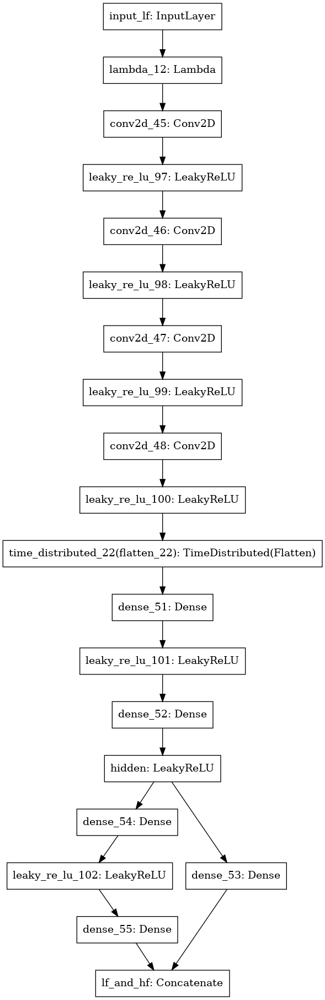

['results.pkl', 'model.h5', 'history.pkl']
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_13 (Lambda)              (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_49 (Conv2D)              (None, None, 129, 16 160         lambda_13[0][0]                  
__________________________________________________________________________________________________
conv2d_50 (Conv2D)              (None, None, 129, 20 1620        conv2d_49[0][0]                  
__________________________________________________________________

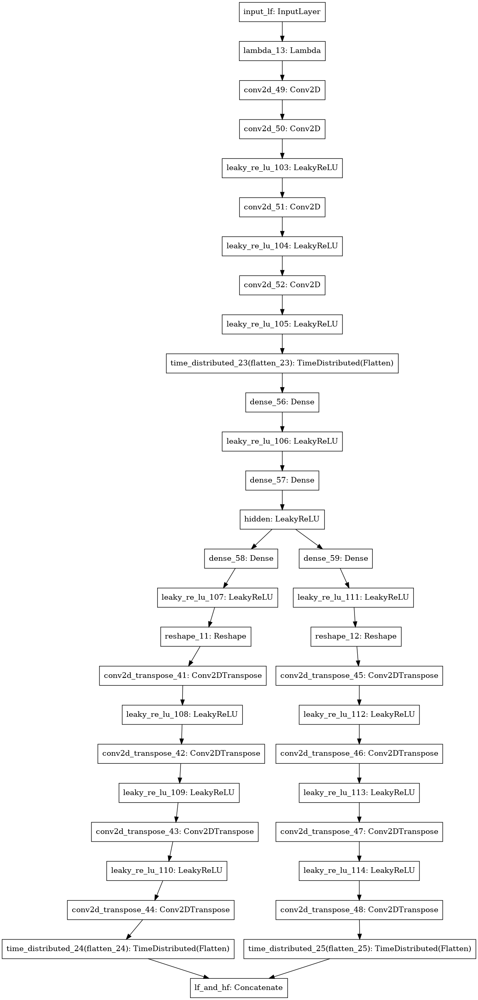

['results.pkl', 'model.h5', 'history.pkl']
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_18 (Lambda)              (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_77 (Conv2D)              (None, None, 129, 16 160         lambda_18[0][0]                  
__________________________________________________________________________________________________
conv2d_78 (Conv2D)              (None, None, 129, 20 1620        conv2d_77[0][0]                  
__________________________________________________________________

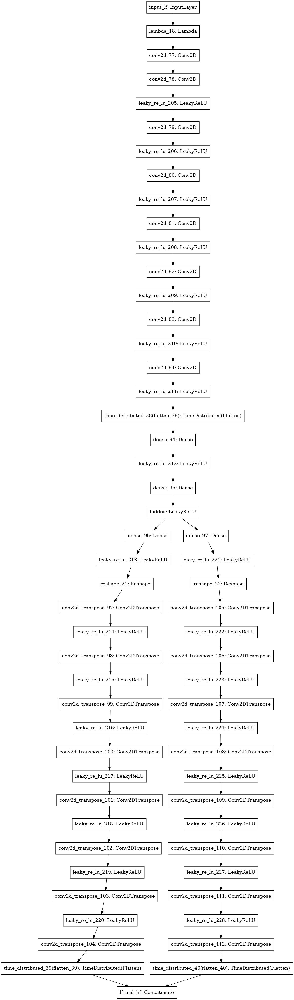

['results.pkl', 'model.h5', 'history.pkl']
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_lf (InputLayer)           (None, None, 129)    0                                            
__________________________________________________________________________________________________
lambda_19 (Lambda)              (None, None, 129, 1) 0           input_lf[0][0]                   
__________________________________________________________________________________________________
conv2d_85 (Conv2D)              (None, None, 129, 16 160         lambda_19[0][0]                  
__________________________________________________________________________________________________
conv2d_86 (Conv2D)              (None, None, 129, 20 1620        conv2d_85[0][0]                  
__________________________________________________________________

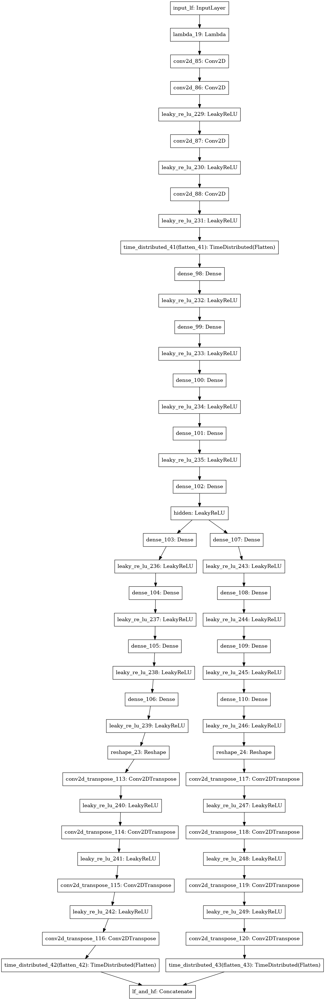

['results.pkl', 'model.h5', 'history.pkl']
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_lf (InputLayer)        (None, None, 129)         0         
_________________________________________________________________
lambda_29 (Lambda)           (None, None, 129, 1)      0         
_________________________________________________________________
conv2d_98 (Conv2D)           (None, None, 129, 15)     225       
_________________________________________________________________
time_distributed_52 (TimeDis (None, None, 1935)        0         
_________________________________________________________________
dense_127 (Dense)            (None, None, 2048)        3964928   
_________________________________________________________________
hidden (Dense)               (None, None, 2048)        4196352   
_________________________________________________________________
dense_128 (Dense)            (Non

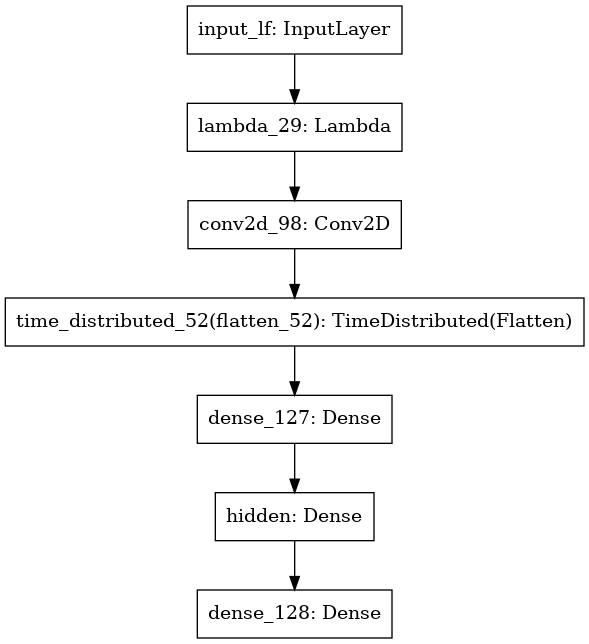

In [19]:
models = []

for model in experiment_names:
    mdl = Estimator.only_model(model)
    mdl.summary()
    print("-----\n" + model)
    models.append(mdl)
    try:
        temp = tempfile.mktemp() + ".png"
        plot_model(mdl, to_file=temp)
        display(Image(filename=temp))
    except:
        pass

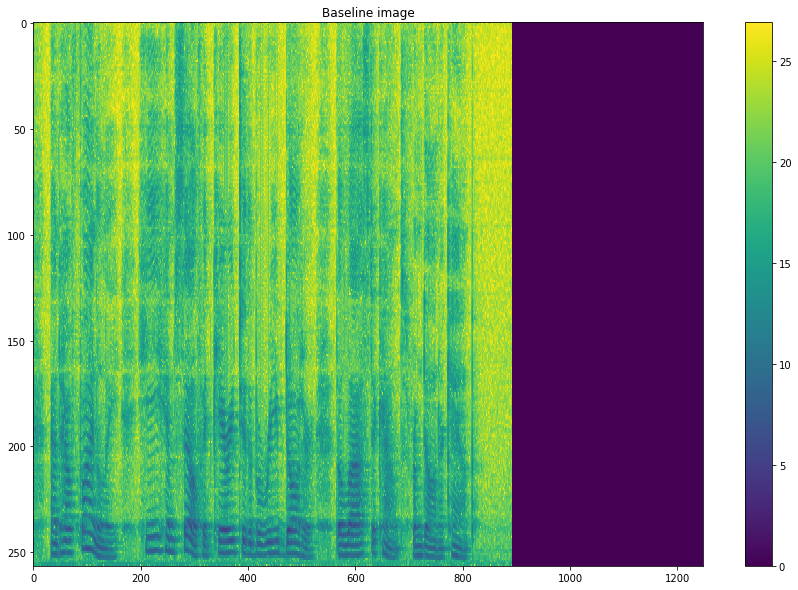

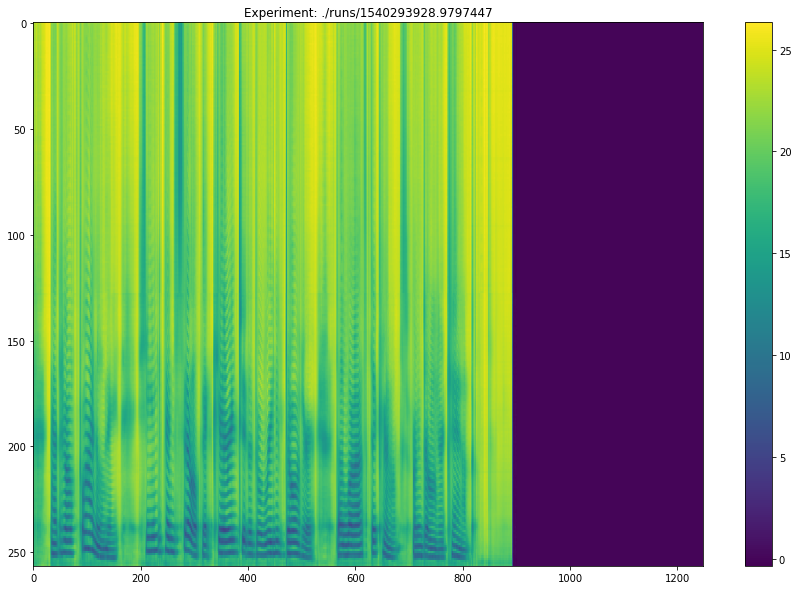

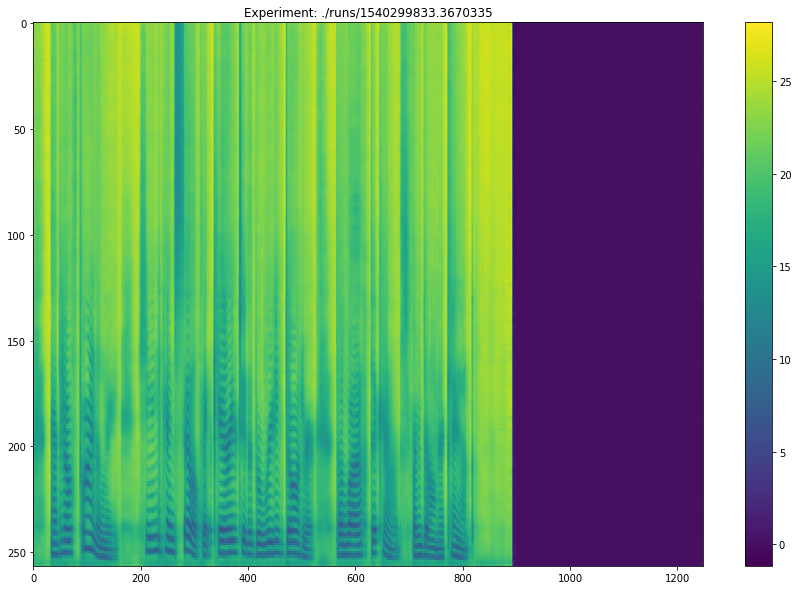

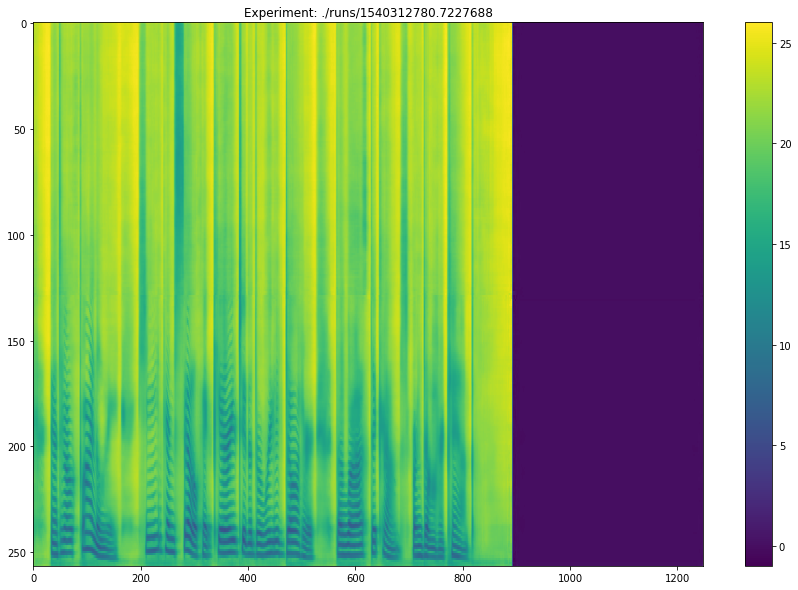

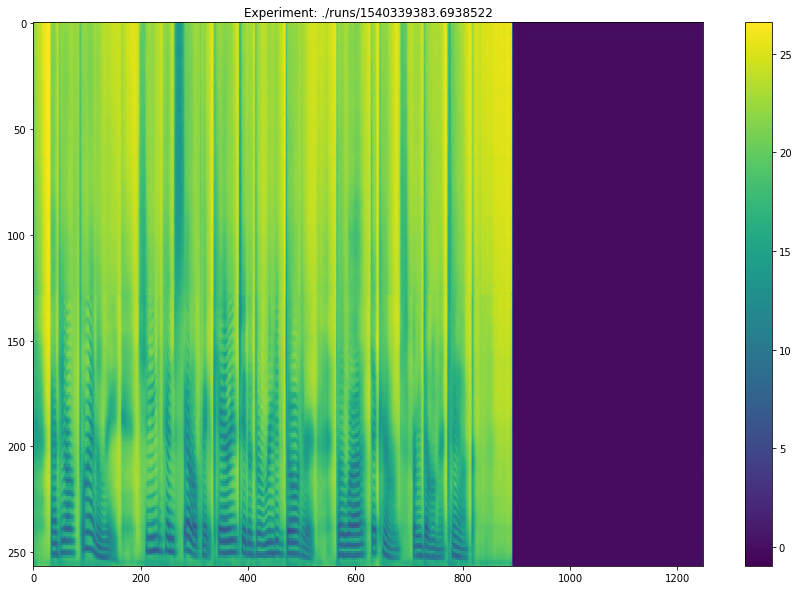

In [9]:
# visualisation

image, gt = test

plt.figure(figsize=(15,10))
plt.title("Baseline image")
plt.imshow(np.rot90(gt[0, :, :]) * STD + MEAN, aspect='auto')
plt.colorbar()
plt.show()

for name, mdl in zip(experiment_names, models):
    prediction = mdl.predict(image[:1]) * STD + MEAN
    plt.figure(figsize=(15,10))
    plt.title("Experiment: " + name)
    plt.imshow(np.rot90(prediction[0, :, :]), aspect='auto')
    plt.colorbar()
    plt.show()

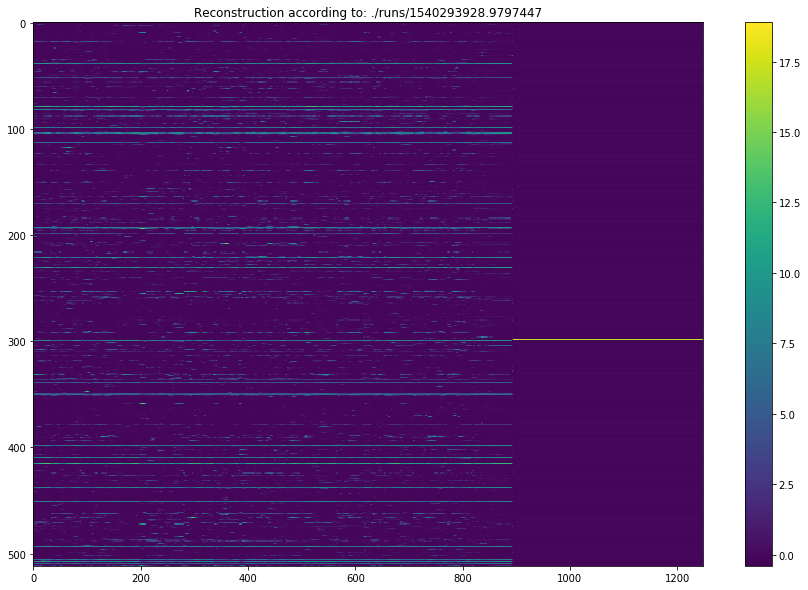

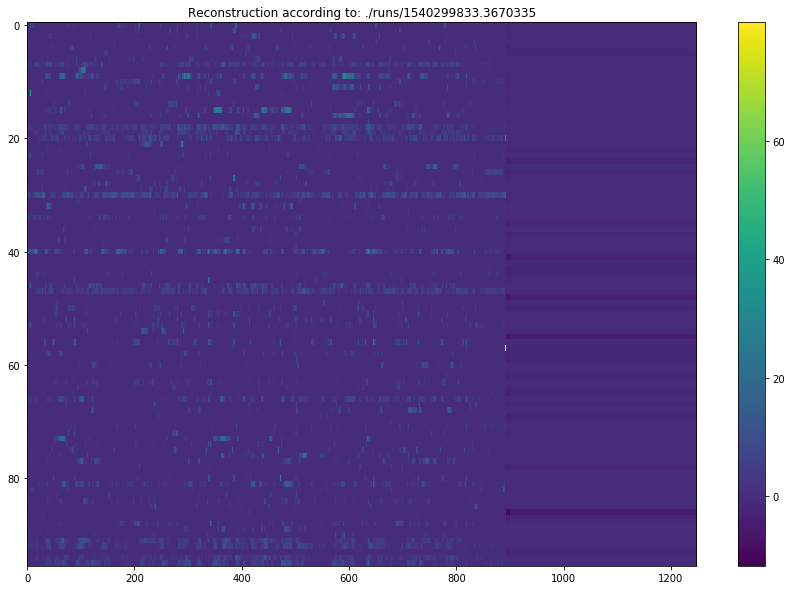

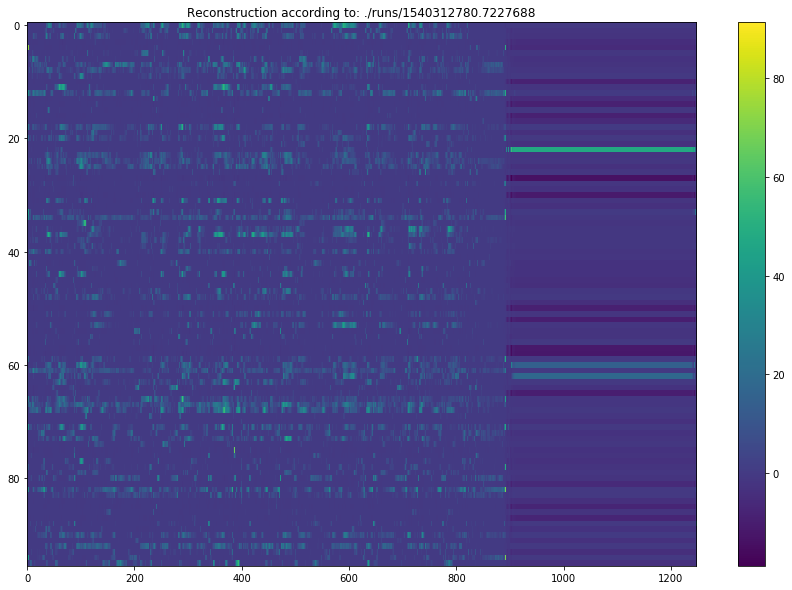

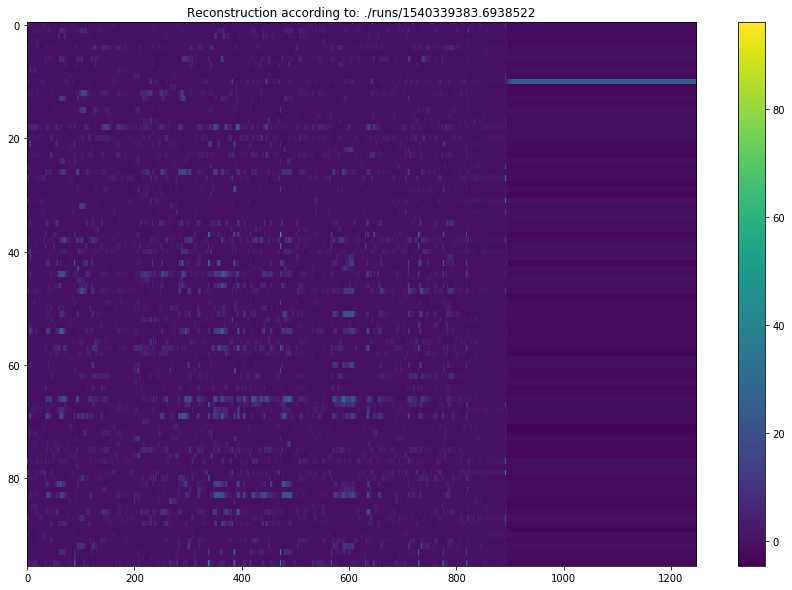

In [10]:
# hidden representation of each model - verify variability

image, gt = test

for name, mdl in zip(experiment_names, models):
    model = Model(mdl.input, [x.output for x in mdl.layers if x.name == "hidden"][0])
    prediction = model.predict(image[:1]) * STD + MEAN
    plt.figure(figsize=(15,10))
    plt.title("Reconstruction according to: " + name)
    plt.imshow(np.rot90(prediction[0, :, :]), aspect='auto')
    plt.colorbar()
    plt.show()

Groundtruth signal


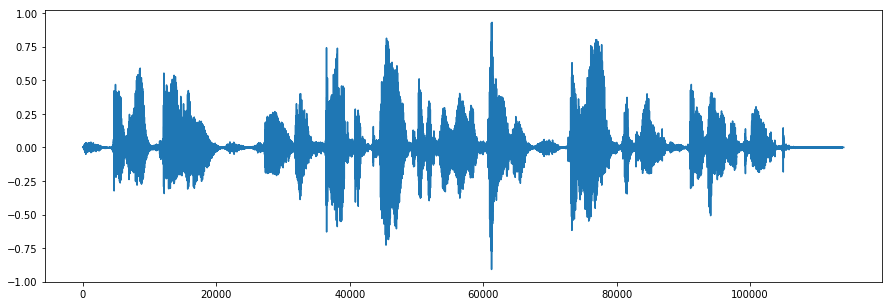

Input signal


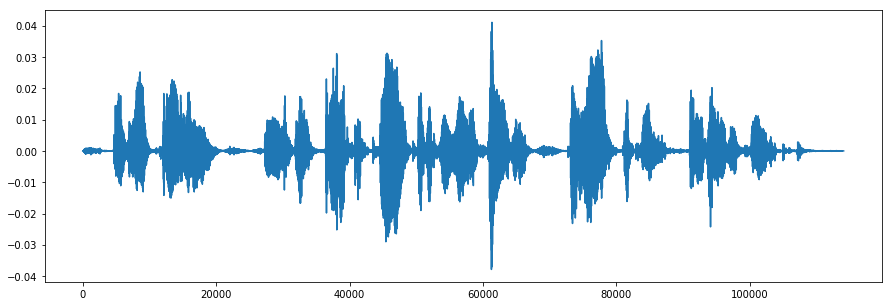

Prediction of ./runs/1540293928.9797447


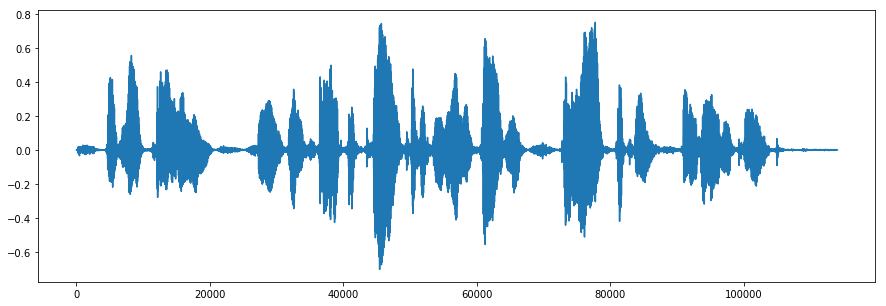

Prediction of ./runs/1540299833.3670335


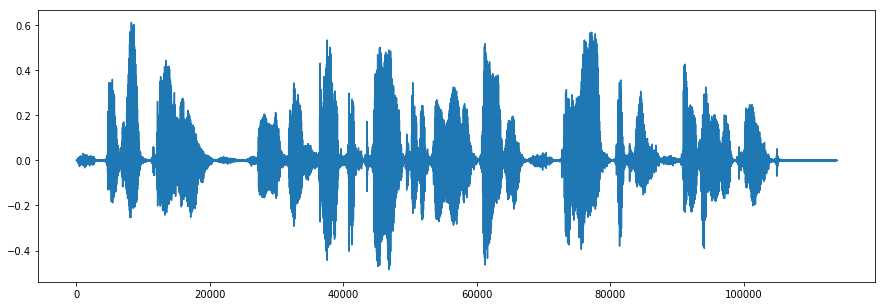

Prediction of ./runs/1540312780.7227688


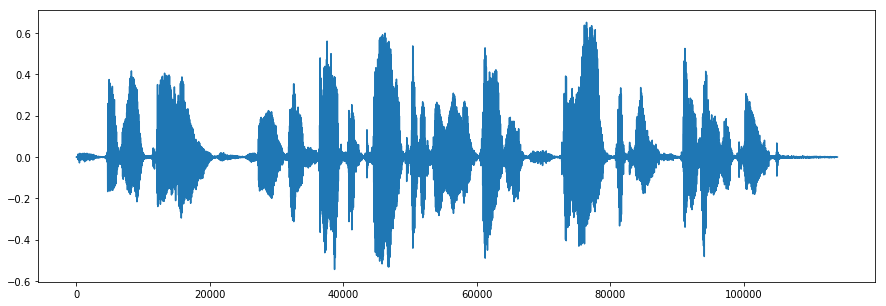

Prediction of ./runs/1540339383.6938522


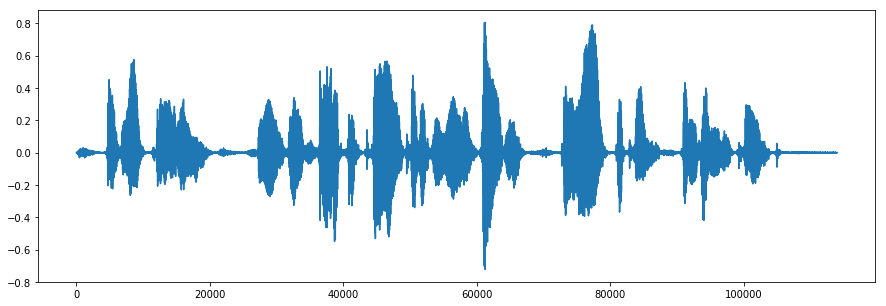

In [14]:
# predicted spectrograms

phase = np.zeros(gt.shape)
phase[:,:,:129] = old_phase[:, :, :129]
phase[:, :, 129:] = old_phase[:, :, 128:0:-1]

window = np.hamming(512)

print("Groundtruth signal")
sound = gt[0] * STD + MEAN
spec = (np.sqrt(np.exp(-sound)) * 512) * np.exp(phase[0, :, :] * 1j)

length = len(np.where((gt[0, :, :] != 0).sum(1))[0]) - 4
sound = np.zeros(length * 128 + 512 - 128)

for i in range(length):
    frame = np.fft.irfft(spec[i,:])
    sound[128 * i : 128 * i + 512] += window * frame
plt.figure(figsize=(15,5))
plt.plot(sound)
plt.show()
display(Audio(sound, rate=16000))

print("Input signal")
sound = image[0]  * STD + MEAN
spec = np.zeros(gt[0].shape, np.complex)
spec[:,:129] = (np.sqrt(np.exp(-(sound)) * 512) * np.exp(phase[0, :, :129] * 1j))
sound = np.zeros(length * 128 + 512 - 128)
for i in range(length):
    frame = np.fft.irfft(spec[i,:])
    sound[128 * i : 128 * i + 512] += window * frame
plt.figure(figsize=(15,5))
plt.plot(sound)
plt.show()
display(Audio(sound, rate=16000))


for name, mdl in zip(experiment_names, models):
    print("Prediction of " + name)
    spec = mdl.predict(image[:1])[0]  * STD + MEAN
    sound = np.zeros(length * 128 + 512 - 128)
    spec = (np.sqrt(np.exp(-spec)) * 512) * np.exp(phase[0, :, :] * 1j)
    for i in range(length):
        frame = np.fft.irfft(spec[i,:])
        sound[128 * i : 128 * i + 512] += window * frame
    plt.figure(figsize=(15,5))
    plt.plot(sound)
    plt.show()
    display(Audio(sound, rate=16000))


##### Metrics

In [20]:
import subprocess
import re

def pesq(gt, pred, phase):
    spec = (np.sqrt(np.exp(-gt)) * 512) * np.exp(phase * 1j)
    sound = np.zeros(spec.shape[0] * 128 + 512 - 128)
    for i in range(spec.shape[0]):
        frame = np.fft.irfft(spec[i,:])
        sound[128 * i : 128 * i + 512] += frame
    spec = (np.sqrt(np.exp(-pred)) * 512) * np.exp(phase * 1j)
    sound2 = np.zeros(spec.shape[0] * 128 + 512 - 128)
    for i in range(spec.shape[0]):
        frame = np.fft.irfft(spec[i,:])
        sound2[128 * i : 128 * i + 512] += frame
    fname_gt = tempfile.mktemp() + ".wav"
    fname_pred = tempfile.mktemp() + ".wav"
    # print(sound.shape, sound2.shape)
    sio.write(fname_gt, 16000, (2**15 * sound).astype(np.int16))
    sio.write(fname_pred, 16000, (2**15 * sound2).astype(np.int16))
    ot,e = subprocess.Popen(["PESQ", "+wb", "+16000", fname_gt, fname_pred], stdout = subprocess.PIPE, stderr = subprocess.PIPE).communicate()
    os.remove(fname_gt)
    os.remove(fname_pred)
    # print(ot)
    o = ot.decode("utf-8").split('\n')[-2]
    # print(o, len(o))
    # if not len(o):
    #     print(ot.decode("utf-8"))
    value = re.findall("= \d\.\d+", o)[0]
    # print(value)
    return float(value[2:])

inp, gtruth = test
n_phase = phase[:]
preds = gtruth * 0
preds[:, :, :129] = STD * inp + MEAN
quality = []
print(gtruth.shape, preds.shape, n_phase.shape)
gtruth = STD * gtruth + MEAN
for i in range(gtruth.shape[0]):
    try:
        quality.append(pesq(gtruth[i], preds[i], n_phase[i]))
    except IndexError:
        print("Failed getting PESQ value for recording {}".format(i))
print("No processing PESQ:", np.array(quality).mean())

quality_arrays = []

for name, mdl in zip(experiment_names, models):
    preds = np.zeros([gt.shape[0], 1248, 257], np.float32)
    for i in range(gt.shape[0]):
        preds[i] = mdl.predict(inp[i:i+1])
    preds = STD * preds + MEAN
    quality = []
    for i in range(gtruth.shape[0]):
        try:
            quality.append(pesq(gtruth[i], preds[i], n_phase[i]))
        except IndexError:
            print("Failed getting PESQ value for recording {}".format(i))
    print("Predicted by model {}:".format(name), np.array(quality).mean(), "+-", np.array(quality).std())
    quality_arrays.append(np.array(quality))

(80, 1248, 257) (80, 1248, 257) (80, 1248, 257)
No processing PESQ: 1.1406874999999999
Predicted by model ./runs/1540293928.9797447: 1.5889875 +- 0.291422137703624
Predicted by model ./runs/1540299833.3670335: 1.552025 +- 0.28682342019960644
Predicted by model ./runs/1540312780.7227688: 1.6139875000000004 +- 0.33804191654845117
Predicted by model ./runs/1540339383.6938522: 1.5490249999999999 +- 0.2644943749401866
Predicted by model ./runs/1540371194.6924164: 1.2135125 +- 0.14313490085842095


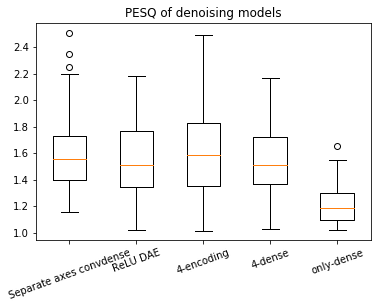

In [30]:
plot_model_names = ["Separate axes convdense", "ReLU DAE", "4-encoding", "4-dense", "only-dense"]
plt.boxplot(quality_arrays, labels=plot_model_names)
plt.xticks(rotation=20)
plt.title("PESQ of denoising models")
plt.show()

[19, 7, 49, 5, 0]


Text(0.5,1,'Percentage of preference across models, according to PESQ, task 2')

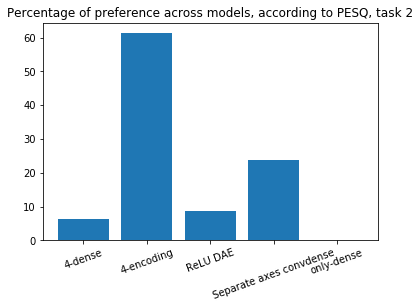

In [31]:
# old loaded data (seemingly ok): [7, 1, 7, 13, 15, 0, 7, 21, 9]

preferences = np.stack(quality_arrays).argmax(0)
from collections import Counter

c = Counter(preferences)
prefs = [c[x] for x in range(len(models))]
print(prefs)
plt.bar(plot_model_names, np.array(prefs) / 80 * 100)
plt.xticks(rotation=20)
plt.title("Percentage of preference across models, according to PESQ, task 2")

In [24]:
# log power MSE

inp, gtruth = test
preds = mdl.predict(inp)  * STD + MEAN
gtruth = gtruth * STD + MEAN

preds = gtruth * 0
preds[:, :, :129] = inp
logmse=[]
for i in range(gtruth.shape[0]):
    length = len(np.where((gtruth[i, :, :] != 0).sum(1))[0])
    logmse.append(((preds[i, :length, :] - gtruth[i, :length, :]) ** 2).mean())
print("Baseline log-power MSE:", np.array(logmse).mean())

for name, mdl in zip(experiment_names, models):
    logmse=[]
    preds = np.zeros([gt.shape[0], 1248, 257], np.float32)
    for i in range(gt.shape[0]):
        preds[i] = mdl.predict(inp[i:i+1])
    preds = STD * preds + MEAN
    for i in range(gtruth.shape[0]):
        length = len(np.where((gtruth[i, :, :] != 0).sum(1))[0])
        logmse.append(((preds[i, :length, :] - gtruth[i, :length, :]) ** 2).mean())
    print("Log-power MSE of {}:".format(name), np.array(logmse).mean())



Baseline log-power MSE: 365.04047
Log-power MSE of ./runs/1540293928.9797447: 5.407315
Log-power MSE of ./runs/1540299833.3670335: 5.453042
Log-power MSE of ./runs/1540312780.7227688: 5.060994
Log-power MSE of ./runs/1540339383.6938522: 5.310976
Log-power MSE of ./runs/1540371194.6924164: 8.6420765


In [25]:
# log-spectral distance


inp, gtruth = test
gtruth = STD * gtruth + MEAN
preds = gtruth * 0
preds[:, :, :129] = STD * inp + MEAN
lsd = []
innermost = (10 * ((-preds) - (-gtruth)) / np.log(10)) ** 2
for i in range(gtruth.shape[0]):
    inner = innermost[i, :, :]
    length = len(np.where((gtruth[i, :, :] != 0).sum(1))[0])
    inner = inner[:length]
    sublsd = []
    for t in range(length):
        step = 2 / 513
        frame = inner[t]
        integral = frame.sum()
        sublsd.append(np.sqrt(step * integral))
    lsd.append(np.array(sublsd).mean())
print("Log-spectral distance of baseline:", np.array(lsd).mean())

for name, mdl in zip(experiment_names, models):
    preds = np.zeros([gt.shape[0], 1248, 257], np.float32)
    for i in range(gt.shape[0]):
        preds[i] = mdl.predict(inp[i:i+1])
    preds = STD * preds + MEAN
    lsd = []
    innermost = (10 * ((-preds) - (-gtruth)) / np.log(10)) ** 2
    for i in range(gtruth.shape[0]):
        inner = innermost[i, :, :]
        length = len(np.where((gtruth[i, :, :] != 0).sum(1))[0])
        inner = inner[:length]
        sublsd = []
        for t in range(length):
            step = 2 / 513
            frame = inner[t]
            integral = frame.sum()
            sublsd.append(np.sqrt(step * integral))
        lsd.append(np.array(sublsd).mean())
    print("Log-spectral distance of {}:".format(name), np.array(lsd).mean(), "+-", np.array(lsd).std())

Log-spectral distance of baseline: 67.26650792413491
Log-spectral distance of ./runs/1540293928.9797447: 9.393338703206512 +- 1.2332161264059704
Log-spectral distance of ./runs/1540299833.3670335: 9.44300906563183 +- 1.2193391495482022
Log-spectral distance of ./runs/1540312780.7227688: 9.148711998583966 +- 1.158087417955609
Log-spectral distance of ./runs/1540339383.6938522: 9.334536965704443 +- 1.1891926187781545
Log-spectral distance of ./runs/1540371194.6924164: 11.810710030850124 +- 1.9652830291098748


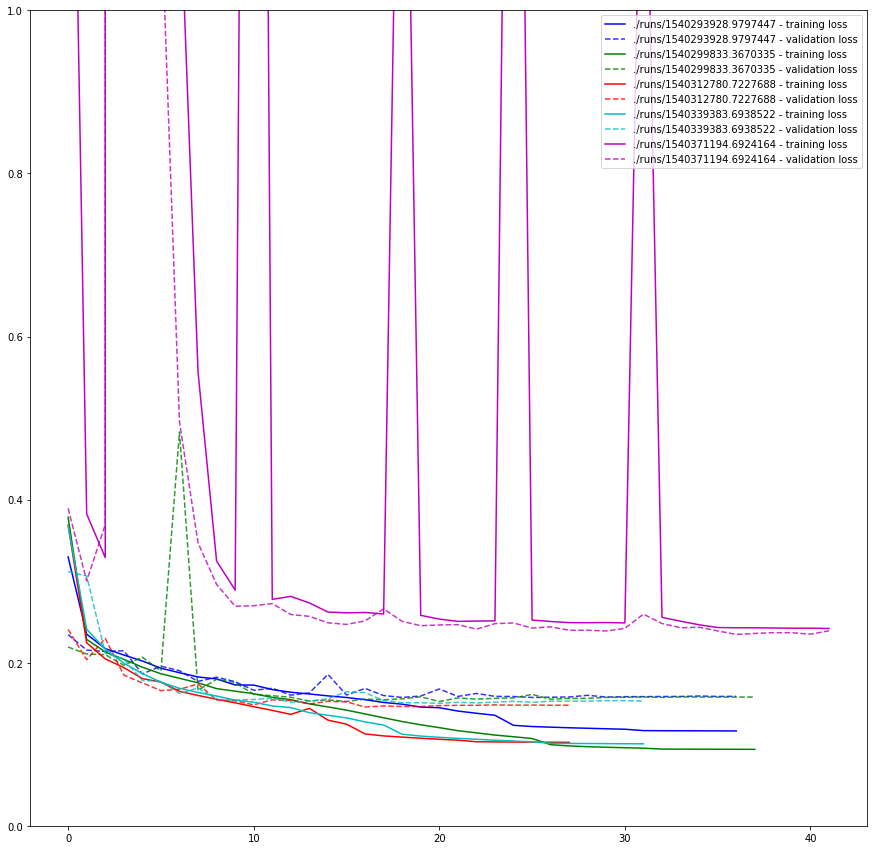

In [27]:
# Losses during training

legend_labels = []
colors = "bgrcmykbgrcmyk"
train_linestyles = ["-"] * 7 + ["-."] * 7
val_linestyles = ["--"] * 7 + ["dotted"] * 7
plt.figure(figsize=(15,15))
for color, tl, vl, model in zip(colors, train_linestyles, val_linestyles, experiment_names):
    with open(model + "/history.pkl", "rb") as f:
        hist = pickle.load(f)
    loss = hist['loss']
    val_loss = hist['val_loss']
    plt.plot(loss, linestyle=tl, color=color)
    plt.plot(val_loss, linestyle=vl, color=color, alpha=0.8)
    legend_labels.append(model + " - training loss")
    legend_labels.append(model + " - validation loss")
    plt.ylim(0,1)
plt.legend(legend_labels)
plt.show()